# Data Mining and Predictive Analytics
## Mid-Project
by Leslie Kerby, Katherine Wilsdon

You may work alone on this project or in groups of up to three people.<br/>

You will need two data files: `fy2019Expenditures` and `fy2018Expenditures`. They are each about 2 GB (\~6.5 million rows) and are available on Moodle for you to download. I will discuss the data and this project in class.<br/>

You may [install Anaconda](https://docs.anaconda.com/anaconda/install/) and run Jupyter Notebook from your personal computer (as long as you have at least \~8 GB RAM). You may also [upload the data files to Google Colab](https://stackoverflow.com/questions/47320052/load-local-data-files-to-colaboratory) (they give you 12 GB RAM for free); however this option means you will have to re-upload your data files (~2 GB / year) each Colab session as Google will not store them for you long-term. There are options to [connect your Google Drive to Colab](https://medium.com/@toselvam/how-to-work-with-large-training-dataset-in-google-colab-platform-c3499fc10c24), etc, if you wish to maintain shared data long-term.

**Question 1** (5 points) <br/>
Read in the data for fiscal year 2019 and assign it to `fy2019`

In [546]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [547]:
na_values = [' ', 'NAN', 'N/A']
fy2019 = pd.read_csv('fy2019Expenditures.csv', na_values= na_values)
fy2019.head()

,Unnamed: 0,Fiscal Year,GL Account Code,GL Account Name,Agency Name,Agency Code,Amount,Effective Date,Process Date,Area of Government,...,Fund Code,Fund Name,Fund Detail,Fund Category,Object Name,Summary Object Name,Sub Object Code,Sub Object Name,Earn Ben Group,Vendor Name
0,0,2019,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,32.60,2018-07-05,2018-07-05,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,OPERATING EXPENSES,ADMINISTRATIVE SUPPLIES,5410.0,OFFICE SUPPLIES,NOT APPLICABLE,TREASURE VALLEY COFFEE INC
1,1,2019,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,2285.24,2018-07-05,2018-07-05,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,OPERATING EXPENSES,COMPUTER SERVICES,5320.0,HOSTED SERVICES,NOT APPLICABLE,GL SUITE INC
2,2,2019,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,7945.50,2018-07-05,2018-07-06,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,OPERATING EXPENSES,MISC EXPENDITURES,5963.0,CREDIT CARD FEES,NOT APPLICABLE,ACCESS IDAHO
3,3,2019,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,12.75,2018-07-05,2018-07-12,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,PERSONNEL COSTS,EMPLOYEE BENEFITS,4210.0,GROUP INSURANCE HEALTH & ACCIDENT ...,DENTAL,KENT A ABSEC
4,4,2019,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,12.75,2018-07-05,2018-07-12,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,PERSONNEL COSTS,EMPLOYEE BENEFITS,4210.0,GROUP INSURANCE HEALTH & ACCIDENT ...,DENTAL,MARY E ROBINSON


In [548]:
fy2019['Agency Name'] = fy2019['Agency Name'].str.strip()
fy2019['Summary Object Name'] = fy2019['Summary Object Name'].str.strip()
fy2019['Sub Object Name'] = fy2019['Sub Object Name'].str.strip()
fy2019['Vendor Name'] = fy2019['Vendor Name'].str.strip()

**Question 2** (5 points) <br/>
Read in the data for fiscal year 2018 and assign it to `fy2018`

In [549]:
fy2018 = pd.read_csv('fy2018Expenditures.csv', na_values= na_values)
fy2018.head()

,Unnamed: 0,Fiscal Year,GL Account Code,GL Account Name,Agency Name,Agency Code,Amount,Effective Date,Process Date,Area of Government,...,Fund Code,Fund Name,Fund Detail,Fund Category,Object Name,Summary Object Name,Sub Object Code,Sub Object Name,Earn Ben Group,Vendor Name
0,0,2018,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,9.67,2017-07-06,2017-07-13,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,PERSONNEL COSTS,EMPLOYEE BENEFITS,4210,GROUP INSURANCE HEALTH & ACCIDENT ...,DENTAL,KENT A ABSEC
1,1,2018,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,9.67,2017-07-06,2017-07-13,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,PERSONNEL COSTS,EMPLOYEE BENEFITS,4210,GROUP INSURANCE HEALTH & ACCIDENT ...,DENTAL,MARY E ROBINSON
2,2,2018,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,9.67,2017-07-06,2017-07-13,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,PERSONNEL COSTS,EMPLOYEE BENEFITS,4210,GROUP INSURANCE HEALTH & ACCIDENT ...,DENTAL,SANDRA K BLY
3,3,2018,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,9.67,2017-07-06,2017-07-13,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,PERSONNEL COSTS,EMPLOYEE BENEFITS,4210,GROUP INSURANCE HEALTH & ACCIDENT ...,DENTAL,TAMI L HELTON
4,4,2018,4200,EXPENDITURES ...,"ACCOUNTANCY, STATE BOARD OF",422,536.16,2017-07-06,2017-07-13,50,...,229,STATE REGULATORY FUNDS,NOT APPLICABLE,DEDICATED,PERSONNEL COSTS,EMPLOYEE BENEFITS,4210,GROUP INSURANCE HEALTH & ACCIDENT ...,HEALTH,KENT A ABSEC


In [550]:
fy2018['Agency Name'] = fy2018['Agency Name'].str.strip()
fy2018['Summary Object Name'] = fy2018['Summary Object Name'].str.strip()
fy2018['Sub Object Name'] = fy2018['Sub Object Name'].str.strip()
fy2018['Vendor Name'] = fy2018['Vendor Name'].str.strip()

**Question 3** (30 points) <br/>
Do Exploratory Data Analysis on both `fy2018` and `fy2019`. Identify key characteristics and limitations of the data. Give interesting descriptive statistics, tables, and graphics.

In [551]:
# Exploring fy2018Expenditures
fy2018.shape

(6729250, 22)

In [552]:
fy2018.describe()

,Unnamed: 0,Fiscal Year,GL Account Code,Agency Code,Amount,Area of Government,State Objective,Fund Code,Sub Object Code
count,6.729250e+06,6729250.0,6729250.0,6.729250e+06,6.729250e+06,6.729250e+06,6.729237e+06,6.729250e+06,6.729250e+06
mean,3.364624e+06,2018.0,4200.0,3.418560e+02,1.459551e+03,3.630404e+01,3.899494e+01,2.064425e+02,4.451982e+03
std,1.942567e+06,0.0,0.0,1.578558e+02,2.807587e+05,1.551892e+01,1.558213e+01,1.865835e+02,7.120848e+02
min,0.000000e+00,2018.0,4200.0,1.000000e+02,-2.906680e+07,1.000000e+01,1.100000e+01,1.000000e+00,4.105000e+03
25%,1.682312e+06,2018.0,4200.0,2.450000e+02,7.920000e+00,2.000000e+01,2.400000e+01,1.000000e+00,4.210000e+03
50%,3.364624e+06,2018.0,4200.0,2.850000e+02,4.980000e+01,4.000000e+01,4.200000e+01,2.200000e+02,4.225000e+03
75%,5.046937e+06,2018.0,4200.0,4.500000e+02,2.686800e+02,5.000000e+01,5.300000e+01,2.900000e+02,4.255000e+03
max,6.729249e+06,2018.0,4200.0,9.570000e+02,6.052874e+08,6.000000e+01,6.500000e+01,6.600000e+02,8.400000e+03


In [553]:
fy2018.columns

Index(['Unnamed: 0', 'Fiscal Year', 'GL Account Code', 'GL Account Name',
       'Agency Name', 'Agency Code', 'Amount', 'Effective Date',
       'Process Date', 'Area of Government', 'State Objective', 'Program',
       'Fund Code', 'Fund Name', 'Fund Detail', 'Fund Category', 'Object Name',
       'Summary Object Name', 'Sub Object Code', 'Sub Object Name',
       'Earn Ben Group', 'Vendor Name'],
      dtype='object')

In [554]:
fy2018['Vendor Name'].nunique()

72324

In [555]:
fy2018['Vendor Name'].value_counts().head(50)

POST PEND & ADJUSTMENT PROCESSING    36809
                                     22983
PCARD GENERIC VENDOR                 10222
REDACTED                              8895
OFFICE DEPOT INC                      7864
BOISE STATE UNIVERSITY                4818
PCARD - AMAZON MKTPLACE PMTS          4055
PCARD - OFFICE DEPOT                  3992
ADMINISTRATION DEPT                   3838
VERIZON WIRELESS SERVICES LLC         3675
QWEST COMMUNICATIONS COMPANY LLC      3553
UNIVERSITY OF IDAHO                   3159
FRED O SISNEROS                       2645
SHAWNA K DENTON                       2606
WEX BANK                              2573
KASANDRA A WRIGHT                     2537
CHRISTOPHER M HAENER                  2525
MICHAEL W SAVOIE                      2517
JASON G BLACK                         2505
SEAN M SOUTHARD                       2490
BRADY INDUSTRIES                      2446
WW GRAINGER INC                       2444
IDAHO POWER COMPANY                   2438
MARYLOU   D

In [556]:
fy2018['Agency Name'].value_counts().head(50)

HEALTH AND WELFARE, DEPARTMENT OF                     1146611
CORRECTION, DEPARTMENT OF                              576075
TRANSPORTATION, DEPARTMENT OF                          456753
BOISE STATE UNIVERSITY                                 433984
FISH AND GAME, DEPARTMENT OF                           364997
IDAHO STATE UNIVERSITY                                 329111
POLICE, IDAHO STATE                                    311170
LANDS, DEPARTMENT OF                                   258062
UNIVERSITY OF IDAHO                                    247018
LABOR, DEPARTMENT OF                                   189808
ENVIRONMENTAL QUALITY, DEPARTMENT OF                   174057
LEWIS-CLARK STATE COLLEGE                              146269
TAX COMMISSION, IDAHO STATE                            145283
JUVENILE CORRECTIONS, DEPARTMENT OF                    133802
AGRICULTURE, DEPARTMENT OF                             121038
MILITARY DIVISION                                      118174
BUILDING

In [557]:
fy2018['GL Account Name'].value_counts()

EXPENDITURES                                          6729250
Name: GL Account Name, dtype: int64

In [558]:
fy2018['Object Name'].value_counts()

PERSONNEL COSTS         5871155
OPERATING EXPENSES       489368
TRUSTEE/BENEFIT PYMT     359319
CAPITAL OUTLAY             9384
DEBT SERVICE                 24
Name: Object Name, dtype: int64

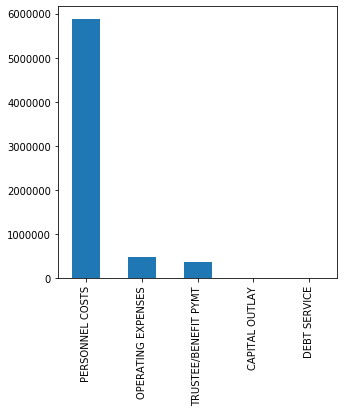

In [559]:
fy2018['Object Name'].value_counts().plot.bar(figsize=(5,5))

In [560]:
fy2018[fy2018['Object Name'] == 'PERSONNEL COSTS']['Summary Object Name'].value_counts()

EMPLOYEE BENEFITS      4672464
GROSS SALARY & WAGE    1198691
Name: Summary Object Name, dtype: int64

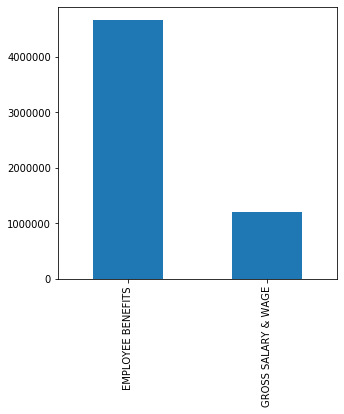

In [561]:
fy2018[fy2018['Object Name'] == 'PERSONNEL COSTS']['Summary Object Name'].value_counts().plot.bar(figsize=(5,5))

In [562]:
fy2018[fy2018['Object Name'] == 'OPERATING EXPENSES']['Summary Object Name'].value_counts()

EMPLOYEE TRAVEL COSTS         122386
COMMUNICATION COSTS            44956
REPAIR & MAINT SUPPLIES        41178
SPECIFIC USE SUPPLIES          40275
REPAIR & MAINT SVCS            35805
ADMINISTRATIVE SUPPLIES        29415
PROFESSIONAL SERVICES          23872
GENERAL SERVICES               22917
UTILITY CHARGES                22882
MISC EXPENDITURES              21203
RENTALS & OPER LEASES          17413
EMPLOYEE DEVELOPMENT COSTS     15148
INST & RESIDENT SUPPLIES       11376
COMPUTER SUPPLIES              10454
FUEL & LUBRICANTS COSTS         8495
COMPUTER SERVICES               7485
ADMINISTRATIVE SERVICES         6501
MFG & MERCH COSTS               6378
INSURANCE                       1229
Name: Summary Object Name, dtype: int64

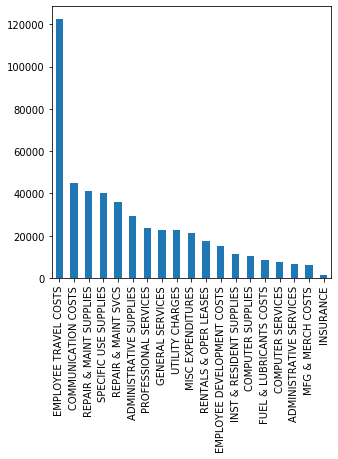

In [563]:
fy2018[fy2018['Object Name'] == 'OPERATING EXPENSES']['Summary Object Name'].value_counts().plot.bar(figsize=(5,5))

In [564]:
fy2018[fy2018['Object Name'] == 'TRUSTEE/BENEFIT PYMT']['Summary Object Name'].value_counts()

AWARDS CONTR & CLAIMS       319461
FED PMTS TO SUBGRANTEES      12287
MISC PMTS AS AGENT           10404
EDUC & TRAIN ASSISTANCE       8997
NON FED PMTS SUBGRANTEES      7715
PENSION PAYMENTS               455
Name: Summary Object Name, dtype: int64

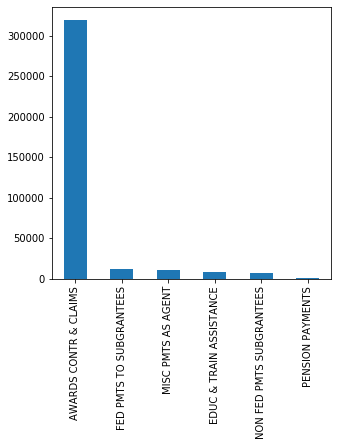

In [565]:
fy2018[fy2018['Object Name'] == 'TRUSTEE/BENEFIT PYMT']['Summary Object Name'].value_counts().plot.bar(figsize=(5,5))

In [566]:
fy2018[fy2018['Object Name'] == 'CAPITAL OUTLAY']['Summary Object Name'].value_counts()

PROPERTY & IMPROVEMENTS          2925
BLDG & IMPROVEMENTS              2560
COMPUTER EQUIPMENT               1340
SPECIFIC USE EQUIPMENT            961
MOTORIZED/NON-MOTORIZED EQUIP     685
SITE DEVELOPMENTS                 353
OFFICE EQUIPMENT                  343
EDUC MATERIAL & EQUIP             157
CAPITALIZED LEASES                 45
MISCELLANEOUS CAPITAL OUTLAY       11
NATURAL RESOURCES                   4
Name: Summary Object Name, dtype: int64

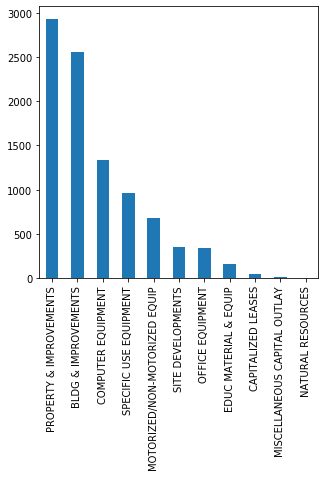

In [567]:
fy2018[fy2018['Object Name'] == 'CAPITAL OUTLAY']['Summary Object Name'].value_counts().plot.bar(figsize=(5,5))

In [568]:
fy2018[fy2018['Object Name'] == 'DEBT SERVICE']['Summary Object Name'].value_counts()

BONDS    24
Name: Summary Object Name, dtype: int64

In [569]:
fy2018['Summary Object Name'].value_counts()

EMPLOYEE BENEFITS                4672464
GROSS SALARY & WAGE              1198691
AWARDS CONTR & CLAIMS             319461
EMPLOYEE TRAVEL COSTS             122386
COMMUNICATION COSTS                44956
REPAIR & MAINT SUPPLIES            41178
SPECIFIC USE SUPPLIES              40275
REPAIR & MAINT SVCS                35805
ADMINISTRATIVE SUPPLIES            29415
PROFESSIONAL SERVICES              23872
GENERAL SERVICES                   22917
UTILITY CHARGES                    22882
MISC EXPENDITURES                  21203
RENTALS & OPER LEASES              17413
EMPLOYEE DEVELOPMENT COSTS         15148
FED PMTS TO SUBGRANTEES            12287
INST & RESIDENT SUPPLIES           11376
COMPUTER SUPPLIES                  10454
MISC PMTS AS AGENT                 10404
EDUC & TRAIN ASSISTANCE             8997
FUEL & LUBRICANTS COSTS             8495
NON FED PMTS SUBGRANTEES            7715
COMPUTER SERVICES                   7485
ADMINISTRATIVE SERVICES             6501
MFG & MERCH COST

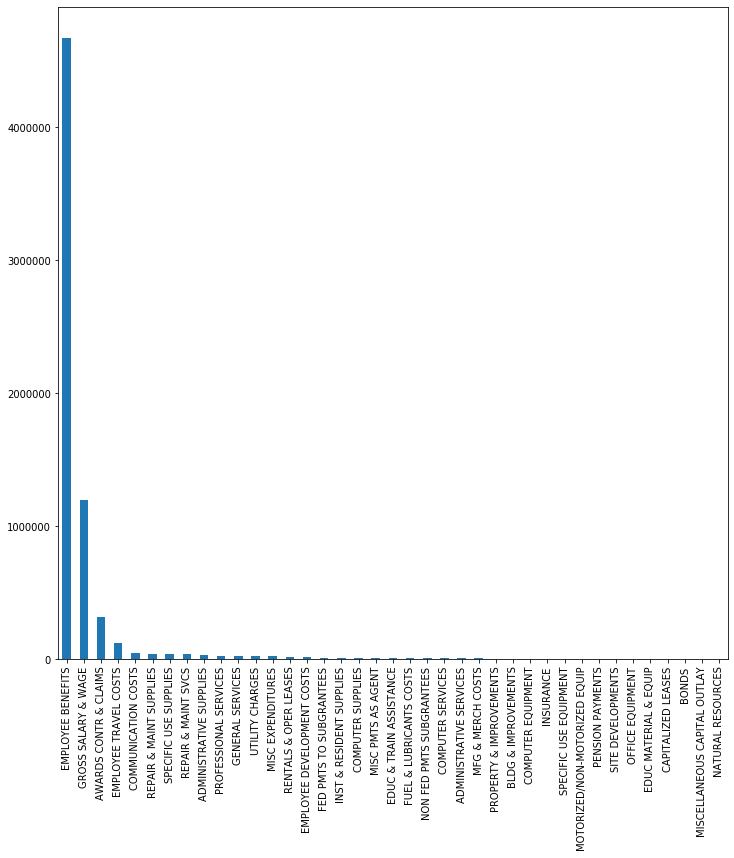

In [570]:
fy2018['Summary Object Name'].value_counts().plot.bar(figsize=(12,12))

In [571]:
fy2018['Sub Object Name'].value_counts().head(50)

EMPLOYEES                                   1058599
GROUP INSURANCE HEALTH & ACCIDENT            999703
F. I. C. A.                                  618695
WORKER'S COMPENSATION                        612531
EMPLOYMENT SECURITY                          607440
EMPLOYER RETIREMENT CONTRIBUTION             582060
RETIREMENT SICK LEAVE                        578969
PERSONNEL COMMISSION                         393777
MEDICAL ASSISTANCE-VENDORS                   302432
GROUP INSURANCE LIFE                         277930
EMPLOYEES - TEMPORARY                         47967
SHIFT DIFFERENTIAL                            38205
OVERTIME COVERED BY FLSA                      38053
SUBSISTENCE IN-STATE                          26349
OFFICE SUPPLIES                               21986
LODGING - IN STATE                            19344
VEHICLE SERVCS                                16011
PERSONAL VEHICLE - IN-STATE                   14336
CELLULAR/WIRELESS VOICE SERVICE               13884
BUILDING-SUP

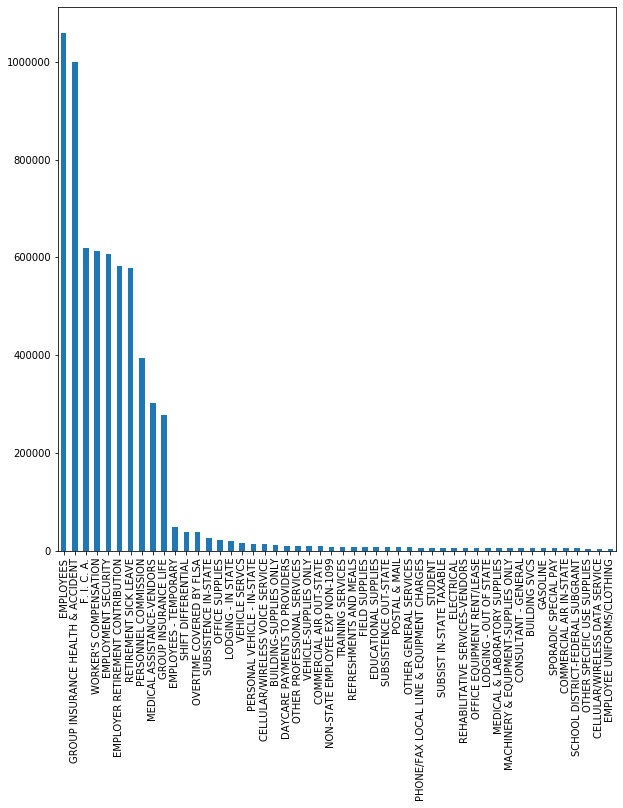

In [572]:
fy2018['Sub Object Name'].value_counts().head(50).plot.bar(figsize=(10,10))

In [573]:
fy2018[fy2018['Summary Object Name'] == 'EMPLOYEE BENEFITS']['Sub Object Name'].value_counts()

GROUP INSURANCE HEALTH & ACCIDENT         999703
F. I. C. A.                               618695
WORKER'S COMPENSATION                     612531
EMPLOYMENT SECURITY                       607440
EMPLOYER RETIREMENT CONTRIBUTION          582060
RETIREMENT SICK LEAVE                     578969
PERSONNEL COMMISSION                      393777
GROUP INSURANCE LIFE                      277930
ANNUAL LEAVE BALANCES                        652
JUDGES RETIREMENT                            567
MEDICARE - U OF I                            122
PERSI PRIOR YEAR EMPLOYER CONTRIBUTION         8
SICK LEAVE BALANCES                            6
WORKER'S COMPENSATION CREDIT                   2
WORKERS COMPENSATION AUDIT ADJUSTMENT          2
Name: Sub Object Name, dtype: int64

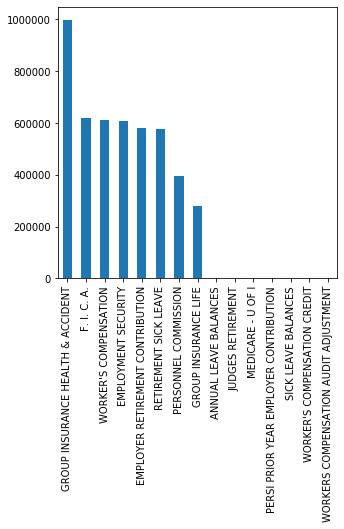

In [574]:
fy2018[fy2018['Summary Object Name'] == 'EMPLOYEE BENEFITS']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [575]:
fy2018[fy2018['Summary Object Name'] == 'GROSS SALARY & WAGE']['Sub Object Name'].value_counts()

EMPLOYEES                     1058599
EMPLOYEES - TEMPORARY           47967
SHIFT DIFFERENTIAL              38205
OVERTIME COVERED BY FLSA        38053
STUDENT                          6639
SPORADIC SPECIAL PAY             5162
BOARD/COMMISSION MEMBERS         2452
OVERTIME EXEMPT FROM FLSA        1220
COMPENSATORY LEAVE BALANCE        188
EMPLOYEE-EMERGENCY HELP           157
PAYROLL REIMBURSEMENTS             49
Name: Sub Object Name, dtype: int64

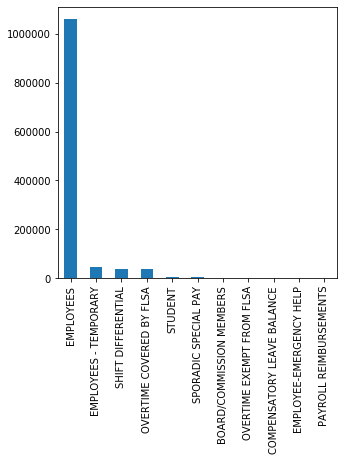

In [576]:
fy2018[fy2018['Summary Object Name'] == 'GROSS SALARY & WAGE']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [577]:
fy2018[fy2018['Summary Object Name'] == 'AWARDS CONTR & CLAIMS']['Sub Object Name'].value_counts()

MEDICAL ASSISTANCE-VENDORS                            302432
DAYCARE PAYMENTS TO PROVIDERS                          10528
INCOME ASSISTANCE PAYMENTS                              1809
PREMIUMS                                                 660
RISK MANAGEMENT PAYMENTS NON-1099                        656
OTHER AWARDS/CONTRIBUTIONS/CLAIMS                        546
WORKER COMPENSATION AWARDS                               442
RISK MANAGEMENT PAYMENTS                                 391
UNEMPLOYMENT COMPENSATION BENEFITS                       368
PRIZE PAYMENTS                                           338
CRIME VICTIMS COMPENSATION-1099 MED                      274
MEDICAL ASSISTANCE-INDIVIDUALS                           236
CRIME VICTIMS COMPENSATION-1099                          224
PRIZE & AWARDS-1099BX3                                   153
CRIME VICTIMS COMPENSATION-NON-1099                      145
SPECIAL INDEMNITY PAYMENTS                                90
SPECIAL INDEMNITY PAYMEN

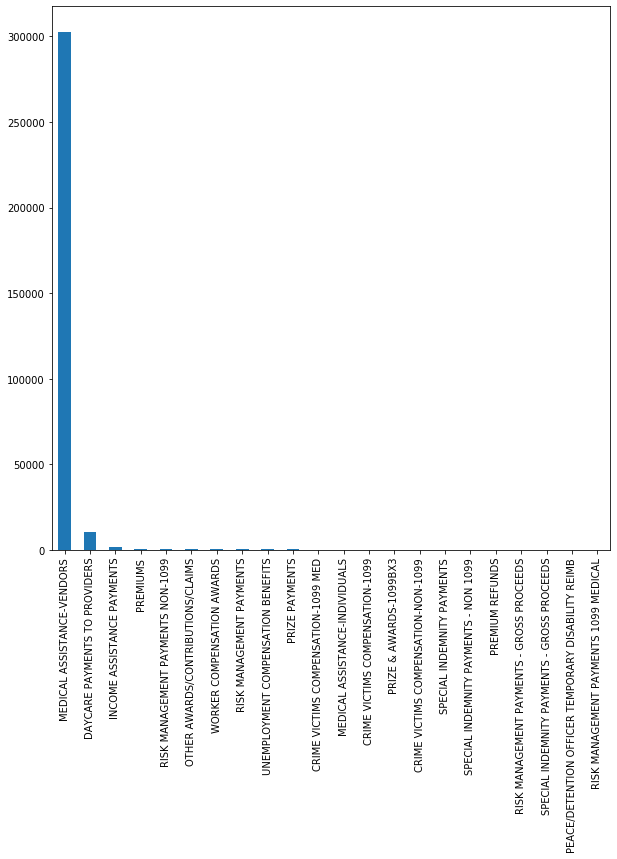

In [578]:
fy2018[fy2018['Summary Object Name'] == 'AWARDS CONTR & CLAIMS']['Sub Object Name'].value_counts().plot.bar(figsize=(10,10))

In [579]:
fy2018[fy2018['Summary Object Name'] == 'EMPLOYEE TRAVEL COSTS']['Sub Object Name'].value_counts()

SUBSISTENCE IN-STATE                        26349
LODGING - IN STATE                          19344
PERSONAL VEHICLE - IN-STATE                 14336
COMMERCIAL AIR OUT-STATE                     8901
REFRESHMENTS AND MEALS                       8121
SUBSISTENCE OUT-STATE                        7259
SUBSIST IN-STATE TAXABLE                     6505
LODGING - OUT OF STATE                       6047
COMMERCIAL AIR IN-STATE                      5138
PUBLIC CONVEYANCE OUT-STATE                  3944
RENTAL VEHICLES-IN-STATE                     2561
P CARD BANKING/ATM FEES                      1947
OTHER EMPLOYEE TRAVEL COSTS                  1922
RENTAL VEHICLE MISC IN-STATE NON-1099        1860
PUBLIC CONVEYANCE IN-STATE                   1698
RENTAL VEHICLES-OUT-STATE                    1576
PERSONAL VEHICLE - OUT-STATE                 1210
PCARD CASH ADVANCES                          1208
RENTAL VEHICLE MISC OUT-OF-STATE NON-109      571
SUBSISTENCE OUT-STATE TAXABLE                 385


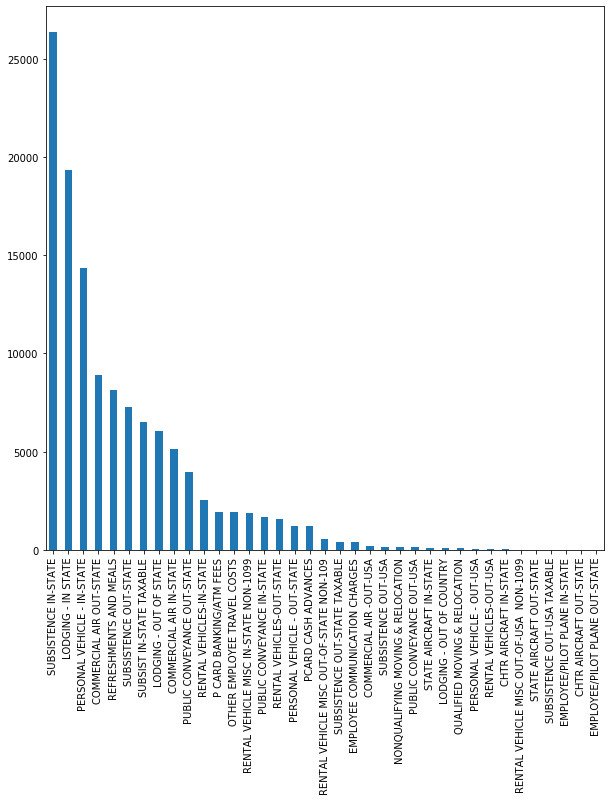

In [580]:
fy2018[fy2018['Summary Object Name'] == 'EMPLOYEE TRAVEL COSTS']['Sub Object Name'].value_counts().plot.bar(figsize=(10,10))

In [581]:
fy2018[fy2018['Summary Object Name'] == 'COMPUTER EQUIPMENT']['Sub Object Name'].value_counts()

PERSONAL COMPUTER HARDWARE                  635
PERIPHERAL EQUIPMENT                        177
NETWORKING HARDWARE                         156
SERVER AND STORAGE HARDWARE                 148
OTHER COMPUTER EQUIPMENT                    116
TELEPHONE AND VOIP EQUIPMENT                 50
CYBER-SECURITY HARDWARE                      24
INTANGIBLE SOFTWARE - INTERNALLY DEVELOP     21
INTANGIBLE SOFTWARE - PURCHASED OVER $20      8
MAINFRAME COMPUTER HARDWARE                   5
Name: Sub Object Name, dtype: int64

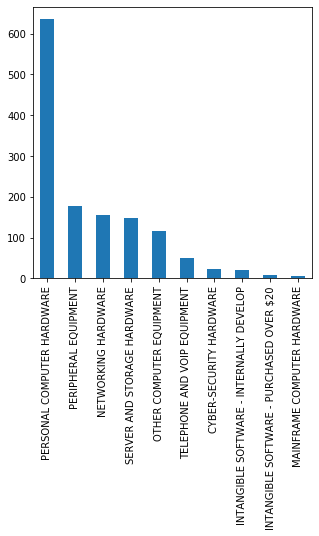

In [582]:
fy2018[fy2018['Summary Object Name'] == 'COMPUTER EQUIPMENT']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [583]:
fy2018[fy2018['Summary Object Name'] == 'COMPUTER SUPPLIES']['Sub Object Name'].value_counts()

OTHER COMPUTER SUPPLIES               3902
PERSONAL COMPUTER SOFTWARE            2238
PERIPHERAL EQUIPMENT                  2134
PERSONAL COMPUTER HARDWARE            1224
SERVER AND STORAGE SOFTWARE            310
NETWORKING HARDWARE                    167
SERVER AND STORAGE HARDWARE            140
CYBER-SECURITY SOFTWARE                131
NETWORKING SOFTWARE                     89
ENTERPRISE RESOURCE PLANNING (ERP)      63
CYBER-SECURITY HARDWARE                 36
MAINFRAME COMPUTER SOFTWARE             16
MAINFRAME COMPUTER HARDWARE              4
Name: Sub Object Name, dtype: int64

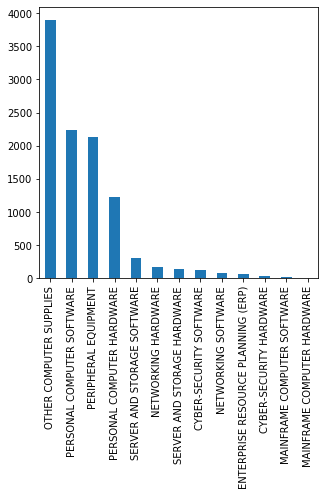

In [584]:
fy2018[fy2018['Summary Object Name'] == 'COMPUTER SUPPLIES']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [585]:
fy2018[fy2018['Summary Object Name'] == 'INSURANCE']['Sub Object Name'].value_counts()

OTHER INSURANCE                     385
LIABILITY, ALL                      319
PROPERTY, ALL                       263
AUTO PHYSICAL DAMAGE                188
GROUP LIFE DISABILITY PREMIUMS       32
AVIATION INSURANCE                   17
WORKER COMPENSATION NON EMPLOYEE     15
EMPLOYEE BONDS                        6
FIRE                                  3
NON-EMPLOYEE BONDS                    1
Name: Sub Object Name, dtype: int64

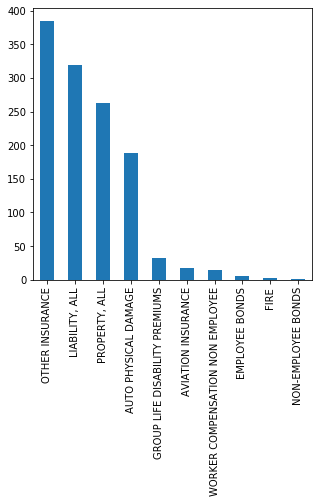

In [586]:
fy2018[fy2018['Summary Object Name'] == 'INSURANCE']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [587]:
fy2018[fy2018['Summary Object Name'] == 'PROFESSIONAL SERVICES']['Sub Object Name'].value_counts()

OTHER PROFESSIONAL SERVICES                10273
CONSULTANT - GENERAL                        5269
ADV ERTISING & LEGAL NOTICES                2548
INTERPRETERS/TRANSLATION                    1375
PROMOTION/PUBLICITY                         1180
LEGAL FEES                                   918
CONSULTANT - MEDICAL                         668
ACCOUNTING                                   397
AUDITING                                     340
COURT REPORTING                              212
CONSULTANT - PUBLIC RELATIONS                177
CONSULTANT - ARCHITECTS AND ENGINEERING      154
HEARING OFFICER                              143
CONSULTANT - LEGAL                            99
BROKERAGE FEES                                98
BROKERAGE FEES -  STATE INSURANCE FUND        21
Name: Sub Object Name, dtype: int64

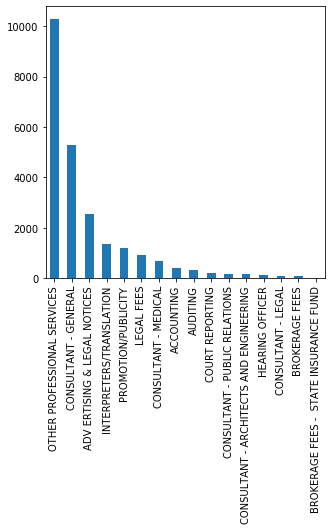

In [588]:
fy2018[fy2018['Summary Object Name'] == 'PROFESSIONAL SERVICES']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [589]:
fy2018[fy2018['Summary Object Name'] == 'GENERAL SERVICES']['Sub Object Name'].value_counts()

OTHER GENERAL SERVICES                                6969
LAUNDRY                                               3480
MEDICAL                                               2675
DOCUMENT MANAGEMENT/RECYCLING                         1786
GROUP PUBLICATIONS, SUBSCRIPTIONS & MEMB              1385
LANDSCAPING AND WEED CONTROL                          1073
EDUCATIONAL TESTING, GRADING                           961
TEMPORARY PERSONNEL                                    784
ENVIRONMENTAL OR ECOLOGICAL TESTING                    703
SECURITY PATROL OR ALARM SERVICES                      681
CLERICAL                                               609
INSTITUTIONAL SERVICES                                 499
HONORARIA                                              284
LIVESTOCK/VETERINARY EQUIPMENT TESTING                 259
NON EMPLOYEE TRAINING-VENDOR PAYMENTS-10               246
NON EMPLOYEE TRAINING-REIMBURSEMENTS-NON               219
HUMAN ALCOHOL OR DRUG TESTING SERVICES                  

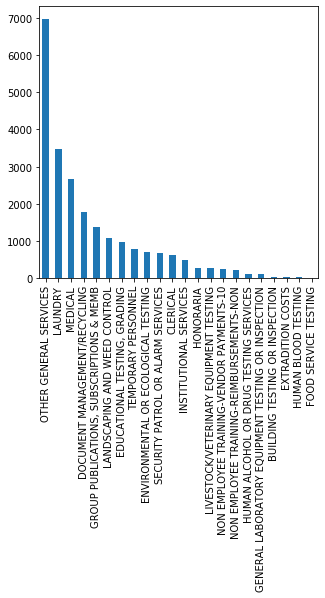

In [590]:
fy2018[fy2018['Summary Object Name'] == 'GENERAL SERVICES']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [591]:
fy2018[fy2018['Summary Object Name'] == 'ADMINISTRATIVE SERVICES']['Sub Object Name'].value_counts()

PRINTING SERVICES                      2323
PHOTOCOPYING SERVICES                  1933
FREIGHT SERVICES                       1592
OTHER ADMINISTRATIVE SERVICES           474
PHOTOGRAPHIC SERVICES                   154
MICROFILM, MICROFICHE & CD SERVICES      14
BINDING SERVICES                         11
Name: Sub Object Name, dtype: int64

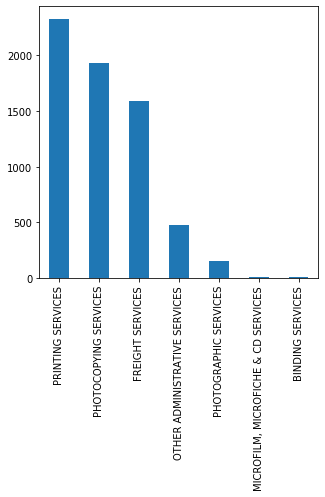

In [592]:
fy2018[fy2018['Summary Object Name'] == 'ADMINISTRATIVE SERVICES']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [593]:
fy2018['Agency Name'].value_counts().head(50)

HEALTH AND WELFARE, DEPARTMENT OF                     1146611
CORRECTION, DEPARTMENT OF                              576075
TRANSPORTATION, DEPARTMENT OF                          456753
BOISE STATE UNIVERSITY                                 433984
FISH AND GAME, DEPARTMENT OF                           364997
IDAHO STATE UNIVERSITY                                 329111
POLICE, IDAHO STATE                                    311170
LANDS, DEPARTMENT OF                                   258062
UNIVERSITY OF IDAHO                                    247018
LABOR, DEPARTMENT OF                                   189808
ENVIRONMENTAL QUALITY, DEPARTMENT OF                   174057
LEWIS-CLARK STATE COLLEGE                              146269
TAX COMMISSION, IDAHO STATE                            145283
JUVENILE CORRECTIONS, DEPARTMENT OF                    133802
AGRICULTURE, DEPARTMENT OF                             121038
MILITARY DIVISION                                      118174
BUILDING

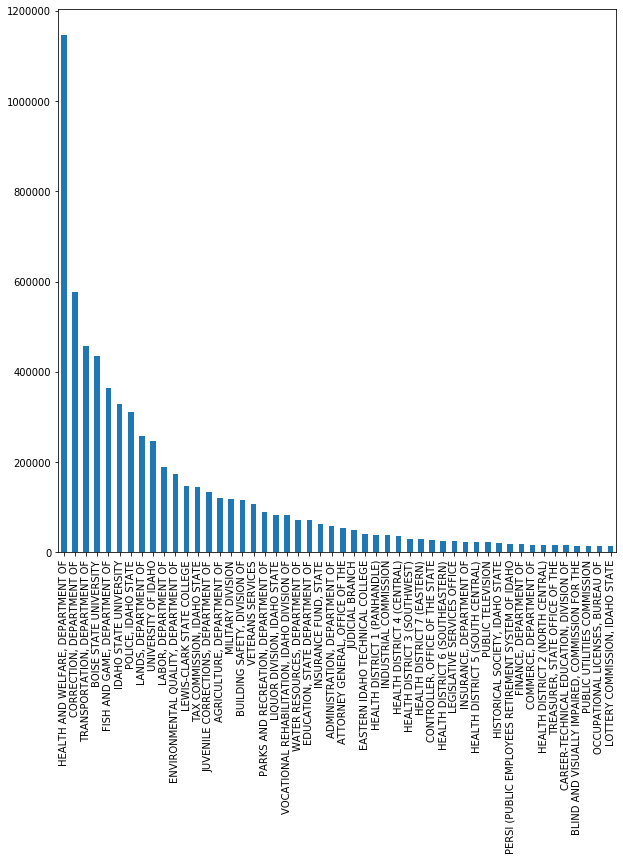

In [594]:
fy2018['Agency Name'].value_counts().head(50).plot.bar(figsize=(10,10))

In [595]:
fy2018['Fund Name'].value_counts().head(50)

GENERAL FUND                                  2061477
COOPERATIVE WELFARE FUND                      1134218
STATE HIGHWAY ACCOUNT                          450694
FEDERAL                                        449230
UNRESTRICTED CURRENT                           377924
FISH & GAME ACCOUNT                            355240
STATE REGULATORY FUNDS                         207908
PUBLIC HEALTH DISTRICT FUND                    189271
IDAHO LAW ENFORCEMENT FUND                     179912
DEPT OF ENVIRONMENTAL QUALITY FUND             171676
MISCELLANEOUS REVENUE                          155234
ENDOWMENT EARNINGS RESERVE FUNDS                90454
LIQUOR ACCOUNT                                  83732
DEPARTMENT OF LANDS                             78917
STATE INSURANCE FUND                            60101
PAYROLL LOCAL FUNDS                             50180
PARK AND RECREATION FUND                        35293
ADMINISTRATION AND ACCT SVCS                    33782
INDUSTRIAL ADMINISTRATION FU

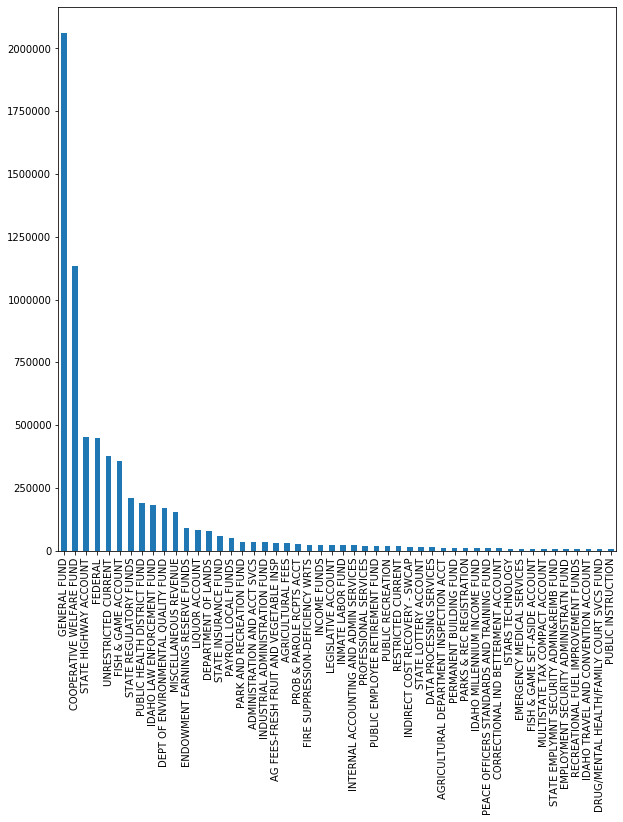

In [596]:
fy2018['Fund Name'].value_counts().head(50).plot.bar(figsize=(10,10))

In [597]:
fy2018['Program'].value_counts().head(50)

BOISE STATE UNIVERSITY                   431602
DIVISIONS OF PRISONS                     400438
HIGHWAY OPERATIONS                       332324
IDAHO STATE UNIVERSITY                   322546
ADMINISTRATION                           205638
PATROL                                   179128
GENERAL EDUCATION                        168818
SELF RELIANCE PROGRAMS                   167180
LEWIS-CLARK STATE COLLEGE                146269
ENHANCED MEDICAID PLAN                   120293
DIVISION OF COMMUNITY CORRECTIONS        119585
SAFETY COMPLIANCE                        117032
COORDINATED MEDICAID PLAN                112808
JUVENILE CORRECTIONS - INSTITUTIONS      110487
EMPLOYOYMENT SERVICES                    108324
CHILD WELFARE                            107793
DIVISION OF VETERANS SERVICES            106533
FOREST RESOURCES                          96844
STATE HOSPITAL SOUTH                      93001
FED/STATE AGREEMENTS                      89012
FISHERIES                               

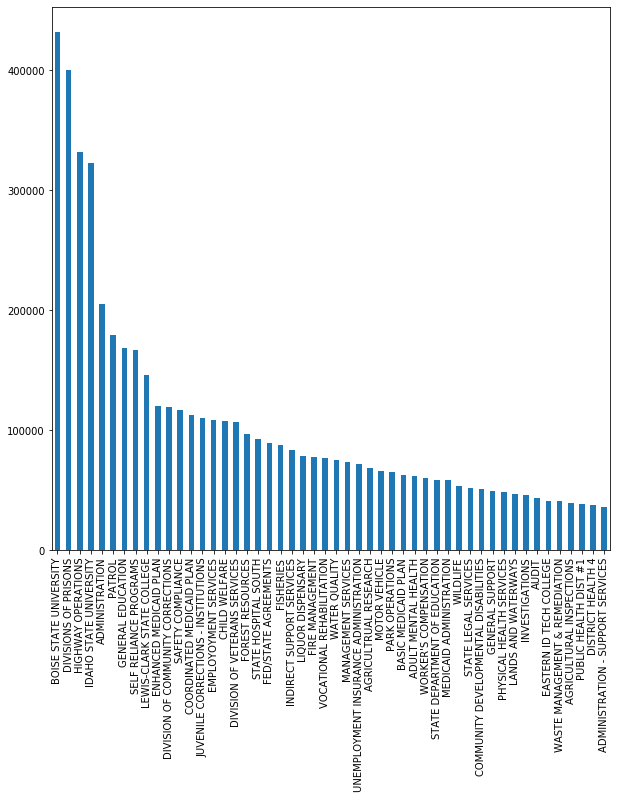

In [598]:
fy2018['Program'].value_counts().head(50).plot.bar(figsize=(10,10))

In [599]:
# Exploring fy2019Expenditures
fy2019.shape

(6512520, 22)

In [600]:
fy2019.describe()

,Unnamed: 0,Fiscal Year,GL Account Code,Agency Code,Amount,Area of Government,State Objective,Fund Code,Sub Object Code
count,6.512520e+06,6512520.0,6512520.0,6.512520e+06,6.512520e+06,6.512520e+06,6.512518e+06,6.512520e+06,6.512518e+06
mean,3.256260e+06,2019.0,4200.0,3.403270e+02,1.582903e+03,3.615972e+01,3.897721e+01,2.055274e+02,4.457391e+03
std,1.880003e+06,0.0,0.0,1.575486e+02,2.957688e+05,1.558937e+01,1.561802e+01,1.850581e+02,7.190568e+02
min,0.000000e+00,2019.0,4200.0,1.000000e+02,-1.663463e+07,1.000000e+01,1.100000e+01,1.000000e+00,4.105000e+03
25%,1.628130e+06,2019.0,4200.0,2.450000e+02,8.210000e+00,2.000000e+01,2.400000e+01,1.000000e+00,4.210000e+03
50%,3.256260e+06,2019.0,4200.0,2.850000e+02,5.020000e+01,4.000000e+01,4.200000e+01,2.200000e+02,4.225000e+03
75%,4.884389e+06,2019.0,4200.0,4.440000e+02,2.746200e+02,5.000000e+01,5.300000e+01,2.900000e+02,4.255000e+03
max,6.512519e+06,2019.0,4200.0,9.570000e+02,6.287345e+08,6.000000e+01,6.500000e+01,6.600000e+02,8.400000e+03


In [601]:
fy2019.columns

Index(['Unnamed: 0', 'Fiscal Year', 'GL Account Code', 'GL Account Name',
       'Agency Name', 'Agency Code', 'Amount', 'Effective Date',
       'Process Date', 'Area of Government', 'State Objective', 'Program',
       'Fund Code', 'Fund Name', 'Fund Detail', 'Fund Category', 'Object Name',
       'Summary Object Name', 'Sub Object Code', 'Sub Object Name',
       'Earn Ben Group', 'Vendor Name'],
      dtype='object')

In [602]:
fy2019['Vendor Name'].nunique()

71116

In [603]:
fy2019['Vendor Name'].value_counts().head(50)

POST PEND & ADJUSTMENT PROCESSING           37773
                                            21113
PCARD GENERIC VENDOR                         9988
OFFICE DEPOT INC                             8775
REDACTED                                     8553
OFFICE OF INFORMATION TECHNOLOGY SERVICE     5700
BOISE STATE UNIVERSITY                       4900
VERIZON WIRELESS SERVICES LLC                3723
PCARD - AMZN MKTP                            3576
QWEST COMMUNICATIONS COMPANY LLC             3461
PCARD - OFFICE DEPOT                         3371
UNIVERSITY OF IDAHO                          2962
ISU OFFICE OF FINANCE AND ADMINISTRATION     2641
BRADY INDUSTRIES                             2603
IDAHO POWER COMPANY                          2373
FEDEX                                        2324
WEX BANK                                     2318
SHAWNA K DENTON                              2213
ERIK S REAGER                                2208
FRED O SISNEROS                              2183


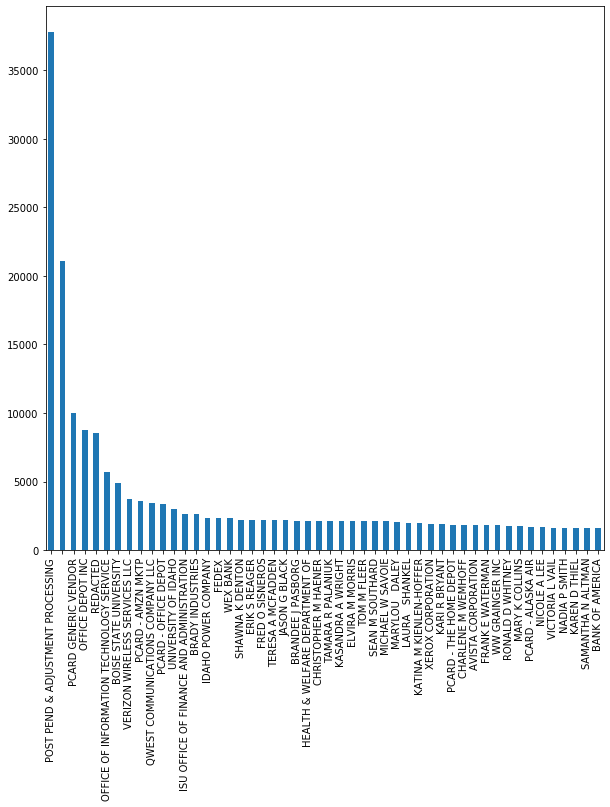

In [604]:
fy2019['Vendor Name'].value_counts().head(50).plot.bar(figsize=(10,10))

In [605]:
fy2019['Agency Name'].value_counts().head(50)

HEALTH AND WELFARE, DEPARTMENT OF                     1118622
CORRECTION, DEPARTMENT OF                              556956
TRANSPORTATION, DEPARTMENT OF                          451322
BOISE STATE UNIVERSITY                                 427548
FISH AND GAME, DEPARTMENT OF                           350392
IDAHO STATE UNIVERSITY                                 327751
POLICE, IDAHO STATE                                    308253
LANDS, DEPARTMENT OF                                   252415
UNIVERSITY OF IDAHO                                    235086
LABOR, DEPARTMENT OF                                   169899
ENVIRONMENTAL QUALITY, DEPARTMENT OF                   167278
LEWIS-CLARK STATE COLLEGE                              140871
TAX COMMISSION, IDAHO STATE                            139884
JUVENILE CORRECTIONS, DEPARTMENT OF                    128865
AGRICULTURE, DEPARTMENT OF                             120921
MILITARY DIVISION                                      119226
BUILDING

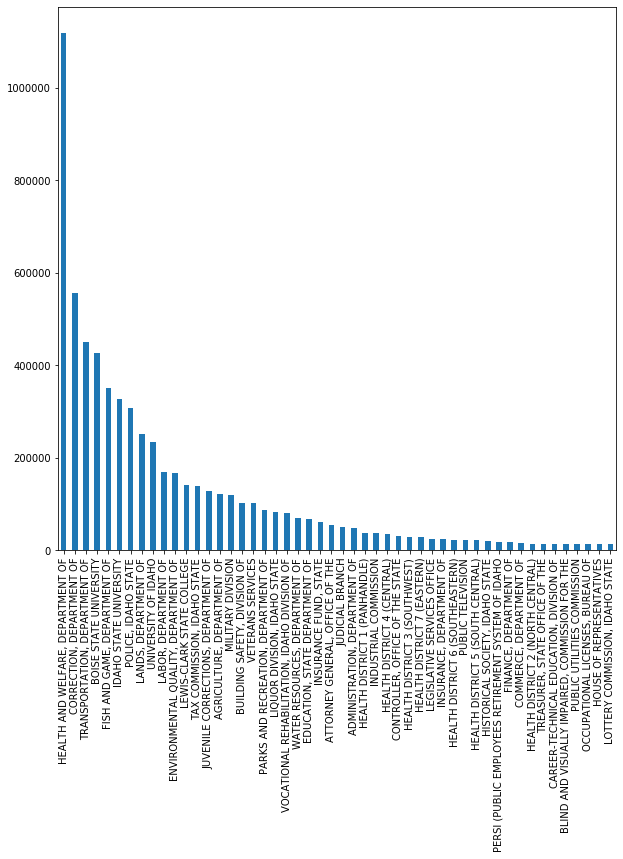

In [606]:
fy2019['Agency Name'].value_counts().head(50).plot.bar(figsize=(10,10))

In [607]:
fy2019['GL Account Name'].value_counts()

EXPENDITURES                                          6512520
Name: GL Account Name, dtype: int64

In [608]:
fy2019['Object Name'].value_counts()

PERSONNEL COSTS         5663294
OPERATING EXPENSES       483072
TRUSTEE/BENEFIT PYMT     356152
CAPITAL OUTLAY             9972
DEBT SERVICE                 28
NOT APPLICABLE                2
Name: Object Name, dtype: int64

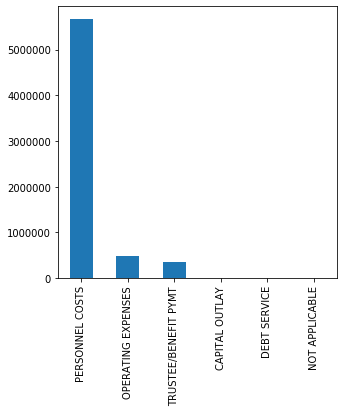

In [609]:
fy2019['Object Name'].value_counts().plot.bar(figsize=(5,5))

In [610]:
fy2019[fy2019['Object Name'] == 'PERSONNEL COSTS']['Summary Object Name'].value_counts()

EMPLOYEE BENEFITS      4469451
GROSS SALARY & WAGE    1193843
Name: Summary Object Name, dtype: int64

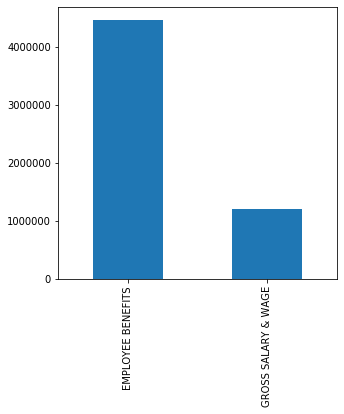

In [611]:
fy2019[fy2019['Object Name'] == 'PERSONNEL COSTS']['Summary Object Name'].value_counts().plot.bar(figsize=(5,5))

In [612]:
fy2019[fy2019['Object Name'] == 'OPERATING EXPENSES']['Summary Object Name'].value_counts()

EMPLOYEE TRAVEL COSTS         122249
COMMUNICATION COSTS            43703
REPAIR & MAINT SUPPLIES        39551
SPECIFIC USE SUPPLIES          37607
REPAIR & MAINT SVCS            34940
ADMINISTRATIVE SUPPLIES        29452
PROFESSIONAL SERVICES          24422
UTILITY CHARGES                23182
GENERAL SERVICES               23099
MISC EXPENDITURES              21277
RENTALS & OPER LEASES          17462
EMPLOYEE DEVELOPMENT COSTS     15196
INST & RESIDENT SUPPLIES       11683
COMPUTER SUPPLIES               9313
FUEL & LUBRICANTS COSTS         8121
COMPUTER SERVICES               7480
MFG & MERCH COSTS               6779
ADMINISTRATIVE SERVICES         6361
INSURANCE                       1195
Name: Summary Object Name, dtype: int64

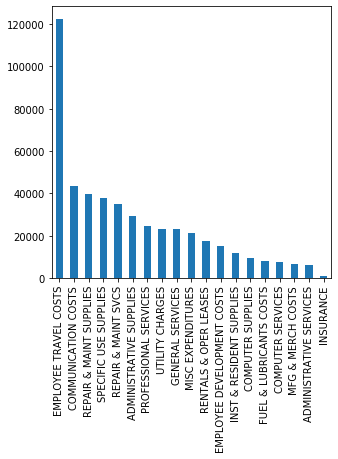

In [613]:
fy2019[fy2019['Object Name'] == 'OPERATING EXPENSES']['Summary Object Name'].value_counts().plot.bar(figsize=(5,5))

In [614]:
fy2019[fy2019['Object Name'] == 'TRUSTEE/BENEFIT PYMT']['Summary Object Name'].value_counts()

AWARDS CONTR & CLAIMS       316828
FED PMTS TO SUBGRANTEES      12163
MISC PMTS AS AGENT           10675
EDUC & TRAIN ASSISTANCE      10350
NON FED PMTS SUBGRANTEES      5685
PENSION PAYMENTS               451
Name: Summary Object Name, dtype: int64

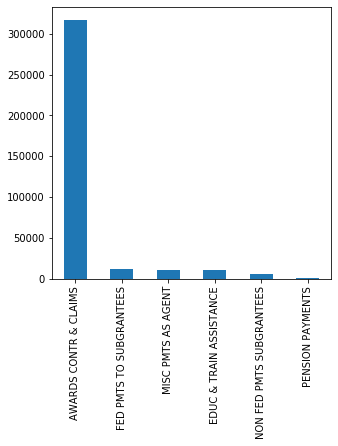

In [615]:
fy2019[fy2019['Object Name'] == 'TRUSTEE/BENEFIT PYMT']['Summary Object Name'].value_counts().plot.bar(figsize=(5,5))

In [616]:
fy2019[fy2019['Object Name'] == 'CAPITAL OUTLAY']['Summary Object Name'].value_counts()

PROPERTY & IMPROVEMENTS          3199
BLDG & IMPROVEMENTS              2932
COMPUTER EQUIPMENT               1182
SPECIFIC USE EQUIPMENT           1096
MOTORIZED/NON-MOTORIZED EQUIP     675
OFFICE EQUIPMENT                  367
SITE DEVELOPMENTS                 345
EDUC MATERIAL & EQUIP             131
CAPITALIZED LEASES                 41
MISCELLANEOUS CAPITAL OUTLAY        3
NATURAL RESOURCES                   1
Name: Summary Object Name, dtype: int64

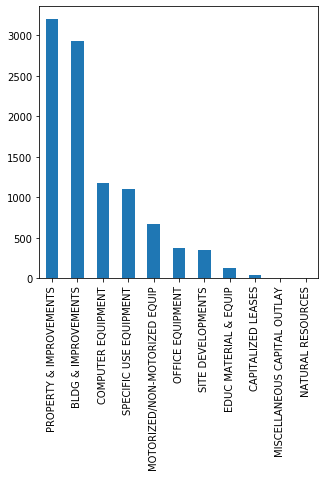

In [617]:
fy2019[fy2019['Object Name'] == 'CAPITAL OUTLAY']['Summary Object Name'].value_counts().plot.bar(figsize=(5,5))

In [618]:
fy2019[fy2019['Object Name'] == 'DEBT SERVICE']['Summary Object Name'].value_counts()

BONDS    28
Name: Summary Object Name, dtype: int64

In [619]:
fy2019['Summary Object Name'].value_counts()

EMPLOYEE BENEFITS                4469451
GROSS SALARY & WAGE              1193843
AWARDS CONTR & CLAIMS             316828
EMPLOYEE TRAVEL COSTS             122249
COMMUNICATION COSTS                43703
REPAIR & MAINT SUPPLIES            39551
SPECIFIC USE SUPPLIES              37607
REPAIR & MAINT SVCS                34940
ADMINISTRATIVE SUPPLIES            29452
PROFESSIONAL SERVICES              24422
UTILITY CHARGES                    23182
GENERAL SERVICES                   23099
MISC EXPENDITURES                  21277
RENTALS & OPER LEASES              17462
EMPLOYEE DEVELOPMENT COSTS         15196
FED PMTS TO SUBGRANTEES            12163
INST & RESIDENT SUPPLIES           11683
MISC PMTS AS AGENT                 10675
EDUC & TRAIN ASSISTANCE            10350
COMPUTER SUPPLIES                   9313
FUEL & LUBRICANTS COSTS             8121
COMPUTER SERVICES                   7480
MFG & MERCH COSTS                   6779
ADMINISTRATIVE SERVICES             6361
NON FED PMTS SUB

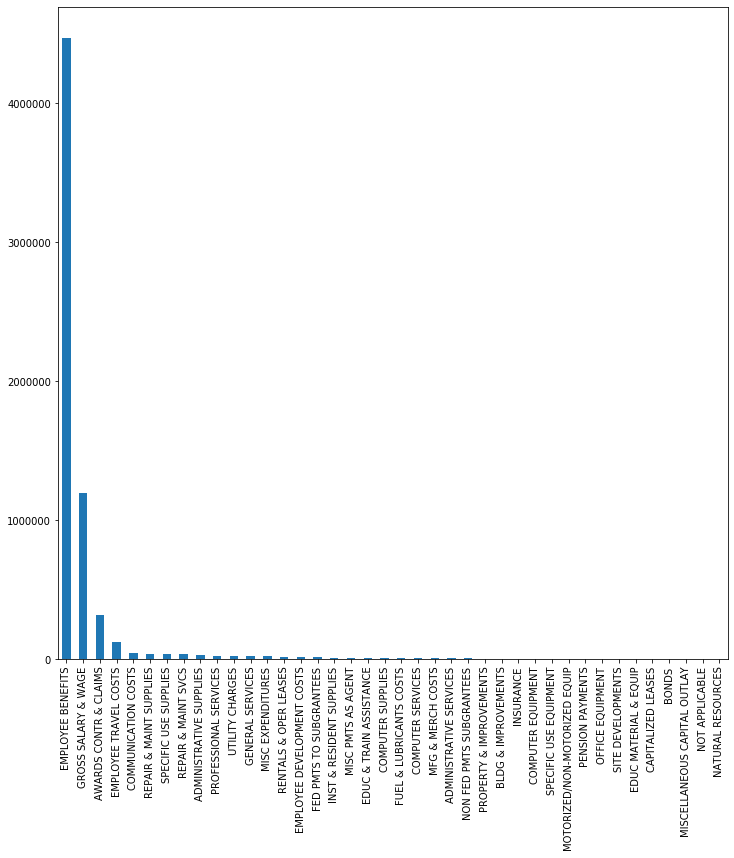

In [620]:
fy2019['Summary Object Name'].value_counts().plot.bar(figsize=(12,12))

In [621]:
fy2018['Sub Object Name'].value_counts().head(50)

EMPLOYEES                                   1058599
GROUP INSURANCE HEALTH & ACCIDENT            999703
F. I. C. A.                                  618695
WORKER'S COMPENSATION                        612531
EMPLOYMENT SECURITY                          607440
EMPLOYER RETIREMENT CONTRIBUTION             582060
RETIREMENT SICK LEAVE                        578969
PERSONNEL COMMISSION                         393777
MEDICAL ASSISTANCE-VENDORS                   302432
GROUP INSURANCE LIFE                         277930
EMPLOYEES - TEMPORARY                         47967
SHIFT DIFFERENTIAL                            38205
OVERTIME COVERED BY FLSA                      38053
SUBSISTENCE IN-STATE                          26349
OFFICE SUPPLIES                               21986
LODGING - IN STATE                            19344
VEHICLE SERVCS                                16011
PERSONAL VEHICLE - IN-STATE                   14336
CELLULAR/WIRELESS VOICE SERVICE               13884
BUILDING-SUP

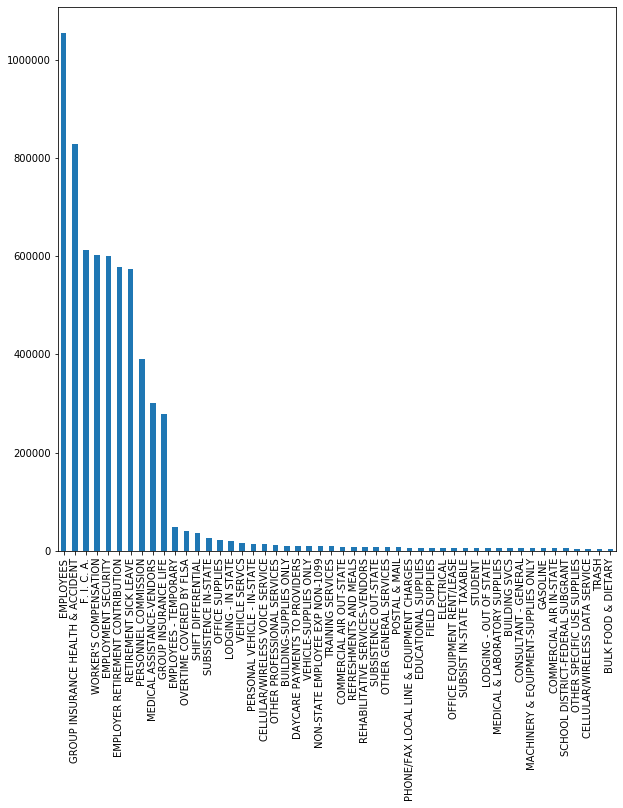

In [622]:
fy2019['Sub Object Name'].value_counts().head(50).plot.bar(figsize=(10,10))

In [623]:
fy2019[fy2019['Summary Object Name'] == 'EMPLOYEE BENEFITS']['Sub Object Name'].value_counts()

GROUP INSURANCE HEALTH & ACCIDENT         829853
F. I. C. A.                               612794
WORKER'S COMPENSATION                     601817
EMPLOYMENT SECURITY                       601674
EMPLOYER RETIREMENT CONTRIBUTION          578016
RETIREMENT SICK LEAVE                     575031
PERSONNEL COMMISSION                      390837
GROUP INSURANCE LIFE                      278003
ANNUAL LEAVE BALANCES                        678
JUDGES RETIREMENT                            624
MEDICARE - U OF I                            112
PERSI PRIOR YEAR EMPLOYER CONTRIBUTION        12
Name: Sub Object Name, dtype: int64

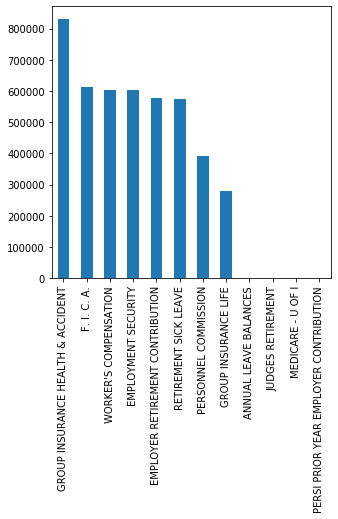

In [624]:
fy2019[fy2019['Summary Object Name'] == 'EMPLOYEE BENEFITS']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [625]:
fy2019[fy2019['Summary Object Name'] == 'AWARDS CONTR & CLAIMS']['Sub Object Name'].value_counts()

MEDICAL ASSISTANCE-VENDORS                            300407
DAYCARE PAYMENTS TO PROVIDERS                          10046
INCOME ASSISTANCE PAYMENTS                              1779
PREMIUMS                                                 669
RISK MANAGEMENT PAYMENTS NON-1099                        618
OTHER AWARDS/CONTRIBUTIONS/CLAIMS                        562
WORKER COMPENSATION AWARDS                               418
RISK MANAGEMENT PAYMENTS                                 390
CRIME VICTIMS COMPENSATION-1099 MED                      337
PRIZE PAYMENTS                                           333
UNEMPLOYMENT COMPENSATION BENEFITS                       330
CRIME VICTIMS COMPENSATION-1099                          226
MEDICAL ASSISTANCE-INDIVIDUALS                           191
CRIME VICTIMS COMPENSATION-NON-1099                      170
PRIZE & AWARDS-1099BX3                                   133
SPECIAL INDEMNITY PAYMENTS                                77
SPECIAL INDEMNITY PAYMEN

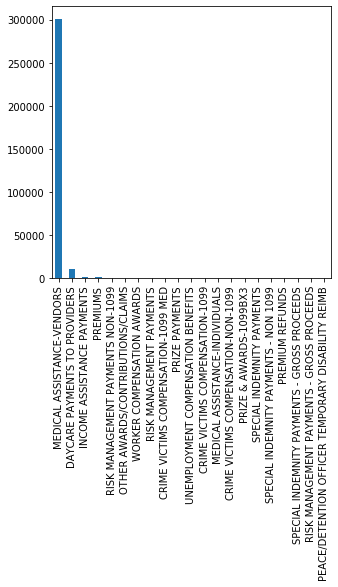

In [626]:
fy2019[fy2019['Summary Object Name'] == 'AWARDS CONTR & CLAIMS']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [627]:
fy2019[fy2019['Summary Object Name'] == 'GROSS SALARY & WAGE']['Sub Object Name'].value_counts()

EMPLOYEES                     1054877
EMPLOYEES - TEMPORARY           47998
OVERTIME COVERED BY FLSA        40176
SHIFT DIFFERENTIAL              36812
STUDENT                          5912
SPORADIC SPECIAL PAY             4193
BOARD/COMMISSION MEMBERS         2467
OVERTIME EXEMPT FROM FLSA        1125
COMPENSATORY LEAVE BALANCE        186
PAYROLL REIMBURSEMENTS             60
EMPLOYEE-EMERGENCY HELP            37
Name: Sub Object Name, dtype: int64

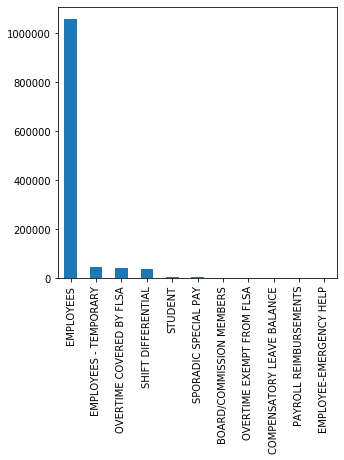

In [628]:
fy2019[fy2019['Summary Object Name'] == 'GROSS SALARY & WAGE']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [629]:
fy2019[fy2019['Summary Object Name'] == 'EMPLOYEE TRAVEL COSTS']['Sub Object Name'].value_counts()

SUBSISTENCE IN-STATE                        26290
LODGING - IN STATE                          19414
PERSONAL VEHICLE - IN-STATE                 14812
COMMERCIAL AIR OUT-STATE                     8591
REFRESHMENTS AND MEALS                       7942
SUBSISTENCE OUT-STATE                        7148
SUBSIST IN-STATE TAXABLE                     6072
LODGING - OUT OF STATE                       5887
COMMERCIAL AIR IN-STATE                      4960
PUBLIC CONVEYANCE OUT-STATE                  3826
RENTAL VEHICLES-IN-STATE                     2831
RENTAL VEHICLE MISC IN-STATE NON-1099        2190
PUBLIC CONVEYANCE IN-STATE                   2136
OTHER EMPLOYEE TRAVEL COSTS                  1888
P CARD BANKING/ATM FEES                      1791
RENTAL VEHICLES-OUT-STATE                    1506
PERSONAL VEHICLE - OUT-STATE                 1315
PCARD CASH ADVANCES                          1314
RENTAL VEHICLE MISC OUT-OF-STATE NON-109      640
EMPLOYEE COMMUNICATION CHARGES                416


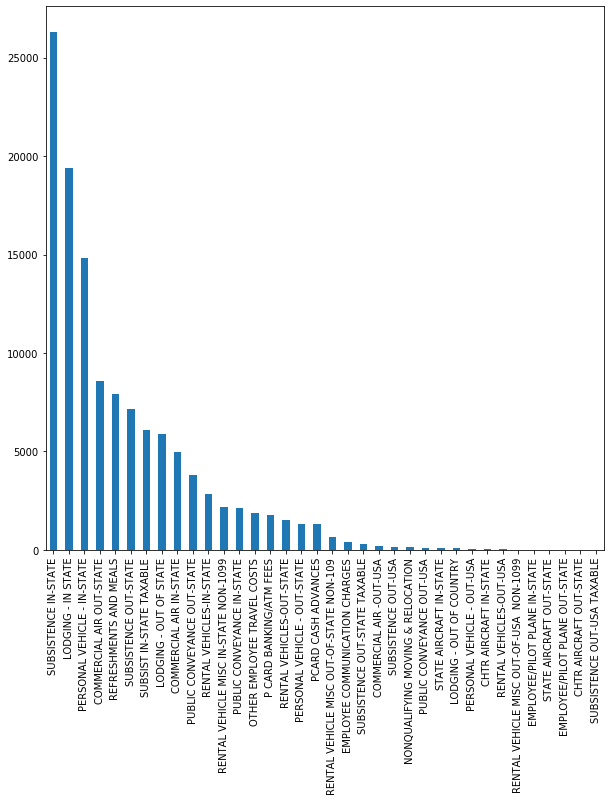

In [630]:
fy2019[fy2019['Summary Object Name'] == 'EMPLOYEE TRAVEL COSTS']['Sub Object Name'].value_counts().plot.bar(figsize=(10,10))

In [631]:
fy2019[fy2019['Summary Object Name'] == 'COMPUTER EQUIPMENT']['Sub Object Name'].value_counts()

PERSONAL COMPUTER HARDWARE                  553
OTHER COMPUTER EQUIPMENT                    137
NETWORKING HARDWARE                         128
PERIPHERAL EQUIPMENT                        127
SERVER AND STORAGE HARDWARE                 119
TELEPHONE AND VOIP EQUIPMENT                 83
INTANGIBLE SOFTWARE - INTERNALLY DEVELOP     18
CYBER-SECURITY HARDWARE                      11
INTANGIBLE SOFTWARE - PURCHASED OVER $20      5
MAINFRAME COMPUTER HARDWARE                   1
Name: Sub Object Name, dtype: int64

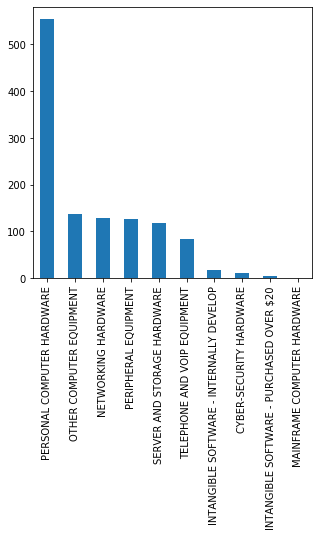

In [632]:
fy2019[fy2019['Summary Object Name'] == 'COMPUTER EQUIPMENT']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [633]:
fy2019[fy2019['Summary Object Name'] == 'COMPUTER SUPPLIES']['Sub Object Name'].value_counts()

OTHER COMPUTER SUPPLIES               3452
PERSONAL COMPUTER SOFTWARE            2118
PERIPHERAL EQUIPMENT                  1902
PERSONAL COMPUTER HARDWARE            1112
SERVER AND STORAGE SOFTWARE            223
NETWORKING HARDWARE                    186
CYBER-SECURITY SOFTWARE                 97
SERVER AND STORAGE HARDWARE             86
NETWORKING SOFTWARE                     69
ENTERPRISE RESOURCE PLANNING (ERP)      39
CYBER-SECURITY HARDWARE                 18
MAINFRAME COMPUTER SOFTWARE              7
MAINFRAME COMPUTER HARDWARE              4
Name: Sub Object Name, dtype: int64

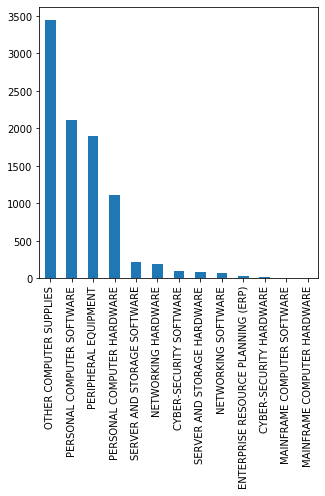

In [634]:
fy2019[fy2019['Summary Object Name'] == 'COMPUTER SUPPLIES']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [635]:
fy2019[fy2019['Summary Object Name'] == 'INSURANCE']['Sub Object Name'].value_counts()

OTHER INSURANCE                     346
LIABILITY, ALL                      341
PROPERTY, ALL                       251
AUTO PHYSICAL DAMAGE                182
GROUP LIFE DISABILITY PREMIUMS       34
AVIATION INSURANCE                   24
EMPLOYEE BONDS                        9
WORKER COMPENSATION NON EMPLOYEE      6
FIRE                                  2
Name: Sub Object Name, dtype: int64

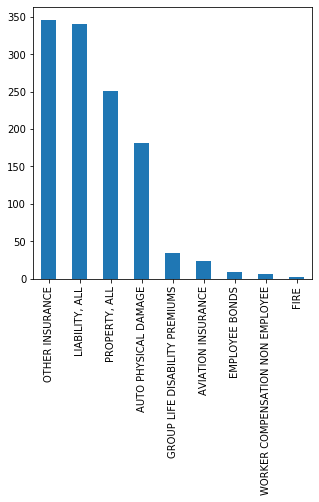

In [636]:
fy2019[fy2019['Summary Object Name'] == 'INSURANCE']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [637]:
fy2019[fy2019['Summary Object Name'] == 'PROFESSIONAL SERVICES']['Sub Object Name'].value_counts()

OTHER PROFESSIONAL SERVICES                10990
CONSULTANT - GENERAL                        5208
ADV ERTISING & LEGAL NOTICES                2214
INTERPRETERS/TRANSLATION                    1409
PROMOTION/PUBLICITY                         1407
LEGAL FEES                                   854
CONSULTANT - MEDICAL                         825
ACCOUNTING                                   406
AUDITING                                     320
COURT REPORTING                              225
CONSULTANT - PUBLIC RELATIONS                153
CONSULTANT - ARCHITECTS AND ENGINEERING      125
HEARING OFFICER                              104
CONSULTANT - LEGAL                            82
BROKERAGE FEES                                80
BROKERAGE FEES -  STATE INSURANCE FUND        20
Name: Sub Object Name, dtype: int64

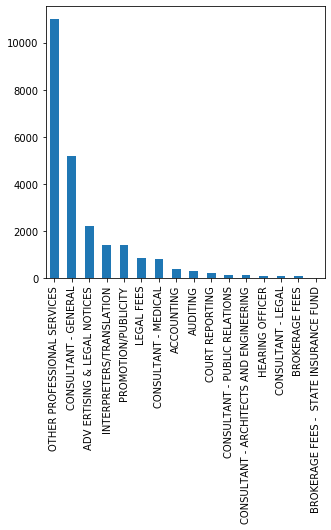

In [638]:
fy2019[fy2019['Summary Object Name'] == 'PROFESSIONAL SERVICES']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [639]:
fy2019[fy2019['Summary Object Name'] == 'GENERAL SERVICES']['Sub Object Name'].value_counts()

OTHER GENERAL SERVICES                                6935
LAUNDRY                                               3283
MEDICAL                                               2711
DOCUMENT MANAGEMENT/RECYCLING                         1817
GROUP PUBLICATIONS, SUBSCRIPTIONS & MEMB              1395
LANDSCAPING AND WEED CONTROL                          1223
EDUCATIONAL TESTING, GRADING                           910
ENVIRONMENTAL OR ECOLOGICAL TESTING                    780
TEMPORARY PERSONNEL                                    773
SECURITY PATROL OR ALARM SERVICES                      747
CLERICAL                                               677
INSTITUTIONAL SERVICES                                 453
HONORARIA                                              359
NON EMPLOYEE TRAINING-VENDOR PAYMENTS-10               248
NON EMPLOYEE TRAINING-REIMBURSEMENTS-NON               245
LIVESTOCK/VETERINARY EQUIPMENT TESTING                 205
GENERAL LABORATORY EQUIPMENT TESTING OR INSPECTION      

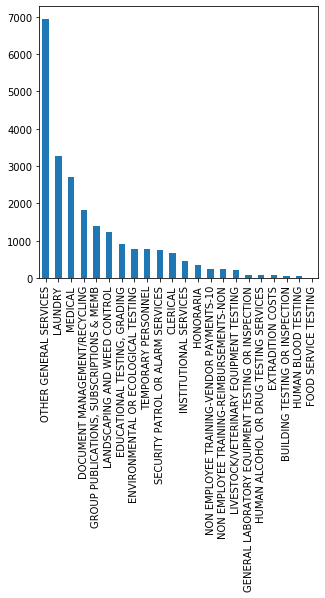

In [640]:
fy2019[fy2019['Summary Object Name'] == 'GENERAL SERVICES']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [641]:
fy2019[fy2019['Summary Object Name'] == 'ADMINISTRATIVE SERVICES']['Sub Object Name'].value_counts()

PRINTING SERVICES                      2345
PHOTOCOPYING SERVICES                  1761
FREIGHT SERVICES                       1544
OTHER ADMINISTRATIVE SERVICES           495
PHOTOGRAPHIC SERVICES                   192
MICROFILM, MICROFICHE & CD SERVICES      17
BINDING SERVICES                          7
Name: Sub Object Name, dtype: int64

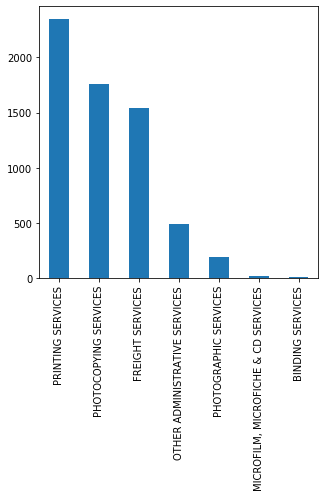

In [642]:
fy2019[fy2019['Summary Object Name'] == 'ADMINISTRATIVE SERVICES']['Sub Object Name'].value_counts().plot.bar(figsize=(5,5))

In [643]:
fy2019['Fund Name'].value_counts().head(50)

GENERAL FUND                                  1992458
COOPERATIVE WELFARE FUND                      1107375
STATE HIGHWAY ACCOUNT                          445260
FEDERAL                                        439793
UNRESTRICTED CURRENT                           364408
FISH & GAME ACCOUNT                            340452
STATE REGULATORY FUNDS                         194437
PUBLIC HEALTH DISTRICT FUND                    182889
IDAHO LAW ENFORCEMENT FUND                     174668
DEPT OF ENVIRONMENTAL QUALITY FUND             164566
MISCELLANEOUS REVENUE                          145491
ENDOWMENT EARNINGS RESERVE FUNDS                86574
LIQUOR ACCOUNT                                  83313
DEPARTMENT OF LANDS                             77947
STATE INSURANCE FUND                            60232
PAYROLL LOCAL FUNDS                             47102
PARK AND RECREATION FUND                        35600
ADMINISTRATION AND ACCT SVCS                    33584
INDUSTRIAL ADMINISTRATION FU

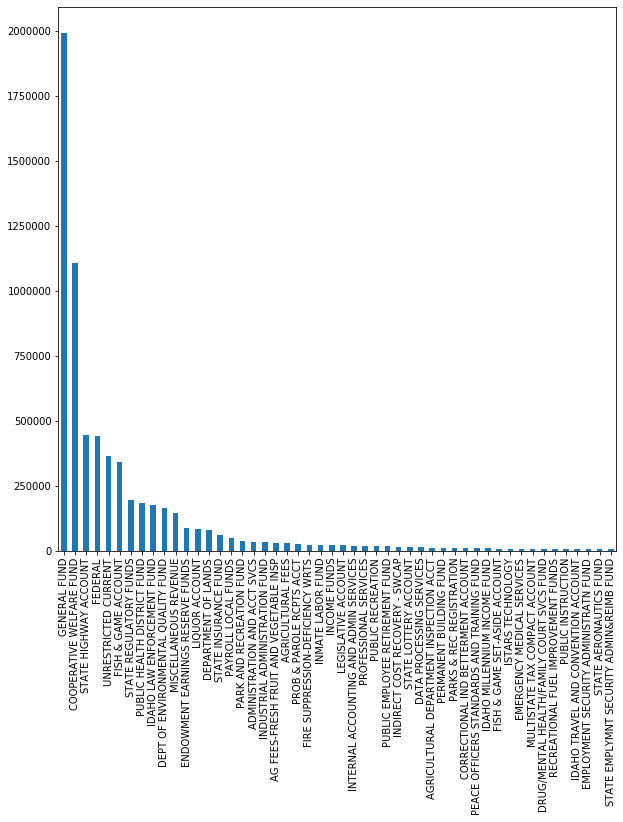

In [644]:
fy2019['Fund Name'].value_counts().head(50).plot.bar(figsize=(10,10))

In [645]:
fy2019['Program'].value_counts().head(50)

BOISE STATE UNIVERSITY                   425233
DIVISIONS OF PRISONS                     385908
HIGHWAY OPERATIONS                       325672
IDAHO STATE UNIVERSITY                   320874
ADMINISTRATION                           200821
PATROL                                   180477
GENERAL EDUCATION                        161855
SELF RELIANCE PROGRAMS                   160956
LEWIS-CLARK STATE COLLEGE                140871
ENHANCED MEDICAID PLAN                   120895
DIVISION OF COMMUNITY CORRECTIONS        115025
COORDINATED MEDICAID PLAN                110898
CHILD WELFARE                            107978
JUVENILE CORRECTIONS - INSTITUTIONS      106554
SAFETY COMPLIANCE                        103394
DIVISION OF VETERANS SERVICES            101949
FOREST RESOURCES                          96995
EMPLOYOYMENT SERVICES                     93683
FED/STATE AGREEMENTS                      90955
STATE HOSPITAL SOUTH                      90235
INDIRECT SUPPORT SERVICES               

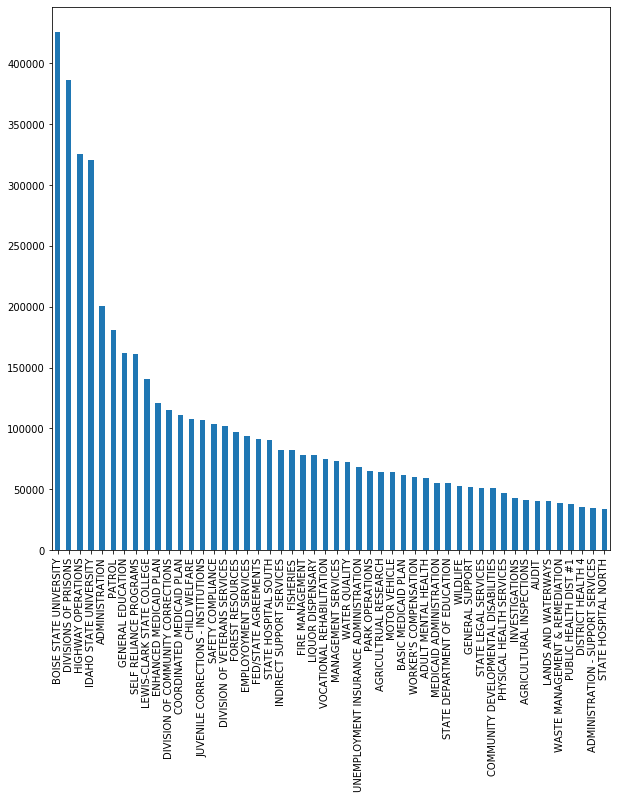

In [646]:
fy2019['Program'].value_counts().head(50).plot.bar(figsize=(10,10))

In [647]:
fy2019.columns

Index(['Unnamed: 0', 'Fiscal Year', 'GL Account Code', 'GL Account Name',
       'Agency Name', 'Agency Code', 'Amount', 'Effective Date',
       'Process Date', 'Area of Government', 'State Objective', 'Program',
       'Fund Code', 'Fund Name', 'Fund Detail', 'Fund Category', 'Object Name',
       'Summary Object Name', 'Sub Object Code', 'Sub Object Name',
       'Earn Ben Group', 'Vendor Name'],
      dtype='object')

**Question 4** (45 points) <br/>
Perform year-over-year analysis of expenses for at least the following: `Agency Name`, `Summary Object Name`, `Sub Object Name`, and `Vendor Names`. What is the average increase/decrease? Identify outliers. Investigate further as you see fit. Use visualizations as appropriate.

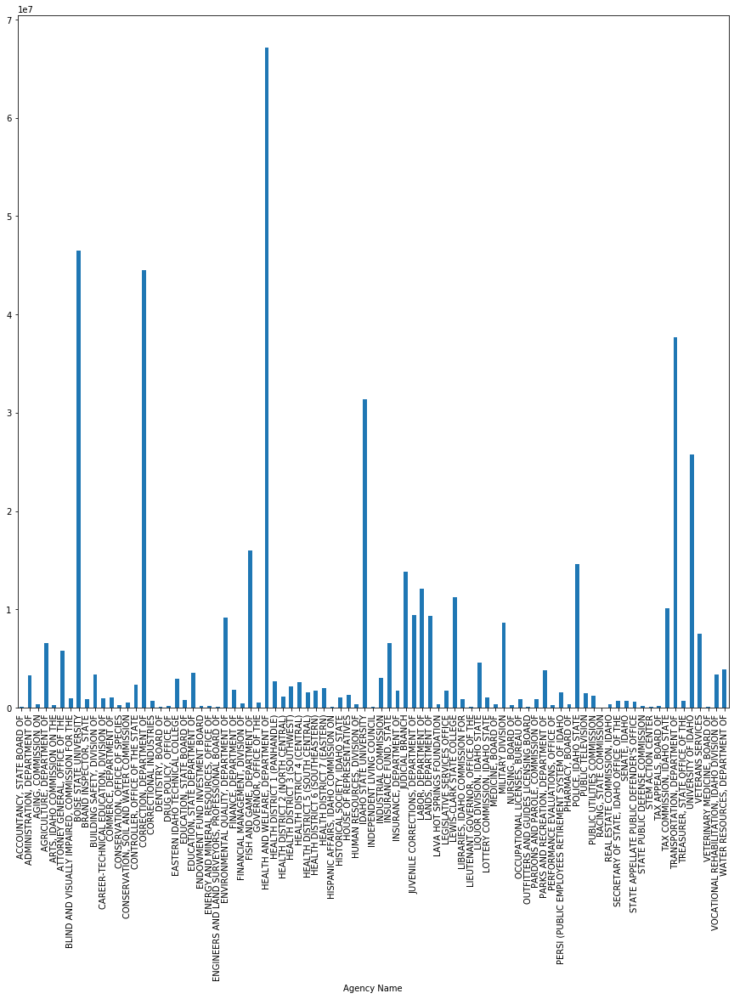

In [648]:
grouped_emply_benefits_agency_2018 = fy2018[fy2018['Summary Object Name'] == 'EMPLOYEE BENEFITS'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_emply_benefits_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(15,15))

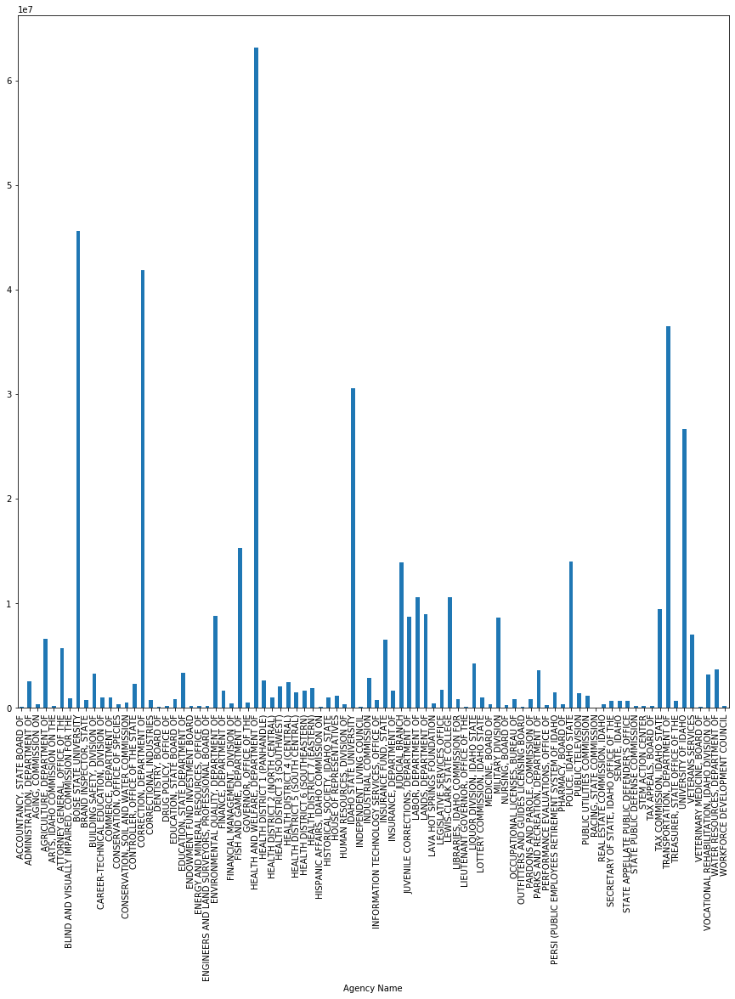

In [649]:
grouped_emply_benefits_agency_2019 = fy2019[fy2019['Summary Object Name'] == 'EMPLOYEE BENEFITS'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_emply_benefits_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(15,15))

In [650]:
grouped_emply_benefits_agency_agg_sum_2018 = grouped_emply_benefits_agency_2018['Amount'].agg(np.sum)
grouped_emply_benefits_agency_max_sum_2018 = grouped_emply_benefits_agency_agg_sum_2018.max()
grouped_emply_benefits_agency_max_name_sum_2018 = grouped_emply_benefits_agency_agg_sum_2018.idxmax()

grouped_emply_benefits_agency_agg_sum_2019 = grouped_emply_benefits_agency_2019['Amount'].agg(np.sum)
grouped_emply_benefits_agency_max_sum_2019 = grouped_emply_benefits_agency_agg_sum_2019.max()
grouped_emply_benefits_agency_max_name_sum_2019 = grouped_emply_benefits_agency_agg_sum_2019.idxmax()

print("For 2018, " + grouped_emply_benefits_agency_max_name_sum_2018 + " had the most expenditure for the total cost of all Employee Benefits at " + str(grouped_emply_benefits_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_emply_benefits_agency_max_name_sum_2019 + " had the most expenditure for the total cost of all Employee Benefits at " + str(grouped_emply_benefits_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_emply_benefits_agency_max_sum_2019 - grouped_emply_benefits_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of all Employee Benefits at 67115738.84996285.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of all Employee Benefits at 63100259.57002909.
The average increase/decrease was -4015479.279933758 between 2018 and 2019.


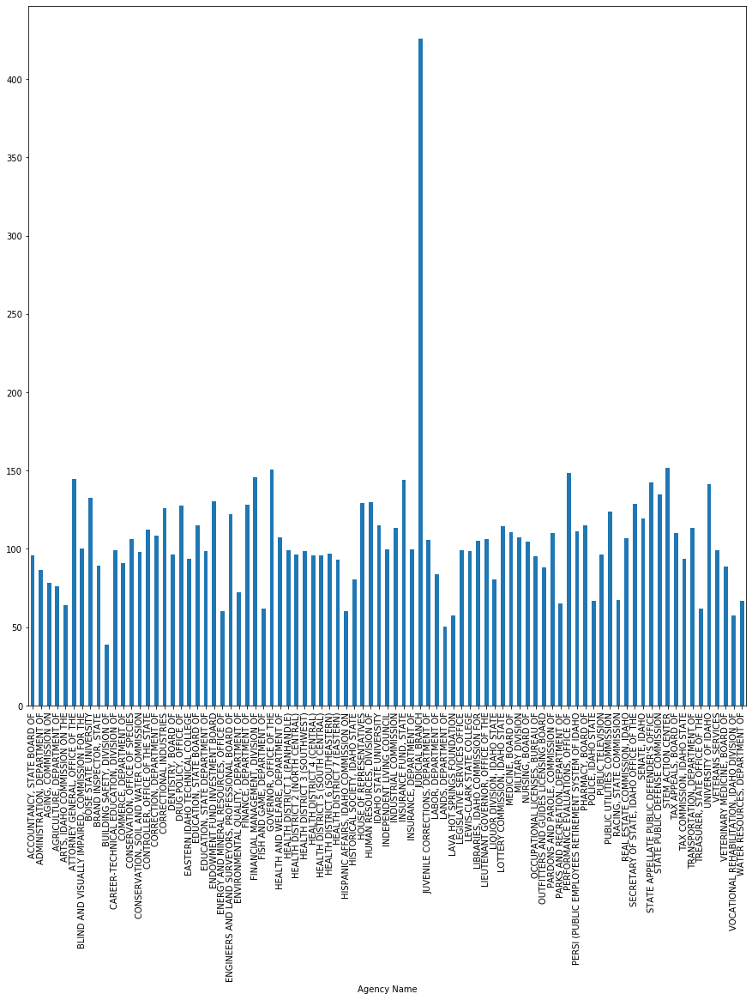

In [651]:
grouped_emply_benefits_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(15,15))

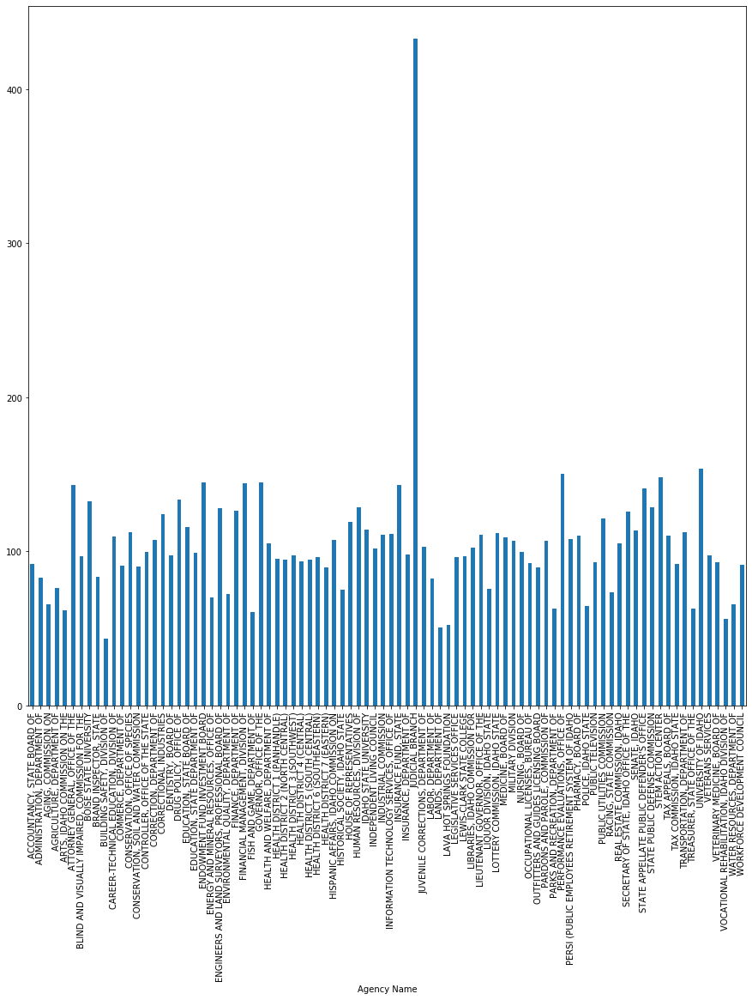

In [652]:
grouped_emply_benefits_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(15,15))

In [653]:
grouped_emply_benefits_agency_agg_mean_2018 = grouped_emply_benefits_agency_2018['Amount'].agg(np.mean)
grouped_emply_benefits_agency_max_mean_2018 = grouped_emply_benefits_agency_agg_mean_2018.max()
grouped_emply_benefits_agency_max_name_mean_2018 = grouped_emply_benefits_agency_agg_mean_2018.idxmax()

grouped_emply_benefits_agency_agg_mean_2019 = grouped_emply_benefits_agency_2019['Amount'].agg(np.mean)
grouped_emply_benefits_agency_max_mean_2019 = grouped_emply_benefits_agency_agg_mean_2019.max()
grouped_emply_benefits_agency_max_name_mean_2019 = grouped_emply_benefits_agency_agg_mean_2019.idxmax()

print("For 2018, " + grouped_emply_benefits_agency_max_name_mean_2018 + " had the most expenditure for the average cost of all Employee Benefits at " + str(grouped_emply_benefits_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_emply_benefits_agency_max_name_mean_2019 + " had the most expenditure for the average cost of all Employee Benefits at " + str(grouped_emply_benefits_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_emply_benefits_agency_max_mean_2019 - grouped_emply_benefits_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, JUDICIAL BRANCH had the most expenditure for the average cost of all Employee Benefits at 425.6106857054406.
For 2019, JUDICIAL BRANCH had the most expenditure for the average cost of all Employee Benefits at 432.6218038567365.
The average increase/decrease was 7.011118151295932 between 2018 and 2019.


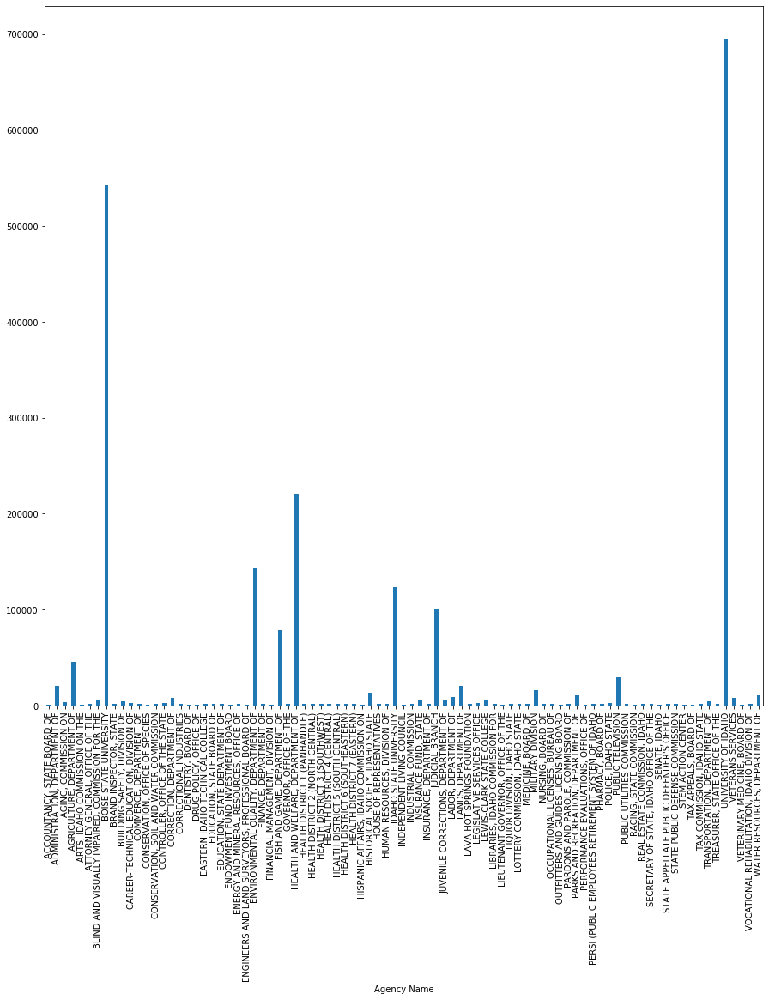

In [654]:
grouped_emply_benefits_agency_2018['Amount'].agg(np.max).plot.bar(figsize=(15,15))

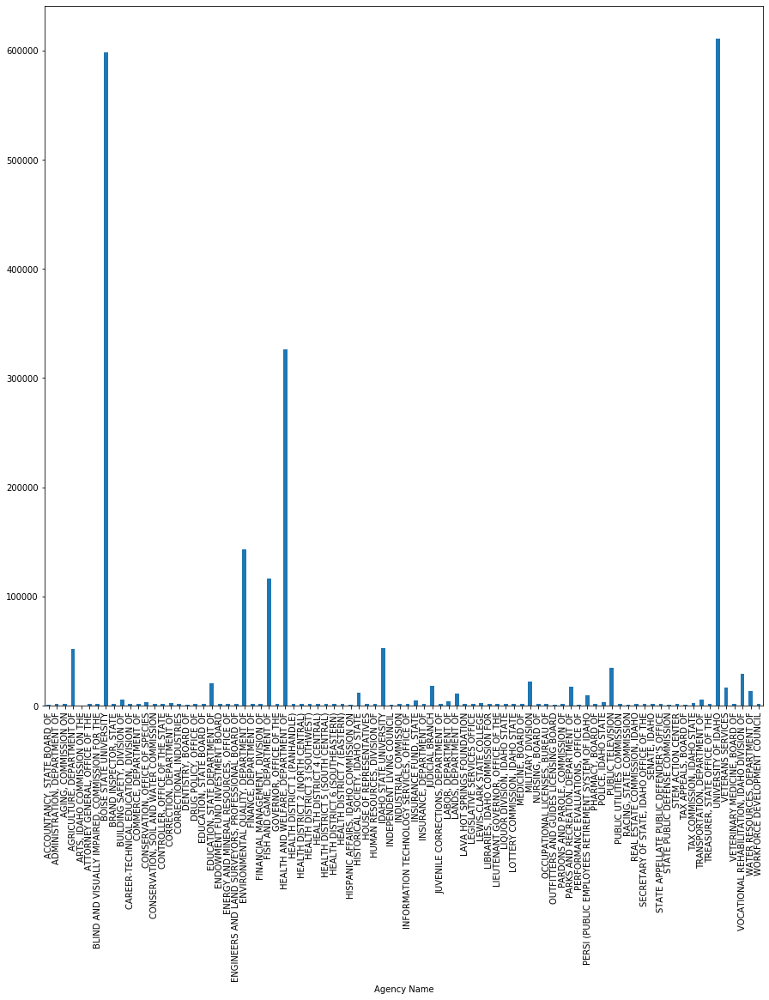

In [655]:
grouped_emply_benefits_agency_2019['Amount'].agg(np.max).plot.bar(figsize=(15,15))

In [656]:
grouped_emply_benefits_agency_agg_max_2018 = grouped_emply_benefits_agency_2018['Amount'].agg(np.max)
grouped_emply_benefits_agency_max_max_2018 = grouped_emply_benefits_agency_agg_max_2018.max()
grouped_emply_benefits_agency_max_name_max_2018 = grouped_emply_benefits_agency_agg_max_2018.idxmax()

grouped_emply_benefits_agency_agg_max_2019 = grouped_emply_benefits_agency_2019['Amount'].agg(np.max)
grouped_emply_benefits_agency_max_max_2019 = grouped_emply_benefits_agency_agg_max_2019.max()
grouped_emply_benefits_agency_max_name_max_2019 = grouped_emply_benefits_agency_agg_max_2019.idxmax()

print("For 2018, " + grouped_emply_benefits_agency_max_name_max_2018 + " had the most expenditure for the maximum cost of all Employee Benefits at " + str(grouped_emply_benefits_agency_max_max_2018) + ".")
print("For 2019, " + grouped_emply_benefits_agency_max_name_max_2019 + " had the most expenditure for the maximum cost of all Employee Benefits at " + str(grouped_emply_benefits_agency_max_max_2019) + ".")
print("The average increase/decrease was " + str(grouped_emply_benefits_agency_max_max_2019 - grouped_emply_benefits_agency_max_max_2018) + " between 2018 and 2019.")

For 2018, UNIVERSITY OF IDAHO had the most expenditure for the maximum cost of all Employee Benefits at 694765.8.
For 2019, UNIVERSITY OF IDAHO had the most expenditure for the maximum cost of all Employee Benefits at 610560.6.
The average increase/decrease was -84205.20000000007 between 2018 and 2019.


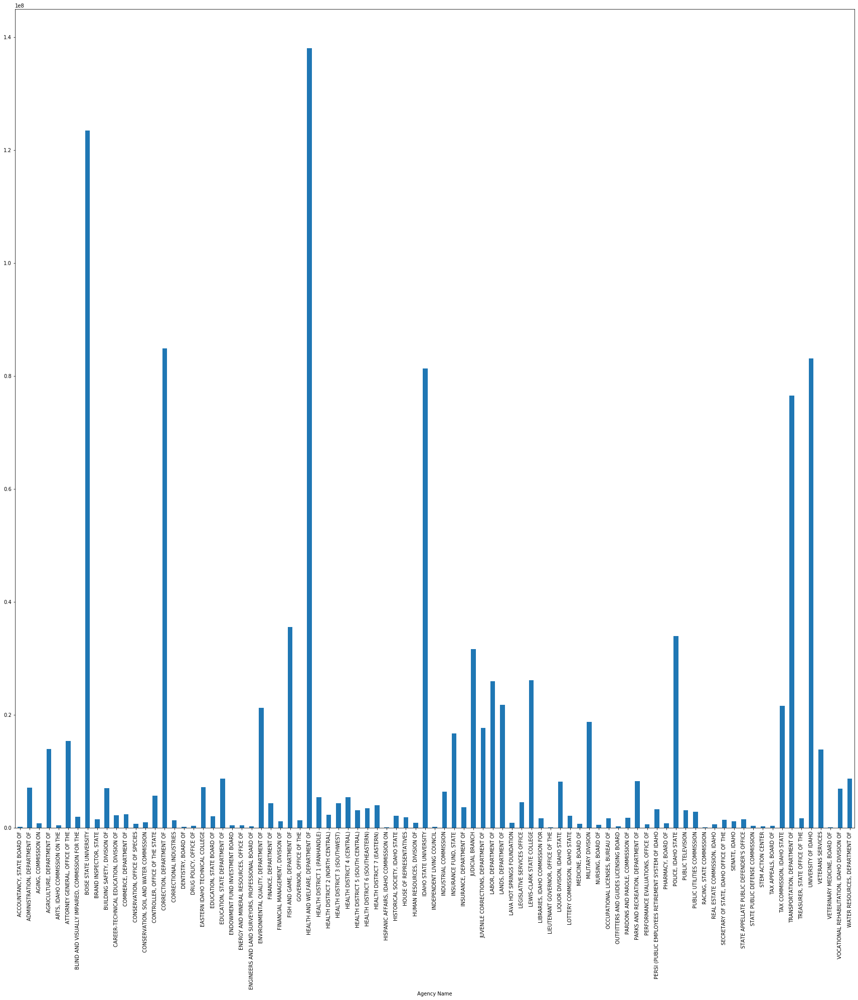

In [657]:
grouped_wage_agency_2018 = fy2018[fy2018['Summary Object Name'] == 'GROSS SALARY & WAGE'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_wage_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

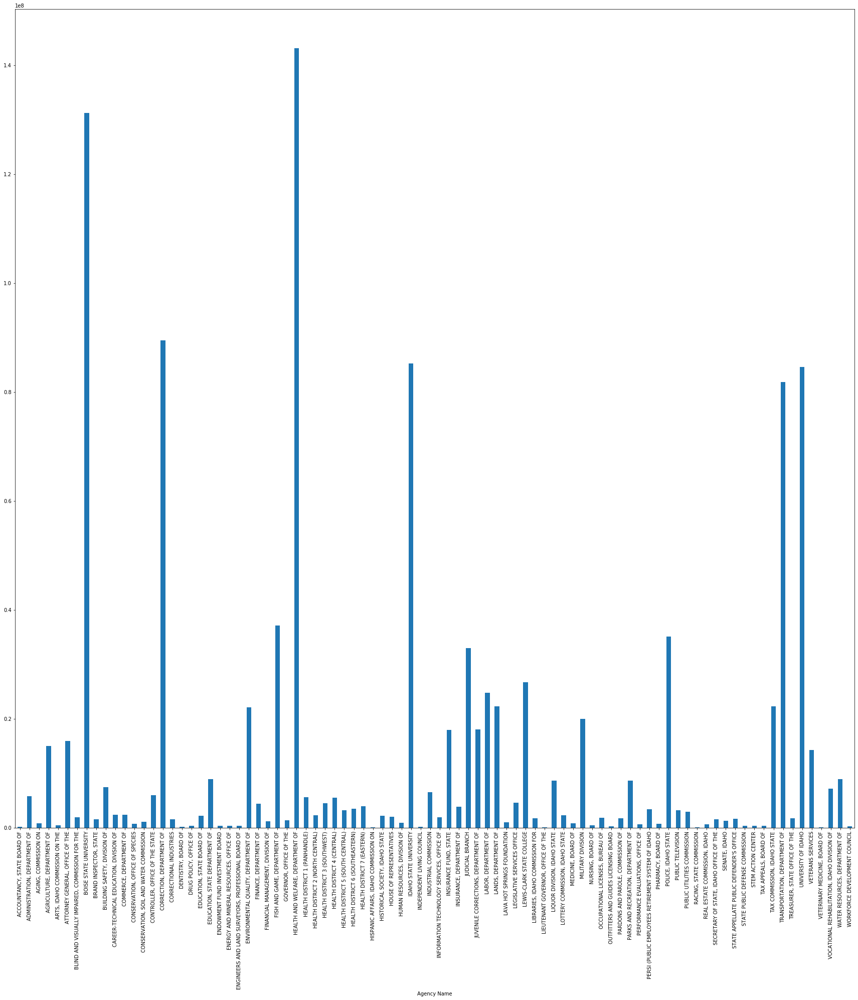

In [658]:
grouped_wage_agency_2019 = fy2019[fy2019['Summary Object Name'] == 'GROSS SALARY & WAGE'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_wage_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

In [659]:
grouped_wage_agency_agg_sum_2018 = grouped_wage_agency_2018['Amount'].agg(np.sum)
grouped_wage_agency_max_sum_2018 = grouped_wage_agency_agg_sum_2018.max()
grouped_wage_agency_sum_name_sum_2018 = grouped_wage_agency_agg_sum_2018.idxmax()

grouped_wage_agency_agg_sum_2019 = grouped_wage_agency_2019['Amount'].agg(np.sum)
grouped_wage_agency_max_sum_2019 = grouped_wage_agency_agg_sum_2019.max()
grouped_wage_agency_sum_name_sum_2019 = grouped_wage_agency_agg_sum_2019.idxmax()

print("For 2018, " + grouped_wage_agency_sum_name_sum_2018 + " had the most expenditure for the total cost of all Gross Salary & Wage at " + str(grouped_wage_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_wage_agency_sum_name_sum_2019 + " had the most expenditure for the total cost of all Gross Salary & Wage at " + str(grouped_wage_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_wage_agency_max_sum_2019 - grouped_wage_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of all Gross Salary & Wage at 138078474.75000566.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of all Gross Salary & Wage at 143151299.579997.
The average increase/decrease was 5072824.829991341 between 2018 and 2019.


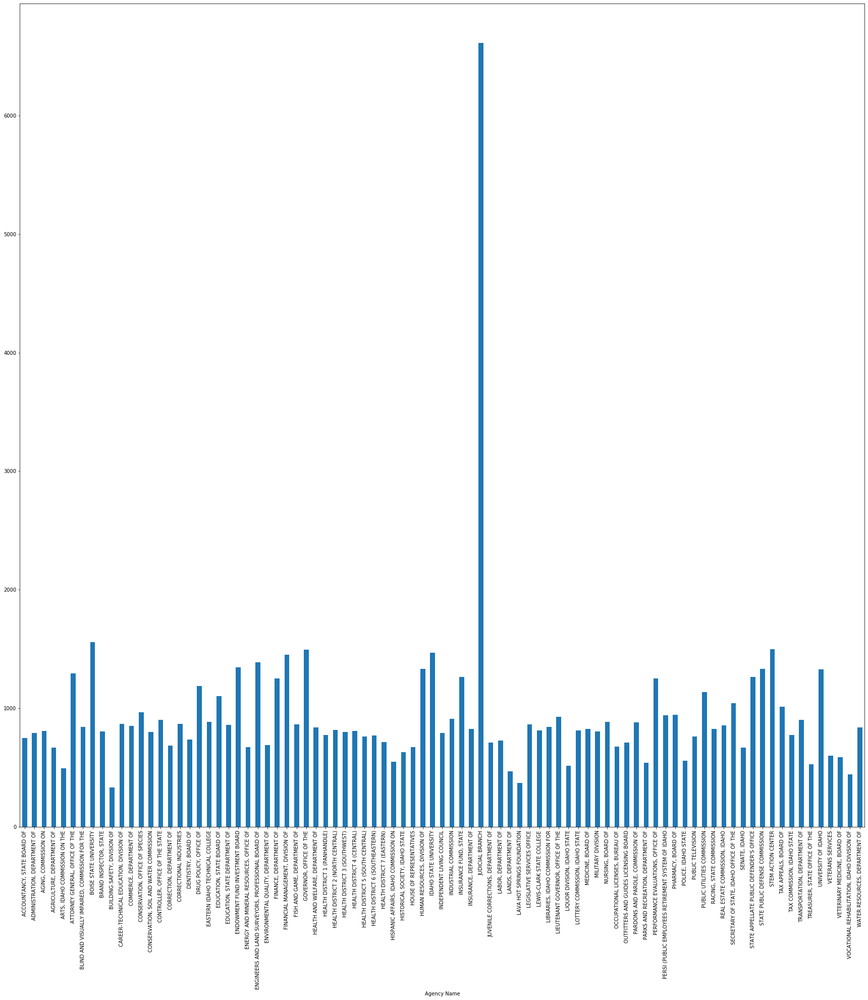

In [660]:
grouped_wage_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

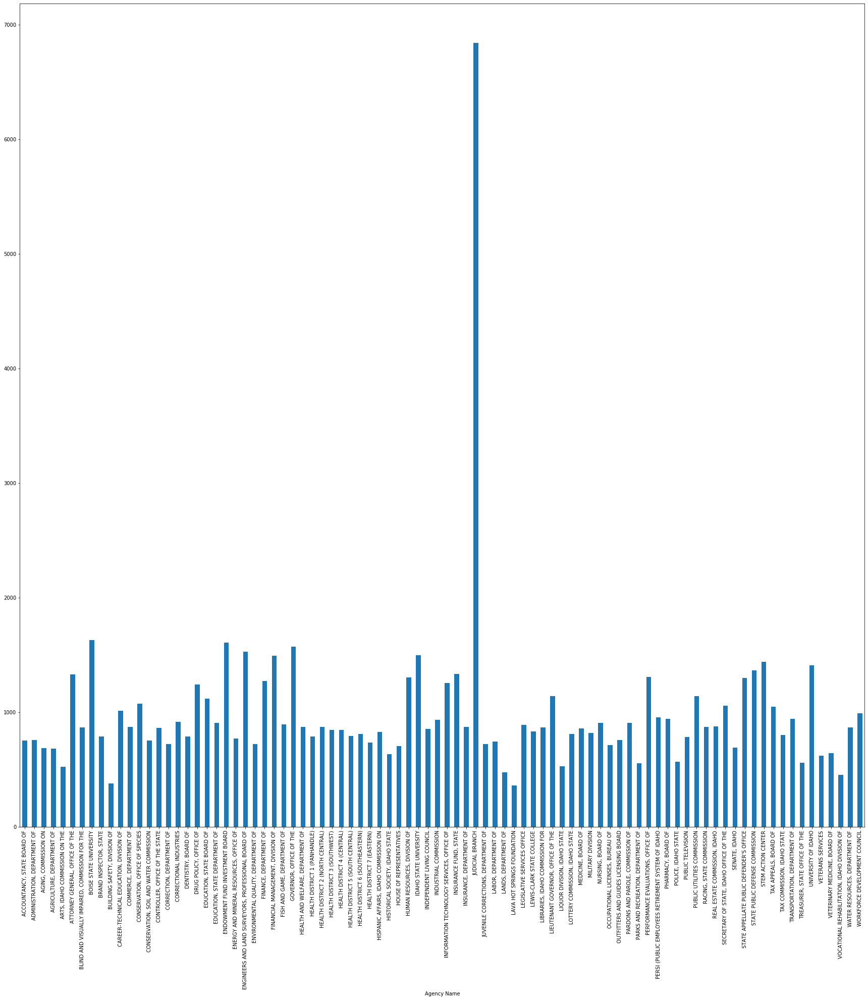

In [661]:
grouped_wage_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

In [662]:
grouped_wage_agency_agg_mean_2018 = grouped_wage_agency_2018['Amount'].agg(np.mean)
grouped_wage_agency_max_mean_2018 = grouped_wage_agency_agg_mean_2018.max()
grouped_wage_agency_mean_name_mean_2018 = grouped_wage_agency_agg_mean_2018.idxmax()

grouped_wage_agency_agg_mean_2019 = grouped_wage_agency_2019['Amount'].agg(np.mean)
grouped_wage_agency_max_mean_2019 = grouped_wage_agency_agg_mean_2019.max()
grouped_wage_agency_mean_name_mean_2019 = grouped_wage_agency_agg_mean_2019.idxmax()

print("For 2018, " + grouped_wage_agency_mean_name_mean_2018 + " had the most expenditure for the average cost of all Gross Salary & Wage at " + str(grouped_wage_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_wage_agency_mean_name_mean_2019 + " had the most expenditure for the average cost of all Gross Salary & Wage at " + str(grouped_wage_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_wage_agency_max_mean_2019 - grouped_wage_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, JUDICIAL BRANCH had the most expenditure for the average cost of all Gross Salary & Wage at 6613.659935281831.
For 2019, JUDICIAL BRANCH had the most expenditure for the average cost of all Gross Salary & Wage at 6840.6227331121745.
The average increase/decrease was 226.96279783034333 between 2018 and 2019.


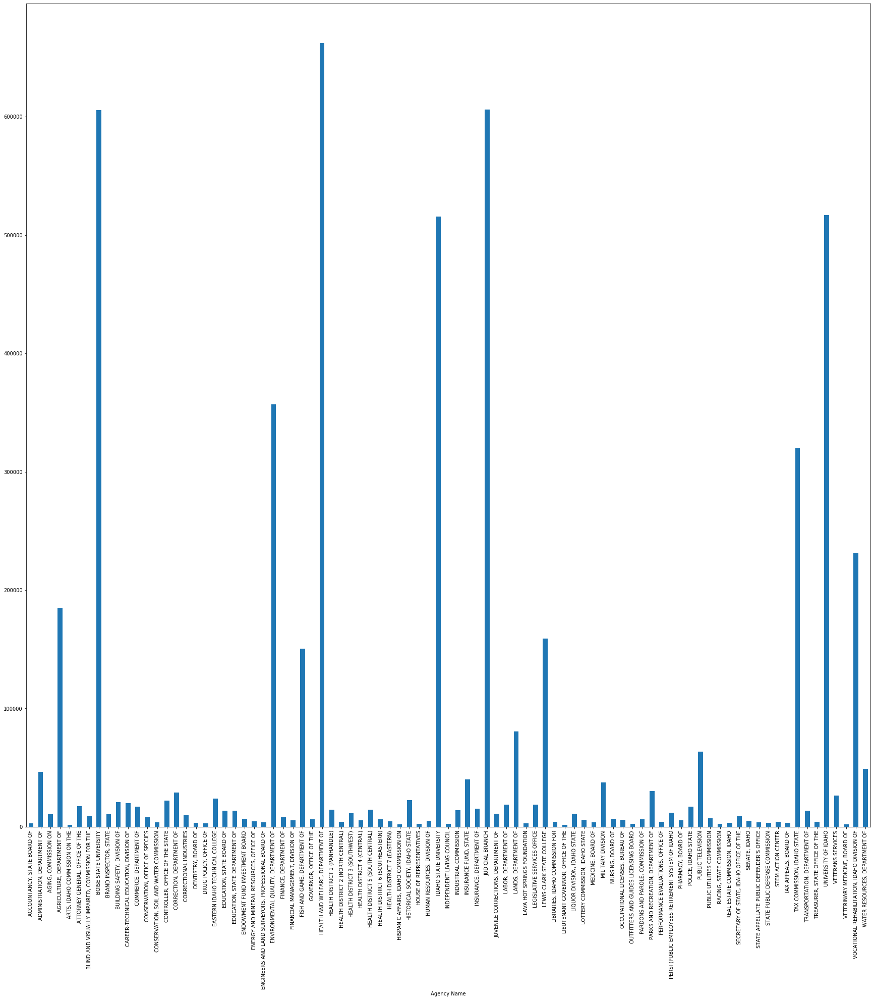

In [663]:
grouped_wage_agency_2018['Amount'].agg(np.max).plot.bar(figsize=(30,30))

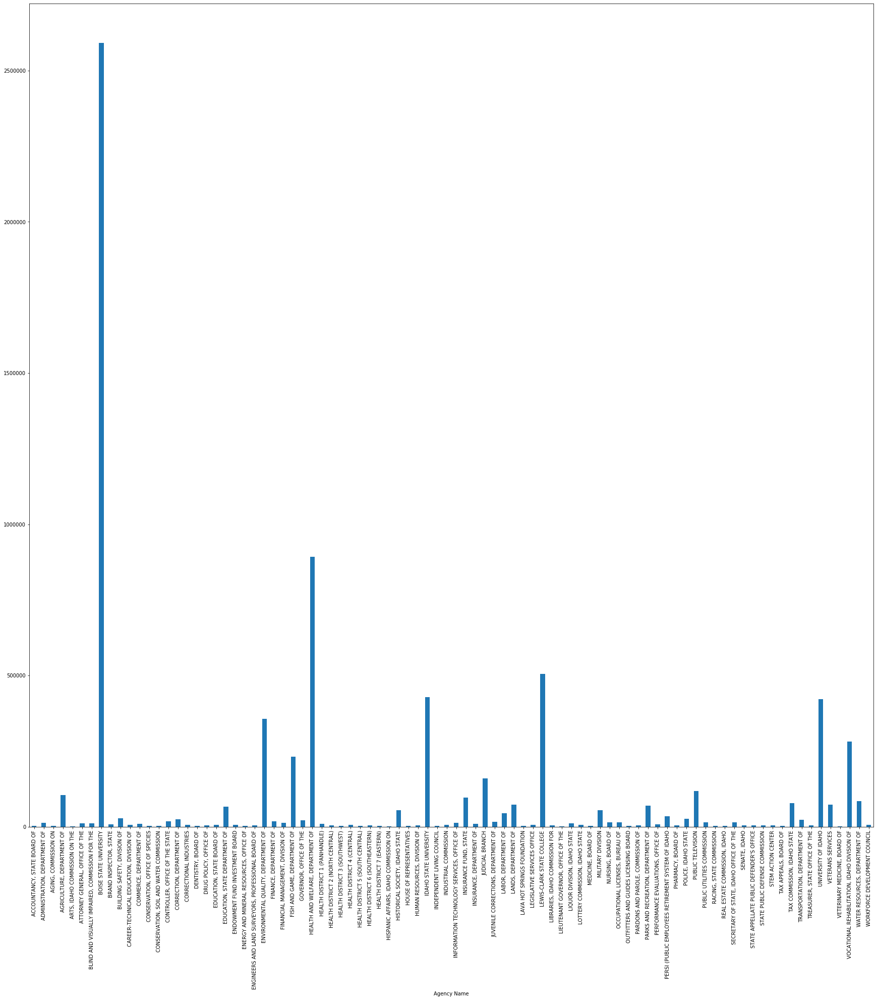

In [664]:
grouped_wage_agency_2019['Amount'].agg(np.max).plot.bar(figsize=(30,30))

In [665]:
grouped_wage_agency_agg_max_2018 = grouped_wage_agency_2018['Amount'].agg(np.max)
grouped_wage_agency_max_max_2018 = grouped_wage_agency_agg_max_2018.max()
grouped_wage_agency_max_name_max_2018 = grouped_wage_agency_agg_max_2018.idxmax()

grouped_wage_agency_agg_max_2019 = grouped_wage_agency_2019['Amount'].agg(np.max)
grouped_wage_agency_max_max_2019 = grouped_wage_agency_agg_max_2019.max()
grouped_wage_agency_max_name_max_2019 = grouped_wage_agency_agg_max_2019.idxmax()

print("For 2018, " + grouped_wage_agency_max_name_max_2018 + " had the most expenditure for the maximum cost of all Gross Salary & Wage at " + str(grouped_wage_agency_max_max_2018) + ".")
print("For 2019, " + grouped_wage_agency_max_name_max_2019 + " had the most expenditure for the maximum cost of all Gross Salary & Wage at " + str(grouped_wage_agency_max_max_2019) + ".")
#print("The average increase/decrease was " + str(grouped_wage_agency_max_max_2019 - grouped_wage_agency_max_max_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the maximum cost of all Gross Salary & Wage at 662480.8.
For 2019, BOISE STATE UNIVERSITY had the most expenditure for the maximum cost of all Gross Salary & Wage at 2591835.47.


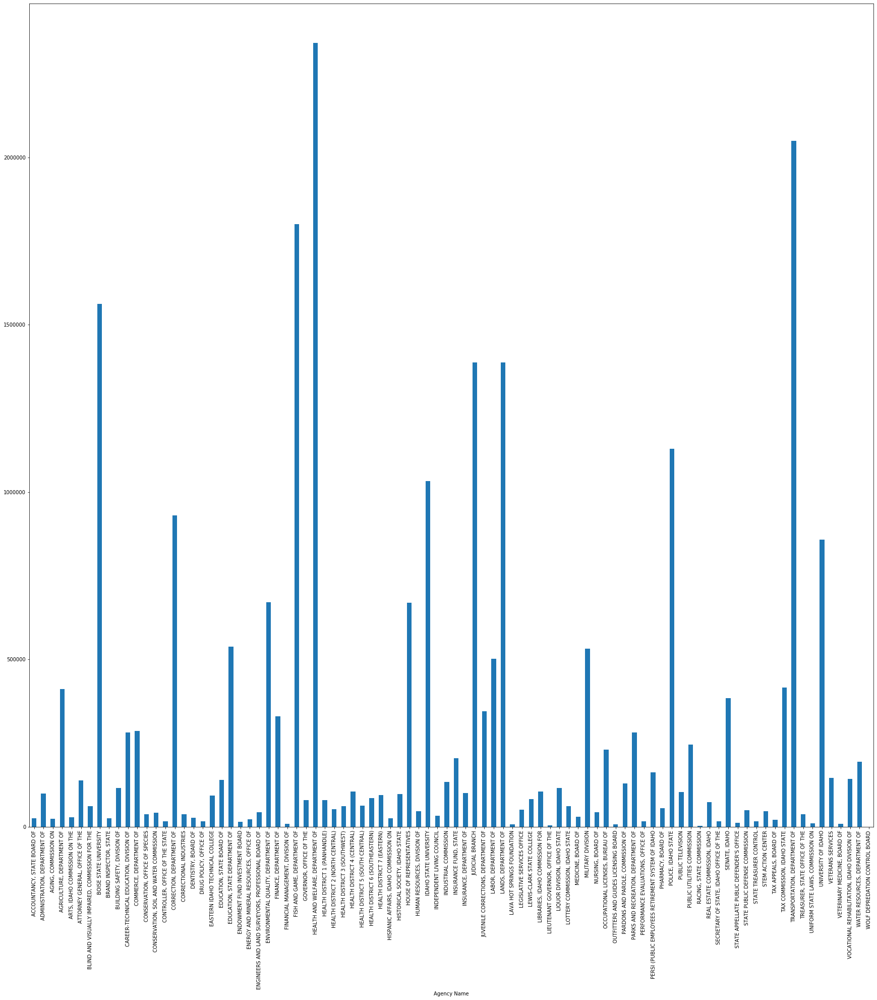

In [666]:
grouped_travel_agency_2018 = fy2018[fy2018['Summary Object Name'] == 'EMPLOYEE TRAVEL COSTS'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_travel_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

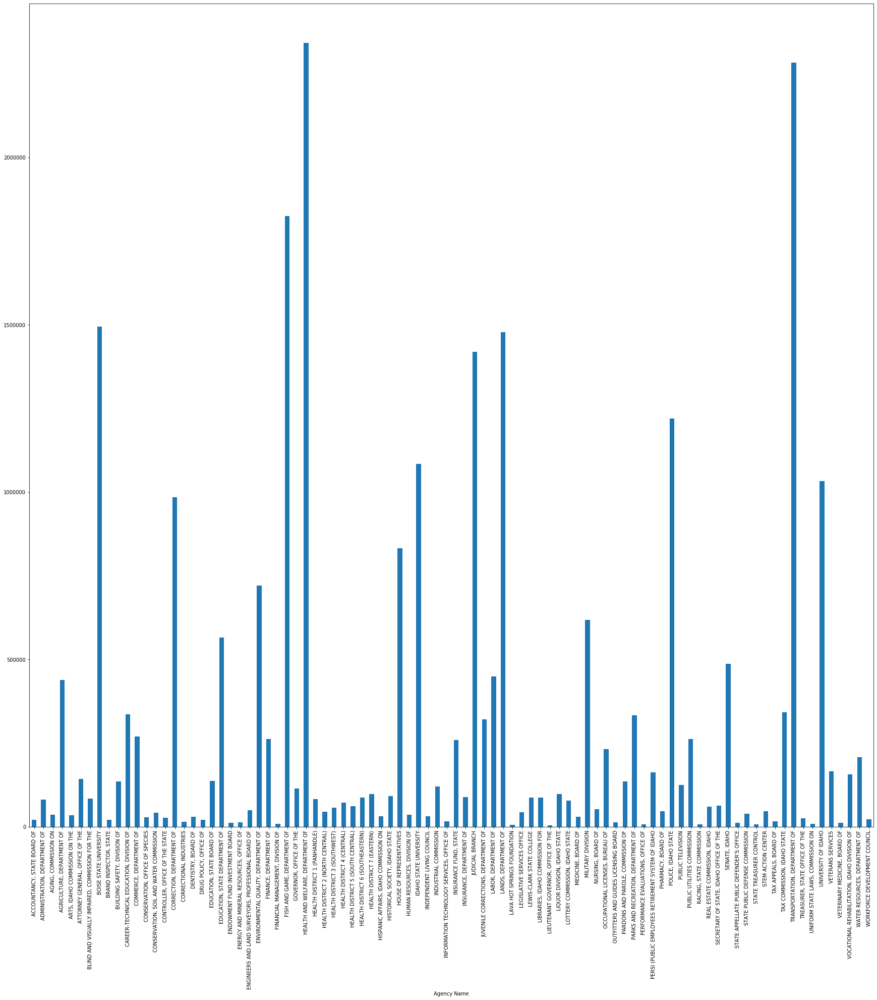

In [667]:
grouped_travel_agency_2019 = fy2019[fy2019['Summary Object Name'] == 'EMPLOYEE TRAVEL COSTS'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_travel_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

In [668]:
grouped_travel_agency_sum_2018 = grouped_travel_agency_2018['Amount'].agg(np.sum)
grouped_travel_agency_max_sum_2018 = grouped_travel_agency_sum_2018.max()
grouped_travel_agency_sum_name_sum_2018 = grouped_travel_agency_sum_2018.idxmax()

grouped_travel_agency_sum_2019 = grouped_travel_agency_2019['Amount'].agg(np.sum)
grouped_travel_agency_max_sum_2019 = grouped_travel_agency_sum_2019.max()
grouped_travel_agency_sum_name_sum_2019 = grouped_travel_agency_sum_2019.idxmax()

print("For 2018, " + grouped_travel_agency_sum_name_sum_2018 + " had the most expenditure for the total cost of all Employee Travel Costs at " + str(grouped_travel_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_travel_agency_sum_name_sum_2019 + " had the most expenditure for the total cost of all Employee Travel Costs at " + str(grouped_travel_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_travel_agency_max_sum_2019 - grouped_travel_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of all Employee Travel Costs at 2342489.449999995.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of all Employee Travel Costs at 2342660.320000005.
The average increase/decrease was 170.87000000989065 between 2018 and 2019.


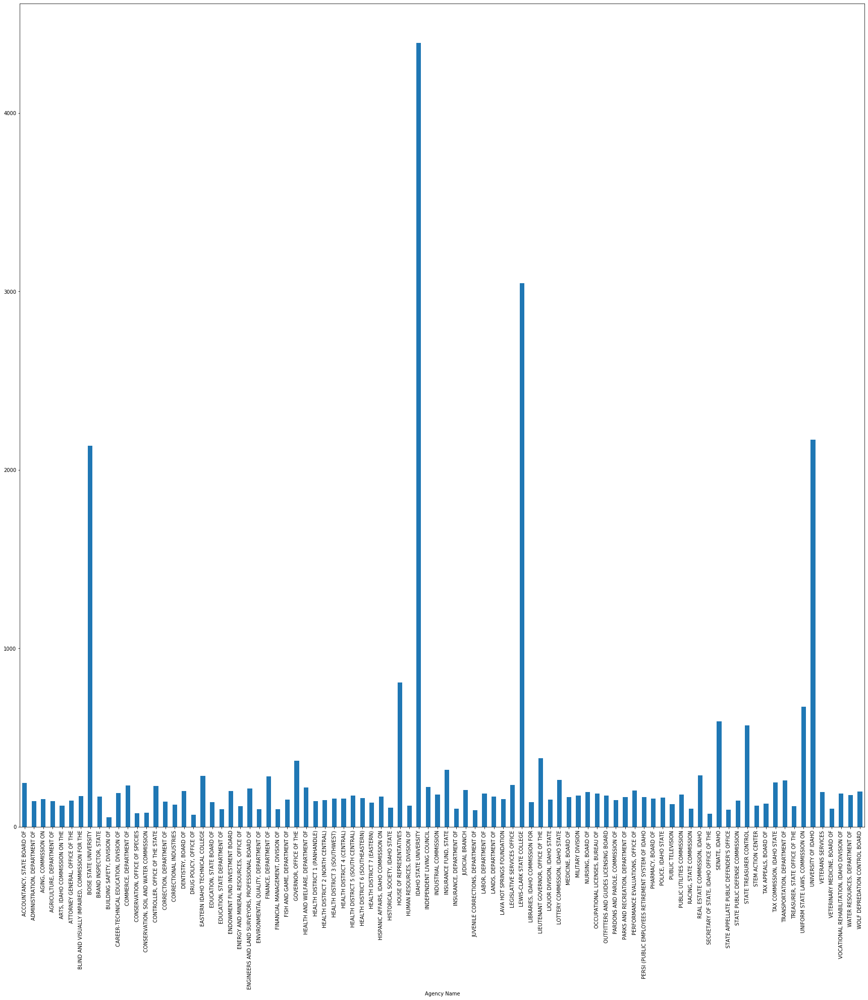

In [669]:
plt.xticks(rotation='vertical')
grouped_travel_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

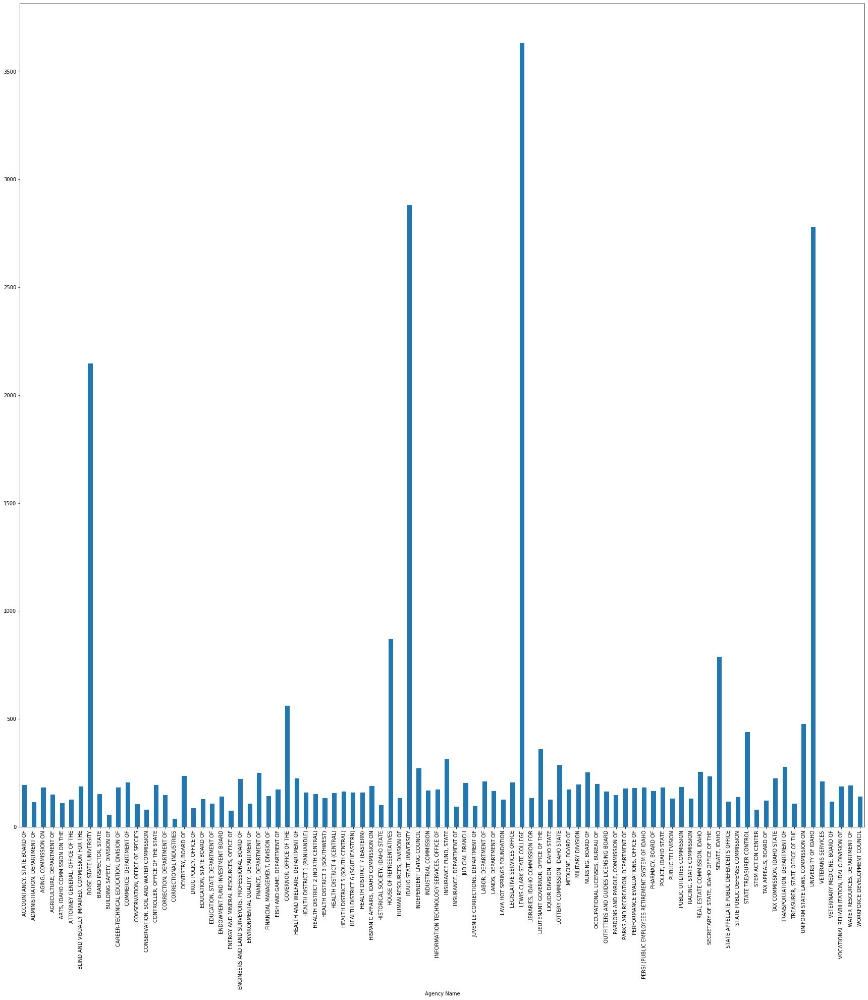

In [670]:
plt.xticks(rotation='vertical')
grouped_travel_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

In [671]:
grouped_travel_agency_mean_2018 = grouped_travel_agency_2018['Amount'].agg(np.mean)
grouped_travel_agency_max_mean_2018 = grouped_travel_agency_mean_2018.max()
grouped_travel_agency_name_mean_2018 = grouped_travel_agency_mean_2018.idxmax()

grouped_travel_agency_mean_2019 = grouped_travel_agency_2019['Amount'].agg(np.mean)
grouped_travel_agency_max_mean_2019 = grouped_travel_agency_mean_2019.max()
grouped_travel_agency_name_mean_2019 = grouped_travel_agency_mean_2019.idxmax()

print("For 2018, " + grouped_travel_agency_name_mean_2018 + " had the most expenditure for the average cost of all Employee Travel Costs at " + str(grouped_travel_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_travel_agency_name_mean_2019 + " had the most expenditure for the average cost of all Employee Travel Costs at " + str(grouped_travel_agency_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_travel_agency_max_mean_2019 - grouped_travel_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, IDAHO STATE UNIVERSITY had the most expenditure for the average cost of all Employee Travel Costs at 4393.776808510637.
For 2019, LEWIS-CLARK STATE COLLEGE had the most expenditure for the average cost of all Employee Travel Costs at 3633.047083333333.


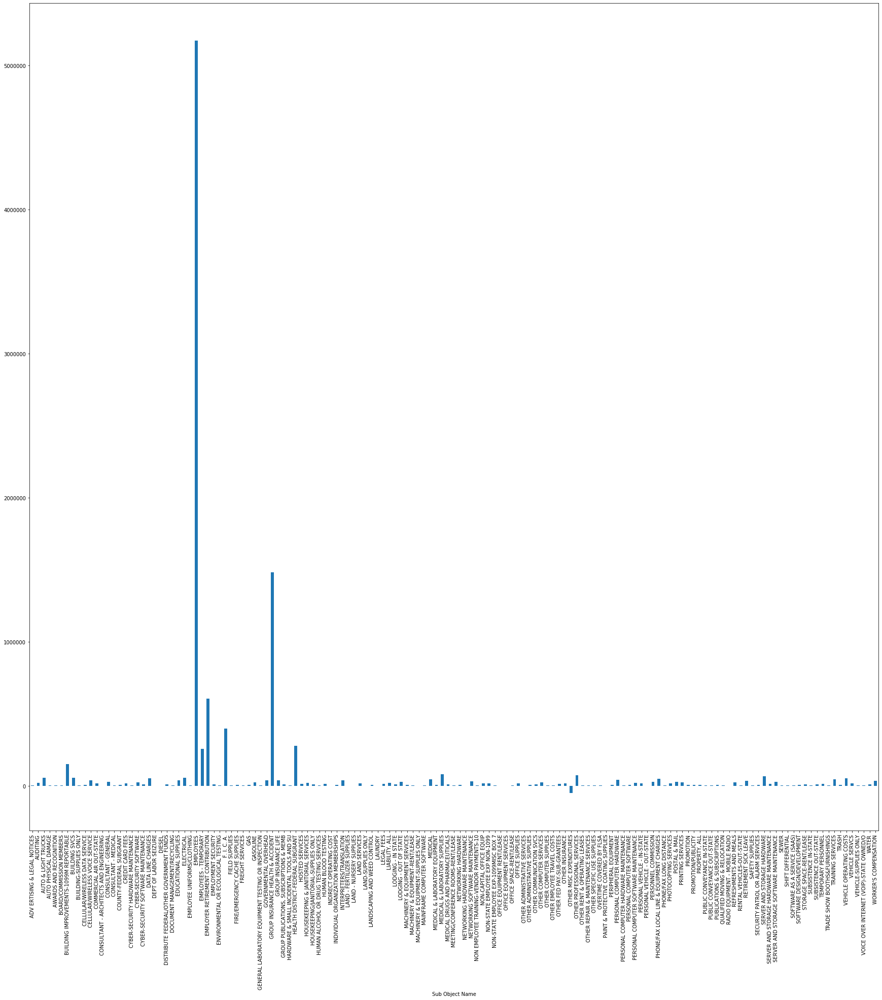

In [672]:
grouped_health_4_sub_2018 = fy2018[fy2018['Agency Name'] == 'HEALTH DISTRICT 4 (CENTRAL)'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_health_4_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

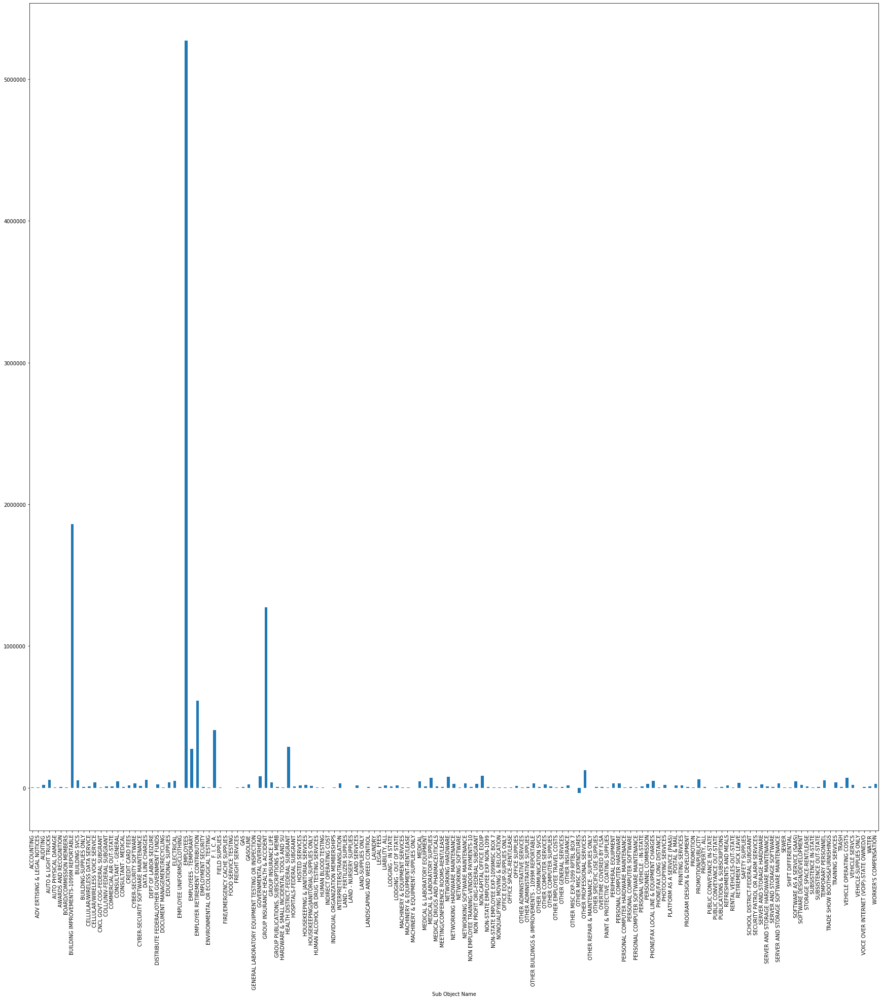

In [673]:
grouped_health_4_sub_2019 = fy2019[fy2019['Agency Name'] == 'HEALTH DISTRICT 4 (CENTRAL)'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_health_4_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

In [674]:
grouped_health_4_sub_sum_2018 = grouped_health_4_sub_2018['Amount'].agg(np.sum)
grouped_health_4_max_sum_2018 = grouped_health_4_sub_sum_2018.max()
grouped_health_4_name_sum_2018 = grouped_health_4_sub_sum_2018.idxmax()

grouped_health_4_sub_sum_2019 = grouped_health_4_sub_2019['Amount'].agg(np.sum)
grouped_health_4_max_sum_2019 = grouped_health_4_sub_sum_2019.max()
grouped_health_4_name_sum_2019 = grouped_health_4_sub_sum_2019.idxmax()

print("For 2018, " + grouped_health_4_name_sum_2018 + " had the most expenditure for the total cost of all Heath District 4 (Central) at " + str(grouped_health_4_max_sum_2018) + ".")
print("For 2019, " + grouped_health_4_name_sum_2019 + " had the most expenditure for the total cost of all Heath District 4 (Central) at " + str(grouped_health_4_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_health_4_max_sum_2019 - grouped_health_4_max_sum_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEES had the most expenditure for the total cost of all Heath District 4 (Central) at 5171346.810000017.
For 2019, EMPLOYEES had the most expenditure for the total cost of all Heath District 4 (Central) at 5270472.499999974.
The average increase/decrease was 99125.68999995664 between 2018 and 2019.


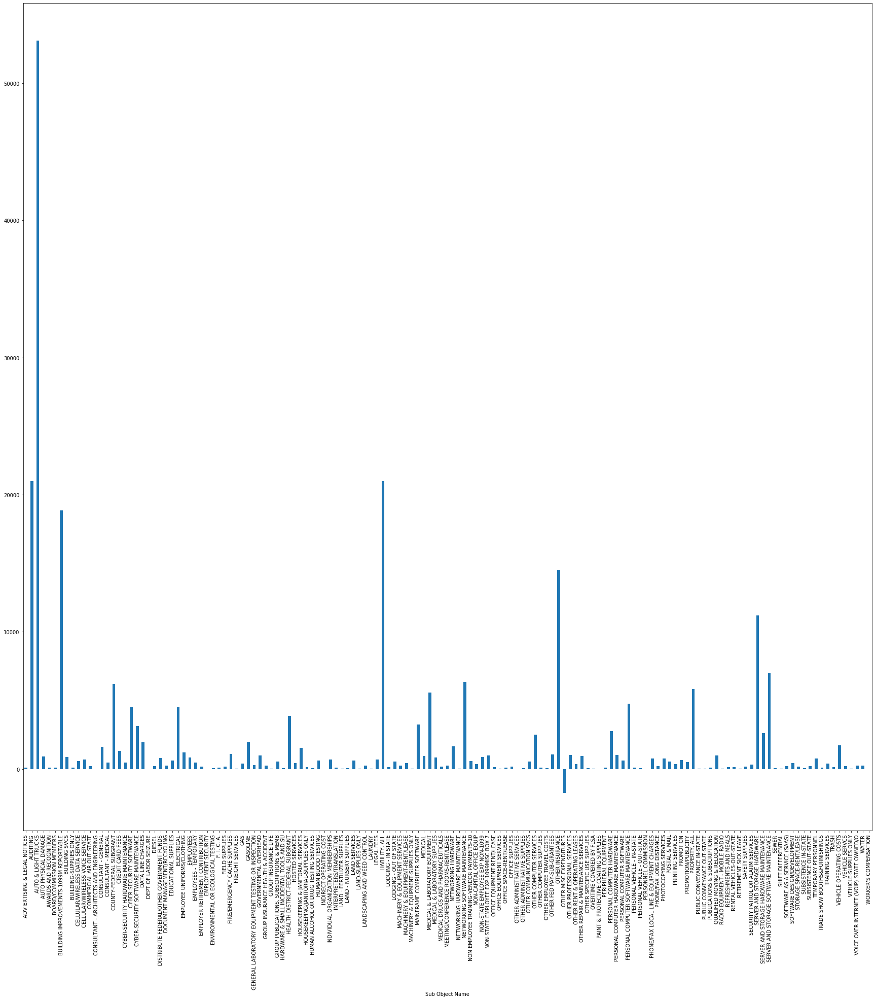

In [675]:
plt.xticks(rotation='vertical')
grouped_health_4_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

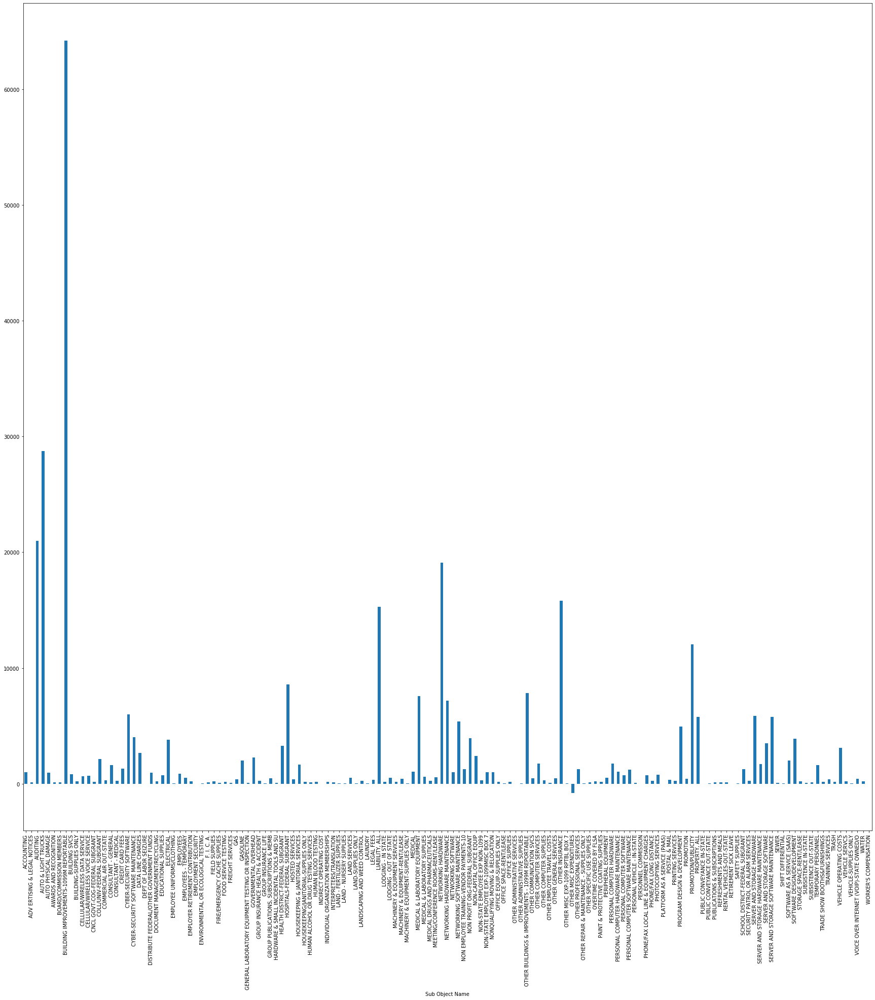

In [676]:
plt.xticks(rotation='vertical')
grouped_health_4_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

In [677]:
grouped_health_4_sub_mean_2018 = grouped_health_4_sub_2018['Amount'].agg(np.mean)
grouped_health_4_max_mean_2018 = grouped_health_4_sub_mean_2018.max()
grouped_health_4_name_mean_2018 = grouped_health_4_sub_mean_2018.idxmax()

grouped_health_4_sub_mean_2019 = grouped_health_4_sub_2019['Amount'].agg(np.mean)
grouped_health_4_max_mean_2019 = grouped_health_4_sub_mean_2019.max()
grouped_health_4_name_mean_2019 = grouped_health_4_sub_mean_2019.idxmax()

print("For 2018, " + grouped_health_4_name_mean_2018 + " had the most expenditure for the average cost of all Heath District 4 (Central) at " + str(grouped_health_4_max_mean_2018) + ".")
print("For 2019, " + grouped_health_4_name_mean_2019 + " had the most expenditure for the average cost of all Heath District 4 (Central) at " + str(grouped_health_4_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_health_4_max_mean_2019 - grouped_health_4_max_mean_2018) + " between 2018 and 2019.")

For 2018, AUTO & LIGHT TRUCKS had the most expenditure for the average cost of all Heath District 4 (Central) at 53083.35.
For 2019, BUILDING IMPROVEMENTS-1099M REPORTABLE had the most expenditure for the average cost of all Heath District 4 (Central) at 64173.12103448274.


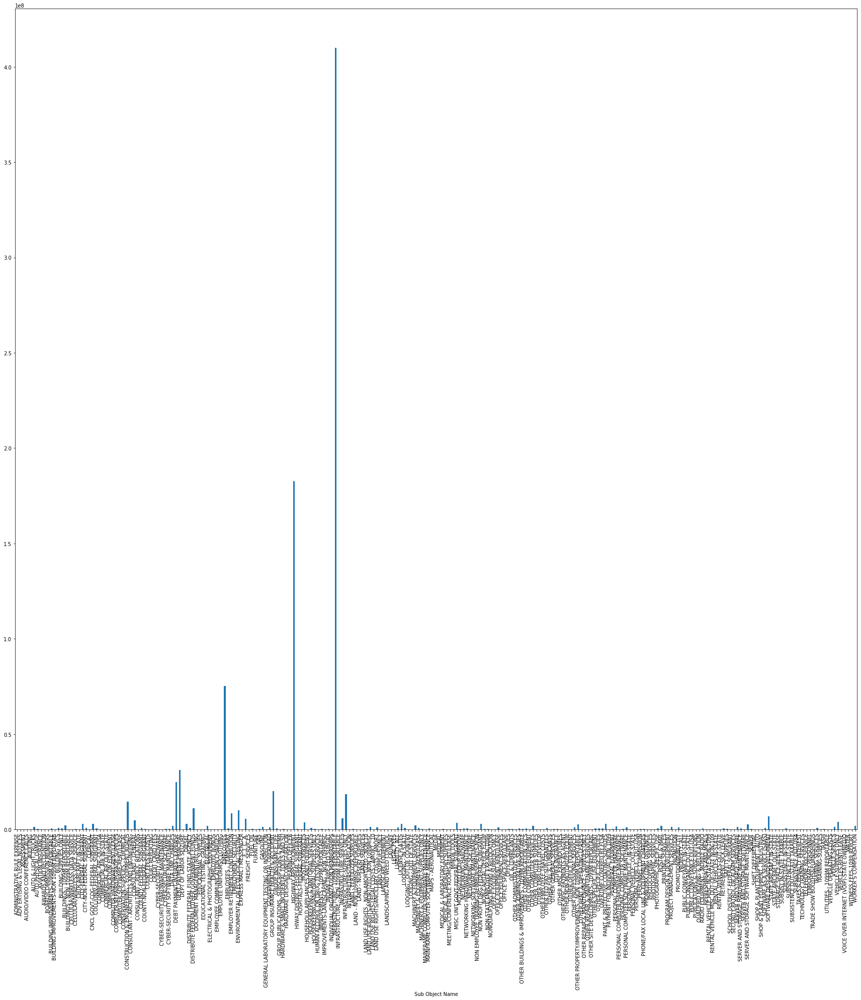

In [678]:
grouped_transportation_sub_2018 = fy2018[fy2018['Agency Name'] == 'TRANSPORTATION, DEPARTMENT OF'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_transportation_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

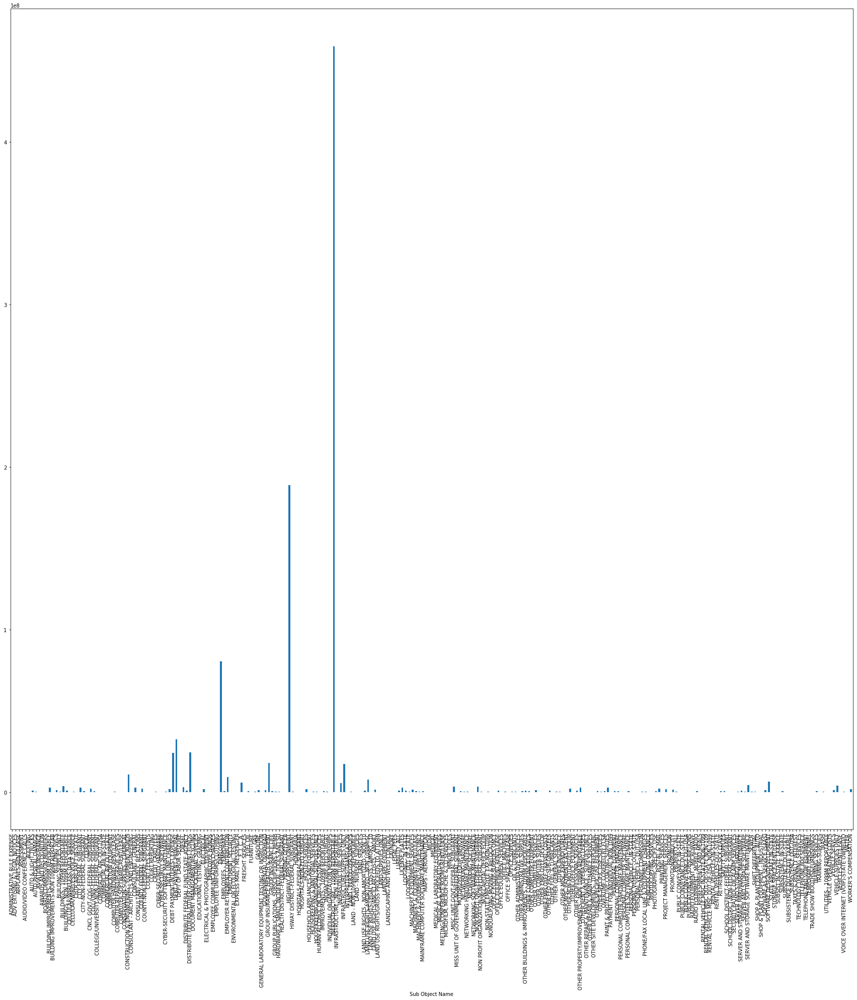

In [679]:
grouped_transportation_sub_2019 = fy2019[fy2019['Agency Name'] == 'TRANSPORTATION, DEPARTMENT OF'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_transportation_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

In [680]:
grouped_transportation_sub_sum_2018 = grouped_transportation_sub_2018['Amount'].agg(np.sum)
grouped_transportation_max_sum_2018 = grouped_transportation_sub_sum_2018.max()
grouped_transportation_name_sum_2018 = grouped_transportation_sub_sum_2018.idxmax()

grouped_transportation_sub_sum_2019 = grouped_transportation_sub_2019['Amount'].agg(np.sum)
grouped_transportation_max_sum_2019 = grouped_transportation_sub_sum_2019.max()
grouped_transportation_name_sum_2019 = grouped_transportation_sub_sum_2019.idxmax()

print("For 2018, " + grouped_transportation_name_sum_2018 + " had the most expenditure for the total cost of all the Department of Transportation at " + str(grouped_transportation_max_sum_2018) + ".")
print("For 2019, " + grouped_transportation_name_sum_2019 + " had the most expenditure for the total cost of all Department of Transportation at " + str(grouped_transportation_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_transportation_max_sum_2019 - grouped_transportation_max_sum_2018) + " between 2018 and 2019.")

For 2018, INFRASTRUCTURE - 1099M REPORTABLE had the most expenditure for the total cost of all the Department of Transportation at 409938598.97000045.
For 2019, INFRASTRUCTURE - 1099M REPORTABLE had the most expenditure for the total cost of all Department of Transportation at 459119499.6199993.
The average increase/decrease was 49180900.64999884 between 2018 and 2019.


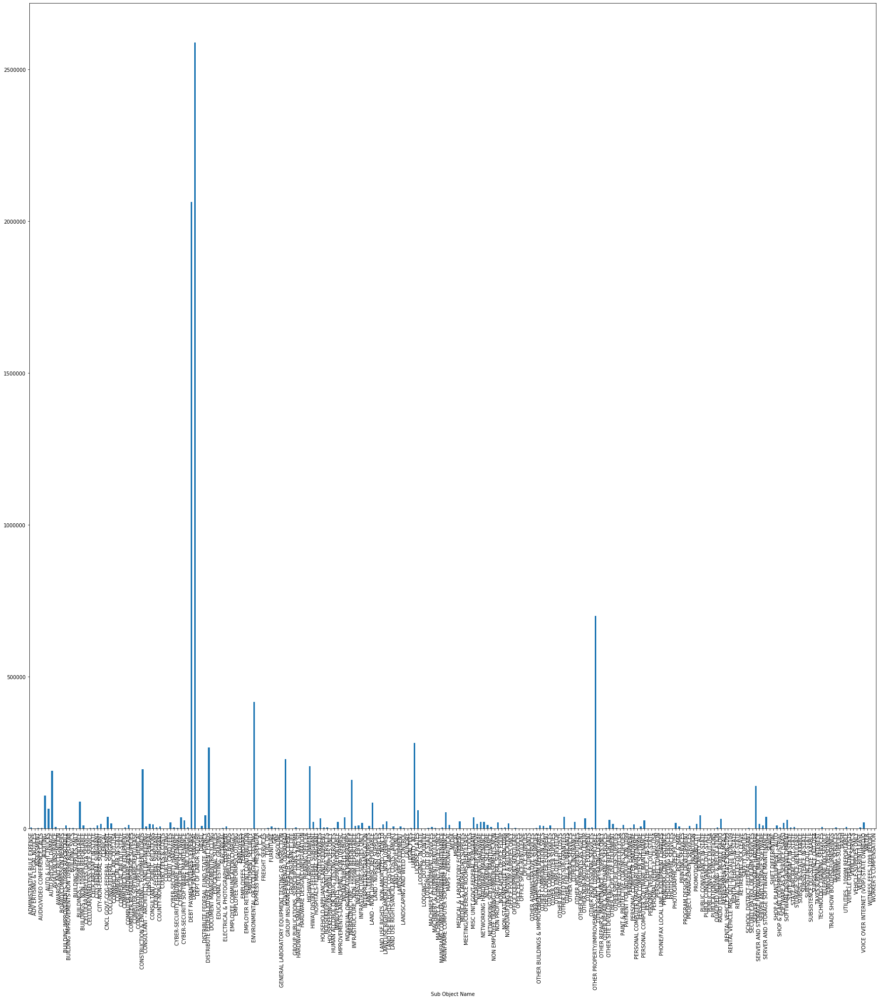

In [681]:
plt.xticks(rotation='vertical')
grouped_transportation_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

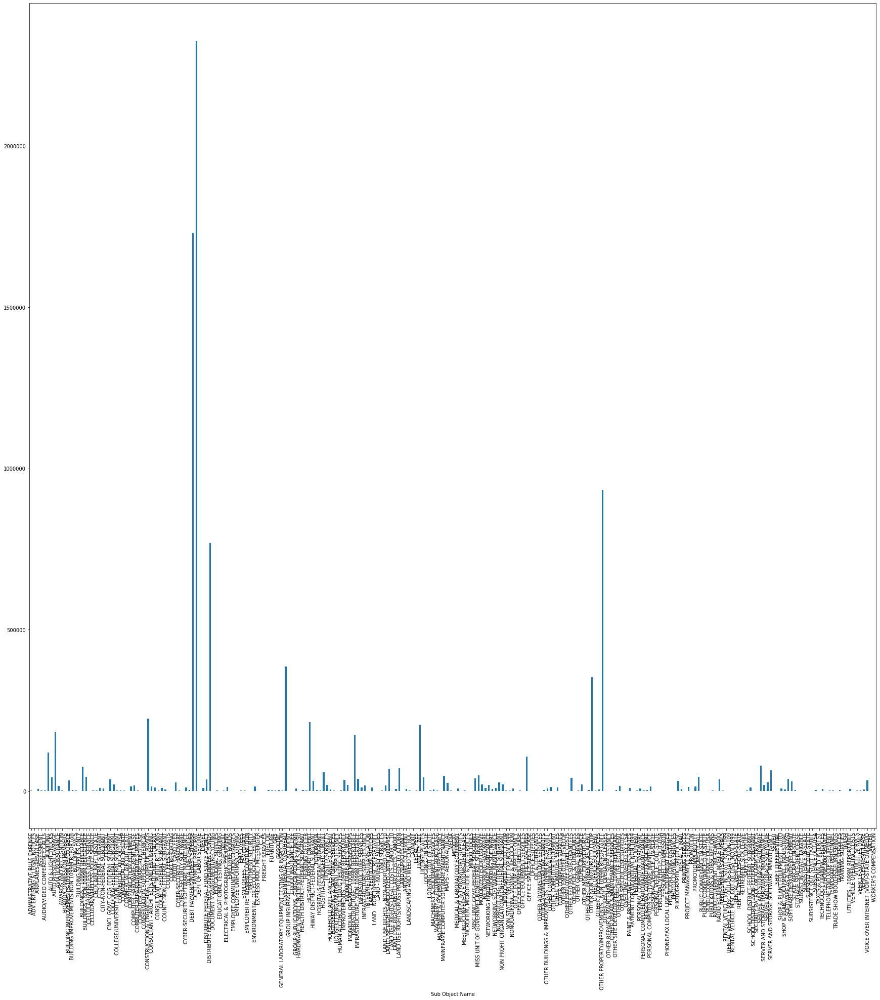

In [682]:
plt.xticks(rotation='vertical')
grouped_transportation_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

In [683]:
grouped_transportation_sub_mean_2018 = grouped_transportation_sub_2018['Amount'].agg(np.mean)
grouped_transportation_max_mean_2018 = grouped_transportation_sub_mean_2018.max()
grouped_transportation_name_mean_2018 = grouped_transportation_sub_mean_2018.idxmax()

grouped_transportation_sub_mean_2019 = grouped_transportation_sub_2019['Amount'].agg(np.mean)
grouped_transportation_max_mean_2019 = grouped_transportation_sub_mean_2019.max()
grouped_transportation_name_mean_2019 = grouped_transportation_sub_mean_2019.idxmax()

print("For 2018, " + grouped_transportation_name_mean_2018 + " had the most expenditure for the average cost of all the Department of Transportation at " + str(grouped_transportation_max_mean_2018) + ".")
print("For 2019, " + grouped_transportation_name_mean_2019 + " had the most expenditure for the average cost of all Department of Transportation at " + str(grouped_transportation_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_transportation_max_mean_2019 - grouped_transportation_max_mean_2018) + " between 2018 and 2019.")

For 2018, DEBT PAYMENT-PRINCIPAL had the most expenditure for the average cost of all the Department of Transportation at 2588411.0991666666.
For 2019, DEBT PAYMENT-PRINCIPAL had the most expenditure for the average cost of all Department of Transportation at 2325651.57.
The average increase/decrease was -262759.5291666668 between 2018 and 2019.


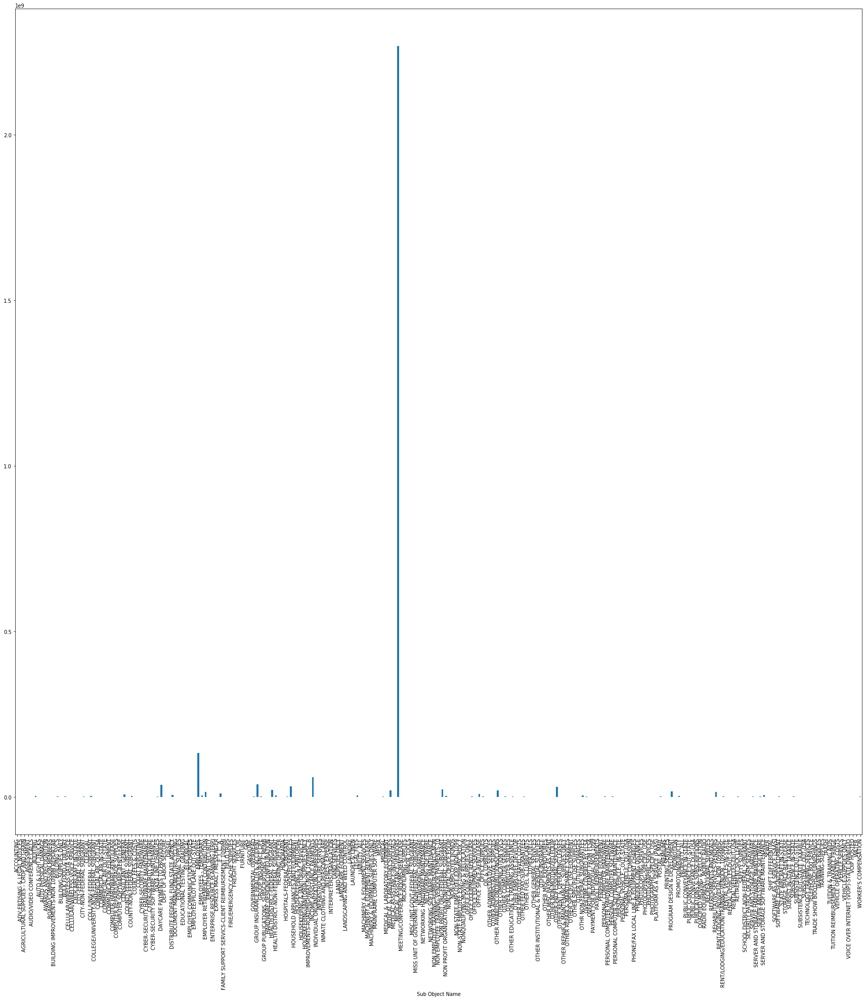

In [684]:
grouped_health_welfare_sub_2018 = fy2018[fy2018['Agency Name'] == 'HEALTH AND WELFARE, DEPARTMENT OF'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_health_welfare_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

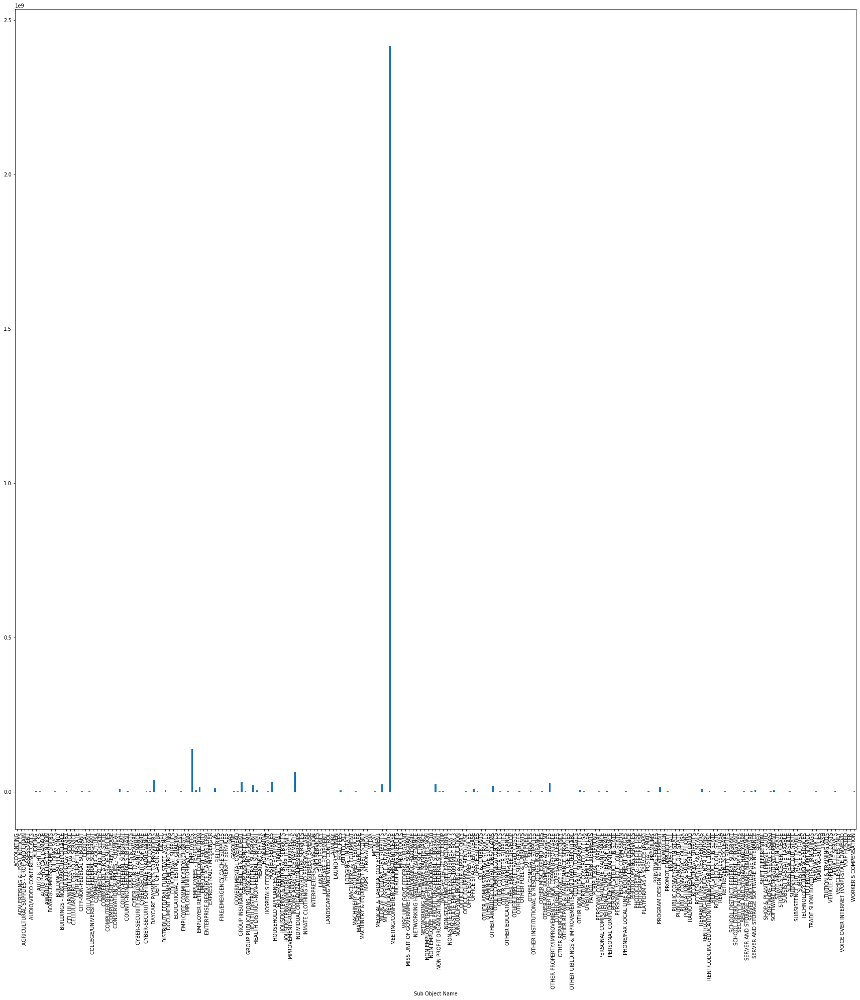

In [685]:
grouped_health_welfare_sub_2019 = fy2019[fy2019['Agency Name'] == 'HEALTH AND WELFARE, DEPARTMENT OF'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_health_welfare_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

In [686]:
grouped_health_welfare_sub_sum_2018 = grouped_health_welfare_sub_2018['Amount'].agg(np.sum)
grouped_health_welfare_max_sum_2018 = grouped_health_welfare_sub_sum_2018.max()
grouped_health_welfare_name_sum_2018 = grouped_health_welfare_sub_sum_2018.idxmax()

grouped_health_welfare_sub_sum_2019 = grouped_health_welfare_sub_2019['Amount'].agg(np.sum)
grouped_health_welfare_max_sum_2019 = grouped_health_welfare_sub_sum_2019.max()
grouped_health_welfare_name_sum_2019 = grouped_health_welfare_sub_sum_2019.idxmax()

print("For 2018, " + grouped_health_welfare_name_sum_2018 + " had the most expenditure for the total cost of all the Department of Health and Welfare at " + str(grouped_health_welfare_max_sum_2018) + ".")
print("For 2019, " + grouped_health_welfare_name_sum_2019 + " had the most expenditure for the total cost of all Department of Health and Welfare at " + str(grouped_health_welfare_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_health_welfare_max_sum_2019 - grouped_health_welfare_max_sum_2018) + " between 2018 and 2019.")

For 2018, MEDICAL ASSISTANCE-VENDORS had the most expenditure for the total cost of all the Department of Health and Welfare at 2266774707.770937.
For 2019, MEDICAL ASSISTANCE-VENDORS had the most expenditure for the total cost of all Department of Health and Welfare at 2414248825.700931.
The average increase/decrease was 147474117.9299941 between 2018 and 2019.


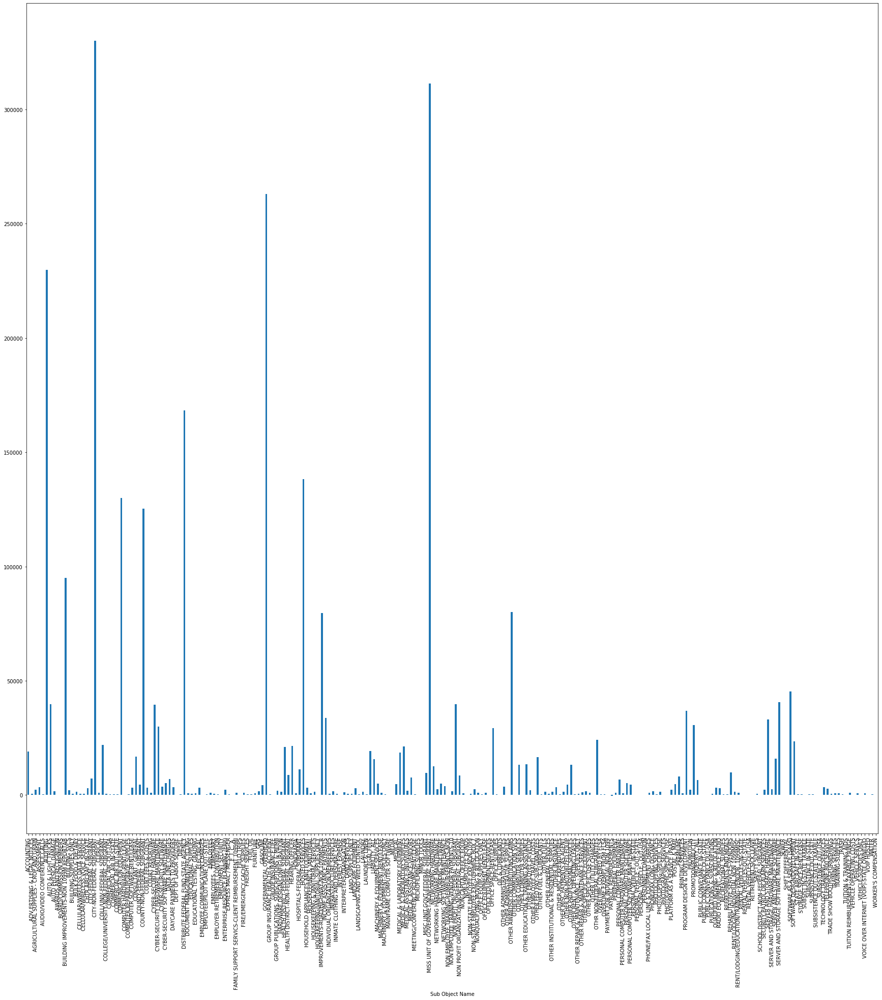

In [687]:
plt.xticks(rotation='vertical')
grouped_health_welfare_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

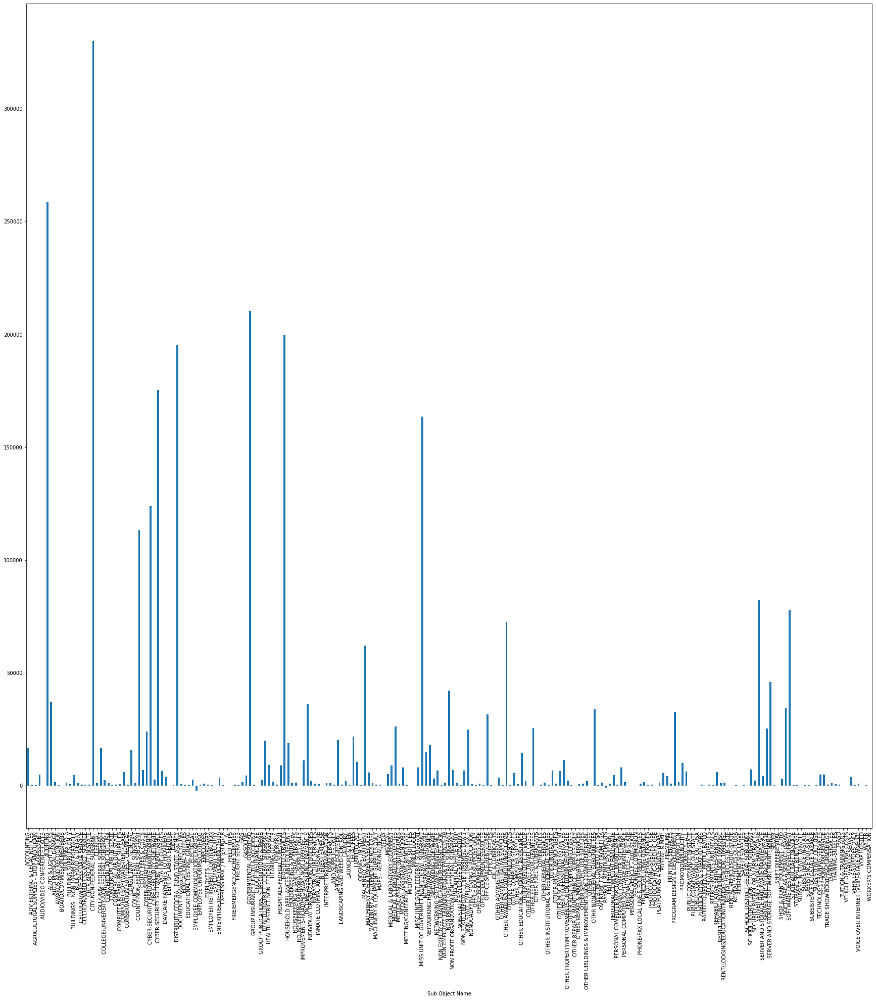

In [688]:
plt.xticks(rotation='vertical')
grouped_health_welfare_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

In [689]:
grouped_health_welfare_sub_mean_2018 = grouped_health_welfare_sub_2018['Amount'].agg(np.mean)
grouped_health_welfare_max_mean_2018 = grouped_health_welfare_sub_mean_2018.max()
grouped_health_welfare_name_mean_2018 = grouped_health_welfare_sub_mean_2018.idxmax()

grouped_health_welfare_sub_mean_2019 = grouped_health_welfare_sub_2019['Amount'].agg(np.mean)
grouped_health_welfare_max_mean_2019 = grouped_health_welfare_sub_mean_2019.max()
grouped_health_welfare_name_mean_2019 = grouped_health_welfare_sub_mean_2019.idxmax()

print("For 2018, " + grouped_health_welfare_name_mean_2018 + " had the most expenditure for the average cost of all the Department of Health and Welfare at " + str(grouped_health_welfare_max_mean_2018) + ".")
print("For 2019, " + grouped_health_welfare_name_mean_2019 + " had the most expenditure for the average cost of all Department of Health and Welfare at " + str(grouped_health_welfare_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_health_welfare_max_mean_2019 - grouped_health_welfare_max_mean_2018) + " between 2018 and 2019.")

For 2018, CITY-NON-FEDERAL SUBGRANT had the most expenditure for the average cost of all the Department of Health and Welfare at 330000.0.
For 2019, CITY-NON-FEDERAL SUBGRANT had the most expenditure for the average cost of all Department of Health and Welfare at 330000.0.
The average increase/decrease was 0.0 between 2018 and 2019.


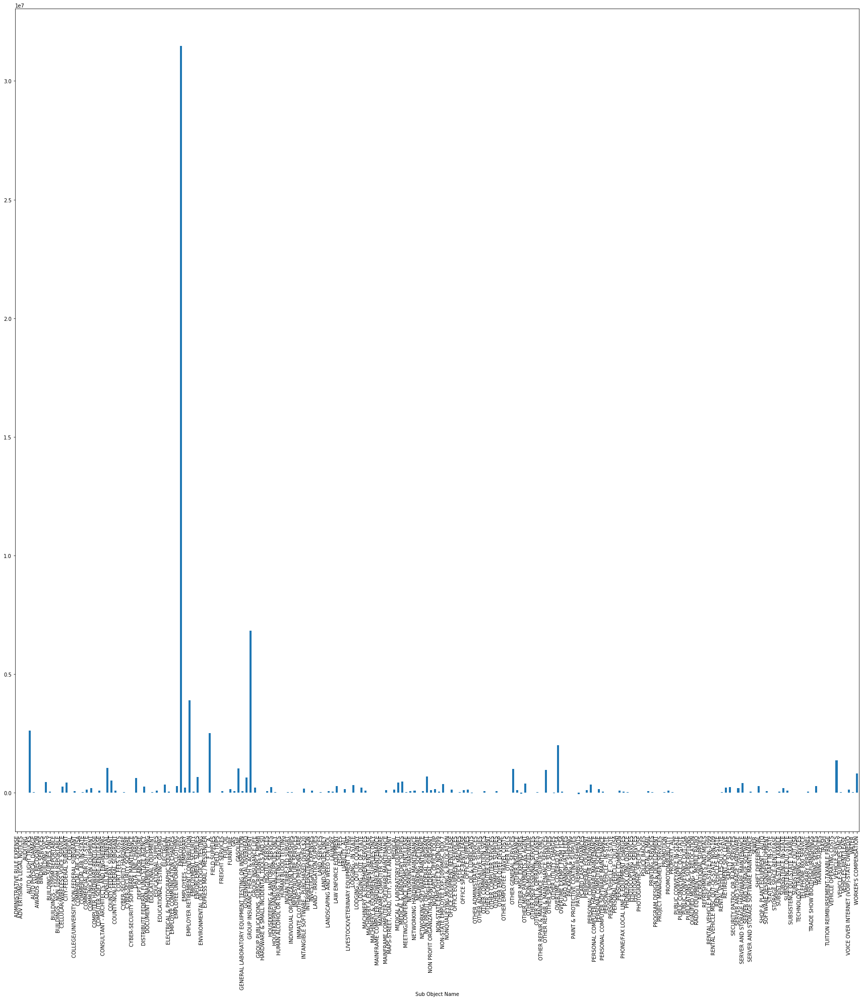

In [690]:
grouped_police_sub_2018 = fy2018[fy2018['Agency Name'] == 'POLICE, IDAHO STATE'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_police_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

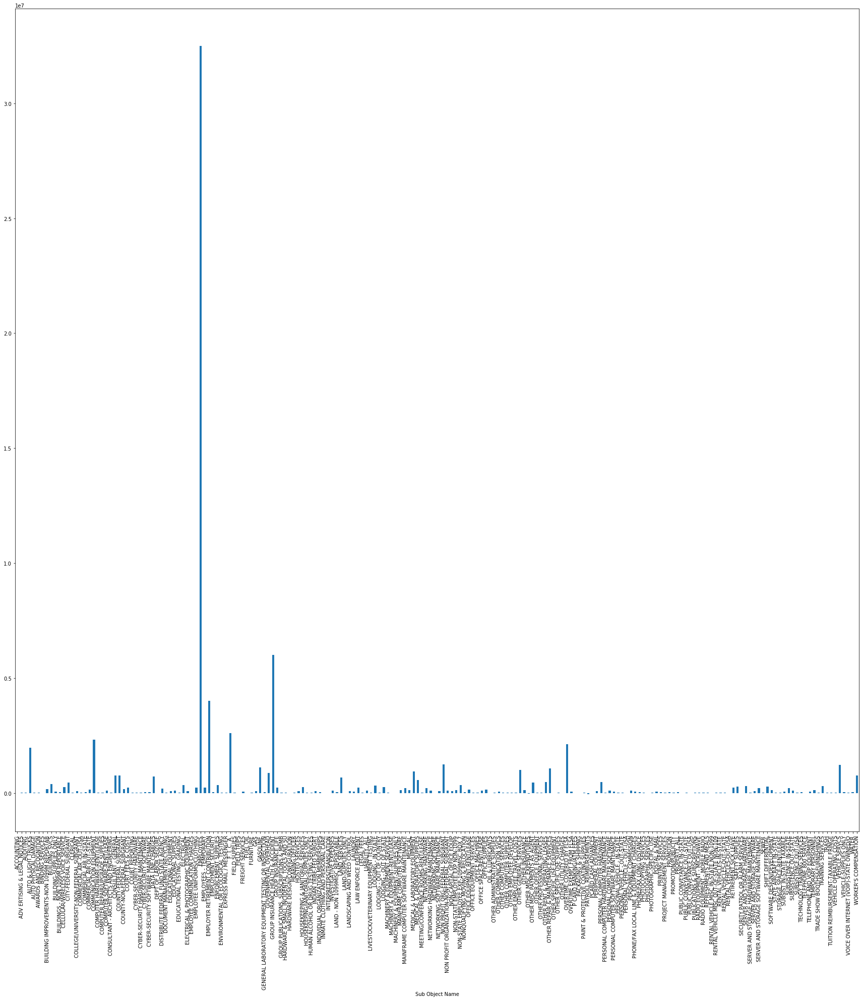

In [691]:
grouped_police_sub_2019 = fy2019[fy2019['Agency Name'] == 'POLICE, IDAHO STATE'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_police_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

In [692]:
grouped_police_sub_sum_2018 = grouped_police_sub_2018['Amount'].agg(np.sum)
grouped_police_max_sum_2018 = grouped_police_sub_sum_2018.max()
grouped_police_name_sum_2018 = grouped_police_sub_sum_2018.idxmax()

grouped_police_sub_sum_2019 = grouped_police_sub_2019['Amount'].agg(np.sum)
grouped_police_max_sum_2019 = grouped_police_sub_sum_2019.max()
grouped_police_name_sum_2019 = grouped_police_sub_sum_2019.idxmax()

print("For 2018, " + grouped_police_name_sum_2018 + " had the most expenditure for the total cost of all the Idaho State Police at " + str(grouped_police_max_sum_2018) + ".")
print("For 2019, " + grouped_police_name_sum_2019 + " had the most expenditure for the total cost of all Idaho State Police at " + str(grouped_police_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_police_max_sum_2019 - grouped_police_max_sum_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEES had the most expenditure for the total cost of all the Idaho State Police at 31469012.240000002.
For 2019, EMPLOYEES had the most expenditure for the total cost of all Idaho State Police at 32491389.089999728.
The average increase/decrease was 1022376.8499997258 between 2018 and 2019.


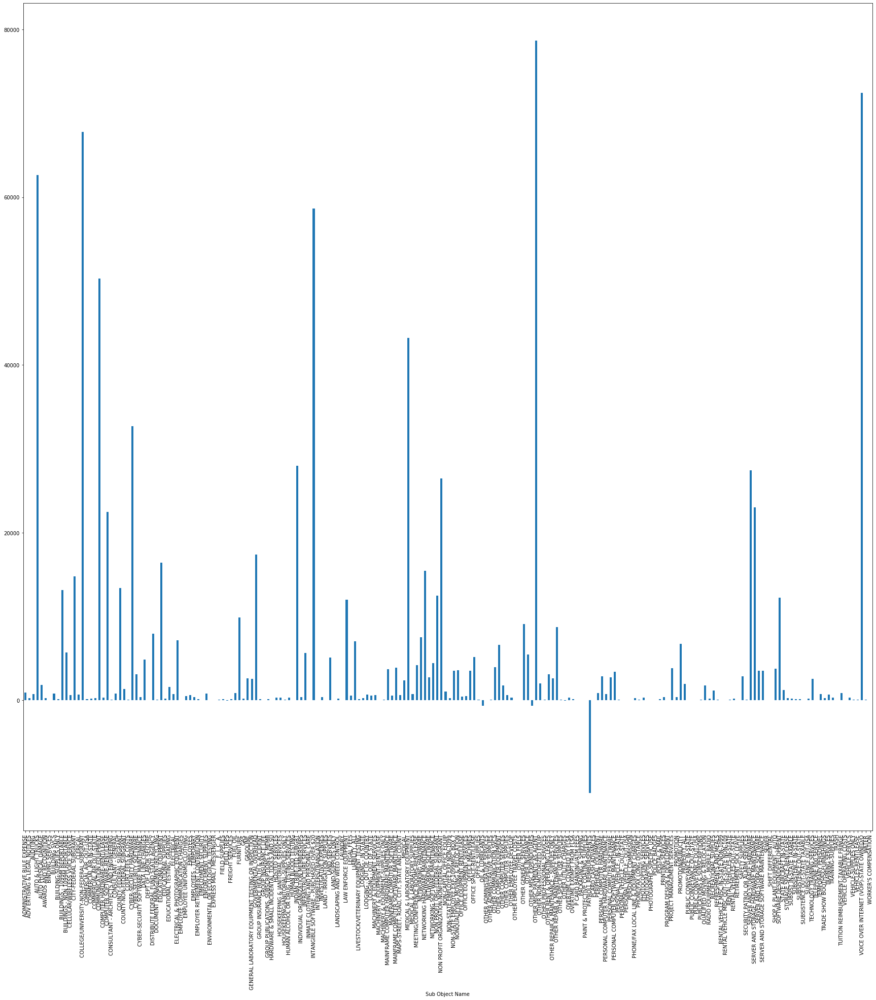

In [693]:
grouped_police_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

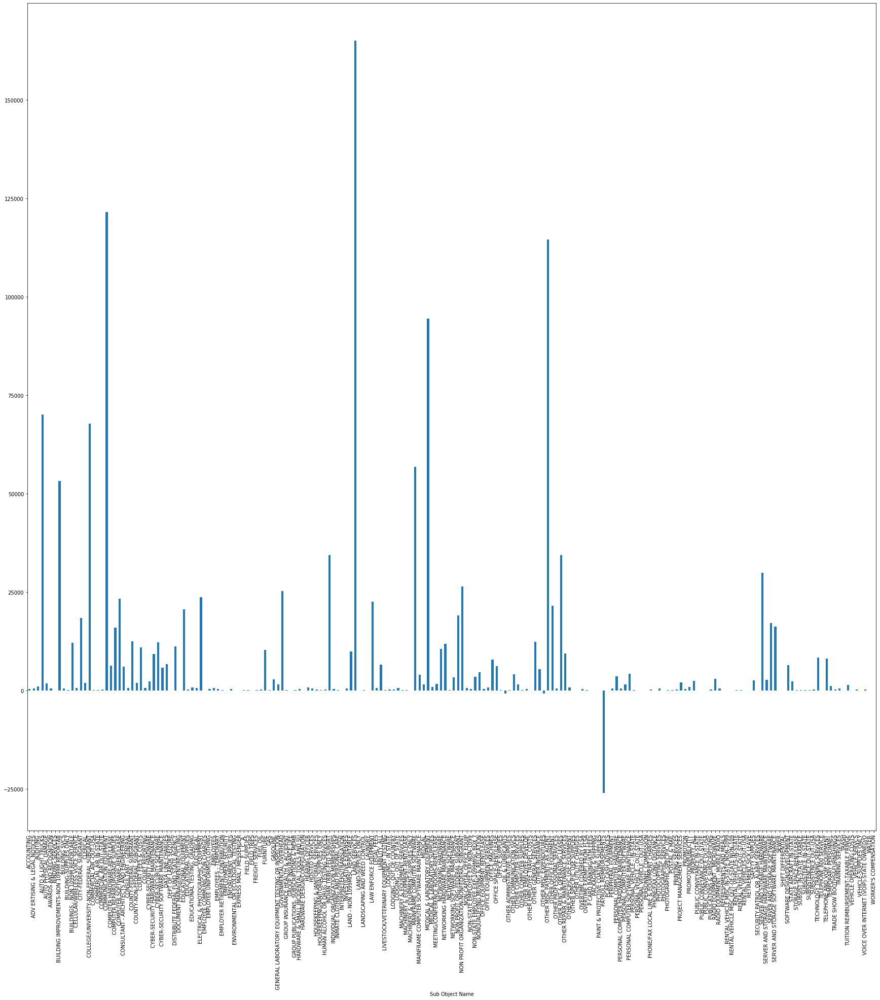

In [694]:
grouped_police_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

In [695]:
grouped_police_sub_mean_2018 = grouped_police_sub_2018['Amount'].agg(np.mean)
grouped_police_max_mean_2018 = grouped_police_sub_mean_2018.max()
grouped_police_name_mean_2018 = grouped_police_sub_mean_2018.idxmax()

grouped_police_sub_mean_2019 = grouped_police_sub_2019['Amount'].agg(np.mean)
grouped_police_max_mean_2019 = grouped_police_sub_mean_2019.max()
grouped_police_name_mean_2019 = grouped_police_sub_mean_2019.idxmax()

print("For 2018, " + grouped_police_name_mean_2018 + " had the most expenditure for the average cost of all the Idaho State Police at " + str(grouped_police_max_mean_2018) + ".")
print("For 2019, " + grouped_police_name_mean_2019 + " had the most expenditure for the average cost of all Idaho State Police at " + str(grouped_police_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_police_max_mean_2019 - grouped_police_max_mean_2018) + " between 2018 and 2019.")

For 2018, OTHER MISC PAYMENTS AS AGENT had the most expenditure for the average cost of all the Idaho State Police at 78640.6.
For 2019, LAND SERVICES had the most expenditure for the average cost of all Idaho State Police at 165000.0.


In [696]:
grouped_police_sub_mean_2018 = grouped_police_sub_2018['Amount'].agg(np.mean)
grouped_police_min_mean_2018 = grouped_police_sub_mean_2018.min()
grouped_police_name_mean_2018 = grouped_police_sub_mean_2018.idxmin()

grouped_police_sub_mean_2019 = grouped_police_sub_2019['Amount'].agg(np.mean)
grouped_police_min_mean_2019 = grouped_police_sub_mean_2019.min()
grouped_police_name_mean_2019 = grouped_police_sub_mean_2019.idxmin()

print("For 2018, " + grouped_police_name_mean_2018 + " had the least expenditure for the average cost of all the Idaho State Police at " + str(grouped_police_min_mean_2018) + ".")
print("For 2019, " + grouped_police_name_mean_2019 + " had the least expenditure for the average cost of all Idaho State Police at " + str(grouped_police_min_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_police_min_mean_2019 - grouped_police_min_mean_2018) + " between 2018 and 2019.")

For 2018, PAYROLL REIMBURSEMENTS had the least expenditure for the average cost of all the Idaho State Police at -11039.154.
For 2019, PAYROLL REIMBURSEMENTS had the least expenditure for the average cost of all Idaho State Police at -25985.155.
The average increase/decrease was -14946.000999999998 between 2018 and 2019.


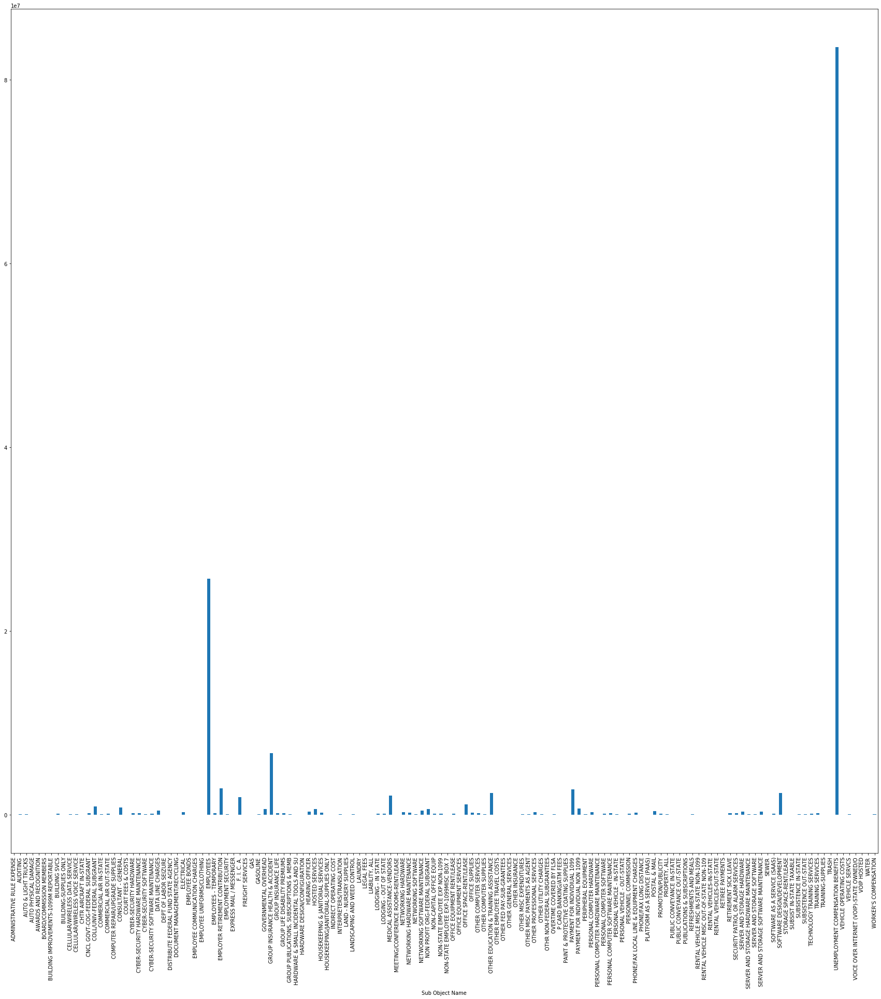

In [697]:
grouped_labor_sub_2018 = fy2018[fy2018['Agency Name'] == 'LABOR, DEPARTMENT OF'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_labor_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

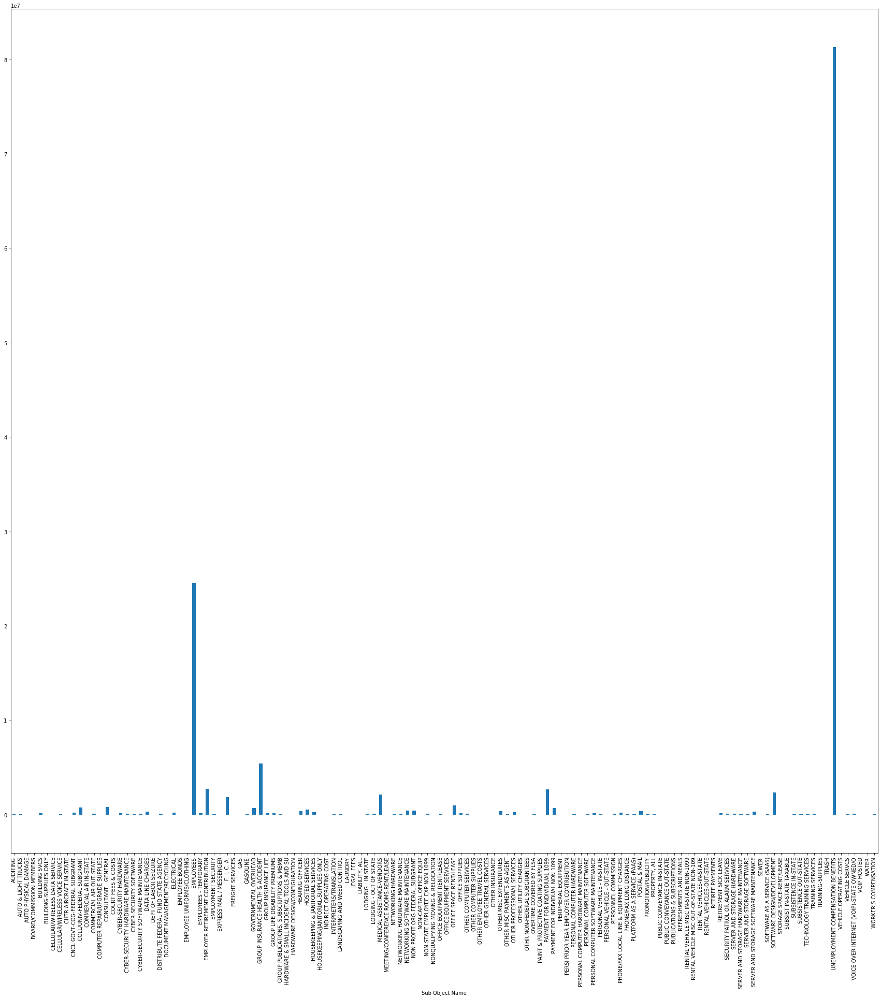

In [698]:
grouped_labor_sub_2019 = fy2019[fy2019['Agency Name'] == 'LABOR, DEPARTMENT OF'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_labor_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

In [699]:
grouped_labor_sub_sum_2018 = grouped_labor_sub_2018['Amount'].agg(np.sum)
grouped_labor_max_sum_2018 = grouped_labor_sub_sum_2018.max()
grouped_labor_name_sum_2018 = grouped_labor_sub_sum_2018.idxmax()

grouped_labor_sub_sum_2019 = grouped_labor_sub_2019['Amount'].agg(np.sum)
grouped_labor_max_sum_2019 = grouped_labor_sub_sum_2019.max()
grouped_labor_name_sum_2019 = grouped_labor_sub_sum_2019.idxmax()

print("For 2018, " + grouped_labor_name_sum_2018 + " had the most expenditure for the total cost of all the Department of Labor at " + str(grouped_labor_max_sum_2018) + ".")
print("For 2019, " + grouped_labor_name_sum_2019 + " had the most expenditure for the total cost of all Department of Labor at " + str(grouped_labor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_labor_max_sum_2019 - grouped_labor_max_sum_2018) + " between 2018 and 2019.")

For 2018, UNEMPLOYMENT COMPENSATION BENEFITS had the most expenditure for the total cost of all the Department of Labor at 83529445.89000003.
For 2019, UNEMPLOYMENT COMPENSATION BENEFITS had the most expenditure for the total cost of all Department of Labor at 81277003.50999993.
The average increase/decrease was -2252442.3800000995 between 2018 and 2019.


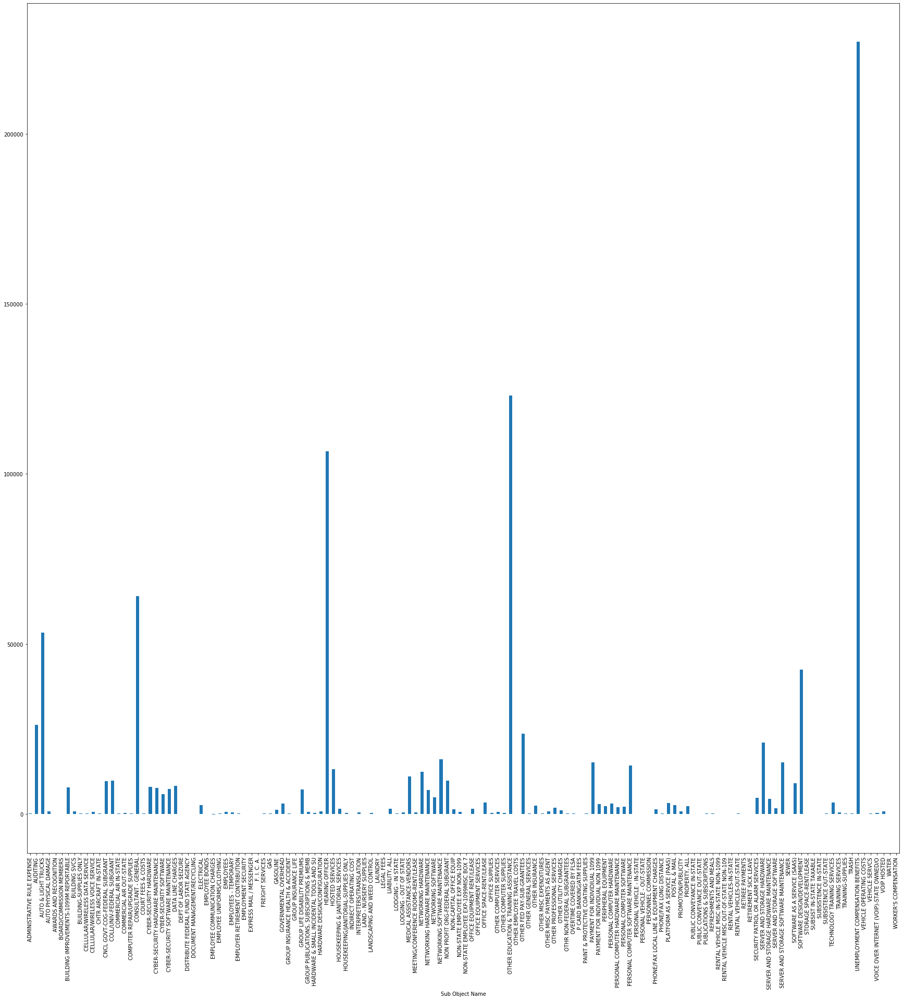

In [700]:
grouped_labor_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

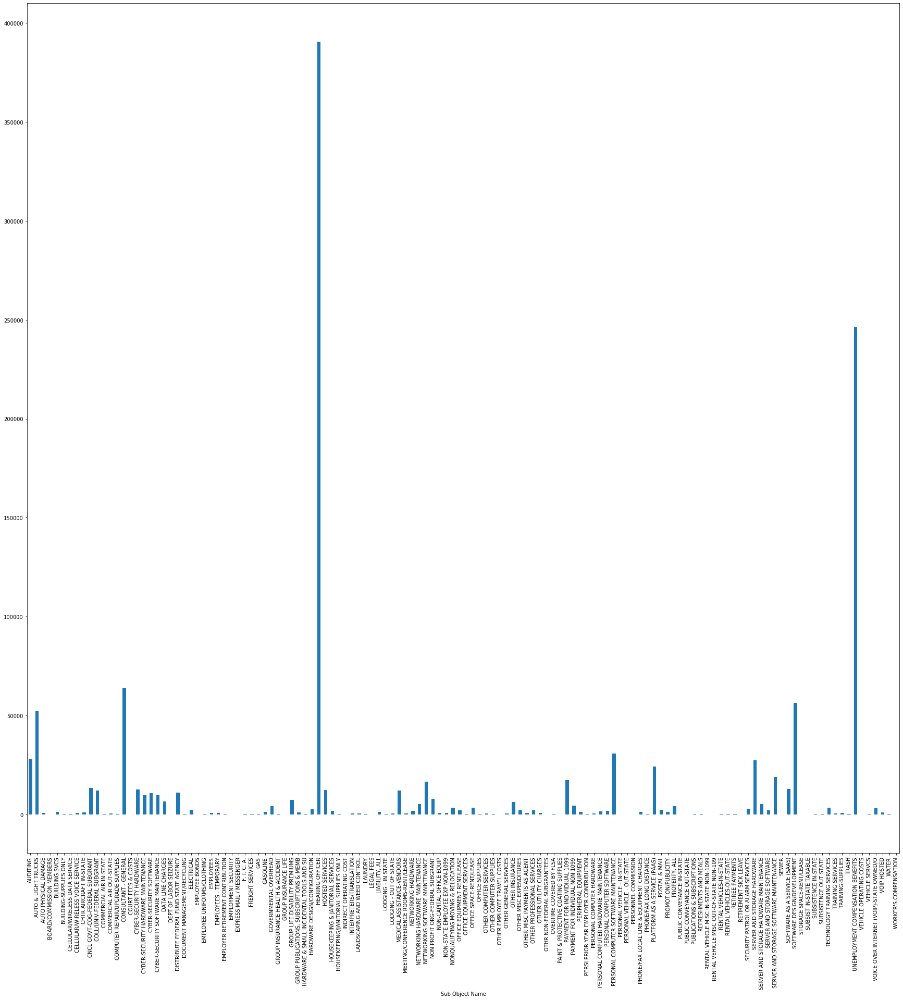

In [701]:
grouped_labor_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

In [702]:
grouped_labor_sub_mean_2018 = grouped_labor_sub_2018['Amount'].agg(np.mean)
grouped_labor_max_mean_2018 = grouped_labor_sub_mean_2018.max()
grouped_labor_name_mean_2018 = grouped_labor_sub_mean_2018.idxmax()

grouped_labor_sub_mean_2019 = grouped_labor_sub_2019['Amount'].agg(np.mean)
grouped_labor_max_mean_2019 = grouped_labor_sub_mean_2019.max()
grouped_labor_name_mean_2019 = grouped_labor_sub_mean_2019.idxmax()

print("For 2018, " + grouped_labor_name_mean_2018 + " had the most expenditure for the average cost of all the Department of Labor at " + str(grouped_labor_max_mean_2018) + ".")
print("For 2019, " + grouped_labor_name_mean_2019 + " had the most expenditure for the average cost of all Department of Labor at " + str(grouped_labor_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_labor_max_mean_2019 - grouped_labor_max_mean_2018) + " between 2018 and 2019.")

For 2018, UNEMPLOYMENT COMPENSATION BENEFITS had the most expenditure for the average cost of all the Department of Labor at 226982.18991847834.
For 2019, HEARING OFFICER had the most expenditure for the average cost of all Department of Labor at 390452.38.


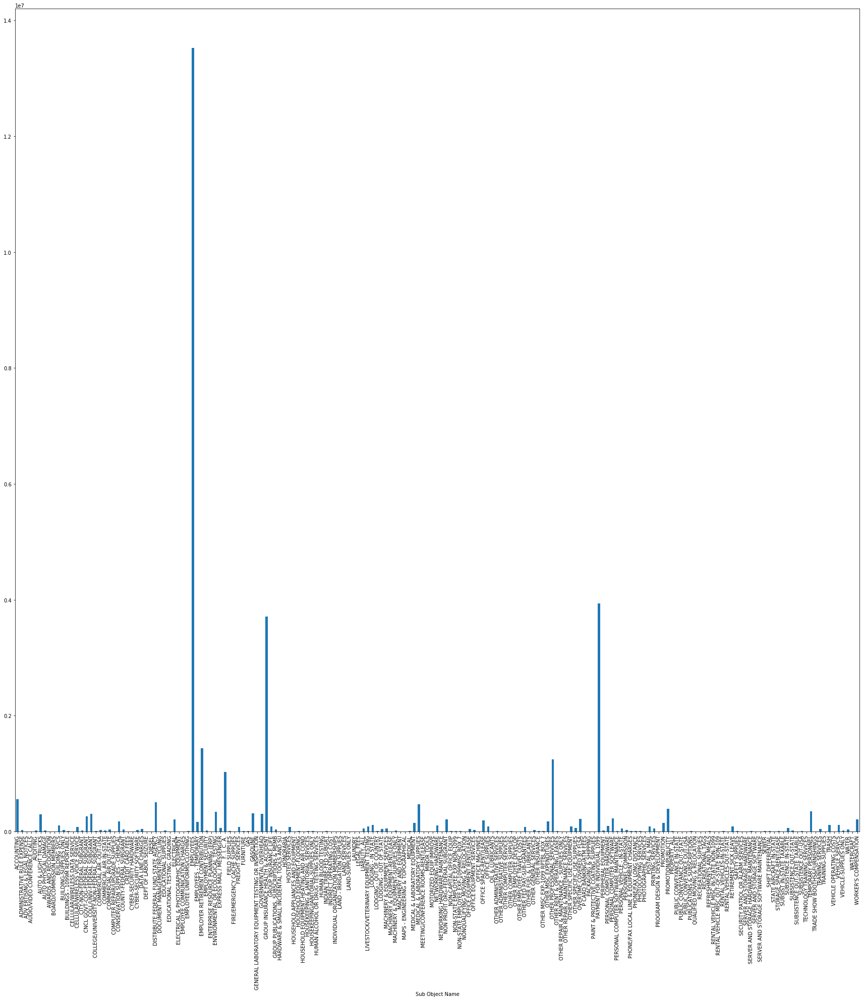

In [703]:
grouped_AG_sub_2018 = fy2018[fy2018['Agency Name'] == 'AGRICULTURE, DEPARTMENT OF'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_AG_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

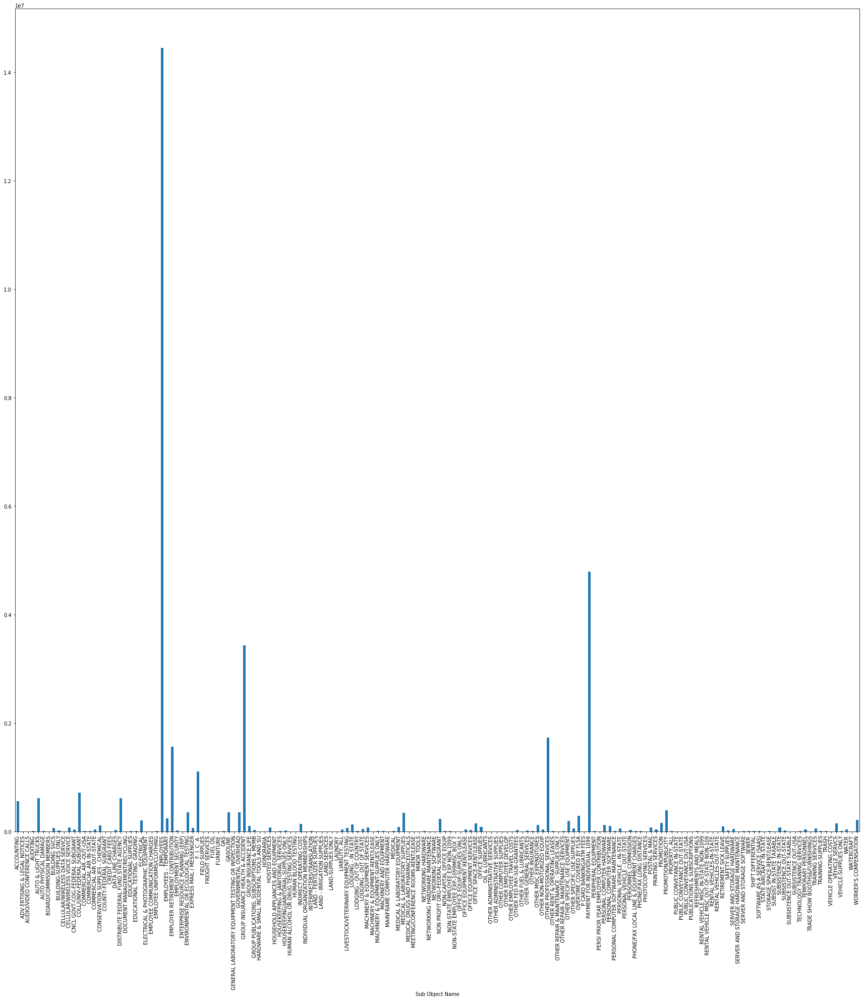

In [704]:
grouped_AG_sub_2019 = fy2019[fy2019['Agency Name'] == 'AGRICULTURE, DEPARTMENT OF'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_AG_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(30,30))

In [705]:
grouped_AG_sub_sum_2018 = grouped_AG_sub_2018['Amount'].agg(np.sum)
grouped_AG_max_sum_2018 = grouped_AG_sub_sum_2018.max()
grouped_AG_name_sum_2018 = grouped_AG_sub_sum_2018.idxmax()

grouped_AG_sub_sum_2019 = grouped_AG_sub_2019['Amount'].agg(np.sum)
grouped_AG_max_sum_2019 = grouped_AG_sub_sum_2019.max()
grouped_AG_name_sum_2019 = grouped_AG_sub_sum_2019.idxmax()

print("For 2018, " + grouped_AG_name_sum_2018 + " had the most expenditure for the total cost of all the Department of Agriculture at " + str(grouped_AG_max_sum_2018) + ".")
print("For 2019, " + grouped_AG_name_sum_2019 + " had the most expenditure for the total cost of all Department of Agriculture at " + str(grouped_AG_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_AG_max_sum_2019 - grouped_AG_max_sum_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEES had the most expenditure for the total cost of all the Department of Agriculture at 13523335.770000014.
For 2019, EMPLOYEES had the most expenditure for the total cost of all Department of Agriculture at 14448557.99999993.
The average increase/decrease was 925222.2299999148 between 2018 and 2019.


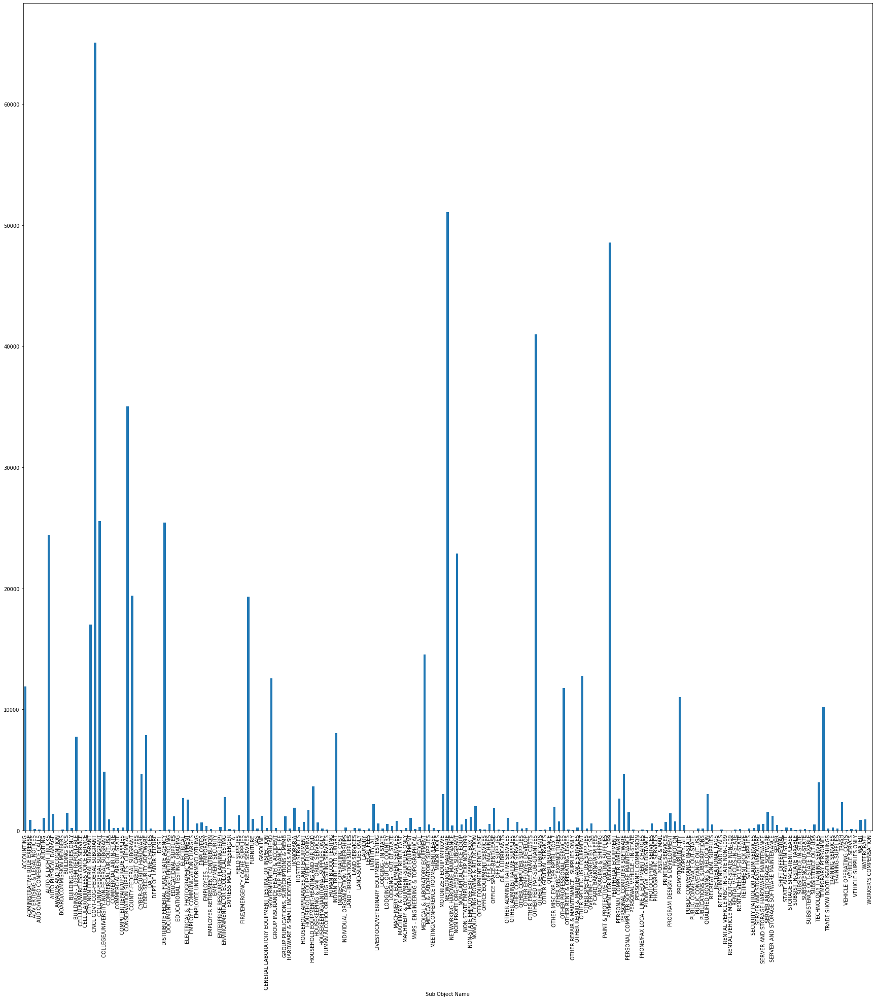

In [706]:
grouped_AG_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

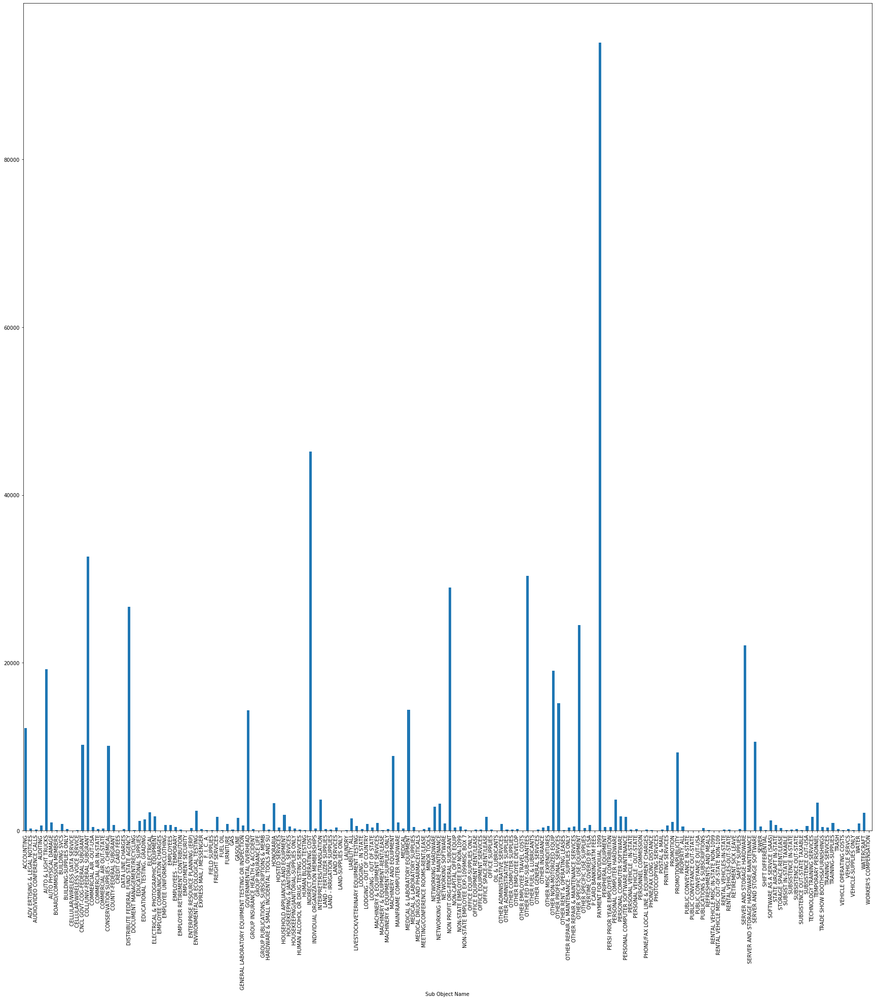

In [707]:
grouped_AG_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(30,30))

In [708]:
grouped_AG_sub_mean_2018 = grouped_AG_sub_2018['Amount'].agg(np.mean)
grouped_AG_max_mean_2018 = grouped_AG_sub_mean_2018.max()
grouped_AG_name_mean_2018 = grouped_AG_sub_mean_2018.idxmax()

grouped_AG_sub_mean_2019 = grouped_AG_sub_2019['Amount'].agg(np.mean)
grouped_AG_max_mean_2019 = grouped_AG_sub_mean_2019.max()
grouped_AG_name_mean_2019 = grouped_AG_sub_mean_2019.idxmax()

print("For 2018, " + grouped_AG_name_mean_2018 + " had the most expenditure for the average cost of all the Department of Agriculture at " + str(grouped_AG_max_mean_2018) + ".")
print("For 2019, " + grouped_AG_name_mean_2019 + " had the most expenditure for the average cost of all Department of Agriculture at " + str(grouped_AG_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_AG_max_mean_2019 - grouped_AG_max_mean_2018) + " between 2018 and 2019.")

For 2018, CNCL GOVT-COG-FEDERAL SUBGRANT had the most expenditure for the average cost of all the Department of Agriculture at 65072.92.
For 2019, PAYMENT FOR INDIVIDIUAL 1099 had the most expenditure for the average cost of all Department of Agriculture at 93909.35137254902.


Sub Object Name
ANNUAL LEAVE BALANCES                     2.910383e-11
EMPLOYER RETIREMENT CONTRIBUTION          1.134986e+08
EMPLOYMENT SECURITY                       1.508099e+06
F. I. C. A.                               7.729779e+07
GROUP INSURANCE HEALTH & ACCIDENT         2.460825e+08
GROUP INSURANCE LIFE                      6.742594e+06
JUDGES RETIREMENT                         3.847296e+06
MEDICARE - U OF I                         3.262292e+04
PERSI PRIOR YEAR EMPLOYER CONTRIBUTION    8.428490e+03
PERSONNEL COMMISSION                      2.023270e+06
RETIREMENT SICK LEAVE                     6.606670e+06
SICK LEAVE BALANCES                       0.000000e+00
WORKER'S COMPENSATION                     1.324043e+07
WORKER'S COMPENSATION CREDIT              0.000000e+00
WORKERS COMPENSATION AUDIT ADJUSTMENT     0.000000e+00
Name: Amount, dtype: float64

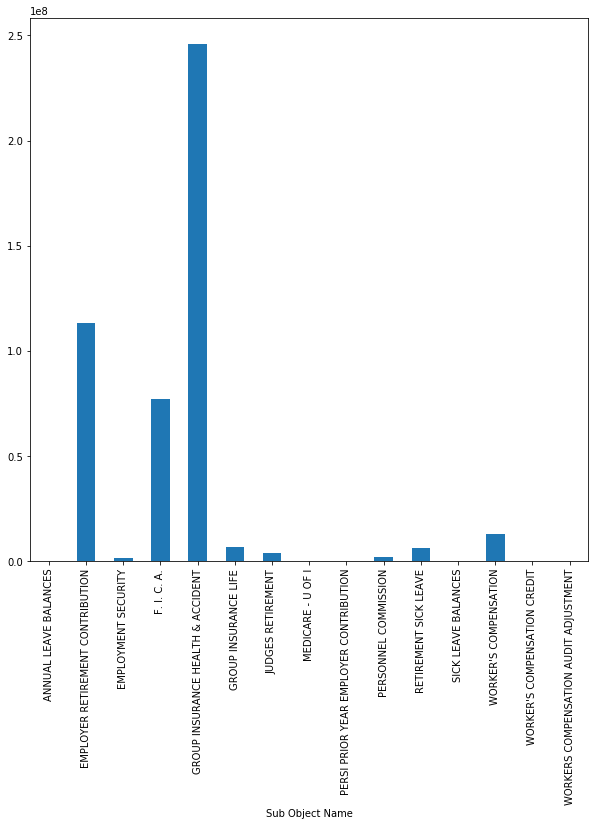

In [709]:
grouped_emp_benefits_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'EMPLOYEE BENEFITS'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_emp_benefits_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_emp_benefits_sub_2018['Amount'].agg(np.sum)

Sub Object Name
ANNUAL LEAVE BALANCES                     5.280754e-11
EMPLOYER RETIREMENT CONTRIBUTION          1.175819e+08
EMPLOYMENT SECURITY                       1.341971e+06
F. I. C. A.                               7.988702e+07
GROUP INSURANCE HEALTH & ACCIDENT         2.159912e+08
GROUP INSURANCE LIFE                      7.398211e+06
JUDGES RETIREMENT                         4.177002e+06
MEDICARE - U OF I                         3.662220e+04
PERSI PRIOR YEAR EMPLOYER CONTRIBUTION    3.074164e+04
PERSONNEL COMMISSION                      2.096133e+06
RETIREMENT SICK LEAVE                     6.837220e+06
WORKER'S COMPENSATION                     1.341574e+07
Name: Amount, dtype: float64

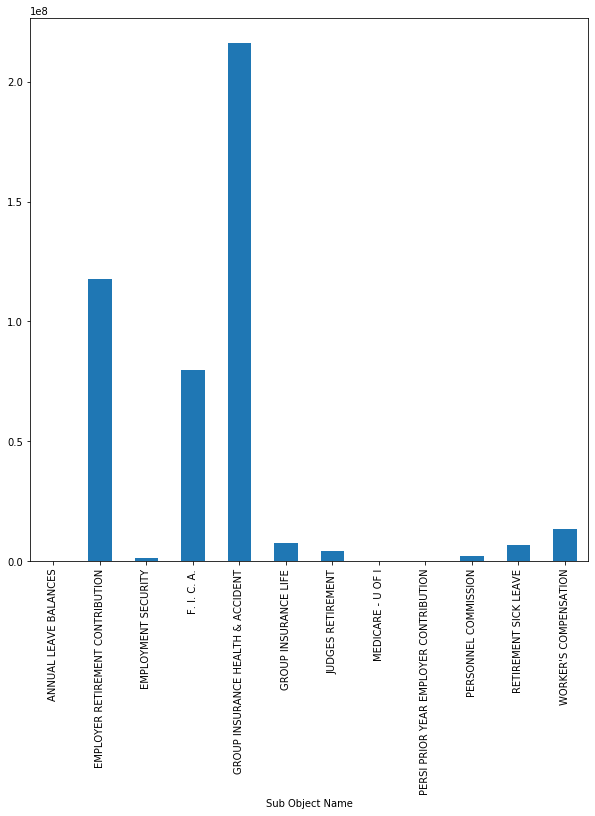

In [710]:
grouped_emp_benefits_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'EMPLOYEE BENEFITS'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_emp_benefits_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_emp_benefits_sub_2019['Amount'].agg(np.sum)

In [711]:
grouped_emp_benefits_sub_sum_2018 = grouped_emp_benefits_sub_2018['Amount'].agg(np.sum)
grouped_emp_benefits_sub_max_sum_2018 = grouped_emp_benefits_sub_sum_2018.max()
grouped_emp_benefits_sub_name_sum_2018 = grouped_emp_benefits_sub_sum_2018.idxmax()
grouped_emp_benefits_sub_name_sum_2018= grouped_emp_benefits_sub_name_sum_2018.strip()

grouped_emp_benefits_sub_sum_2019 = grouped_emp_benefits_sub_2019['Amount'].agg(np.sum)
grouped_emp_benefits_sub_max_sum_2019 = grouped_emp_benefits_sub_sum_2019.max()
grouped_emp_benefits_sub_name_sum_2019 = grouped_emp_benefits_sub_sum_2019.idxmax()
grouped_emp_benefits_sub_name_sum_2019 = grouped_emp_benefits_sub_name_sum_2019.strip()

print("For 2018, " + grouped_emp_benefits_sub_name_sum_2018 + " had the most expenditure for the total cost of all Employee Benefits at " + str(grouped_emp_benefits_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_emp_benefits_sub_name_sum_2019 + " had the most expenditure for the total cost of all Employee Benefits at " + str(grouped_emp_benefits_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_emp_benefits_sub_max_sum_2019 - grouped_emp_benefits_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, GROUP INSURANCE HEALTH & ACCIDENT had the most expenditure for the total cost of all Employee Benefits at 246082502.41766205.
For 2019, GROUP INSURANCE HEALTH & ACCIDENT had the most expenditure for the total cost of all Employee Benefits at 215991193.84961054.
The average increase/decrease was -30091308.568051517 between 2018 and 2019.


Sub Object Name
ANNUAL LEAVE BALANCES                     7.788722e-14
EMPLOYER RETIREMENT CONTRIBUTION          2.034233e+02
EMPLOYMENT SECURITY                       2.230396e+00
F. I. C. A.                               1.303652e+02
GROUP INSURANCE HEALTH & ACCIDENT         2.602765e+02
GROUP INSURANCE LIFE                      2.661198e+01
JUDGES RETIREMENT                         6.693914e+03
MEDICARE - U OF I                         3.269839e+02
PERSI PRIOR YEAR EMPLOYER CONTRIBUTION    2.561803e+03
PERSONNEL COMMISSION                      5.363191e+00
RETIREMENT SICK LEAVE                     1.189018e+01
WORKER'S COMPENSATION                     2.229205e+01
Name: Amount, dtype: float64

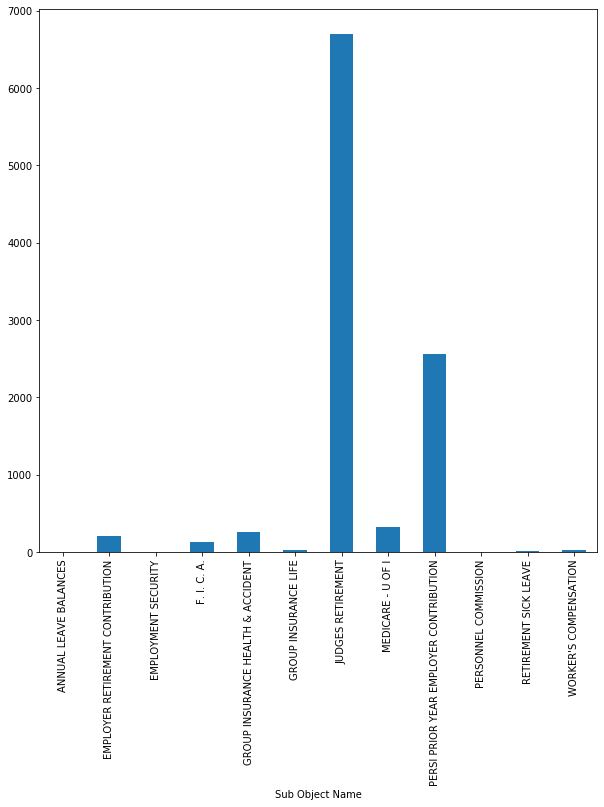

In [712]:
grouped_emp_benefits_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_emp_benefits_sub_2019['Amount'].agg(np.mean)

Sub Object Name
ANNUAL LEAVE BALANCES                     7.788722e-14
EMPLOYER RETIREMENT CONTRIBUTION          2.034233e+02
EMPLOYMENT SECURITY                       2.230396e+00
F. I. C. A.                               1.303652e+02
GROUP INSURANCE HEALTH & ACCIDENT         2.602765e+02
GROUP INSURANCE LIFE                      2.661198e+01
JUDGES RETIREMENT                         6.693914e+03
MEDICARE - U OF I                         3.269839e+02
PERSI PRIOR YEAR EMPLOYER CONTRIBUTION    2.561803e+03
PERSONNEL COMMISSION                      5.363191e+00
RETIREMENT SICK LEAVE                     1.189018e+01
WORKER'S COMPENSATION                     2.229205e+01
Name: Amount, dtype: float64

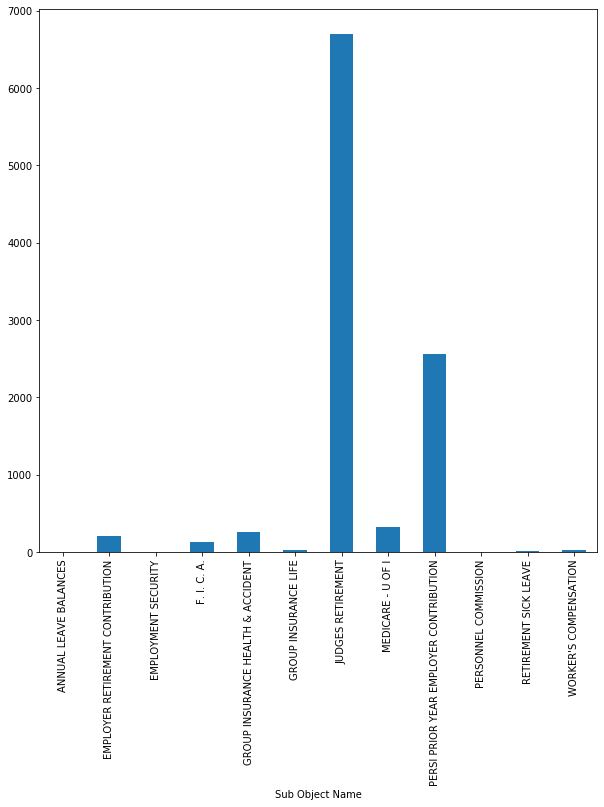

In [713]:
grouped_emp_benefits_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_emp_benefits_sub_2019['Amount'].agg(np.mean)

In [714]:
grouped_emp_benefits_sub_mean_2018 = grouped_emp_benefits_sub_2018['Amount'].agg(np.mean)
grouped_emp_benefits_sub_max_mean_2018 = grouped_emp_benefits_sub_mean_2018.max()
grouped_emp_benefits_sub_name_mean_2018 = grouped_emp_benefits_sub_mean_2018.idxmax()
grouped_emp_benefits_sub_name_mean_2018= grouped_emp_benefits_sub_name_mean_2018.strip()

grouped_emp_benefits_sub_mean_2019 = grouped_emp_benefits_sub_2019['Amount'].agg(np.mean)
grouped_emp_benefits_sub_max_mean_2019 = grouped_emp_benefits_sub_mean_2019.max()
grouped_emp_benefits_sub_name_mean_2019 = grouped_emp_benefits_sub_mean_2019.idxmax()
grouped_emp_benefits_sub_name_mean_2019 = grouped_emp_benefits_sub_name_mean_2019.strip()

print("For 2018, " + grouped_emp_benefits_sub_name_mean_2018 + " had the most expenditure for the average cost of all Employee Benefits at " + str(grouped_emp_benefits_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_emp_benefits_sub_name_mean_2019 + " had the most expenditure for the average cost of all Employee Benefits at " + str(grouped_emp_benefits_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_emp_benefits_sub_max_mean_2019 - grouped_emp_benefits_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, JUDGES RETIREMENT had the most expenditure for the average cost of all Employee Benefits at 6785.353985890641.
For 2019, JUDGES RETIREMENT had the most expenditure for the average cost of all Employee Benefits at 6693.913862179486.
The average increase/decrease was -91.44012371115423 between 2018 and 2019.


Sub Object Name
BOARD/COMMISSION MEMBERS      4.437900e+05
COMPENSATORY LEAVE BALANCE    0.000000e+00
EMPLOYEE-EMERGENCY HELP       6.352441e+06
EMPLOYEES                     9.961693e+08
EMPLOYEES - TEMPORARY         3.787962e+07
OVERTIME COVERED BY FLSA      1.095404e+07
OVERTIME EXEMPT FROM FLSA     1.278959e+06
PAYROLL REIMBURSEMENTS       -2.187874e+05
SHIFT DIFFERENTIAL            2.473080e+06
SPORADIC SPECIAL PAY          5.731341e+06
STUDENT                       7.502353e+06
Name: Amount, dtype: float64

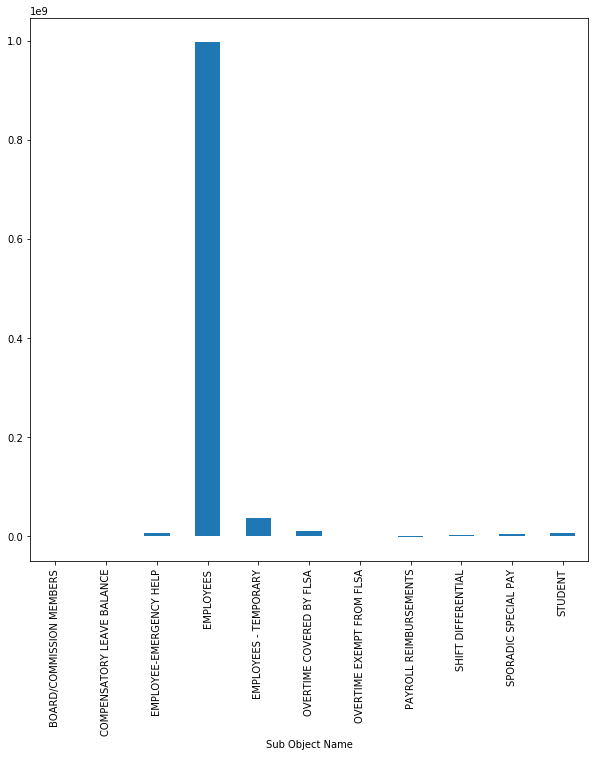

In [715]:
grouped_gross_salary_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'GROSS SALARY & WAGE'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_gross_salary_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_gross_salary_sub_2018['Amount'].agg(np.sum)

Sub Object Name
BOARD/COMMISSION MEMBERS      4.564262e+05
COMPENSATORY LEAVE BALANCE   -1.705303e-13
EMPLOYEE-EMERGENCY HELP       2.923343e+06
EMPLOYEES                     1.032996e+09
EMPLOYEES - TEMPORARY         4.236522e+07
OVERTIME COVERED BY FLSA      1.332460e+07
OVERTIME EXEMPT FROM FLSA     1.161965e+06
PAYROLL REIMBURSEMENTS       -2.173648e+05
SHIFT DIFFERENTIAL            2.541842e+06
SPORADIC SPECIAL PAY          4.847114e+06
STUDENT                       6.301121e+06
Name: Amount, dtype: float64

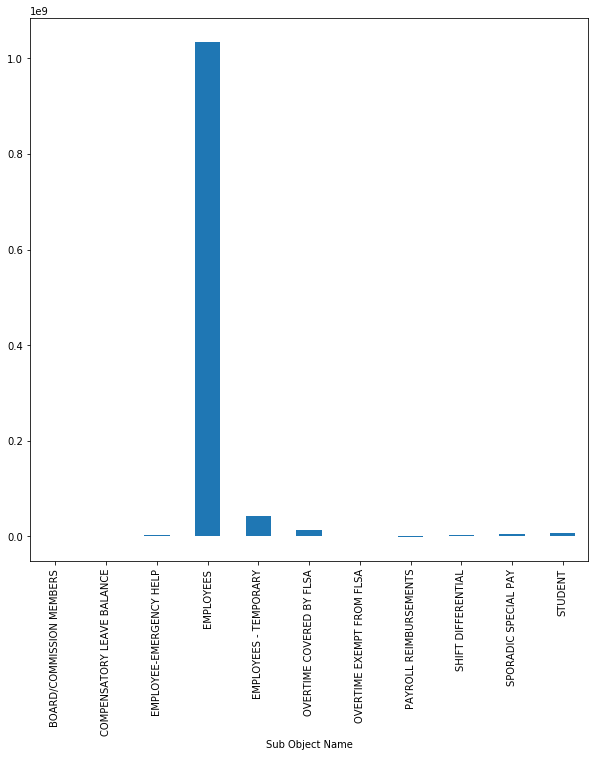

In [716]:
grouped_gross_salary_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'GROSS SALARY & WAGE'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_gross_salary_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_gross_salary_sub_2019['Amount'].agg(np.sum)

In [717]:
grouped_gross_salary_sub_sum_2018 = grouped_gross_salary_sub_2018['Amount'].agg(np.sum)
grouped_gross_salary_sub_max_sum_2018 = grouped_gross_salary_sub_sum_2018.max()
grouped_gross_salary_sub_name_sum_2018 = grouped_gross_salary_sub_sum_2018.idxmax()
grouped_gross_salary_sub_name_sum_2018= grouped_gross_salary_sub_name_sum_2018.strip()

grouped_gross_salary_sub_sum_2019 = grouped_gross_salary_sub_2019['Amount'].agg(np.sum)
grouped_gross_salary_sub_max_sum_2019 = grouped_gross_salary_sub_sum_2019.max()
grouped_gross_salary_sub_name_sum_2019 = grouped_gross_salary_sub_sum_2019.idxmax()
grouped_gross_salary_sub_name_sum_2019 = grouped_gross_salary_sub_name_sum_2019.strip()

print("For 2018, " + grouped_gross_salary_sub_name_sum_2018 + " had the most expenditure for the total cost of all Gross Salary & Wage at " + str(grouped_gross_salary_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_gross_salary_sub_name_sum_2019 + " had the most expenditure for the total cost of all Gross Salary & Wage at " + str(grouped_gross_salary_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_gross_salary_sub_max_sum_2019 - grouped_gross_salary_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEES had the most expenditure for the total cost of all Gross Salary & Wage at 996169320.3699278.
For 2019, EMPLOYEES had the most expenditure for the total cost of all Gross Salary & Wage at 1032995749.6699715.
The average increase/decrease was 36826429.3000437 between 2018 and 2019.


Sub Object Name
BOARD/COMMISSION MEMBERS        180.991028
COMPENSATORY LEAVE BALANCE        0.000000
EMPLOYEE-EMERGENCY HELP       40461.406752
EMPLOYEES                       941.026130
EMPLOYEES - TEMPORARY           789.701728
OVERTIME COVERED BY FLSA        287.862689
OVERTIME EXEMPT FROM FLSA      1048.326861
PAYROLL REIMBURSEMENTS        -4465.048367
SHIFT DIFFERENTIAL               64.731829
SPORADIC SPECIAL PAY           1110.294713
STUDENT                        1130.042559
Name: Amount, dtype: float64

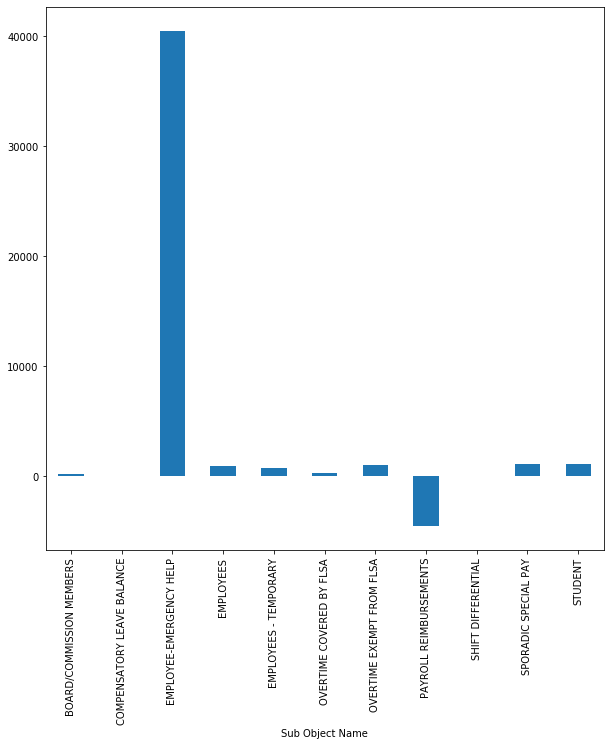

In [718]:
grouped_gross_salary_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_gross_salary_sub_2018['Amount'].agg(np.mean)

Sub Object Name
BOARD/COMMISSION MEMBERS      1.850127e+02
COMPENSATORY LEAVE BALANCE   -9.168293e-16
EMPLOYEE-EMERGENCY HELP       7.900926e+04
EMPLOYEES                     9.792571e+02
EMPLOYEES - TEMPORARY         8.826455e+02
OVERTIME COVERED BY FLSA      3.316558e+02
OVERTIME EXEMPT FROM FLSA     1.032857e+03
PAYROLL REIMBURSEMENTS       -3.622746e+03
SHIFT DIFFERENTIAL            6.904927e+01
SPORADIC SPECIAL PAY          1.156001e+03
STUDENT                       1.065819e+03
Name: Amount, dtype: float64

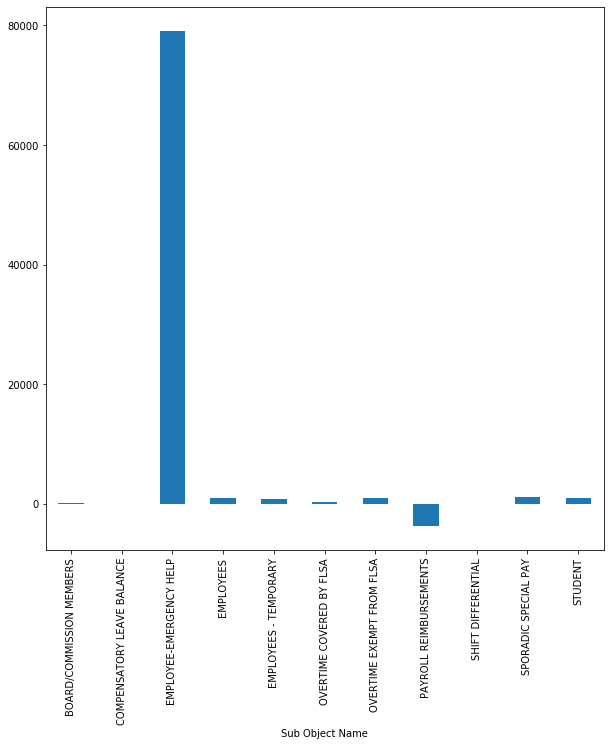

In [719]:
grouped_gross_salary_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_gross_salary_sub_2019['Amount'].agg(np.mean)

In [720]:
grouped_gross_salary_sub_mean_2018 = grouped_gross_salary_sub_2018['Amount'].agg(np.mean)
grouped_gross_salary_sub_max_mean_2018 = grouped_gross_salary_sub_mean_2018.max()
grouped_gross_salary_sub_name_mean_2018 = grouped_gross_salary_sub_mean_2018.idxmax()
grouped_gross_salary_sub_name_mean_2018= grouped_gross_salary_sub_name_mean_2018.strip()

grouped_gross_salary_sub_mean_2019 = grouped_gross_salary_sub_2019['Amount'].agg(np.mean)
grouped_gross_salary_sub_max_mean_2019 = grouped_gross_salary_sub_mean_2019.max()
grouped_gross_salary_sub_name_mean_2019 = grouped_gross_salary_sub_mean_2019.idxmax()
grouped_gross_salary_sub_name_mean_2019 = grouped_gross_salary_sub_name_mean_2019.strip()

print("For 2018, " + grouped_gross_salary_sub_name_mean_2018 + " had the most expenditure for the average cost of all Gross Salary & Wage at " + str(grouped_gross_salary_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_gross_salary_sub_name_mean_2019 + " had the most expenditure for the average cost of all Gross Salary & Wage at " + str(grouped_gross_salary_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_gross_salary_sub_max_mean_2019 - grouped_gross_salary_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEE-EMERGENCY HELP had the most expenditure for the average cost of all Gross Salary & Wage at 40461.406751592345.
For 2019, EMPLOYEE-EMERGENCY HELP had the most expenditure for the average cost of all Gross Salary & Wage at 79009.26405405407.
The average increase/decrease was 38547.85730246173 between 2018 and 2019.


Sub Object Name
CRIME VICTIMS COMPENSATION-1099                       2.435210e+05
CRIME VICTIMS COMPENSATION-1099 MED                   1.797513e+06
CRIME VICTIMS COMPENSATION-NON-1099                   2.403714e+05
DAYCARE PAYMENTS TO PROVIDERS                         3.605130e+07
INCOME ASSISTANCE PAYMENTS                            6.037052e+07
MEDICAL ASSISTANCE-INDIVIDUALS                        4.288375e+05
MEDICAL ASSISTANCE-VENDORS                            2.270323e+09
OTHER AWARDS/CONTRIBUTIONS/CLAIMS                     4.049363e+07
PEACE/DETENTION OFFICER TEMPORARY DISABILITY REIMB    4.975959e+04
PREMIUM REFUNDS                                      -1.469965e+07
PREMIUMS                                              3.245858e+08
PRIZE & AWARDS-1099BX3                                8.432355e+04
PRIZE PAYMENTS                                        3.539488e+07
RISK MANAGEMENT PAYMENTS                              1.760669e+06
RISK MANAGEMENT PAYMENTS - GROSS PROCEEDS     

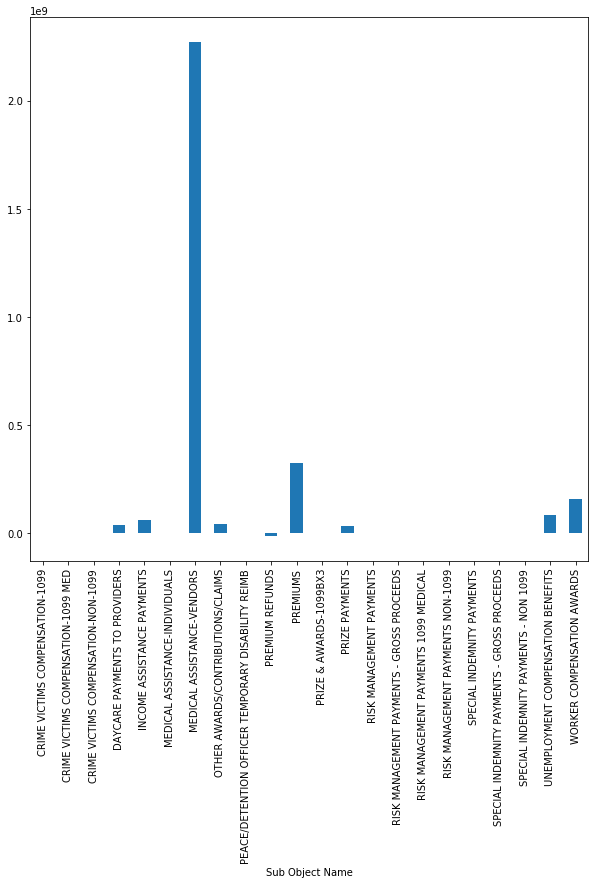

In [721]:
grouped_awards_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'AWARDS CONTR & CLAIMS'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_awards_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_awards_sub_2018['Amount'].agg(np.sum)

Sub Object Name
CRIME VICTIMS COMPENSATION-1099                       2.993619e+05
CRIME VICTIMS COMPENSATION-1099 MED                   2.055554e+06
CRIME VICTIMS COMPENSATION-NON-1099                   1.831518e+05
DAYCARE PAYMENTS TO PROVIDERS                         3.807744e+07
INCOME ASSISTANCE PAYMENTS                            6.325614e+07
MEDICAL ASSISTANCE-INDIVIDUALS                        1.812741e+05
MEDICAL ASSISTANCE-VENDORS                            2.417538e+09
OTHER AWARDS/CONTRIBUTIONS/CLAIMS                     3.710855e+07
PEACE/DETENTION OFFICER TEMPORARY DISABILITY REIMB    1.633174e+04
PREMIUM REFUNDS                                      -3.315849e+06
PREMIUMS                                              3.013448e+08
PRIZE & AWARDS-1099BX3                                7.714232e+04
PRIZE PAYMENTS                                        3.476139e+07
RISK MANAGEMENT PAYMENTS                              2.248168e+06
RISK MANAGEMENT PAYMENTS - GROSS PROCEEDS     

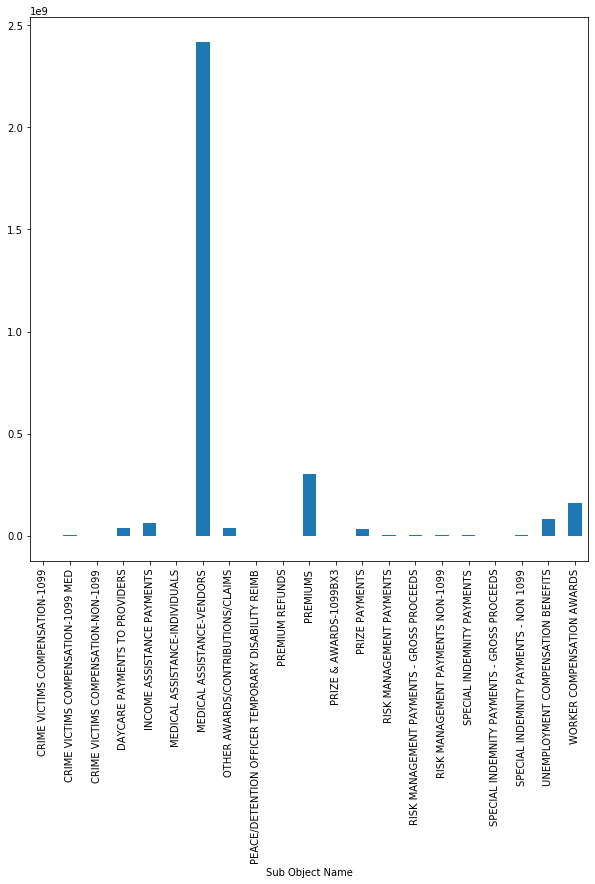

In [722]:
grouped_awards_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'AWARDS CONTR & CLAIMS'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_awards_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_awards_sub_2019['Amount'].agg(np.sum)

In [723]:
grouped_awards_sub_sum_2018 = grouped_awards_sub_2018['Amount'].agg(np.sum)
grouped_awards_sub_max_sum_2018 = grouped_awards_sub_sum_2018.max()
grouped_awards_sub_name_sum_2018 = grouped_awards_sub_sum_2018.idxmax()
grouped_awards_sub_name_sum_2018= grouped_awards_sub_name_sum_2018.strip()

grouped_awards_sub_sum_2019 = grouped_awards_sub_2019['Amount'].agg(np.sum)
grouped_awards_sub_max_sum_2019 = grouped_awards_sub_sum_2019.max()
grouped_awards_sub_name_sum_2019 = grouped_awards_sub_sum_2019.idxmax()
grouped_awards_sub_name_sum_2019 = grouped_awards_sub_name_sum_2019.strip()

print("For 2018, " + grouped_awards_sub_name_sum_2018 + " had the most expenditure for the total cost of all Awards Contr & Claims at " + str(grouped_awards_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_awards_sub_name_sum_2019 + " had the most expenditure for the total cost of all Awards Contr & Claims at " + str(grouped_awards_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_awards_sub_max_sum_2019 - grouped_awards_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, MEDICAL ASSISTANCE-VENDORS had the most expenditure for the total cost of all Awards Contr & Claims at 2270323465.2709417.
For 2019, MEDICAL ASSISTANCE-VENDORS had the most expenditure for the total cost of all Awards Contr & Claims at 2417537573.920935.
The average increase/decrease was 147214108.64999342 between 2018 and 2019.


Sub Object Name
CRIME VICTIMS COMPENSATION-1099                         1087.147321
CRIME VICTIMS COMPENSATION-1099 MED                     6560.265182
CRIME VICTIMS COMPENSATION-NON-1099                     1657.733586
DAYCARE PAYMENTS TO PROVIDERS                           3424.326013
INCOME ASSISTANCE PAYMENTS                             33372.316401
MEDICAL ASSISTANCE-INDIVIDUALS                          1817.108093
MEDICAL ASSISTANCE-VENDORS                              7506.889037
OTHER AWARDS/CONTRIBUTIONS/CLAIMS                      74164.165128
PEACE/DETENTION OFFICER TEMPORARY DISABILITY REIMB      3109.974375
PREMIUM REFUNDS                                      -397287.714595
PREMIUMS                                              491796.686606
PRIZE & AWARDS-1099BX3                                   551.134314
PRIZE PAYMENTS                                        104718.571479
RISK MANAGEMENT PAYMENTS                                4502.990077
RISK MANAGEMENT PAYMENTS - GROSS

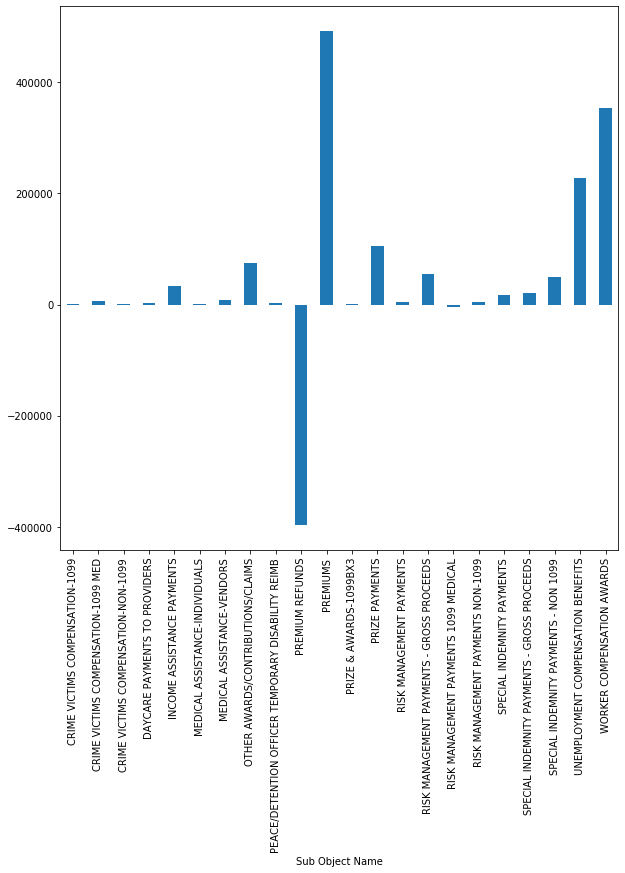

In [724]:
grouped_awards_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_awards_sub_2018['Amount'].agg(np.mean)

Sub Object Name
CRIME VICTIMS COMPENSATION-1099                         1324.610088
CRIME VICTIMS COMPENSATION-1099 MED                     6099.566588
CRIME VICTIMS COMPENSATION-NON-1099                     1077.363706
DAYCARE PAYMENTS TO PROVIDERS                           3790.308379
INCOME ASSISTANCE PAYMENTS                             35557.133451
MEDICAL ASSISTANCE-INDIVIDUALS                           949.078901
MEDICAL ASSISTANCE-VENDORS                              8047.540749
OTHER AWARDS/CONTRIBUTIONS/CLAIMS                      66029.447491
PEACE/DETENTION OFFICER TEMPORARY DISABILITY REIMB      3266.348000
PREMIUM REFUNDS                                       -92106.913889
PREMIUMS                                              450440.700463
PRIZE & AWARDS-1099BX3                                   580.017444
PRIZE PAYMENTS                                        104388.553243
RISK MANAGEMENT PAYMENTS                                5764.534000
RISK MANAGEMENT PAYMENTS - GROSS

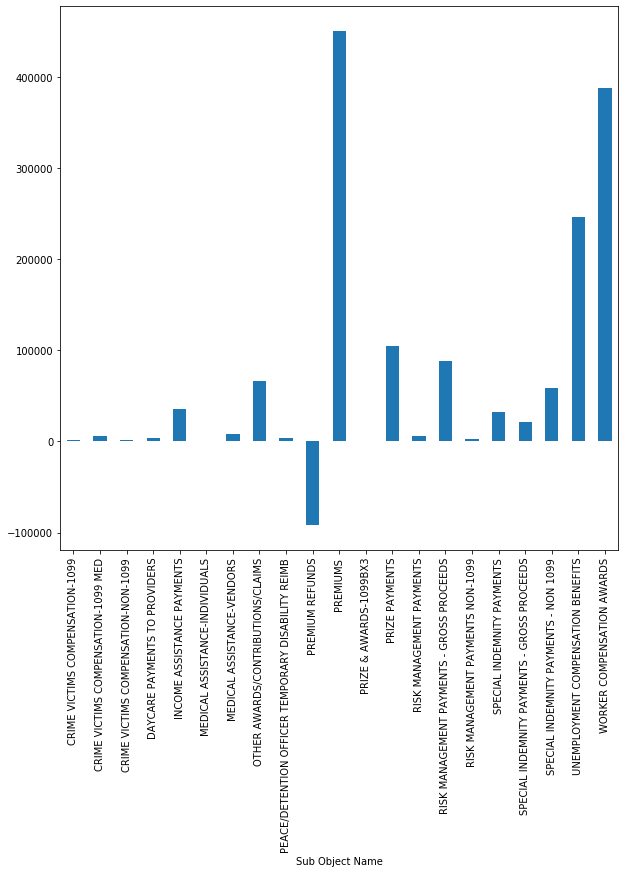

In [725]:
grouped_awards_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_awards_sub_2019['Amount'].agg(np.mean)

In [726]:
grouped_awards_sub_mean_2018 = grouped_awards_sub_2018['Amount'].agg(np.mean)
grouped_awards_sub_max_mean_2018 = grouped_awards_sub_mean_2018.max()
grouped_awards_sub_name_mean_2018 = grouped_awards_sub_mean_2018.idxmax()
grouped_awards_sub_name_mean_2018= grouped_awards_sub_name_mean_2018.strip()

grouped_awards_sub_mean_2019 = grouped_awards_sub_2019['Amount'].agg(np.mean)
grouped_awards_sub_max_mean_2019 = grouped_awards_sub_mean_2019.max()
grouped_awards_sub_name_mean_2019 = grouped_awards_sub_mean_2019.idxmax()
grouped_awards_sub_name_mean_2019 = grouped_awards_sub_name_mean_2019.strip()

print("For 2018, " + grouped_awards_sub_name_mean_2018 + " had the most expenditure for the average cost of all Awards Contr & Claims at " + str(grouped_awards_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_awards_sub_name_mean_2019 + " had the most expenditure for the average cost of all Awards Contr & Claims at " + str(grouped_awards_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_awards_sub_max_mean_2019 - grouped_awards_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, PREMIUMS had the most expenditure for the average cost of all Awards Contr & Claims at 491796.6866060605.
For 2019, PREMIUMS had the most expenditure for the average cost of all Awards Contr & Claims at 450440.7004633783.
The average increase/decrease was -41355.9861426822 between 2018 and 2019.


In [727]:
grouped_awards_sub_mean_2018 = grouped_awards_sub_2018['Amount'].agg(np.mean)
grouped_awards_sub_min_mean_2018 = grouped_awards_sub_mean_2018.min()
grouped_awards_sub_name_mean_2018 = grouped_awards_sub_mean_2018.idxmin()
grouped_awards_sub_name_mean_2018= grouped_awards_sub_name_mean_2018.strip()

grouped_awards_sub_mean_2019 = grouped_awards_sub_2019['Amount'].agg(np.mean)
grouped_awards_sub_min_mean_2019 = grouped_awards_sub_mean_2019.min()
grouped_awards_sub_name_mean_2019 = grouped_awards_sub_mean_2019.idxmin()
grouped_awards_sub_name_mean_2019 = grouped_awards_sub_name_mean_2019.strip()

print("For 2018, " + grouped_awards_sub_name_mean_2018 + " had the least expenditure for the average cost of all Awards Contr & Claims at " + str(grouped_awards_sub_min_mean_2018) + ".")
print("For 2019, " + grouped_awards_sub_name_mean_2019 + " had the least expenditure for the average cost of all Awards Contr & Claims at " + str(grouped_awards_sub_min_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_awards_sub_min_mean_2019 - grouped_awards_sub_min_mean_2018) + " between 2018 and 2019.")

For 2018, PREMIUM REFUNDS had the least expenditure for the average cost of all Awards Contr & Claims at -397287.71459459455.
For 2019, PREMIUM REFUNDS had the least expenditure for the average cost of all Awards Contr & Claims at -92106.9138888889.
The average increase/decrease was 305180.80070570565 between 2018 and 2019.


Sub Object Name
CHTR AIRCRAFT IN-STATE                        54352.43
CHTR AIRCRAFT OUT-STATE                        1908.70
COMMERCIAL AIR -OUT-USA                      294970.58
COMMERCIAL AIR IN-STATE                     1191554.90
COMMERCIAL AIR OUT-STATE                    2777047.10
EMPLOYEE COMMUNICATION CHARGES                 4848.24
EMPLOYEE/PILOT PLANE IN-STATE                   605.29
EMPLOYEE/PILOT PLANE OUT-STATE                  760.75
LODGING - IN STATE                          4236957.11
LODGING - OUT OF COUNTRY                      46994.85
LODGING - OUT OF STATE                      2585046.33
NONQUALIFYING MOVING & RELOCATION            341507.49
OTHER EMPLOYEE TRAVEL COSTS                   89942.08
P CARD BANKING/ATM FEES                        1224.05
PCARD CASH ADVANCES                            8197.12
PERSONAL VEHICLE - IN-STATE                 2070883.63
PERSONAL VEHICLE - OUT-STATE                 134798.99
PERSONAL VEHICLE - OUT-USA                     52

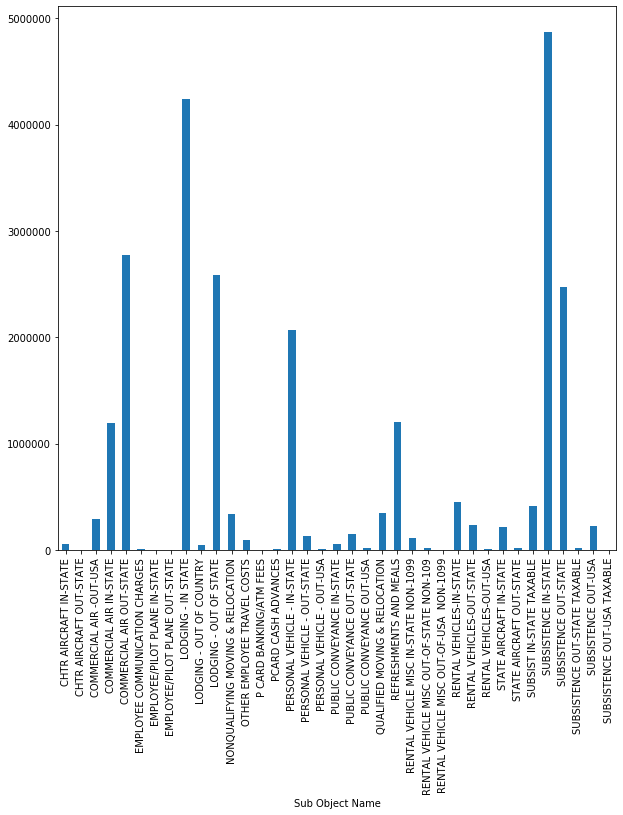

In [728]:
grouped_travel_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'EMPLOYEE TRAVEL COSTS'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_travel_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_travel_sub_2018['Amount'].agg(np.sum)

Sub Object Name
CHTR AIRCRAFT IN-STATE                        65503.42
CHTR AIRCRAFT OUT-STATE                        4238.80
COMMERCIAL AIR -OUT-USA                      261868.15
COMMERCIAL AIR IN-STATE                     1148961.57
COMMERCIAL AIR OUT-STATE                    2876697.54
EMPLOYEE COMMUNICATION CHARGES                10718.00
EMPLOYEE/PILOT PLANE IN-STATE                   508.44
EMPLOYEE/PILOT PLANE OUT-STATE                  631.07
LODGING - IN STATE                          4435726.24
LODGING - OUT OF COUNTRY                      42232.03
LODGING - OUT OF STATE                      2538723.49
NONQUALIFYING MOVING & RELOCATION            675701.85
OTHER EMPLOYEE TRAVEL COSTS                   85120.04
P CARD BANKING/ATM FEES                      -34671.92
PCARD CASH ADVANCES                           69504.54
PERSONAL VEHICLE - IN-STATE                 2177985.64
PERSONAL VEHICLE - OUT-STATE                 160342.15
PERSONAL VEHICLE - OUT-USA                     71

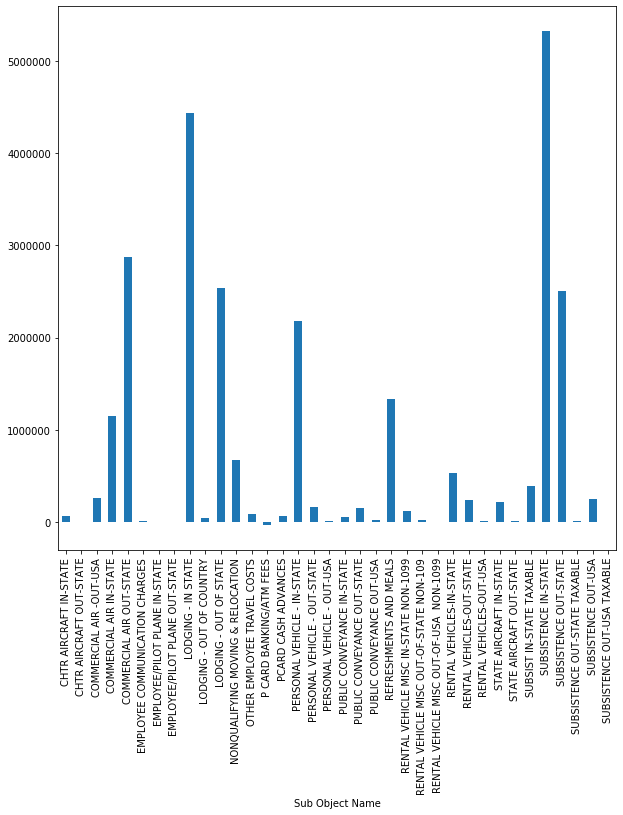

In [729]:
grouped_travel_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'EMPLOYEE TRAVEL COSTS'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_travel_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_travel_sub_2019['Amount'].agg(np.sum)

In [730]:
grouped_travel_sub_sum_2018 = grouped_travel_sub_2018['Amount'].agg(np.sum)
grouped_travel_sub_max_sum_2018 = grouped_travel_sub_sum_2018.max()
grouped_travel_sub_name_sum_2018 = grouped_travel_sub_sum_2018.idxmax()
grouped_travel_sub_name_sum_2018= grouped_travel_sub_name_sum_2018.strip()

grouped_travel_sub_sum_2019 = grouped_travel_sub_2019['Amount'].agg(np.sum)
grouped_travel_sub_max_sum_2019 = grouped_travel_sub_sum_2019.max()
grouped_travel_sub_name_sum_2019 = grouped_travel_sub_sum_2019.idxmax()
grouped_travel_sub_name_sum_2019 = grouped_travel_sub_name_sum_2019.strip()

print("For 2018, " + grouped_travel_sub_name_sum_2018 + " had the most expenditure for the total cost of all Employee Travel Costs at " + str(grouped_travel_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_travel_sub_name_sum_2019 + " had the most expenditure for the total cost of all Employee Travel Costs at " + str(grouped_travel_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_travel_sub_max_sum_2019 - grouped_travel_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, SUBSISTENCE IN-STATE had the most expenditure for the total cost of all Employee Travel Costs at 4868824.290000003.
For 2019, SUBSISTENCE IN-STATE had the most expenditure for the total cost of all Employee Travel Costs at 5322841.640000038.
The average increase/decrease was 454017.350000035 between 2018 and 2019.


Sub Object Name
CHTR AIRCRAFT IN-STATE                      2013.052963
CHTR AIRCRAFT OUT-STATE                      636.233333
COMMERCIAL AIR -OUT-USA                     1346.897626
COMMERCIAL AIR IN-STATE                      231.910257
COMMERCIAL AIR OUT-STATE                     311.992709
EMPLOYEE COMMUNICATION CHARGES                12.625625
EMPLOYEE/PILOT PLANE IN-STATE                151.322500
EMPLOYEE/PILOT PLANE OUT-STATE               253.583333
LODGING - IN STATE                           219.032109
LODGING - OUT OF COUNTRY                     435.137500
LODGING - OUT OF STATE                       427.492365
NONQUALIFYING MOVING & RELOCATION           2388.164266
OTHER EMPLOYEE TRAVEL COSTS                   46.796087
P CARD BANKING/ATM FEES                        0.628685
PCARD CASH ADVANCES                            6.785695
PERSONAL VEHICLE - IN-STATE                  144.453378
PERSONAL VEHICLE - OUT-STATE                 111.404124
PERSONAL VEHICLE - OUT-USA      

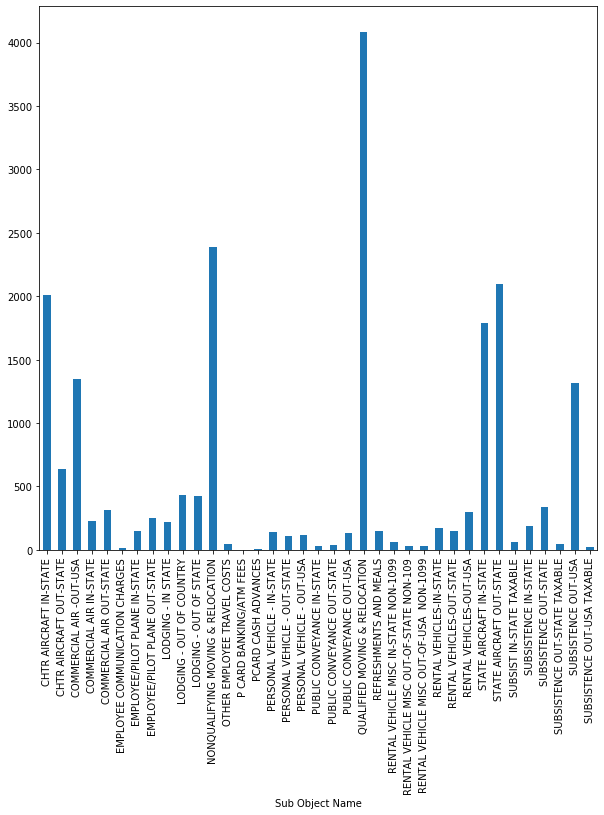

In [731]:
grouped_travel_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_travel_sub_2018['Amount'].agg(np.mean)

Sub Object Name
CHTR AIRCRAFT IN-STATE                      2046.981875
CHTR AIRCRAFT OUT-STATE                     2119.400000
COMMERCIAL AIR -OUT-USA                     1217.991395
COMMERCIAL AIR IN-STATE                      231.645478
COMMERCIAL AIR OUT-STATE                     334.850139
EMPLOYEE COMMUNICATION CHARGES                25.764423
EMPLOYEE/PILOT PLANE IN-STATE                101.688000
EMPLOYEE/PILOT PLANE OUT-STATE               210.356667
LODGING - IN STATE                           228.480799
LODGING - OUT OF COUNTRY                     474.517191
LODGING - OUT OF STATE                       431.242312
NONQUALIFYING MOVING & RELOCATION           4249.697170
OTHER EMPLOYEE TRAVEL COSTS                   45.084767
P CARD BANKING/ATM FEES                      -19.358973
PCARD CASH ADVANCES                           52.895388
PERSONAL VEHICLE - IN-STATE                  147.041969
PERSONAL VEHICLE - OUT-STATE                 121.933194
PERSONAL VEHICLE - OUT-USA      

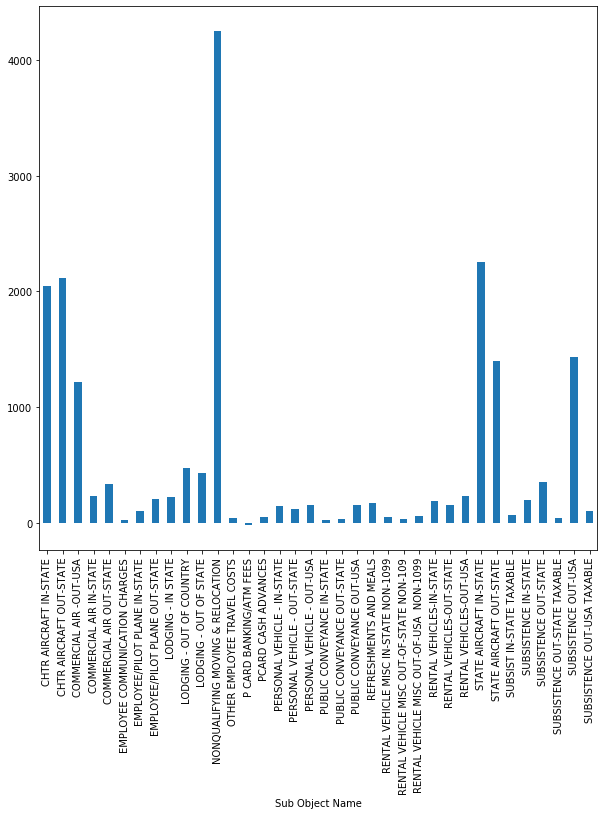

In [732]:
grouped_travel_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_travel_sub_2019['Amount'].agg(np.mean)

In [733]:
grouped_travel_sub_mean_2018 = grouped_travel_sub_2018['Amount'].agg(np.mean)
grouped_travel_sub_max_mean_2018 = grouped_travel_sub_mean_2018.max()
grouped_travel_sub_name_mean_2018 = grouped_travel_sub_mean_2018.idxmax()
grouped_travel_sub_name_mean_2018= grouped_travel_sub_name_mean_2018.strip()

grouped_travel_sub_mean_2019 = grouped_travel_sub_2019['Amount'].agg(np.mean)
grouped_travel_sub_max_mean_2019 = grouped_travel_sub_mean_2019.max()
grouped_travel_sub_name_mean_2019 = grouped_travel_sub_mean_2019.idxmax()
grouped_travel_sub_name_mean_2019 = grouped_travel_sub_name_mean_2019.strip()

print("For 2018, " + grouped_travel_sub_name_mean_2018 + " had the most expenditure for the average cost of all Employee Travel Costs at " + str(grouped_travel_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_travel_sub_name_mean_2019 + " had the most expenditure for the average cost of all Employee Travel Costs at " + str(grouped_travel_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_travel_sub_max_mean_2019 - grouped_travel_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, QUALIFIED MOVING & RELOCATION had the most expenditure for the average cost of all Employee Travel Costs at 4081.298139534884.
For 2019, NONQUALIFYING MOVING & RELOCATION had the most expenditure for the average cost of all Employee Travel Costs at 4249.69716981132.
The average increase/decrease was 168.3990302764364 between 2018 and 2019.


Sub Object Name
CYBER-SECURITY HARDWARE                      606328.21
INTANGIBLE SOFTWARE - INTERNALLY DEVELOP     322361.60
INTANGIBLE SOFTWARE - PURCHASED OVER $20    1159414.52
MAINFRAME COMPUTER HARDWARE                  147193.89
NETWORKING HARDWARE                         2548999.76
OTHER COMPUTER EQUIPMENT                    2318609.59
PERIPHERAL EQUIPMENT                         789475.65
PERSONAL COMPUTER HARDWARE                  6324928.87
SERVER AND STORAGE HARDWARE                 5665287.24
TELEPHONE AND VOIP EQUIPMENT                 380983.13
Name: Amount, dtype: float64

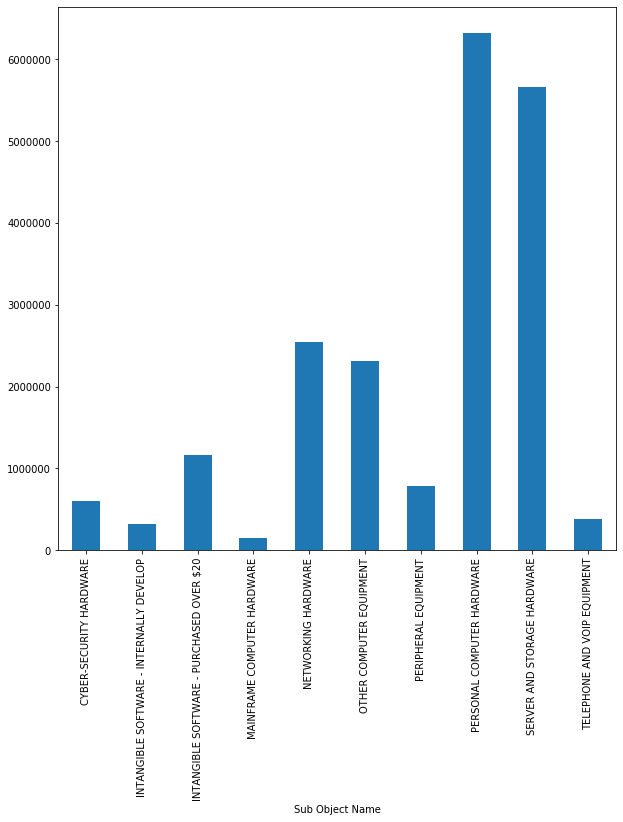

In [734]:
grouped_computer_equ_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'COMPUTER EQUIPMENT'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_computer_equ_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_computer_equ_sub_2018['Amount'].agg(np.sum)

Sub Object Name
CYBER-SECURITY HARDWARE                      329676.99
INTANGIBLE SOFTWARE - INTERNALLY DEVELOP     212966.21
INTANGIBLE SOFTWARE - PURCHASED OVER $20    1064010.71
MAINFRAME COMPUTER HARDWARE                    2170.08
NETWORKING HARDWARE                         2750376.02
OTHER COMPUTER EQUIPMENT                    1984089.16
PERIPHERAL EQUIPMENT                         423686.68
PERSONAL COMPUTER HARDWARE                  5436484.40
SERVER AND STORAGE HARDWARE                 4389326.98
TELEPHONE AND VOIP EQUIPMENT                 400123.92
Name: Amount, dtype: float64

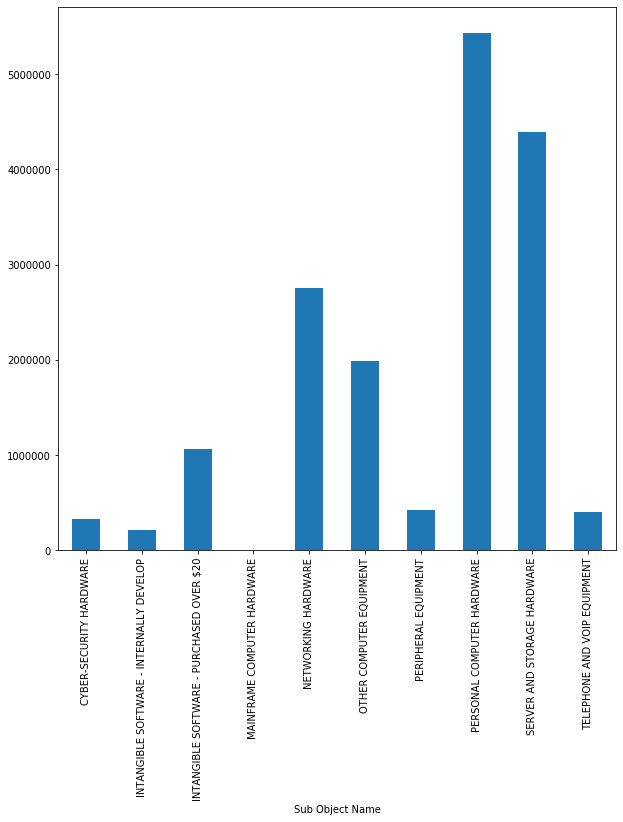

In [735]:
grouped_computer_equ_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'COMPUTER EQUIPMENT'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_computer_equ_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_computer_equ_sub_2019['Amount'].agg(np.sum)

In [736]:
grouped_computer_equ_sub_sum_2018 = grouped_computer_equ_sub_2018['Amount'].agg(np.sum)
grouped_computer_equ_sub_max_sum_2018 = grouped_computer_equ_sub_sum_2018.max()
grouped_computer_equ_sub_name_sum_2018 = grouped_computer_equ_sub_sum_2018.idxmax()
grouped_computer_equ_sub_name_sum_2018= grouped_computer_equ_sub_name_sum_2018.strip()

grouped_computer_equ_sub_sum_2019 = grouped_computer_equ_sub_2019['Amount'].agg(np.sum)
grouped_computer_equ_sub_max_sum_2019 = grouped_computer_equ_sub_sum_2019.max()
grouped_computer_equ_sub_name_sum_2019 = grouped_computer_equ_sub_sum_2019.idxmax()
grouped_computer_equ_sub_name_sum_2019 = grouped_computer_equ_sub_name_sum_2019.strip()

print("For 2018, " + grouped_computer_equ_sub_name_sum_2018 + " had the most expenditure for the total cost of all Computer Equipment at " + str(grouped_computer_equ_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_computer_equ_sub_name_sum_2019 + " had the most expenditure for the total cost of all Computer Equipment at " + str(grouped_computer_equ_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_computer_equ_sub_max_sum_2019 - grouped_computer_equ_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, PERSONAL COMPUTER HARDWARE had the most expenditure for the total cost of all Computer Equipment at 6324928.870000008.
For 2019, PERSONAL COMPUTER HARDWARE had the most expenditure for the total cost of all Computer Equipment at 5436484.400000003.
The average increase/decrease was -888444.4700000044 between 2018 and 2019.


Sub Object Name
CYBER-SECURITY HARDWARE                      25263.675417
INTANGIBLE SOFTWARE - INTERNALLY DEVELOP     15350.552381
INTANGIBLE SOFTWARE - PURCHASED OVER $20    144926.815000
MAINFRAME COMPUTER HARDWARE                  29438.778000
NETWORKING HARDWARE                          16339.742051
OTHER COMPUTER EQUIPMENT                     19988.013707
PERIPHERAL EQUIPMENT                          4460.314407
PERSONAL COMPUTER HARDWARE                    9960.517906
SERVER AND STORAGE HARDWARE                  38278.967838
TELEPHONE AND VOIP EQUIPMENT                  7619.662600
Name: Amount, dtype: float64

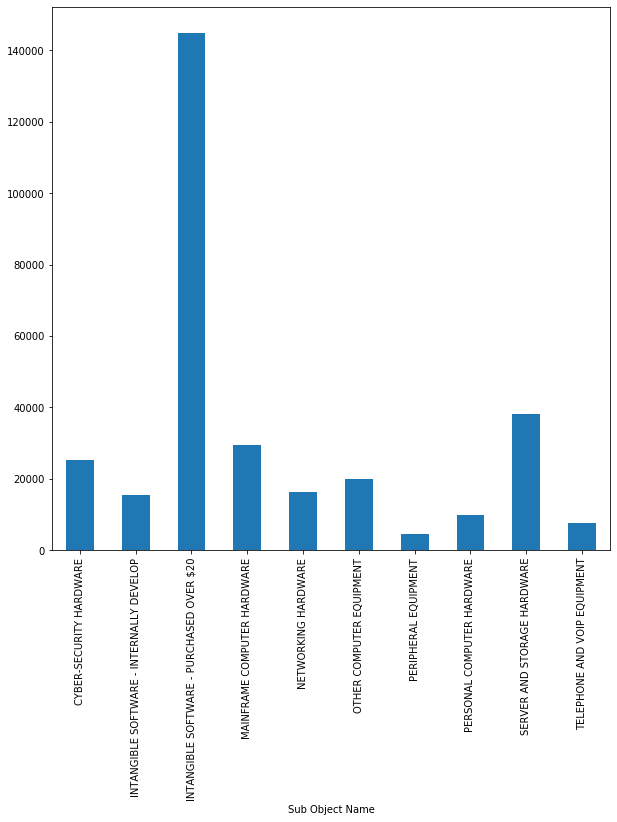

In [737]:
grouped_computer_equ_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_computer_equ_sub_2018['Amount'].agg(np.mean)

Sub Object Name
CYBER-SECURITY HARDWARE                      29970.635455
INTANGIBLE SOFTWARE - INTERNALLY DEVELOP     11831.456111
INTANGIBLE SOFTWARE - PURCHASED OVER $20    212802.142000
MAINFRAME COMPUTER HARDWARE                   2170.080000
NETWORKING HARDWARE                          21487.312656
OTHER COMPUTER EQUIPMENT                     14482.402628
PERIPHERAL EQUIPMENT                          3336.115591
PERSONAL COMPUTER HARDWARE                    9830.894033
SERVER AND STORAGE HARDWARE                  36885.100672
TELEPHONE AND VOIP EQUIPMENT                  4820.770120
Name: Amount, dtype: float64

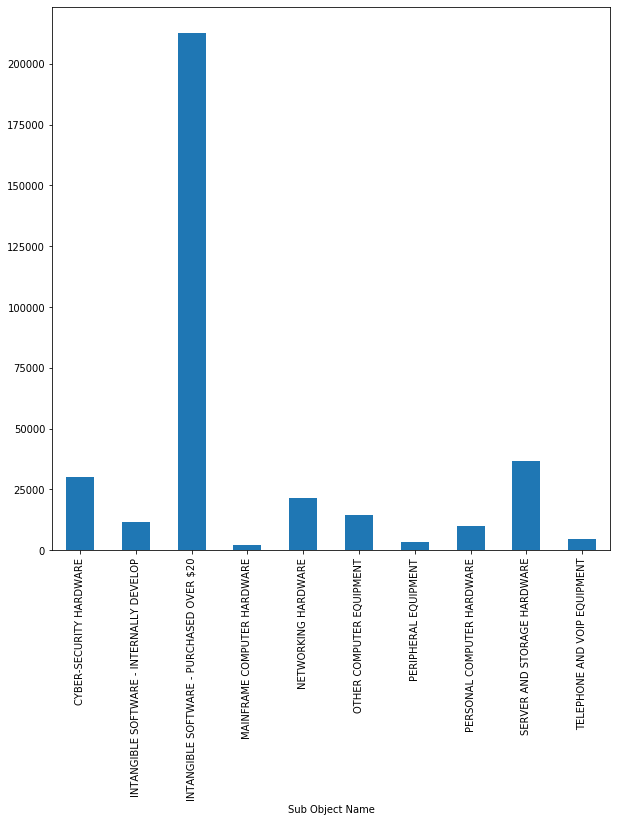

In [738]:
grouped_computer_equ_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_computer_equ_sub_2019['Amount'].agg(np.mean)

In [739]:
grouped_computer_equ_sub_mean_2018 = grouped_computer_equ_sub_2018['Amount'].agg(np.mean)
grouped_computer_equ_sub_max_mean_2018 = grouped_computer_equ_sub_mean_2018.max()
grouped_computer_equ_sub_name_mean_2018 = grouped_computer_equ_sub_mean_2018.idxmax()
grouped_computer_equ_sub_name_mean_2018= grouped_computer_equ_sub_name_mean_2018.strip()

grouped_computer_equ_sub_mean_2019 = grouped_computer_equ_sub_2019['Amount'].agg(np.mean)
grouped_computer_equ_sub_max_mean_2019 = grouped_computer_equ_sub_mean_2019.max()
grouped_computer_equ_sub_name_mean_2019 = grouped_computer_equ_sub_mean_2019.idxmax()
grouped_computer_equ_sub_name_mean_2019 = grouped_computer_equ_sub_name_mean_2019.strip()

print("For 2018, " + grouped_computer_equ_sub_name_mean_2018 + " had the most expenditure for the average cost of all Computer Equipment at " + str(grouped_computer_equ_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_computer_equ_sub_name_mean_2019 + " had the most expenditure for the average cost of all Computer Equipment at " + str(grouped_computer_equ_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_computer_equ_sub_max_mean_2019 - grouped_computer_equ_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, INTANGIBLE SOFTWARE - PURCHASED OVER $20 had the most expenditure for the average cost of all Computer Equipment at 144926.815.
For 2019, INTANGIBLE SOFTWARE - PURCHASED OVER $20 had the most expenditure for the average cost of all Computer Equipment at 212802.142.
The average increase/decrease was 67875.32699999999 between 2018 and 2019.


Sub Object Name
CYBER-SECURITY HARDWARE                     100000.00
INTANGIBLE SOFTWARE - INTERNALLY DEVELOP     87000.00
INTANGIBLE SOFTWARE - PURCHASED OVER $20    402660.00
MAINFRAME COMPUTER HARDWARE                 102000.00
NETWORKING HARDWARE                         334509.00
OTHER COMPUTER EQUIPMENT                    981076.12
PERIPHERAL EQUIPMENT                        177739.40
PERSONAL COMPUTER HARDWARE                  520124.00
SERVER AND STORAGE HARDWARE                 922398.18
TELEPHONE AND VOIP EQUIPMENT                 71498.53
Name: Amount, dtype: float64

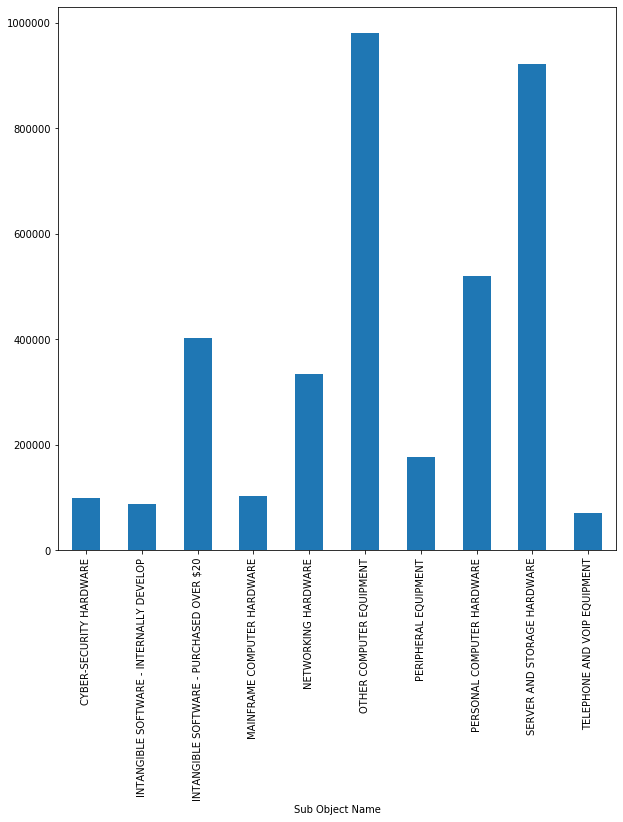

In [740]:
grouped_computer_equ_sub_2018['Amount'].agg(np.max).plot.bar(figsize=(10,10))
grouped_computer_equ_sub_2018['Amount'].agg(np.max)

Sub Object Name
CYBER-SECURITY HARDWARE                      102433.79
INTANGIBLE SOFTWARE - INTERNALLY DEVELOP      78698.00
INTANGIBLE SOFTWARE - PURCHASED OVER $20     426223.71
MAINFRAME COMPUTER HARDWARE                    2170.08
NETWORKING HARDWARE                          292000.01
OTHER COMPUTER EQUIPMENT                    1170000.00
PERIPHERAL EQUIPMENT                          54033.50
PERSONAL COMPUTER HARDWARE                   494535.05
SERVER AND STORAGE HARDWARE                  389400.00
TELEPHONE AND VOIP EQUIPMENT                  43469.50
Name: Amount, dtype: float64

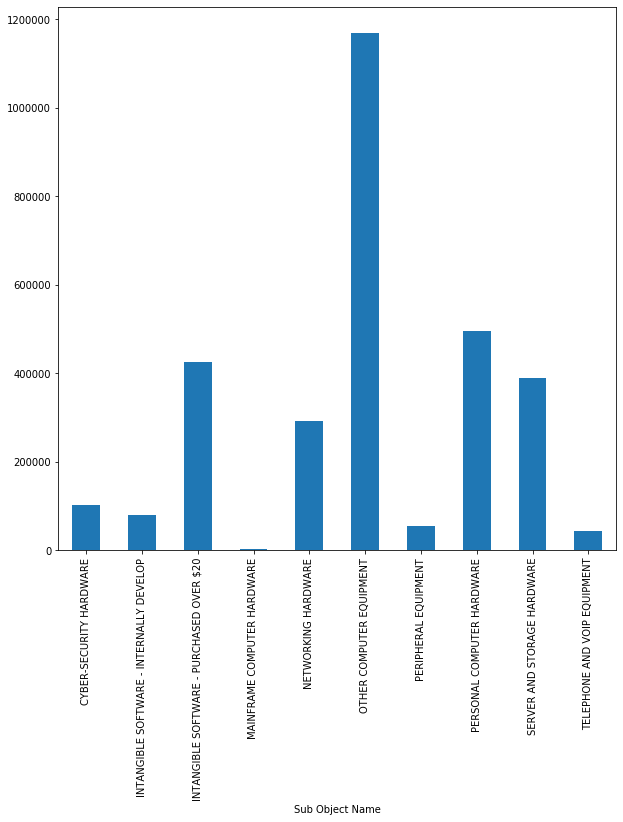

In [741]:
grouped_computer_equ_sub_2019['Amount'].agg(np.max).plot.bar(figsize=(10,10))
grouped_computer_equ_sub_2019['Amount'].agg(np.max)

In [742]:
grouped_computer_equ_sub_max_2018 = grouped_computer_equ_sub_2018['Amount'].agg(np.max)
grouped_computer_equ_sub_max_max_2018 = grouped_computer_equ_sub_max_2018.max()
grouped_computer_equ_sub_name_max_2018 = grouped_computer_equ_sub_max_2018.idxmax()
grouped_computer_equ_sub_name_max_2018= grouped_computer_equ_sub_name_max_2018.strip()

grouped_computer_equ_sub_max_2019 = grouped_computer_equ_sub_2019['Amount'].agg(np.max)
grouped_computer_equ_sub_max_max_2019 = grouped_computer_equ_sub_max_2019.max()
grouped_computer_equ_sub_name_max_2019 = grouped_computer_equ_sub_max_2019.idxmax()
grouped_computer_equ_sub_name_max_2019 = grouped_computer_equ_sub_name_max_2019.strip()

print("For 2018, " + grouped_computer_equ_sub_name_max_2018 + " had the most expenditure for the maximum cost of all Computer Equipment at " + str(grouped_computer_equ_sub_max_max_2018) + ".")
print("For 2019, " + grouped_computer_equ_sub_name_max_2019 + " had the most expenditure for the maximum cost of all Computer Equipment at " + str(grouped_computer_equ_sub_max_max_2019) + ".")
print("The average increase/decrease was " + str(grouped_computer_equ_sub_max_max_2019 - grouped_computer_equ_sub_max_max_2018) + " between 2018 and 2019.")

For 2018, OTHER COMPUTER EQUIPMENT had the most expenditure for the maximum cost of all Computer Equipment at 981076.12.
For 2019, OTHER COMPUTER EQUIPMENT had the most expenditure for the maximum cost of all Computer Equipment at 1170000.0.
The average increase/decrease was 188923.88 between 2018 and 2019.


Sub Object Name
CYBER-SECURITY HARDWARE                109603.62
CYBER-SECURITY SOFTWARE                928232.36
ENTERPRISE RESOURCE PLANNING (ERP)     167210.11
MAINFRAME COMPUTER HARDWARE               256.95
MAINFRAME COMPUTER SOFTWARE             58844.09
NETWORKING HARDWARE                    380103.15
NETWORKING SOFTWARE                    359891.69
OTHER COMPUTER SUPPLIES               1116788.06
PERIPHERAL EQUIPMENT                  1334911.37
PERSONAL COMPUTER HARDWARE            4336164.83
PERSONAL COMPUTER SOFTWARE            5736595.26
SERVER AND STORAGE HARDWARE            244815.15
SERVER AND STORAGE SOFTWARE           2355086.71
Name: Amount, dtype: float64

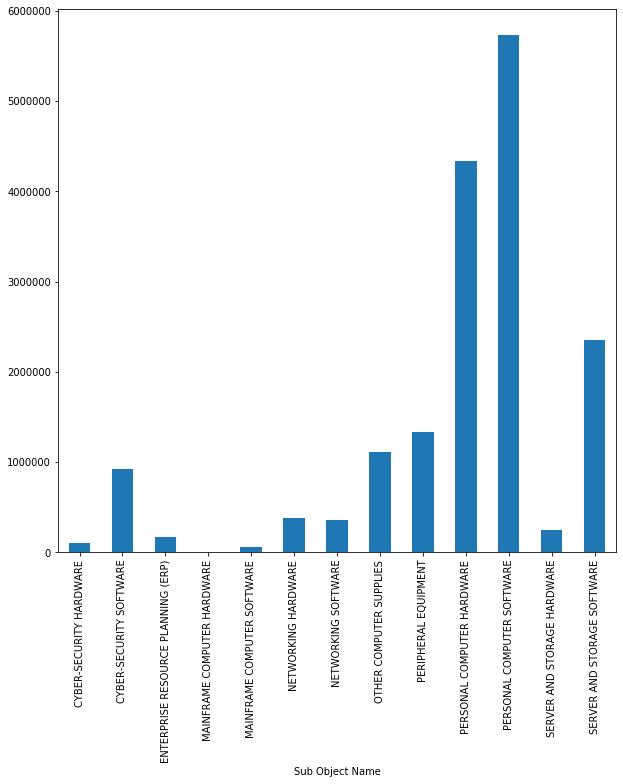

In [743]:
grouped_computer_supplies_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'COMPUTER SUPPLIES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_computer_supplies_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_computer_supplies_sub_2018['Amount'].agg(np.sum)

Sub Object Name
CYBER-SECURITY HARDWARE                 63820.49
CYBER-SECURITY SOFTWARE                626392.76
ENTERPRISE RESOURCE PLANNING (ERP)     212213.41
MAINFRAME COMPUTER HARDWARE              4294.55
MAINFRAME COMPUTER SOFTWARE            129298.83
NETWORKING HARDWARE                    453249.72
NETWORKING SOFTWARE                    176396.93
OTHER COMPUTER SUPPLIES               1282593.35
PERIPHERAL EQUIPMENT                  1275613.92
PERSONAL COMPUTER HARDWARE            3828411.47
PERSONAL COMPUTER SOFTWARE            9995696.06
SERVER AND STORAGE HARDWARE            230326.45
SERVER AND STORAGE SOFTWARE           3691199.54
Name: Amount, dtype: float64

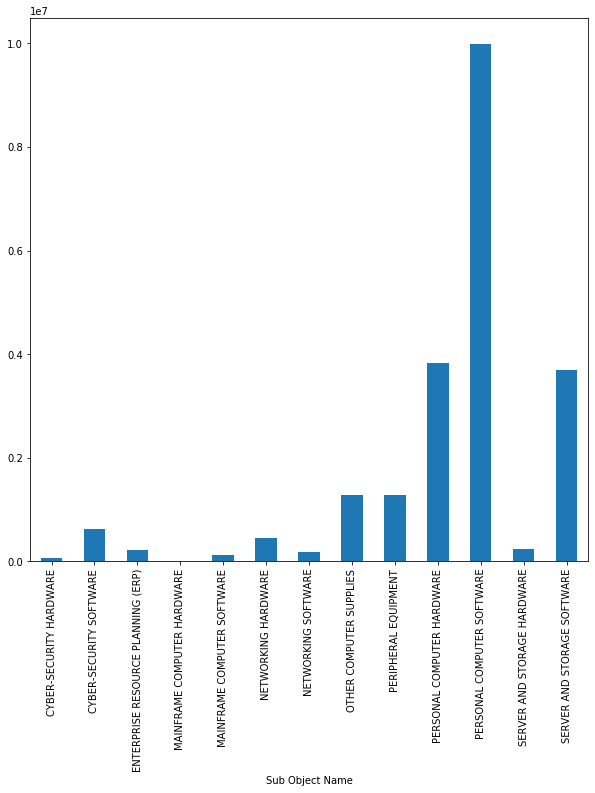

In [744]:
grouped_computer_supplies_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'COMPUTER SUPPLIES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_computer_supplies_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_computer_supplies_sub_2019['Amount'].agg(np.sum)

In [745]:
grouped_computer_supplies_sub_sum_2018 = grouped_computer_supplies_sub_2018['Amount'].agg(np.sum)
grouped_computer_supplies_sub_max_sum_2018 = grouped_computer_supplies_sub_sum_2018.max()
grouped_computer_supplies_sub_name_sum_2018 = grouped_computer_supplies_sub_sum_2018.idxmax()
grouped_computer_supplies_sub_name_sum_2018= grouped_computer_supplies_sub_name_sum_2018.strip()

grouped_computer_supplies_sub_sum_2019 = grouped_computer_supplies_sub_2019['Amount'].agg(np.sum)
grouped_computer_supplies_sub_max_sum_2019 = grouped_computer_supplies_sub_sum_2019.max()
grouped_computer_supplies_sub_name_sum_2019 = grouped_computer_supplies_sub_sum_2019.idxmax()
grouped_computer_supplies_sub_name_sum_2019 = grouped_computer_supplies_sub_name_sum_2019.strip()

print("For 2018, " + grouped_computer_supplies_sub_name_sum_2018 + " had the most expenditure for the total cost of all Computer Supplies at " + str(grouped_computer_supplies_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_computer_supplies_sub_name_sum_2019 + " had the most expenditure for the total cost of all Computer Supplies at " + str(grouped_computer_supplies_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_computer_supplies_sub_max_sum_2019 - grouped_computer_supplies_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, PERSONAL COMPUTER SOFTWARE had the most expenditure for the total cost of all Computer Supplies at 5736595.2600000035.
For 2019, PERSONAL COMPUTER SOFTWARE had the most expenditure for the total cost of all Computer Supplies at 9995696.060000027.
The average increase/decrease was 4259100.800000023 between 2018 and 2019.


Sub Object Name
CYBER-SECURITY HARDWARE               3044.545000
CYBER-SECURITY SOFTWARE               7085.743206
ENTERPRISE RESOURCE PLANNING (ERP)    2654.128730
MAINFRAME COMPUTER HARDWARE             64.237500
MAINFRAME COMPUTER SOFTWARE           3677.755625
NETWORKING HARDWARE                   2276.066766
NETWORKING SOFTWARE                   4043.726854
OTHER COMPUTER SUPPLIES                286.209139
PERIPHERAL EQUIPMENT                   625.544222
PERSONAL COMPUTER HARDWARE            3542.618325
PERSONAL COMPUTER SOFTWARE            2563.268660
SERVER AND STORAGE HARDWARE           1748.679643
SERVER AND STORAGE SOFTWARE           7597.053903
Name: Amount, dtype: float64

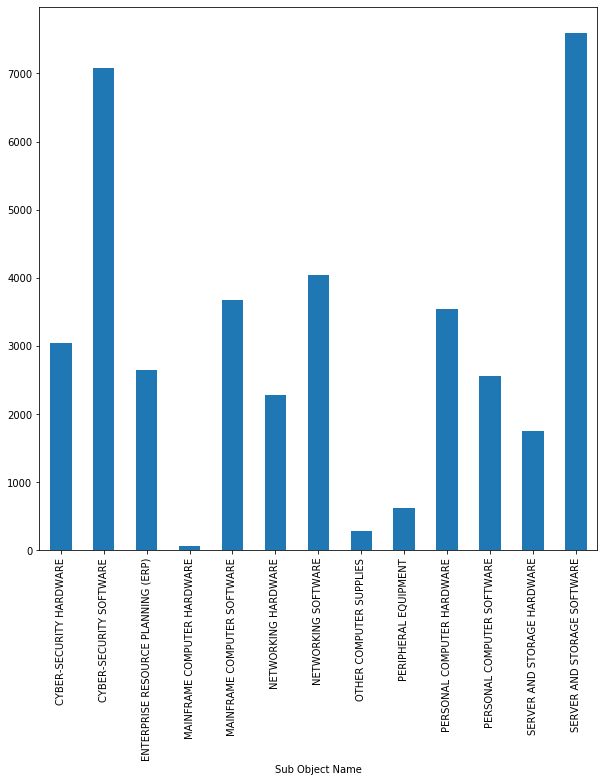

In [746]:
grouped_computer_supplies_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_computer_supplies_sub_2018['Amount'].agg(np.mean)

Sub Object Name
CYBER-SECURITY HARDWARE                3545.582778
CYBER-SECURITY SOFTWARE                6457.657320
ENTERPRISE RESOURCE PLANNING (ERP)     5441.369487
MAINFRAME COMPUTER HARDWARE            1073.637500
MAINFRAME COMPUTER SOFTWARE           18471.261429
NETWORKING HARDWARE                    2436.826452
NETWORKING SOFTWARE                    2556.477246
OTHER COMPUTER SUPPLIES                 371.550797
PERIPHERAL EQUIPMENT                    670.669779
PERSONAL COMPUTER HARDWARE             3442.816070
PERSONAL COMPUTER SOFTWARE             4719.403239
SERVER AND STORAGE HARDWARE            2678.214535
SERVER AND STORAGE SOFTWARE           16552.464305
Name: Amount, dtype: float64

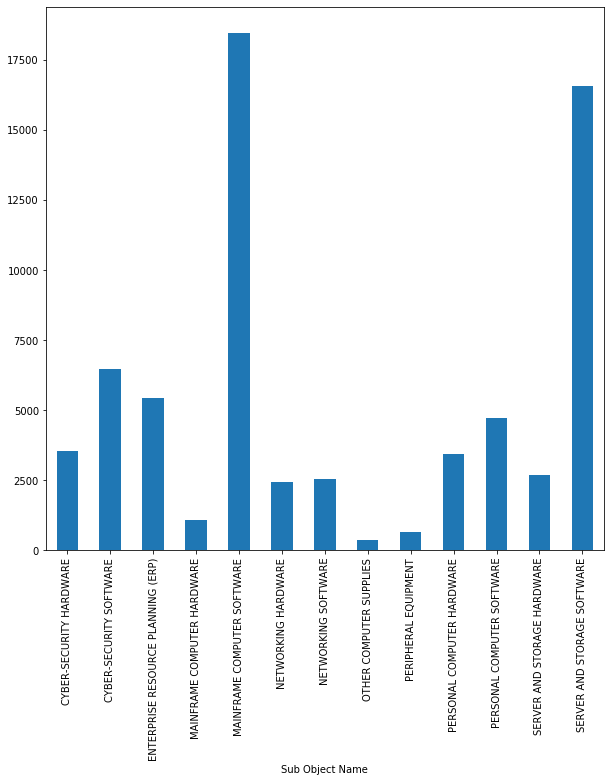

In [747]:
grouped_computer_supplies_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_computer_supplies_sub_2019['Amount'].agg(np.mean)

In [748]:
grouped_computer_supplies_sub_mean_2018 = grouped_computer_supplies_sub_2018['Amount'].agg(np.mean)
grouped_computer_supplies_sub_max_mean_2018 = grouped_computer_supplies_sub_mean_2018.max()
grouped_computer_supplies_sub_name_mean_2018 = grouped_computer_supplies_sub_mean_2018.idxmax()
grouped_computer_supplies_sub_name_mean_2018= grouped_computer_supplies_sub_name_mean_2018.strip()

grouped_computer_supplies_sub_mean_2019 = grouped_computer_supplies_sub_2019['Amount'].agg(np.mean)
grouped_computer_supplies_sub_max_mean_2019 = grouped_computer_supplies_sub_mean_2019.max()
grouped_computer_supplies_sub_name_mean_2019 = grouped_computer_supplies_sub_mean_2019.idxmax()
grouped_computer_supplies_sub_name_mean_2019 = grouped_computer_supplies_sub_name_mean_2019.strip()

print("For 2018, " + grouped_computer_supplies_sub_name_mean_2018 + " had the most expenditure for the average cost of all Computer Supplies at " + str(grouped_computer_supplies_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_computer_supplies_sub_name_mean_2019 + " had the most expenditure for the average cost of all Computer Supplies at " + str(grouped_computer_supplies_sub_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_computer_supplies_sub_max_mean_2019 - grouped_computer_supplies_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, SERVER AND STORAGE SOFTWARE had the most expenditure for the average cost of all Computer Supplies at 7597.0539032258075.
For 2019, MAINFRAME COMPUTER SOFTWARE had the most expenditure for the average cost of all Computer Supplies at 18471.26142857143.


Sub Object Name
AUTO PHYSICAL DAMAGE                 634745.68
AVIATION INSURANCE                    57481.24
EMPLOYEE BONDS                        66149.00
FIRE                                 476208.62
GROUP LIFE DISABILITY PREMIUMS       386033.72
LIABILITY, ALL                      4628344.57
NON-EMPLOYEE BONDS                       40.00
OTHER INSURANCE                     2264719.77
PROPERTY, ALL                       5712520.82
WORKER COMPENSATION NON EMPLOYEE      86602.63
Name: Amount, dtype: float64

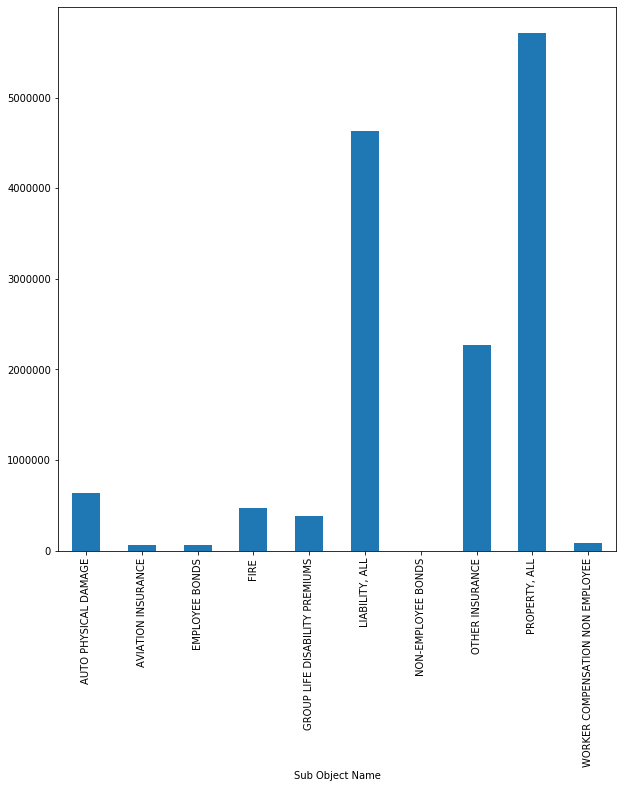

In [749]:
grouped_insurance_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'INSURANCE'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_insurance_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_insurance_sub_2018['Amount'].agg(np.sum)

Sub Object Name
AUTO PHYSICAL DAMAGE                 609461.75
AVIATION INSURANCE                    98393.70
EMPLOYEE BONDS                        94451.11
FIRE                                 556685.19
GROUP LIFE DISABILITY PREMIUMS       391008.25
LIABILITY, ALL                      3437582.88
OTHER INSURANCE                     2549127.96
PROPERTY, ALL                       5843225.59
WORKER COMPENSATION NON EMPLOYEE      72905.09
Name: Amount, dtype: float64

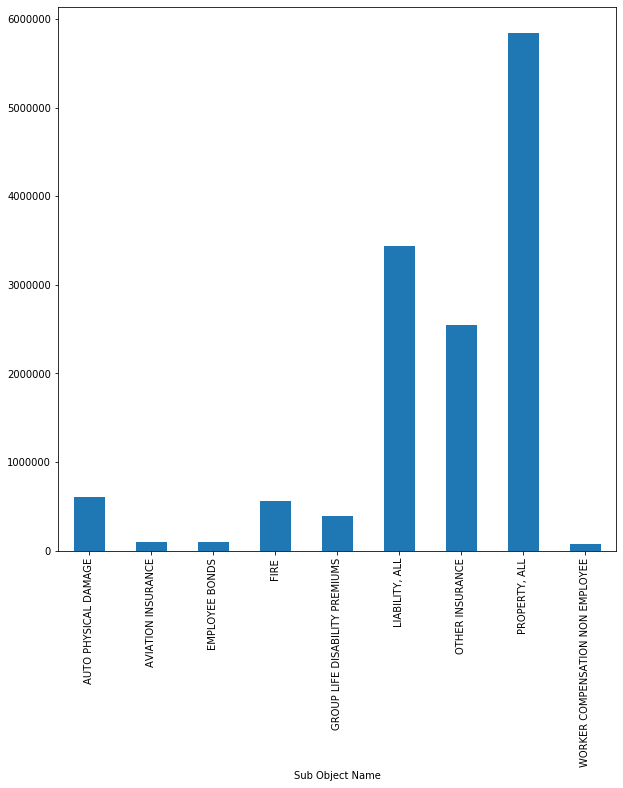

In [750]:
grouped_insurance_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'INSURANCE'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_insurance_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_insurance_sub_2019['Amount'].agg(np.sum)

In [751]:
grouped_insurance_sub_sum_2018 = grouped_insurance_sub_2018['Amount'].agg(np.sum)
grouped_insurance_sub_max_sum_2018 = grouped_insurance_sub_sum_2018.max()
grouped_insurance_sub_name_sum_2018 = grouped_insurance_sub_sum_2018.idxmax()
grouped_insurance_sub_name_sum_2018= grouped_insurance_sub_name_sum_2018.strip()

grouped_insurance_sub_sum_2019 = grouped_insurance_sub_2019['Amount'].agg(np.sum)
grouped_insurance_sub_max_sum_2019 = grouped_insurance_sub_sum_2019.max()
grouped_insurance_sub_name_sum_2019 = grouped_insurance_sub_sum_2019.idxmax()
grouped_insurance_sub_name_sum_2019 = grouped_insurance_sub_name_sum_2019.strip()

print("For 2018, " + grouped_insurance_sub_name_sum_2018 + " had the most expenditure for the total cost of all Insurance at " + str(grouped_insurance_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_insurance_sub_name_sum_2019 + " had the most expenditure for the total cost of all Insurance at " + str(grouped_insurance_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_insurance_sub_max_sum_2019 - grouped_insurance_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, PROPERTY, ALL had the most expenditure for the total cost of all Insurance at 5712520.820000001.
For 2019, PROPERTY, ALL had the most expenditure for the total cost of all Insurance at 5843225.590000001.
The average increase/decrease was 130704.76999999955 between 2018 and 2019.


Sub Object Name
AUTO PHYSICAL DAMAGE                  3376.306809
AVIATION INSURANCE                    3381.249412
EMPLOYEE BONDS                       11024.833333
FIRE                                158736.206667
GROUP LIFE DISABILITY PREMIUMS       12063.553750
LIABILITY, ALL                       14508.917147
NON-EMPLOYEE BONDS                      40.000000
OTHER INSURANCE                       5882.389013
PROPERTY, ALL                        21720.611483
WORKER COMPENSATION NON EMPLOYEE      5773.508667
Name: Amount, dtype: float64

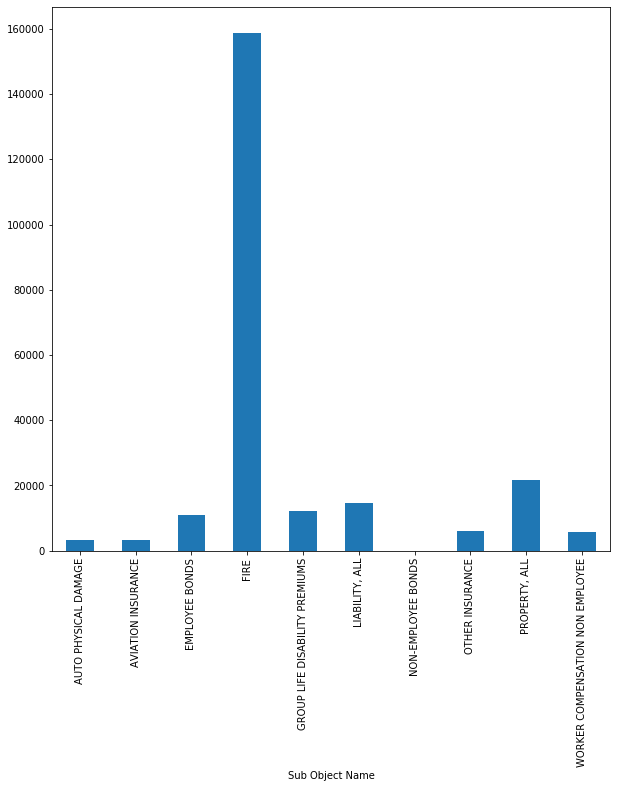

In [752]:
grouped_insurance_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_insurance_sub_2018['Amount'].agg(np.mean)

Sub Object Name
AUTO PHYSICAL DAMAGE                  3348.690934
AVIATION INSURANCE                    4099.737500
EMPLOYEE BONDS                       10494.567778
FIRE                                278342.595000
GROUP LIFE DISABILITY PREMIUMS       11500.242647
LIABILITY, ALL                       10080.888211
OTHER INSURANCE                       7367.421850
PROPERTY, ALL                        23279.783227
WORKER COMPENSATION NON EMPLOYEE     12150.848333
Name: Amount, dtype: float64

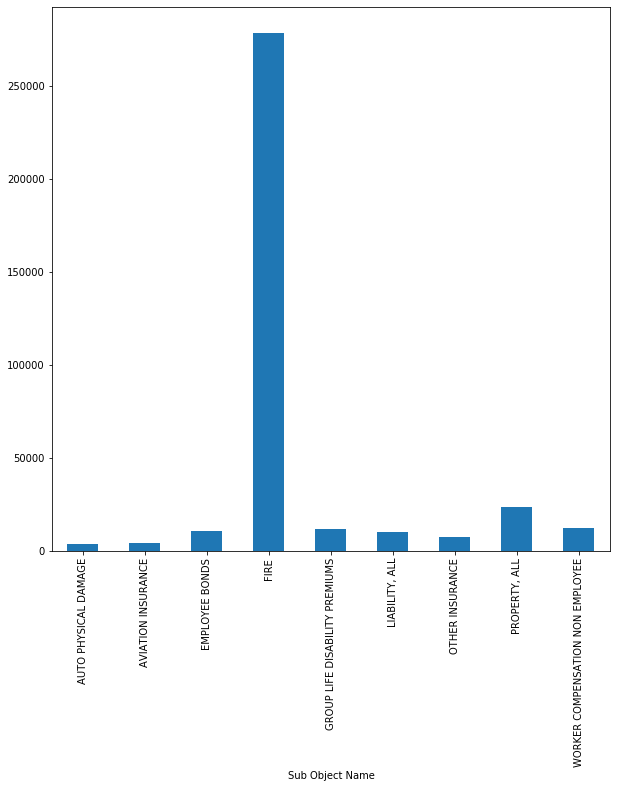

In [753]:
grouped_insurance_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_insurance_sub_2019['Amount'].agg(np.mean)

In [754]:
grouped_insurance_sub_mean_2018 = grouped_insurance_sub_2018['Amount'].agg(np.mean)
grouped_insurance_sub_max_mean_2018 = grouped_insurance_sub_mean_2018.max()
grouped_insurance_sub_name_mean_2018 = grouped_insurance_sub_mean_2018.idxmax()
grouped_insurance_sub_name_mean_2018= grouped_insurance_sub_name_mean_2018.strip()

grouped_insurance_sub_mean_2019 = grouped_insurance_sub_2019['Amount'].agg(np.mean)
grouped_insurance_sub_max_mean_2019 = grouped_insurance_sub_mean_2019.max()
grouped_insurance_sub_name_mean_2019 = grouped_insurance_sub_mean_2019.idxmax()
grouped_insurance_sub_name_mean_2019 = grouped_insurance_sub_name_mean_2019.strip()

print("For 2018, " + grouped_insurance_sub_name_mean_2018 + " had the most expenditure for the average cost of all Insurance at " + str(grouped_insurance_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_insurance_sub_name_mean_2019 + " had the most expenditure for the average cost of all Insurance at " + str(grouped_insurance_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_insurance_sub_max_mean_2019 - grouped_insurance_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, FIRE had the most expenditure for the average cost of all Insurance at 158736.20666666667.
For 2019, FIRE had the most expenditure for the average cost of all Insurance at 278342.595.
The average increase/decrease was 119606.3883333333 between 2018 and 2019.


Sub Object Name
ACCOUNTING                                 2.165854e+06
ADV ERTISING & LEGAL NOTICES               1.369091e+06
AUDITING                                   5.717894e+06
BROKERAGE FEES                             7.498055e+05
BROKERAGE FEES -  STATE INSURANCE FUND     1.628641e+07
CONSULTANT - ARCHITECTS AND ENGINEERING    9.071571e+05
CONSULTANT - GENERAL                       5.243013e+07
CONSULTANT - LEGAL                         1.897649e+05
CONSULTANT - MEDICAL                       2.796289e+06
CONSULTANT - PUBLIC RELATIONS              3.769101e+05
COURT REPORTING                            1.628444e+05
HEARING OFFICER                            7.213429e+05
INTERPRETERS/TRANSLATION                   8.297334e+05
LEGAL FEES                                 8.132865e+06
OTHER PROFESSIONAL SERVICES                1.031030e+08
PROMOTION/PUBLICITY                        1.261027e+07
Name: Amount, dtype: float64

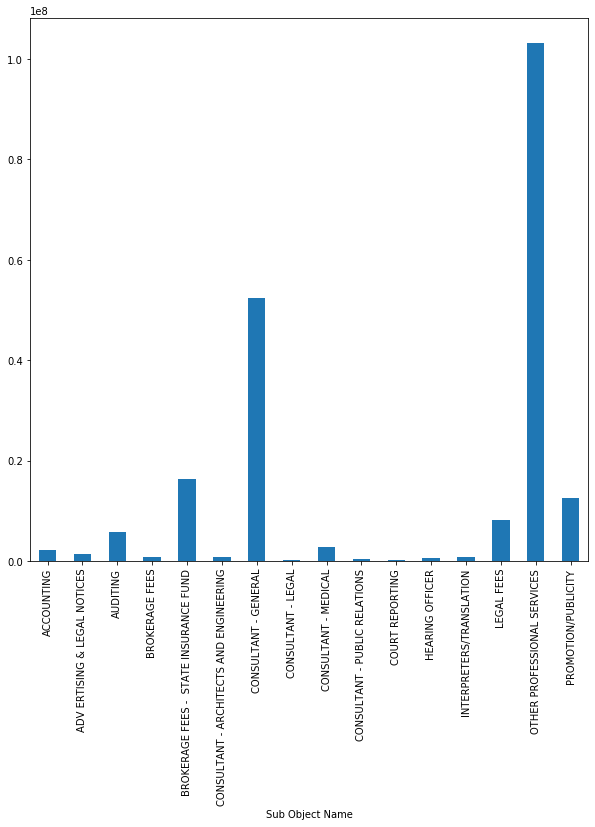

In [755]:
grouped_professional_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'PROFESSIONAL SERVICES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_professional_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_professional_sub_2018['Amount'].agg(np.sum)

Sub Object Name
ACCOUNTING                                 2.065190e+06
ADV ERTISING & LEGAL NOTICES               1.320466e+06
AUDITING                                   5.480737e+06
BROKERAGE FEES                             7.771151e+05
BROKERAGE FEES -  STATE INSURANCE FUND     1.601852e+07
CONSULTANT - ARCHITECTS AND ENGINEERING    2.401681e+06
CONSULTANT - GENERAL                       5.869235e+07
CONSULTANT - LEGAL                         1.672093e+05
CONSULTANT - MEDICAL                       3.342162e+06
CONSULTANT - PUBLIC RELATIONS              2.962525e+05
COURT REPORTING                            1.987463e+05
HEARING OFFICER                            4.918948e+05
INTERPRETERS/TRANSLATION                   7.802488e+05
LEGAL FEES                                 8.781194e+06
OTHER PROFESSIONAL SERVICES                1.085905e+08
PROMOTION/PUBLICITY                        1.332223e+07
Name: Amount, dtype: float64

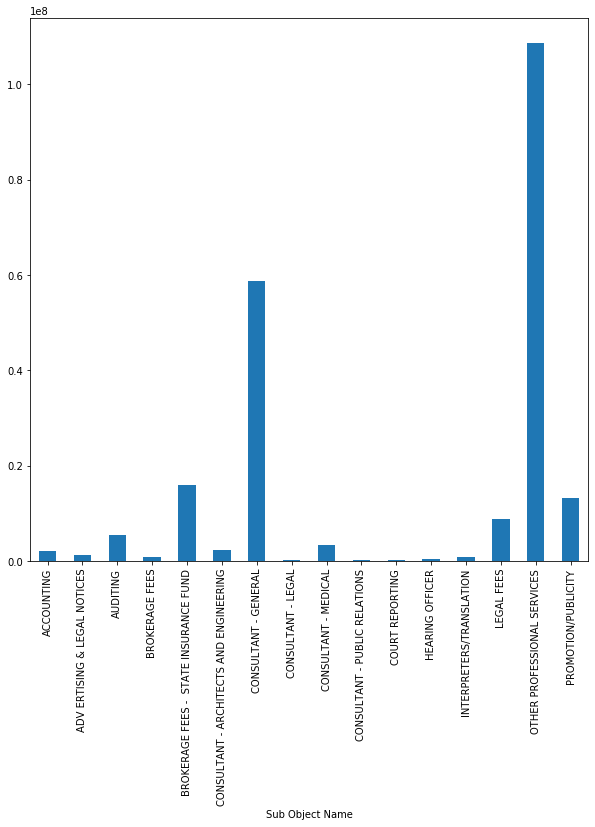

In [756]:
grouped_professional_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'PROFESSIONAL SERVICES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_professional_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10)) 
grouped_professional_sub_2019['Amount'].agg(np.sum)

In [757]:
grouped_professional_sub_sum_2018 = grouped_professional_sub_2018['Amount'].agg(np.sum)
grouped_professional_sub_max_sum_2018 = grouped_professional_sub_sum_2018.max()
grouped_professional_sub_name_sum_2018 = grouped_professional_sub_sum_2018.idxmax()
grouped_professional_sub_name_sum_2018= grouped_professional_sub_name_sum_2018.strip()

grouped_professional_sub_sum_2019 = grouped_professional_sub_2019['Amount'].agg(np.sum)
grouped_professional_sub_max_sum_2019 = grouped_professional_sub_sum_2019.max()
grouped_professional_sub_name_sum_2019 = grouped_professional_sub_sum_2019.idxmax()
grouped_professional_sub_name_sum_2019 = grouped_professional_sub_name_sum_2019.strip()

print("For 2018, " + grouped_professional_sub_name_sum_2018 + " had the most expenditure for the total cost of all Professional Services at " + str(grouped_professional_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_professional_sub_name_sum_2019 + " had the most expenditure for the total cost of all Professional Services at " + str(grouped_professional_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_professional_sub_max_sum_2019 - grouped_professional_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, OTHER PROFESSIONAL SERVICES had the most expenditure for the total cost of all Professional Services at 103103047.00999968.
For 2019, OTHER PROFESSIONAL SERVICES had the most expenditure for the total cost of all Professional Services at 108590489.95000018.
The average increase/decrease was 5487442.940000504 between 2018 and 2019.


Sub Object Name
ACCOUNTING                                   5455.551134
ADV ERTISING & LEGAL NOTICES                  537.319851
AUDITING                                    16817.335324
BROKERAGE FEES                               7651.076633
BROKERAGE FEES -  STATE INSURANCE FUND     775543.199048
CONSULTANT - ARCHITECTS AND ENGINEERING      5890.630455
CONSULTANT - GENERAL                         9950.679975
CONSULTANT - LEGAL                           1916.816970
CONSULTANT - MEDICAL                         4186.061422
CONSULTANT - PUBLIC RELATIONS                2129.435650
COURT REPORTING                               768.133821
HEARING OFFICER                              5044.355664
INTERPRETERS/TRANSLATION                      603.442502
LEGAL FEES                                   8859.329749
OTHER PROFESSIONAL SERVICES                 10036.313347
PROMOTION/PUBLICITY                         10686.670254
Name: Amount, dtype: float64

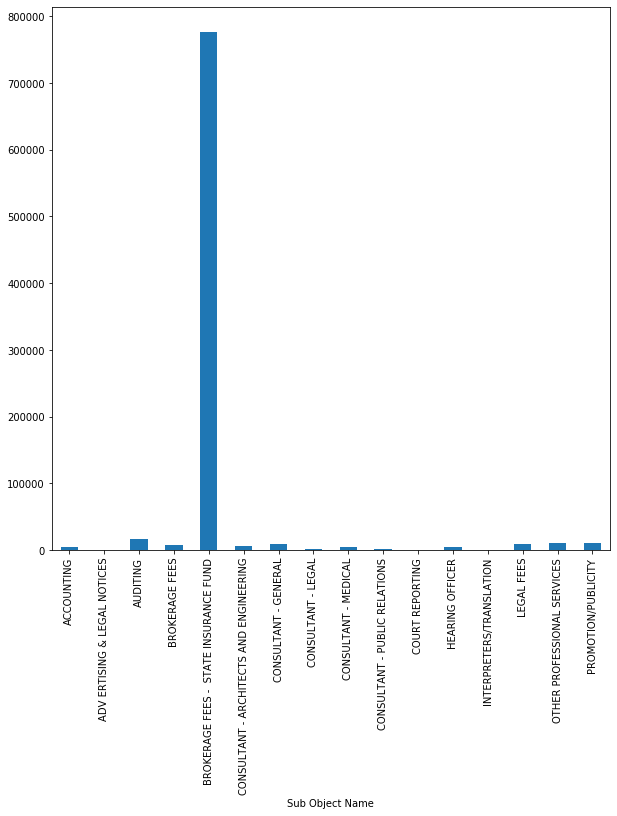

In [758]:
grouped_professional_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10)) 
grouped_professional_sub_2018['Amount'].agg(np.mean)

Sub Object Name
ACCOUNTING                                   5086.675690
ADV ERTISING & LEGAL NOTICES                  596.416346
AUDITING                                    17127.302031
BROKERAGE FEES                               9713.938250
BROKERAGE FEES -  STATE INSURANCE FUND     800926.176500
CONSULTANT - ARCHITECTS AND ENGINEERING     19213.449120
CONSULTANT - GENERAL                        11269.651707
CONSULTANT - LEGAL                           2039.137317
CONSULTANT - MEDICAL                         4051.105018
CONSULTANT - PUBLIC RELATIONS                1936.290915
COURT REPORTING                               883.316889
HEARING OFFICER                              4729.757981
INTERPRETERS/TRANSLATION                      553.760710
LEGAL FEES                                  10282.428103
OTHER PROFESSIONAL SERVICES                  9880.845309
PROMOTION/PUBLICITY                          9468.534371
Name: Amount, dtype: float64

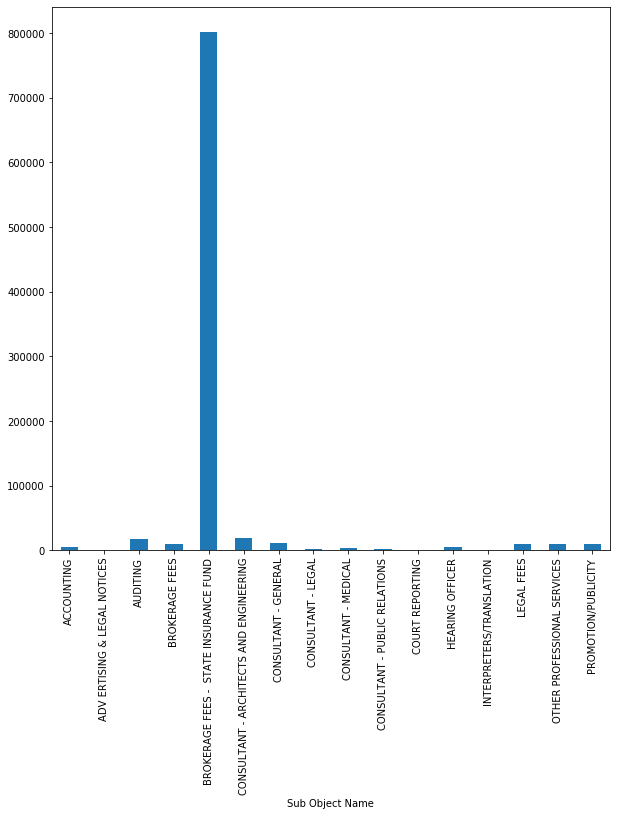

In [759]:
grouped_professional_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10)) 
grouped_professional_sub_2019['Amount'].agg(np.mean)

In [760]:
grouped_professional_sub_mean_2018 = grouped_professional_sub_2018['Amount'].agg(np.mean)
grouped_professional_sub_max_mean_2018 = grouped_professional_sub_mean_2018.max()
grouped_professional_sub_name_mean_2018 = grouped_professional_sub_mean_2018.idxmax()
grouped_professional_sub_name_mean_2018= grouped_professional_sub_name_mean_2018.strip()

grouped_professional_sub_mean_2019 = grouped_professional_sub_2019['Amount'].agg(np.mean)
grouped_professional_sub_max_mean_2019 = grouped_professional_sub_mean_2019.max()
grouped_professional_sub_name_mean_2019 = grouped_professional_sub_mean_2019.idxmax()
grouped_professional_sub_name_mean_2019 = grouped_professional_sub_name_mean_2019.strip()

print("For 2018, " + grouped_professional_sub_name_mean_2018 + " had the most expenditure for the average cost of all Professional Services at " + str(grouped_professional_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_professional_sub_name_mean_2019 + " had the most expenditure for the average cost of all Professional Services at " + str(grouped_professional_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_professional_sub_max_mean_2019 - grouped_professional_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, BROKERAGE FEES -  STATE INSURANCE FUND had the most expenditure for the average cost of all Professional Services at 775543.199047619.
For 2019, BROKERAGE FEES -  STATE INSURANCE FUND had the most expenditure for the average cost of all Professional Services at 800926.1765000001.
The average increase/decrease was 25382.97745238105 between 2018 and 2019.


Sub Object Name
BUILDING TESTING OR INSPECTION                           55604.37
CLERICAL                                                708158.30
DOCUMENT MANAGEMENT/RECYCLING                           260450.01
EDUCATIONAL TESTING, GRADING                           3525571.71
ENVIRONMENTAL OR ECOLOGICAL TESTING                   10845534.52
EXTRADITION COSTS                                        95283.94
FOOD SERVICE TESTING                                      4968.99
GENERAL LABORATORY EQUIPMENT TESTING OR INSPECTION      133604.95
GROUP PUBLICATIONS, SUBSCRIPTIONS & MEMB               4473584.18
HONORARIA                                               170509.77
HUMAN ALCOHOL OR DRUG TESTING SERVICES                   30118.83
HUMAN BLOOD TESTING                                      12649.84
INSTITUTIONAL SERVICES                                19906148.91
LANDSCAPING AND WEED CONTROL                            701140.20
LAUNDRY                                                 8841

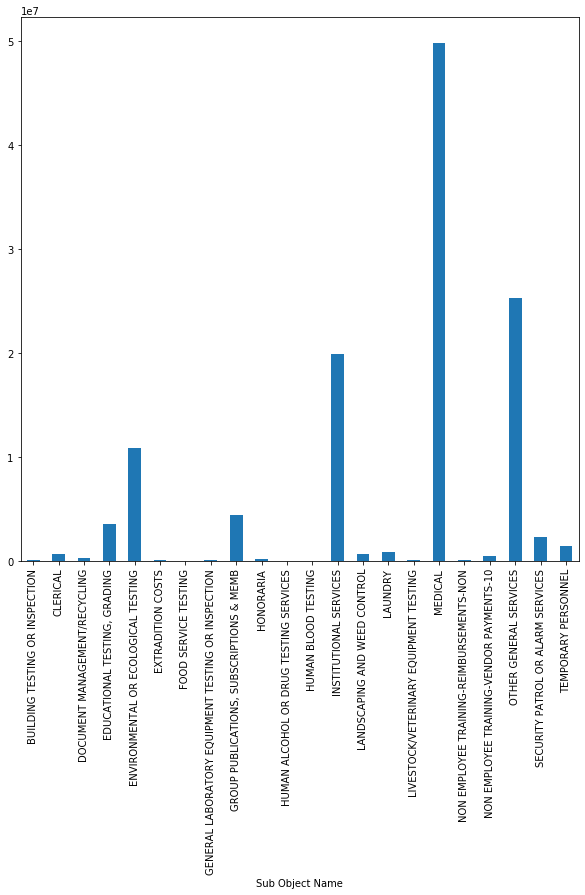

In [761]:
grouped_general_services_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'GENERAL SERVICES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_general_services_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_general_services_sub_2018['Amount'].agg(np.sum)

Sub Object Name
BUILDING TESTING OR INSPECTION                           88220.76
CLERICAL                                                756039.34
DOCUMENT MANAGEMENT/RECYCLING                           266422.80
EDUCATIONAL TESTING, GRADING                           2631431.81
ENVIRONMENTAL OR ECOLOGICAL TESTING                    1081578.50
EXTRADITION COSTS                                       143381.56
FOOD SERVICE TESTING                                       442.00
GENERAL LABORATORY EQUIPMENT TESTING OR INSPECTION       98603.89
GROUP PUBLICATIONS, SUBSCRIPTIONS & MEMB               4823531.33
HONORARIA                                               177003.76
HUMAN ALCOHOL OR DRUG TESTING SERVICES                   28662.80
HUMAN BLOOD TESTING                                       3844.06
INSTITUTIONAL SERVICES                                33950640.13
LANDSCAPING AND WEED CONTROL                            920434.37
LAUNDRY                                                 8996

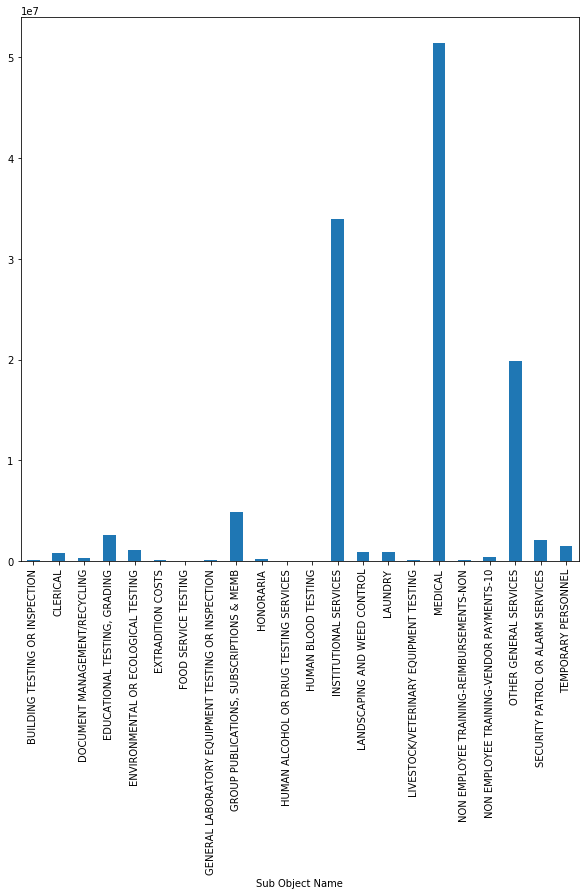

In [762]:
grouped_general_services_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'GENERAL SERVICES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_general_services_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_general_services_sub_2019['Amount'].agg(np.sum)

In [763]:
grouped_general_service_sub_sum_2018 = grouped_general_services_sub_2018['Amount'].agg(np.sum)
grouped_general_service_sub_max_sum_2018 = grouped_general_service_sub_sum_2018.max()
grouped_general_service_sub_name_sum_2018 = grouped_general_service_sub_sum_2018.idxmax()
grouped_general_service_sub_name_sum_2018= grouped_general_service_sub_name_sum_2018.strip()

grouped_general_service_sub_sum_2019 = grouped_general_services_sub_2019['Amount'].agg(np.sum)
grouped_general_service_sub_max_sum_2019 = grouped_general_service_sub_sum_2019.max()
grouped_general_service_sub_name_sum_2019 = grouped_general_service_sub_sum_2019.idxmax()
grouped_general_service_sub_name_sum_2019 = grouped_general_service_sub_name_sum_2019.strip()

print("For 2018, " + grouped_general_service_sub_name_sum_2018 + " had the most expenditure for the total cost of all General Services at " + str(grouped_general_service_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_general_service_sub_name_sum_2019 + " had the most expenditure for the total cost of all General Services at " + str(grouped_general_service_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_general_service_sub_max_sum_2019 - grouped_general_service_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, MEDICAL had the most expenditure for the total cost of all General Services at 49795747.71999998.
For 2019, MEDICAL had the most expenditure for the total cost of all General Services at 51393826.54999999.
The average increase/decrease was 1598078.830000013 between 2018 and 2019.


Sub Object Name
BUILDING TESTING OR INSPECTION                         1425.753077
CLERICAL                                               1162.821511
DOCUMENT MANAGEMENT/RECYCLING                           145.828673
EDUCATIONAL TESTING, GRADING                           3668.649022
ENVIRONMENTAL OR ECOLOGICAL TESTING                   15427.502873
EXTRADITION COSTS                                      2802.468824
FOOD SERVICE TESTING                                    496.899000
GENERAL LABORATORY EQUIPMENT TESTING OR INSPECTION     1391.718229
GROUP PUBLICATIONS, SUBSCRIPTIONS & MEMB               3230.024679
HONORARIA                                               600.386514
HUMAN ALCOHOL OR DRUG TESTING SERVICES                  313.737813
HUMAN BLOOD TESTING                                     436.201379
INSTITUTIONAL SERVICES                                39892.081984
LANDSCAPING AND WEED CONTROL                            653.439143
LAUNDRY                                       

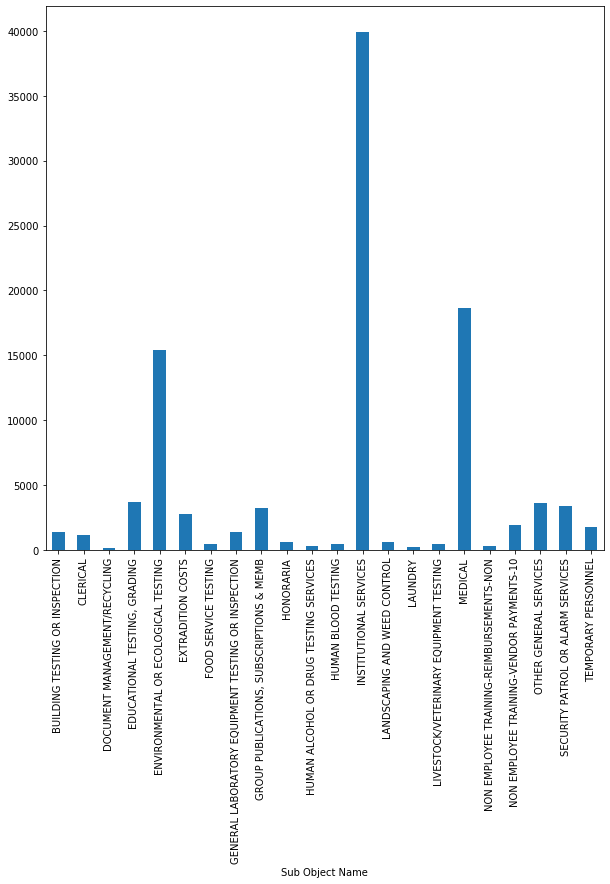

In [764]:
grouped_general_services_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_general_services_sub_2018['Amount'].agg(np.mean)

Sub Object Name
BUILDING TESTING OR INSPECTION                         1575.370714
CLERICAL                                               1116.749394
DOCUMENT MANAGEMENT/RECYCLING                           146.627848
EDUCATIONAL TESTING, GRADING                           2891.683308
ENVIRONMENTAL OR ECOLOGICAL TESTING                    1386.639103
EXTRADITION COSTS                                      1886.599474
FOOD SERVICE TESTING                                    221.000000
GENERAL LABORATORY EQUIPMENT TESTING OR INSPECTION     1217.331975
GROUP PUBLICATIONS, SUBSCRIPTIONS & MEMB               3457.728552
HONORARIA                                               493.046685
HUMAN ALCOHOL OR DRUG TESTING SERVICES                  372.244156
HUMAN BLOOD TESTING                                      83.566522
INSTITUTIONAL SERVICES                                74946.225453
LANDSCAPING AND WEED CONTROL                            752.603737
LAUNDRY                                       

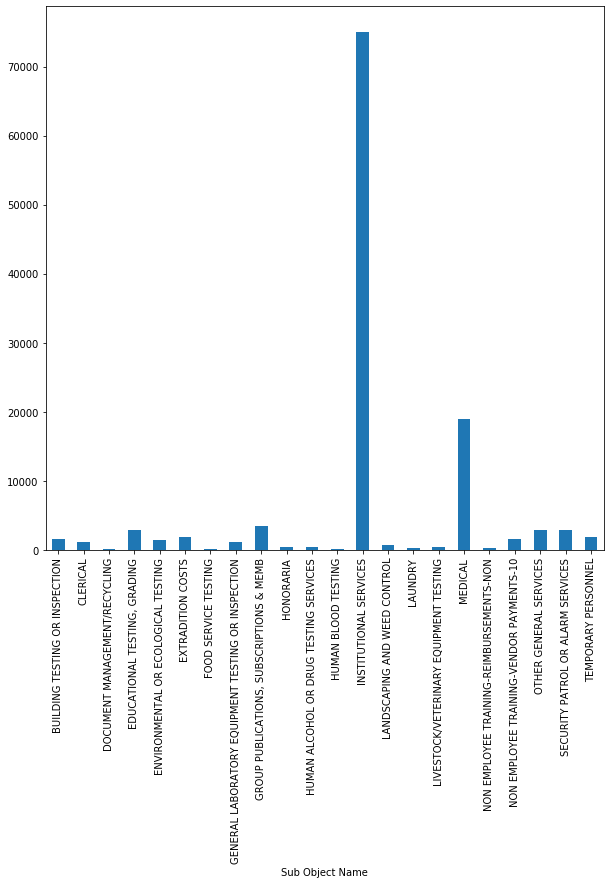

In [765]:
grouped_general_services_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_general_services_sub_2019['Amount'].agg(np.mean)

In [766]:
grouped_general_service_sub_mean_2018 = grouped_general_services_sub_2018['Amount'].agg(np.mean)
grouped_general_service_sub_max_mean_2018 = grouped_general_service_sub_mean_2018.max()
grouped_general_service_sub_name_mean_2018 = grouped_general_service_sub_mean_2018.idxmax()
grouped_general_service_sub_name_mean_2018= grouped_general_service_sub_name_mean_2018.strip()

grouped_general_service_sub_mean_2019 = grouped_general_services_sub_2019['Amount'].agg(np.mean)
grouped_general_service_sub_max_mean_2019 = grouped_general_service_sub_mean_2019.max()
grouped_general_service_sub_name_mean_2019 = grouped_general_service_sub_mean_2019.idxmax()
grouped_general_service_sub_name_mean_2019 = grouped_general_service_sub_name_mean_2019.strip()

print("For 2018, " + grouped_general_service_sub_name_mean_2018 + " had the most expenditure for the average cost of all General Services at " + str(grouped_general_service_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_general_service_sub_name_mean_2019 + " had the most expenditure for the average cost of all General Services at " + str(grouped_general_service_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_general_service_sub_max_mean_2019 - grouped_general_service_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, INSTITUTIONAL SERVICES had the most expenditure for the average cost of all General Services at 39892.08198396793.
For 2019, INSTITUTIONAL SERVICES had the most expenditure for the average cost of all General Services at 74946.2254525386.
The average increase/decrease was 35054.14346857066 between 2018 and 2019.


Sub Object Name
BINDING SERVICES                          4659.91
FREIGHT SERVICES                       1011671.15
MICROFILM, MICROFICHE & CD SERVICES      56398.09
OTHER ADMINISTRATIVE SERVICES           605135.22
PHOTOCOPYING SERVICES                   587255.23
PHOTOGRAPHIC SERVICES                    51310.69
PRINTING SERVICES                      2998145.90
Name: Amount, dtype: float64

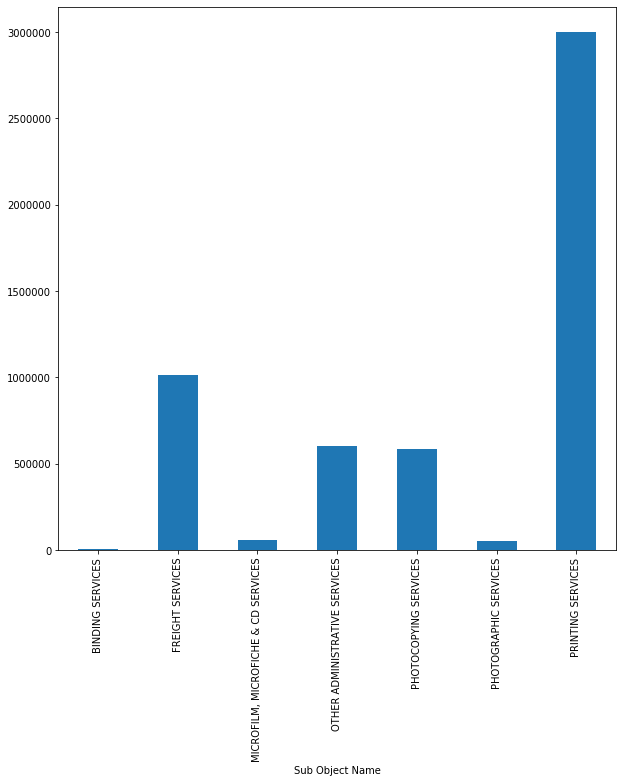

In [767]:
grouped_admin_services_sub_2018 = fy2018[fy2018['Summary Object Name'] == 'ADMINISTRATIVE SERVICES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_admin_services_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_admin_services_sub_2018['Amount'].agg(np.sum)

Sub Object Name
BINDING SERVICES                          2581.40
FREIGHT SERVICES                       1076798.92
MICROFILM, MICROFICHE & CD SERVICES      20004.73
OTHER ADMINISTRATIVE SERVICES           975017.08
PHOTOCOPYING SERVICES                   498341.03
PHOTOGRAPHIC SERVICES                    81806.92
PRINTING SERVICES                      3155499.83
Name: Amount, dtype: float64

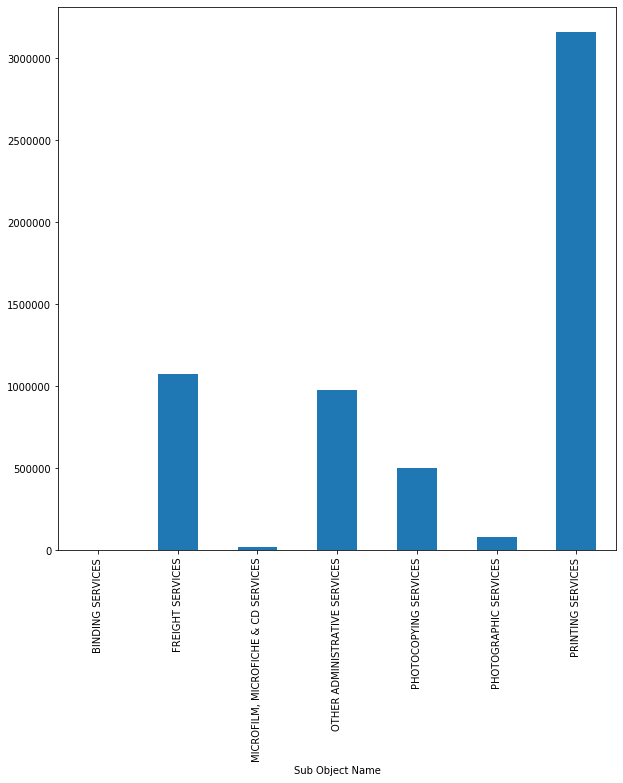

In [768]:
grouped_admin_services_sub_2019 = fy2019[fy2019['Summary Object Name'] == 'ADMINISTRATIVE SERVICES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_admin_services_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10)) 
grouped_admin_services_sub_2019['Amount'].agg(np.sum)

In [769]:
grouped_admin_service_sub_sum_2018 = grouped_admin_services_sub_2018['Amount'].agg(np.sum)
grouped_admin_service_sub_max_sum_2018 = grouped_admin_service_sub_sum_2018.max()
grouped_admin_service_sub_name_sum_2018 = grouped_admin_service_sub_sum_2018.idxmax()
grouped_admin_service_sub_name_sum_2018= grouped_admin_service_sub_name_sum_2018.strip()

grouped_admin_service_sub_sum_2019 = grouped_admin_services_sub_2019['Amount'].agg(np.sum)
grouped_admin_service_sub_max_sum_2019 = grouped_admin_service_sub_sum_2019.max()
grouped_admin_service_sub_name_sum_2019 = grouped_admin_service_sub_sum_2019.idxmax()
grouped_admin_service_sub_name_sum_2019 = grouped_admin_service_sub_name_sum_2019.strip()

print("For 2018, " + grouped_admin_service_sub_name_sum_2018 + " had the most expenditure for the total cost of all Administrative Services at " + str(grouped_admin_service_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_admin_service_sub_name_sum_2019 + " had the most expenditure for the total cost of all Administrative Services at " + str(grouped_admin_service_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_admin_service_sub_max_sum_2019 - grouped_admin_service_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, PRINTING SERVICES had the most expenditure for the total cost of all Administrative Services at 2998145.8999999976.
For 2019, PRINTING SERVICES had the most expenditure for the total cost of all Administrative Services at 3155499.8299999996.
The average increase/decrease was 157353.93000000203 between 2018 and 2019.


Sub Object Name
BINDING SERVICES                        423.628182
FREIGHT SERVICES                        635.471828
MICROFILM, MICROFICHE & CD SERVICES    4028.435000
OTHER ADMINISTRATIVE SERVICES          1276.656582
PHOTOCOPYING SERVICES                   303.805085
PHOTOGRAPHIC SERVICES                   333.186299
PRINTING SERVICES                      1290.635342
Name: Amount, dtype: float64

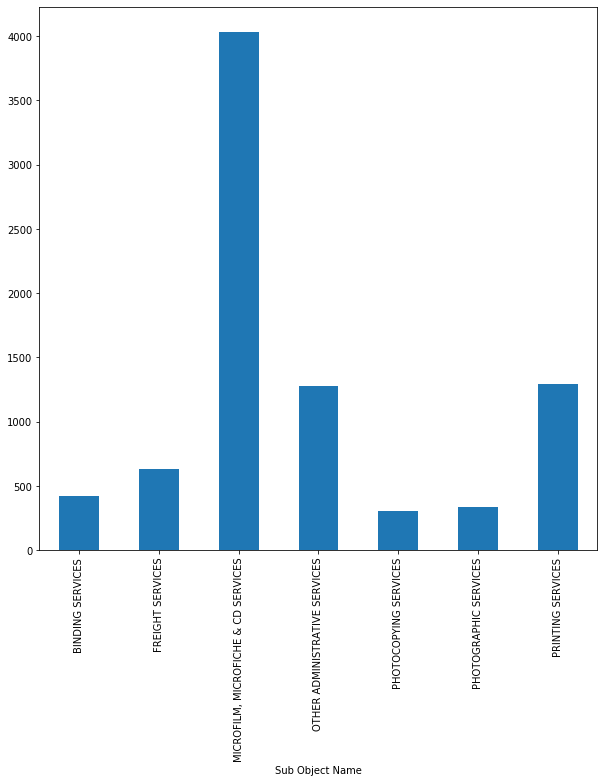

In [770]:
grouped_admin_services_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10)) 
grouped_admin_services_sub_2018['Amount'].agg(np.mean)

Sub Object Name
BINDING SERVICES                        368.771429
FREIGHT SERVICES                        697.408627
MICROFILM, MICROFICHE & CD SERVICES    1176.748824
OTHER ADMINISTRATIVE SERVICES          1969.731475
PHOTOCOPYING SERVICES                   282.987524
PHOTOGRAPHIC SERVICES                   426.077708
PRINTING SERVICES                      1345.628925
Name: Amount, dtype: float64

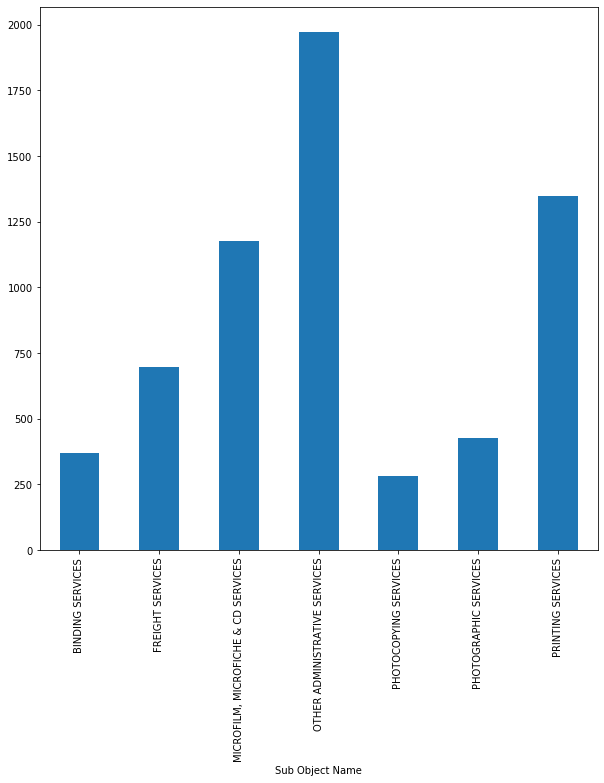

In [771]:
grouped_admin_services_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10)) 
grouped_admin_services_sub_2019['Amount'].agg(np.mean)

In [772]:
grouped_admin_service_sub_mean_2018 = grouped_admin_services_sub_2018['Amount'].agg(np.mean)
grouped_admin_service_sub_max_mean_2018 = grouped_admin_service_sub_mean_2018.max()
grouped_admin_service_sub_name_mean_2018 = grouped_admin_service_sub_mean_2018.idxmax()
grouped_admin_service_sub_name_mean_2018= grouped_admin_service_sub_name_mean_2018.strip()

grouped_admin_service_sub_mean_2019 = grouped_admin_services_sub_2019['Amount'].agg(np.mean)
grouped_admin_service_sub_max_mean_2019 = grouped_admin_service_sub_mean_2019.max()
grouped_admin_service_sub_name_mean_2019 = grouped_admin_service_sub_mean_2019.idxmax()
grouped_admin_service_sub_name_mean_2019 = grouped_admin_service_sub_name_mean_2019.strip()

print("For 2018, " + grouped_admin_service_sub_name_mean_2018 + " had the most expenditure for the average cost of all Administrative Services at " + str(grouped_admin_service_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_admin_service_sub_name_mean_2019 + " had the most expenditure for the average cost of all Administrative Services at " + str(grouped_admin_service_sub_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_admin_service_sub_max_mean_2019 - grouped_admin_service_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, MICROFILM, MICROFICHE & CD SERVICES had the most expenditure for the average cost of all Administrative Services at 4028.435.
For 2019, OTHER ADMINISTRATIVE SERVICES had the most expenditure for the average cost of all Administrative Services at 1969.7314747474745.


Sub Object Name
ACCOUNTING                          109223.00
ADV ERTISING & LEGAL NOTICES        161843.23
ASSESSMENT                            1467.50
AUDIO/VIDEO CONFERENCE CALLS            52.36
AUDITING                            205501.00
                                      ...    
VEHICLE-SUPPLIES ONLY                 6547.63
VEHICLES-RENT/LEASE                  24593.87
WATER                               209864.65
WORKER COMPENSATION NON EMPLOYEE     20255.83
WORKER'S COMPENSATION                58689.42
Name: Amount, Length: 178, dtype: float64

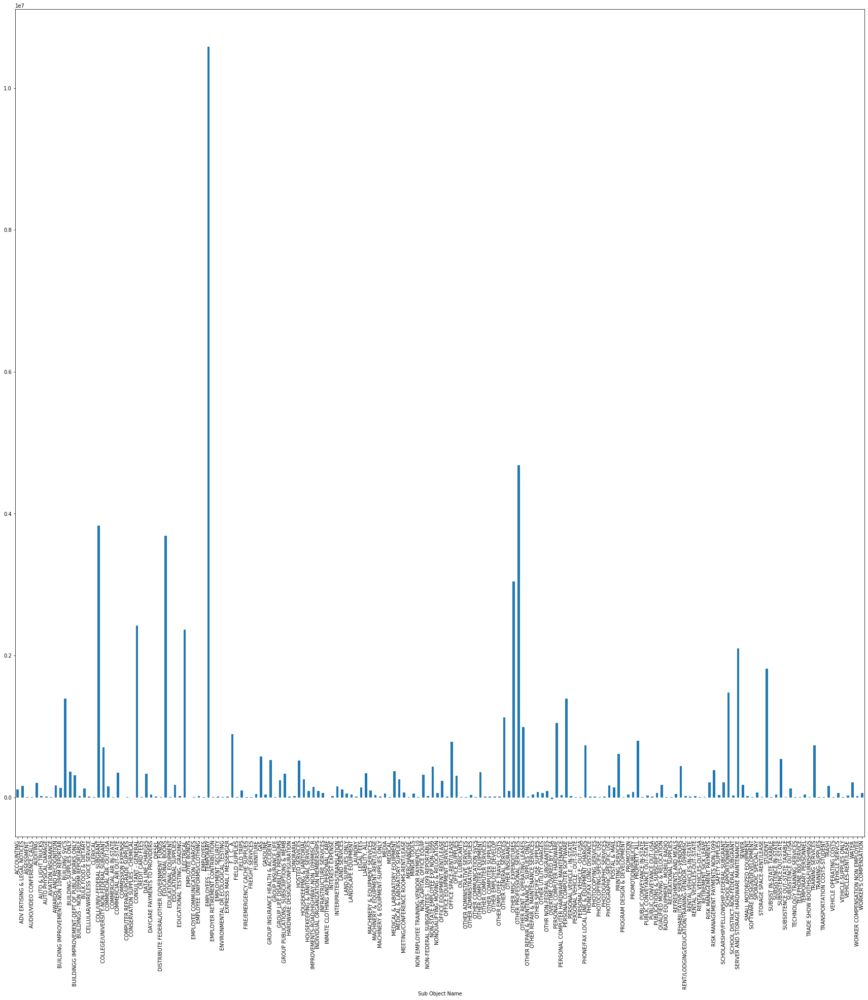

In [773]:
grouped_BoiseState_sub_2018 = fy2018[fy2018['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_BoiseState_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(30,30))
grouped_BoiseState_sub_2018['Amount'].agg(np.sum)

Sub Object Name
ACCOUNTING                      116797.00
ADV ERTISING & LEGAL NOTICES    147300.06
ASSESSMENT                        1481.50
AUDIO/VIDEO CONFERENCE CALLS       329.07
AUDITING                        180469.00
                                  ...    
VEHICLE SERVCS                  124140.80
VEHICLE-SUPPLIES ONLY            10013.36
VEHICLES-RENT/LEASE              17578.26
WATER                           199732.91
WORKER'S COMPENSATION           755582.92
Name: Amount, Length: 175, dtype: float64

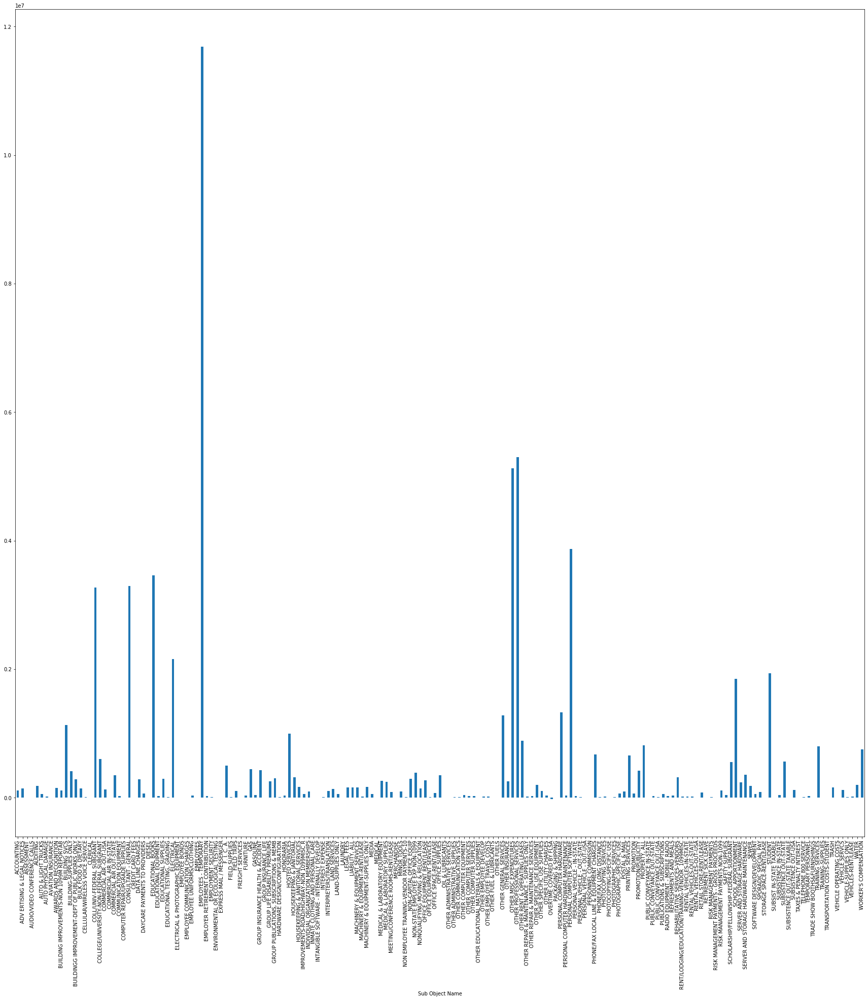

In [774]:
grouped_BoiseState_sub_2019 = fy2019[fy2019['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_BoiseState_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(30,30))
grouped_BoiseState_sub_2019['Amount'].agg(np.sum)

In [775]:
grouped_BoiseState_sub_sum_2018 = grouped_BoiseState_sub_2018['Amount'].agg(np.sum)
grouped_BoiseState_sub_max_sum_2018 = grouped_BoiseState_sub_sum_2018.max()
grouped_BoiseState_sub_name_sum_2018 = grouped_BoiseState_sub_sum_2018.idxmax()
grouped_BoiseState_sub_name_sum_2018= grouped_BoiseState_sub_name_sum_2018.strip()

grouped_BoiseState_sub_sum_2019 = grouped_BoiseState_sub_2019['Amount'].agg(np.sum)
grouped_BoiseState_sub_max_sum_2019 = grouped_BoiseState_sub_sum_2019.max()
grouped_BoiseState_sub_name_sum_2019 = grouped_BoiseState_sub_sum_2019.idxmax()
grouped_BoiseState_sub_name_sum_2019 = grouped_BoiseState_sub_name_sum_2019.strip()

print("For 2018, " + grouped_BoiseState_sub_name_sum_2018 + " had the most expenditure for the total cost of Boise State University at " + str(grouped_BoiseState_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_BoiseState_sub_name_sum_2019 + " had the most expenditure for the total cost of Boise State University at " + str(grouped_BoiseState_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_BoiseState_sub_max_sum_2019 - grouped_BoiseState_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEES - TEMPORARY had the most expenditure for the total cost of Boise State University at 10582763.840000002.
For 2019, EMPLOYEES - TEMPORARY had the most expenditure for the total cost of Boise State University at 11685595.26.
The average increase/decrease was 1102831.419999998 between 2018 and 2019.


Sub Object Name
ACCOUNTING                          54611.500000
ADV ERTISING & LEGAL NOTICES         4374.141351
ASSESSMENT                           1467.500000
AUDIO/VIDEO CONFERENCE CALLS            8.726667
AUDITING                            34250.166667
                                        ...     
VEHICLE-SUPPLIES ONLY                 654.763000
VEHICLES-RENT/LEASE                  1366.326111
WATER                                8071.717308
WORKER COMPENSATION NON EMPLOYEE    10127.915000
WORKER'S COMPENSATION                 762.200260
Name: Amount, Length: 178, dtype: float64

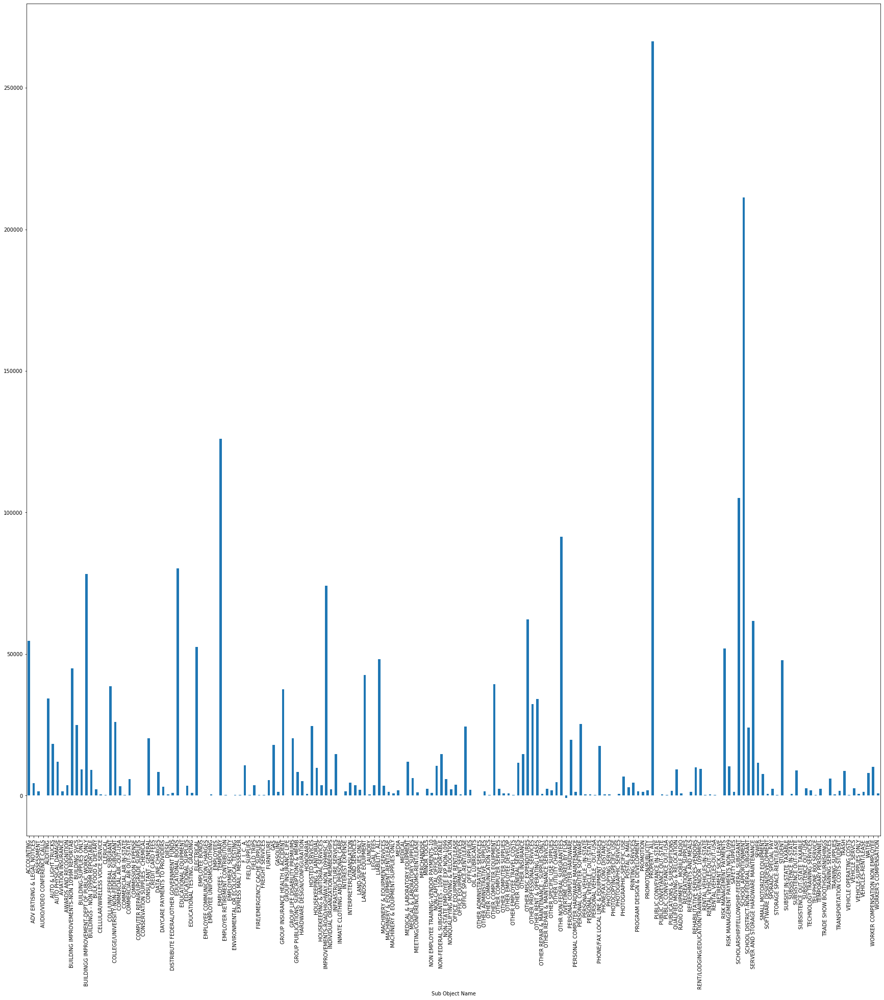

In [776]:
grouped_BoiseState_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(30,30))
grouped_BoiseState_sub_2018['Amount'].agg(np.mean)

Sub Object Name
ACCOUNTING                      116797.000000
ADV ERTISING & LEGAL NOTICES      3981.082703
ASSESSMENT                        1481.500000
AUDIO/VIDEO CONFERENCE CALLS        32.907000
AUDITING                         22558.625000
                                    ...      
VEHICLE SERVCS                    3651.200000
VEHICLE-SUPPLIES ONLY              910.305455
VEHICLES-RENT/LEASE                764.272174
WATER                             7397.515185
WORKER'S COMPENSATION             9214.425854
Name: Amount, Length: 175, dtype: float64

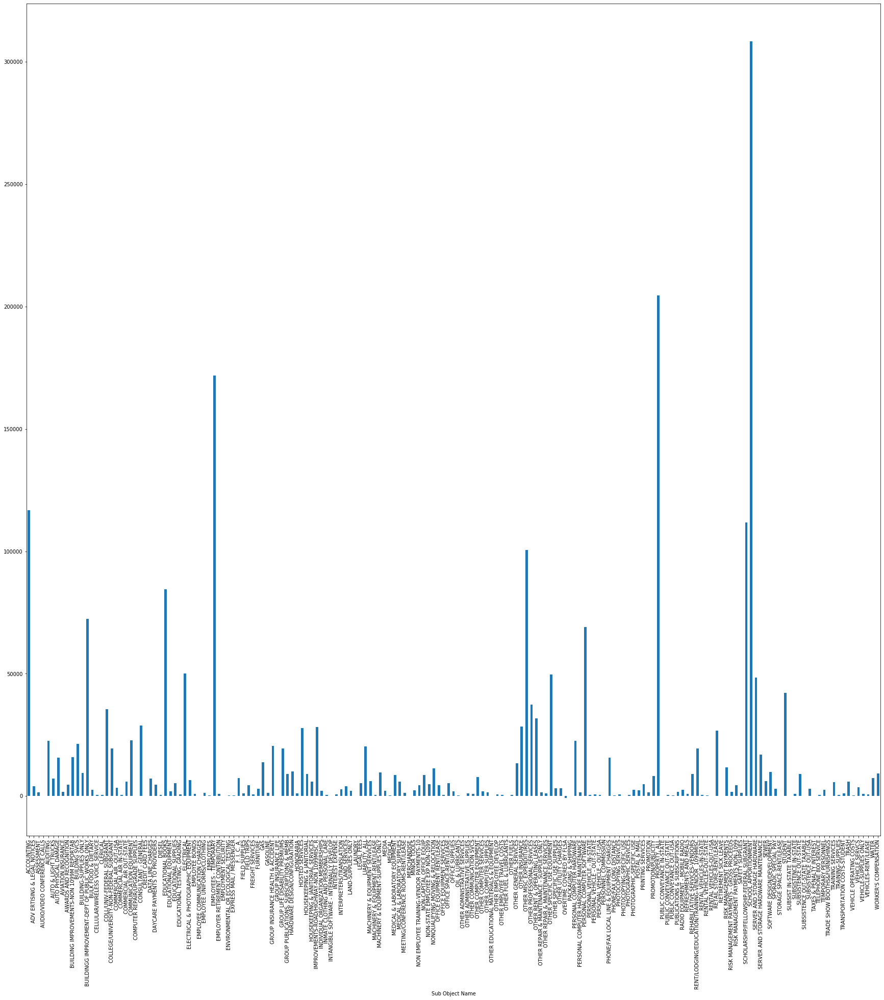

In [777]:
grouped_BoiseState_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(30,30))
grouped_BoiseState_sub_2019['Amount'].agg(np.mean)

In [778]:
grouped_BoiseState_sub_mean_2018 = grouped_BoiseState_sub_2018['Amount'].agg(np.mean)
grouped_BoiseState_sub_max_mean_2018 = grouped_BoiseState_sub_mean_2018.max()
grouped_BoiseState_sub_name_mean_2018 = grouped_BoiseState_sub_mean_2018.idxmax()
grouped_BoiseState_sub_name_mean_2018= grouped_BoiseState_sub_name_mean_2018.strip()

grouped_BoiseState_sub_mean_2019 = grouped_BoiseState_sub_2019['Amount'].agg(np.mean)
grouped_BoiseState_sub_max_mean_2019 = grouped_BoiseState_sub_mean_2019.max()
grouped_BoiseState_sub_name_mean_2019 = grouped_BoiseState_sub_mean_2019.idxmax()
grouped_BoiseState_sub_name_mean_2019 = grouped_BoiseState_sub_name_mean_2019.strip()

print("For 2018, " + grouped_BoiseState_sub_name_mean_2018 + " had the most expenditure for the average cost of Boise State University at " + str(grouped_BoiseState_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_BoiseState_sub_name_mean_2019 + " had the most expenditure for the average cost of Boise State University at " + str(grouped_BoiseState_sub_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_BoiseState_sub_max_mean_2019 - grouped_BoiseState_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, PROPERTY, ALL had the most expenditure for the average cost of Boise State University at 266408.3333333333.
For 2019, SCHOOL APPORTIONMENT had the most expenditure for the average cost of Boise State University at 308310.0.


Sub Object Name
DIESEL                                  523631.68
EMPLOYEE UNIFORMS/CLOTHING                   0.00
GAS                                        976.50
GASOHOL                                   1596.74
GASOLINE                               5504999.06
INFRASTRUCTURE-SUPPLIES ONLY              1165.83
LAND-SUPPLIES ONLY                          70.45
OIL & LUBRICANTS                          6386.71
OTHER COMMUNICATION SVCS                 16158.32
OTHER FUEL & LUBRICANTS                  46212.71
OTHER GENERAL SERVICES                       5.04
OTHER MISC EXPENDITURES                      0.90
OTHER REPAIR & MAINTENANCE SERVICES          0.00
REHABILITATIVE SERVICES-VENDORS           1146.91
VEHICLE OPERATING COSTS                   6480.41
VEHICLE SERVCS                           44231.07
VEHICLE-SUPPLIES ONLY                      200.74
Name: Amount, dtype: float64

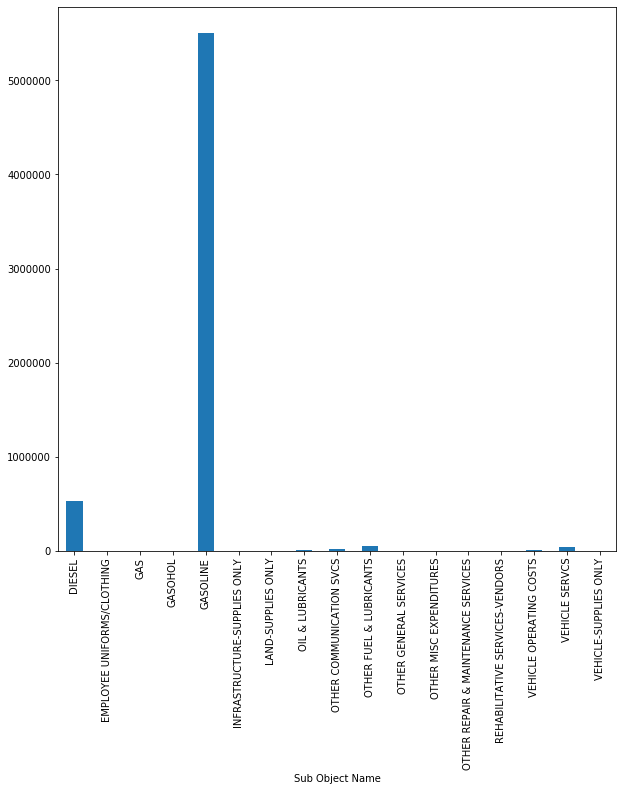

In [779]:
grouped_WEXBank_sub_2018 = fy2018[fy2018['Vendor Name'] == 'WEX BANK'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_WEXBank_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_WEXBank_sub_2018['Amount'].agg(np.sum)

Sub Object Name
DIESEL                                    567108.37
GASOHOL                                     1438.15
GASOLINE                                 5429076.87
LAND-SUPPLIES ONLY                           161.43
LODGING - IN STATE                           186.00
OIL & LUBRICANTS                            7376.37
OTHER COMMUNICATION SVCS                    7583.80
OTHER FUEL & LUBRICANTS                    61640.53
PHOTOGRAPHIC SERVICES                          0.00
REHABILITATIVE SERVICES-VENDORS              800.08
RENTAL VEHICLE MISC IN-STATE NON-1099         26.47
VEHICLE OPERATING COSTS                    41301.61
VEHICLE SERVCS                             42660.86
VEHICLE-SUPPLIES ONLY                         57.88
Name: Amount, dtype: float64

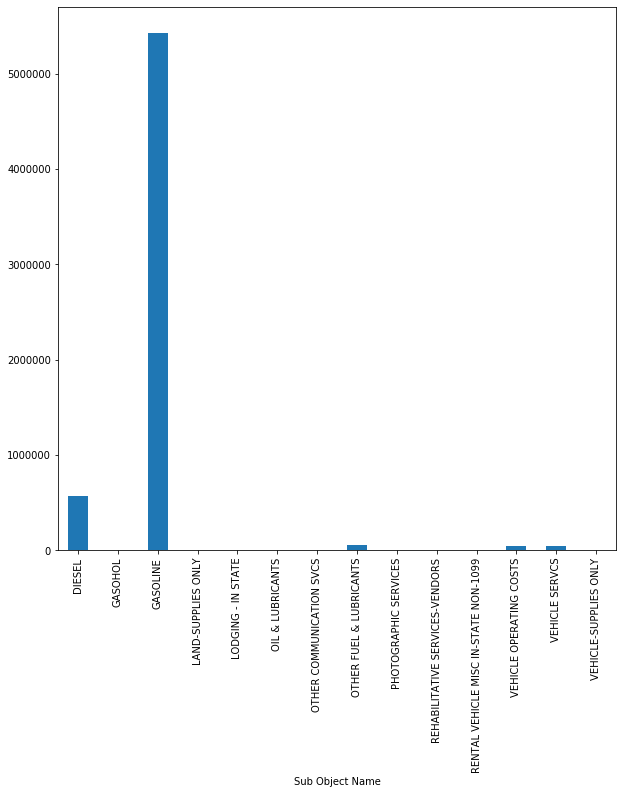

In [780]:
grouped_WEXBank_sub_2019 = fy2019[fy2019['Vendor Name'] == 'WEX BANK'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_WEXBank_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_WEXBank_sub_2019['Amount'].agg(np.sum)

In [781]:
grouped_WEXBank_sub_sum_2018 = grouped_WEXBank_sub_2018['Amount'].agg(np.sum)
grouped_WEXBank_sub_max_sum_2018 = grouped_WEXBank_sub_sum_2018.max()
grouped_WEXBank_sub_name_sum_2018 = grouped_WEXBank_sub_sum_2018.idxmax()
grouped_WEXBank_sub_name_sum_2018= grouped_WEXBank_sub_name_sum_2018.strip()

grouped_WEXBank_sub_sum_2019 = grouped_WEXBank_sub_2019['Amount'].agg(np.sum)
grouped_WEXBank_sub_max_sum_2019 = grouped_WEXBank_sub_sum_2019.max()
grouped_WEXBank_sub_name_sum_2019 = grouped_WEXBank_sub_sum_2019.idxmax()
grouped_WEXBank_sub_name_sum_2019 = grouped_WEXBank_sub_name_sum_2019.strip()

print("For 2018, " + grouped_WEXBank_sub_name_sum_2018 + " had the most expenditure for the total cost of WEX Bank at " + str(grouped_WEXBank_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_WEXBank_sub_name_sum_2019 + " had the most expenditure for the total cost of WEX Bank at " + str(grouped_WEXBank_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_WEXBank_sub_max_sum_2019 - grouped_WEXBank_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, GASOLINE had the most expenditure for the total cost of WEX Bank at 5504999.059999996.
For 2019, GASOLINE had the most expenditure for the total cost of WEX Bank at 5429076.869999994.
The average increase/decrease was -75922.19000000227 between 2018 and 2019.


Sub Object Name
DIESEL                                 5630.448172
EMPLOYEE UNIFORMS/CLOTHING                0.000000
GAS                                     488.250000
GASOHOL                                 145.158182
GASOLINE                               3206.173011
INFRASTRUCTURE-SUPPLIES ONLY           1165.830000
LAND-SUPPLIES ONLY                       35.225000
OIL & LUBRICANTS                        193.536667
OTHER COMMUNICATION SVCS               1615.832000
OTHER FUEL & LUBRICANTS                 722.073594
OTHER GENERAL SERVICES                    5.040000
OTHER MISC EXPENDITURES                   0.300000
OTHER REPAIR & MAINTENANCE SERVICES       0.000000
REHABILITATIVE SERVICES-VENDORS         286.727500
VEHICLE OPERATING COSTS                  90.005694
VEHICLE SERVCS                           81.009286
VEHICLE-SUPPLIES ONLY                    18.249091
Name: Amount, dtype: float64

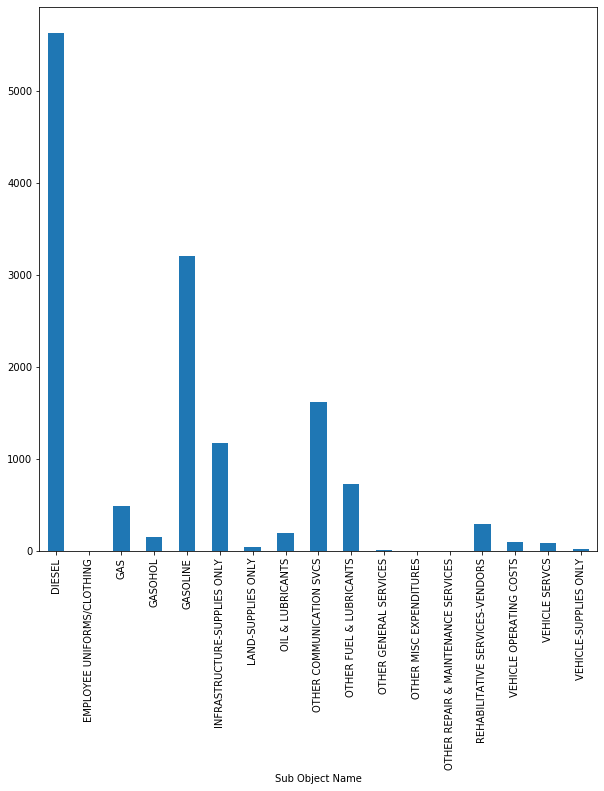

In [782]:
grouped_WEXBank_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_WEXBank_sub_2018['Amount'].agg(np.mean)

In [783]:
grouped_WEXBank_sub_mean_2018 = grouped_WEXBank_sub_2018['Amount'].agg(np.mean)
grouped_WEXBank_sub_max_mean_2018 = grouped_WEXBank_sub_mean_2018.max()
grouped_WEXBank_sub_name_mean_2018 = grouped_WEXBank_sub_mean_2018.idxmax()
grouped_WEXBank_sub_name_mean_2018= grouped_WEXBank_sub_name_mean_2018.strip()

grouped_WEXBank_sub_mean_2019 = grouped_WEXBank_sub_2019['Amount'].agg(np.mean)
grouped_WEXBank_sub_max_mean_2019 = grouped_WEXBank_sub_mean_2019.max()
grouped_WEXBank_sub_name_mean_2019 = grouped_WEXBank_sub_mean_2019.idxmax()
grouped_WEXBank_sub_name_mean_2019 = grouped_WEXBank_sub_name_mean_2019.strip()

print("For 2018, " + grouped_WEXBank_sub_name_mean_2018 + " had the most expenditure for the average cost of WEX Bank at " + str(grouped_WEXBank_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_WEXBank_sub_name_mean_2019 + " had the most expenditure for the average cost of WEX Bank University at " + str(grouped_WEXBank_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_WEXBank_sub_max_mean_2019 - grouped_WEXBank_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, DIESEL had the most expenditure for the average cost of WEX Bank at 5630.448172043009.
For 2019, DIESEL had the most expenditure for the average cost of WEX Bank University at 5846.478041237112.
The average increase/decrease was 216.0298691941025 between 2018 and 2019.


Sub Object Name
DIESEL                                   5846.478041
GASOHOL                                   159.794444
GASOLINE                                 3581.185270
LAND-SUPPLIES ONLY                         32.286000
LODGING - IN STATE                        186.000000
OIL & LUBRICANTS                          230.511562
OTHER COMMUNICATION SVCS                 3791.900000
OTHER FUEL & LUBRICANTS                  1311.500638
PHOTOGRAPHIC SERVICES                       0.000000
REHABILITATIVE SERVICES-VENDORS           266.693333
RENTAL VEHICLE MISC IN-STATE NON-1099      26.470000
VEHICLE OPERATING COSTS                   448.930543
VEHICLE SERVCS                             84.812843
VEHICLE-SUPPLIES ONLY                       7.235000
Name: Amount, dtype: float64

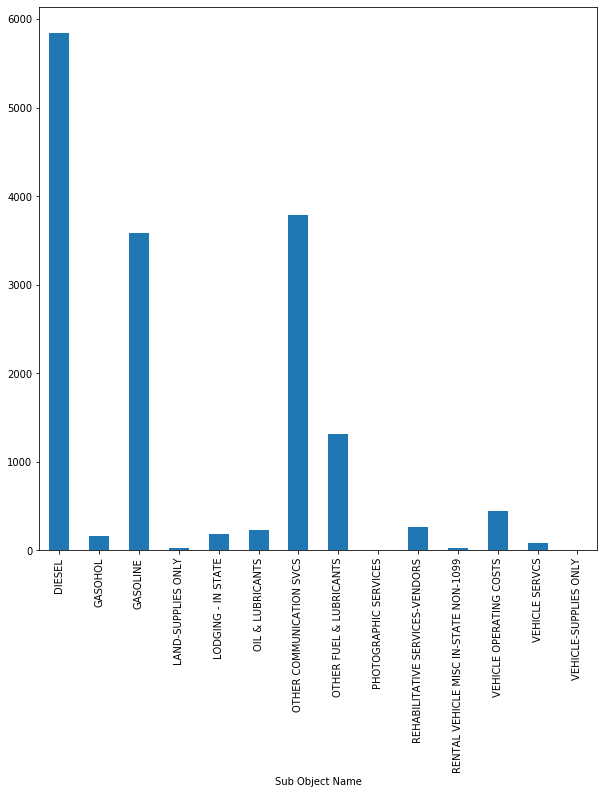

In [784]:
grouped_WEXBank_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_WEXBank_sub_2019['Amount'].agg(np.mean)

Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN         41.79
AWARDS AND RECOGNITION                       3524.53
BUILDING SVCS                                  15.66
BUILDING-SUPPLIES ONLY                       2475.08
BULK FOOD & DIETARY                           378.03
                                              ...   
TELEPHONE AND VOIP EQUIPMENT                  551.00
TRAINING-SUPPLIES                           10266.49
VEHICLE SERVCS                                293.96
VEHICLE-SUPPLIES ONLY                         152.29
VOICE OVER INTERNET (VOIP)-STATE OWNED/O     4824.92
Name: Amount, Length: 65, dtype: float64

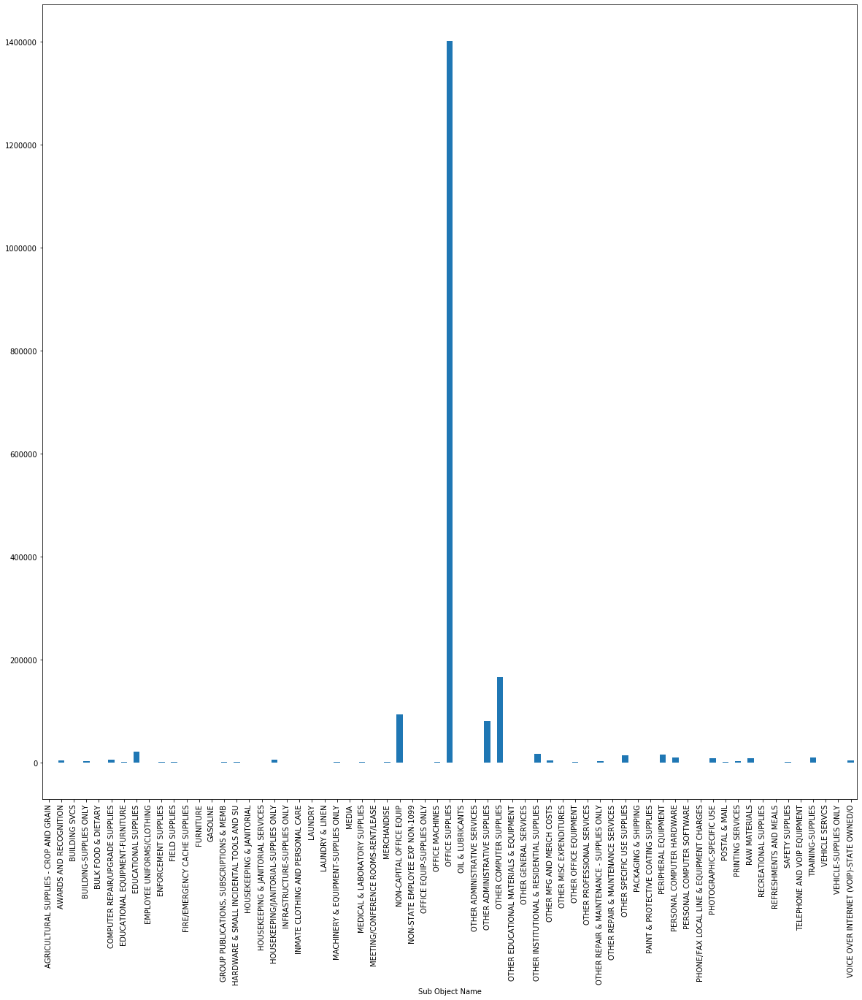

In [785]:
grouped_OfficeDepot_sub_2018 = fy2018[fy2018['Vendor Name'] == 'OFFICE DEPOT INC'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_OfficeDepot_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_OfficeDepot_sub_2018['Amount'].agg(np.sum)

Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN       276.55
AWARDS AND RECOGNITION                      3950.56
BUILDING SVCS                                  4.49
BUILDING-SUPPLIES ONLY                      1000.43
COMPUTER REPAIR/UPGRADE SUPPLIES            3636.43
                                             ...   
TELEPHONE AND VOIP EQUIPMENT                2501.91
TRAINING-SUPPLIES                           8192.03
VEHICLE SERVCS                               344.26
VEHICLE-SUPPLIES ONLY                         65.77
VOICE OVER INTERNET (VOIP)-STATE OWNED/O    2394.18
Name: Amount, Length: 68, dtype: float64

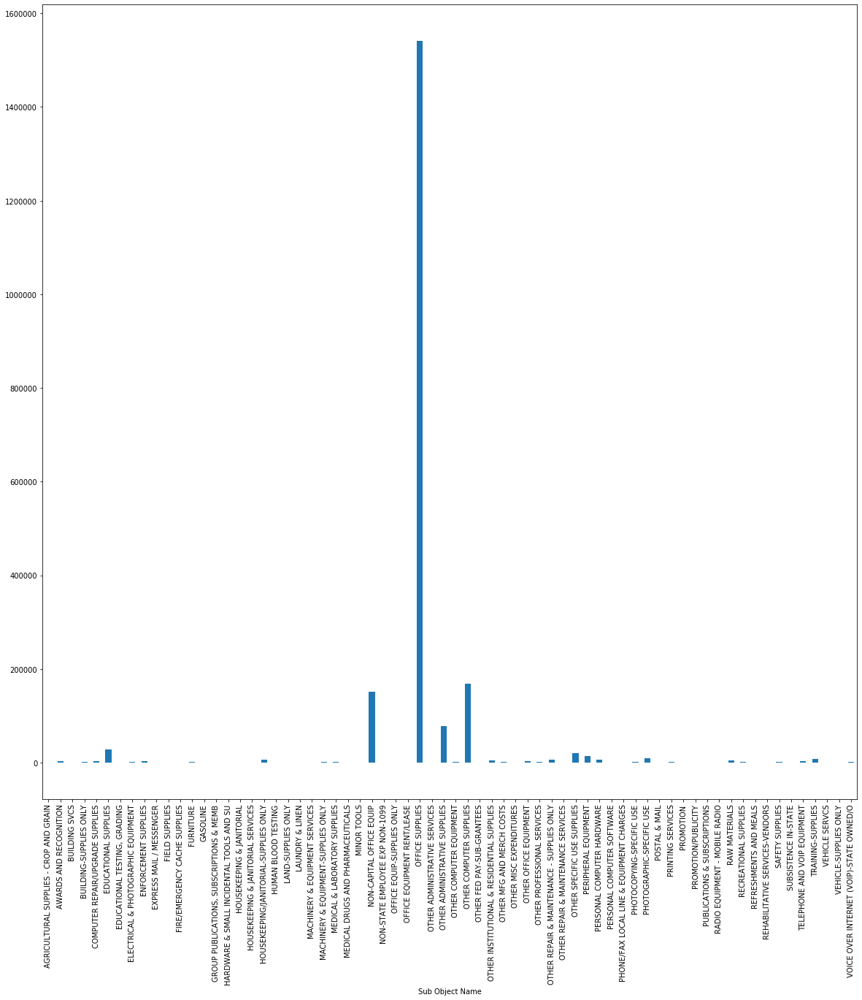

In [786]:
grouped_OfficeDepot_sub_2019 = fy2019[fy2019['Vendor Name'] == 'OFFICE DEPOT INC'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_OfficeDepot_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_OfficeDepot_sub_2019['Amount'].agg(np.sum)

In [787]:
grouped_OfficeDepot_sub_sum_2018 = grouped_OfficeDepot_sub_2018['Amount'].agg(np.sum)
grouped_OfficeDepot_sub_max_sum_2018 = grouped_OfficeDepot_sub_sum_2018.max()
grouped_OfficeDepot_sub_name_sum_2018 = grouped_OfficeDepot_sub_sum_2018.idxmax()
grouped_OfficeDepot_sub_name_sum_2018= grouped_OfficeDepot_sub_name_sum_2018.strip()

grouped_OfficeDepot_sub_sum_2019 = grouped_OfficeDepot_sub_2019['Amount'].agg(np.sum)
grouped_OfficeDepot_sub_max_sum_2019 = grouped_OfficeDepot_sub_sum_2019.max()
grouped_OfficeDepot_sub_name_sum_2019 = grouped_OfficeDepot_sub_sum_2019.idxmax()
grouped_OfficeDepot_sub_name_sum_2019 = grouped_OfficeDepot_sub_name_sum_2019.strip()

print("For 2018, " + grouped_OfficeDepot_sub_name_sum_2018 + " had the most expenditure for the total cost of Office Depot at " + str(grouped_OfficeDepot_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_OfficeDepot_sub_name_sum_2019 + " had the most expenditure for the total cost of Office Depot at " + str(grouped_OfficeDepot_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_OfficeDepot_sub_max_sum_2019 - grouped_OfficeDepot_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, OFFICE SUPPLIES had the most expenditure for the total cost of Office Depot at 1402435.3299999994.
For 2019, OFFICE SUPPLIES had the most expenditure for the total cost of Office Depot at 1541430.3999999943.
The average increase/decrease was 138995.06999999494 between 2018 and 2019.


Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN       41.790000
AWARDS AND RECOGNITION                      146.855417
BUILDING SVCS                                15.660000
BUILDING-SUPPLIES ONLY                      154.692500
BULK FOOD & DIETARY                          54.004286
                                               ...    
TELEPHONE AND VOIP EQUIPMENT                275.500000
TRAINING-SUPPLIES                           789.730000
VEHICLE SERVCS                               73.490000
VEHICLE-SUPPLIES ONLY                        30.458000
VOICE OVER INTERNET (VOIP)-STATE OWNED/O    253.943158
Name: Amount, Length: 65, dtype: float64

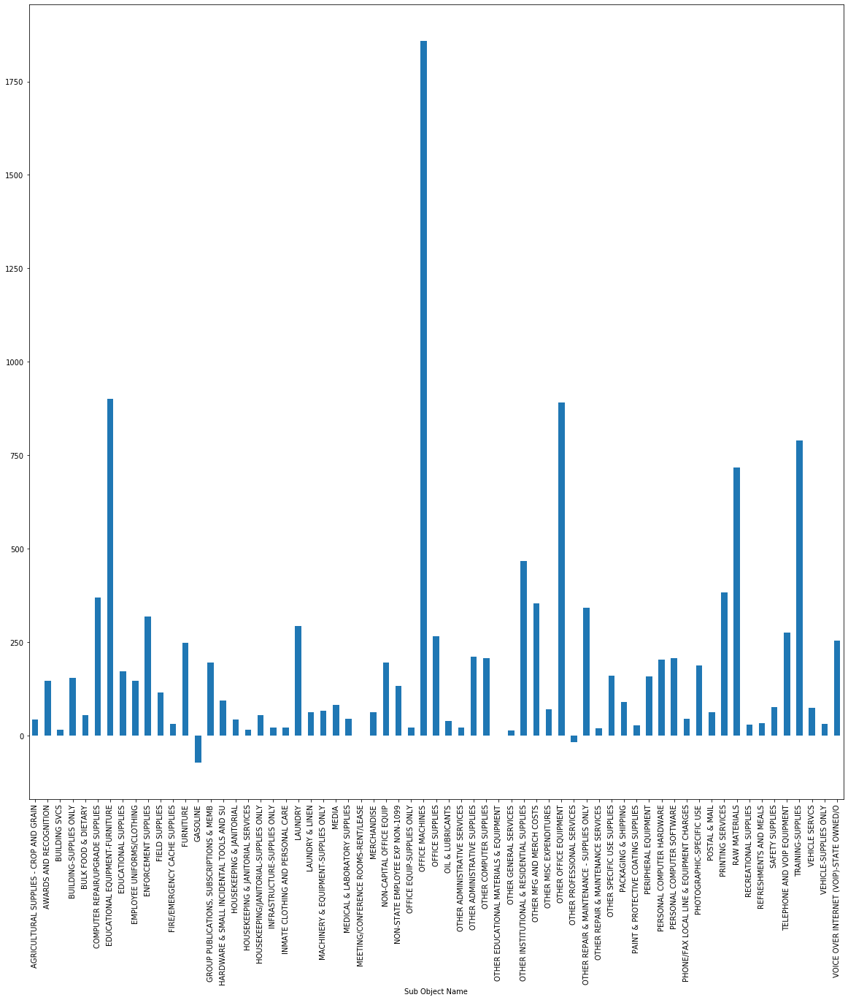

In [788]:
grouped_OfficeDepot_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_OfficeDepot_sub_2018['Amount'].agg(np.mean)

Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN        92.183333
AWARDS AND RECOGNITION                       171.763478
BUILDING SVCS                                  4.490000
BUILDING-SUPPLIES ONLY                        43.496957
COMPUTER REPAIR/UPGRADE SUPPLIES             279.725385
                                               ...     
TELEPHONE AND VOIP EQUIPMENT                2501.910000
TRAINING-SUPPLIES                            512.001875
VEHICLE SERVCS                               172.130000
VEHICLE-SUPPLIES ONLY                         32.885000
VOICE OVER INTERNET (VOIP)-STATE OWNED/O     133.010000
Name: Amount, Length: 68, dtype: float64

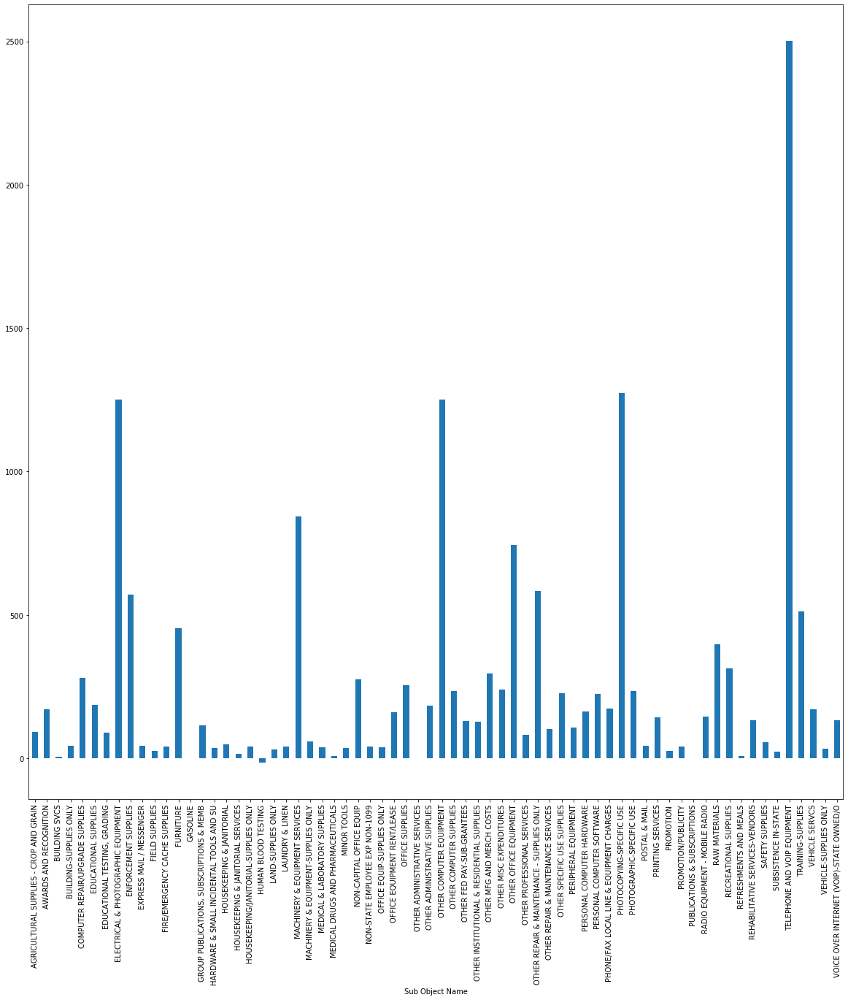

In [789]:
grouped_OfficeDepot_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_OfficeDepot_sub_2019['Amount'].agg(np.mean)

In [790]:
grouped_OfficeDepot_sub_mean_2018 = grouped_OfficeDepot_sub_2018['Amount'].agg(np.mean)
grouped_OfficeDepot_sub_max_mean_2018 = grouped_OfficeDepot_sub_mean_2018.max()
grouped_OfficeDepot_sub_name_mean_2018 = grouped_OfficeDepot_sub_mean_2018.idxmax()
grouped_OfficeDepot_sub_name_mean_2018= grouped_OfficeDepot_sub_name_mean_2018.strip()

grouped_OfficeDepot_sub_mean_2019 = grouped_OfficeDepot_sub_2019['Amount'].agg(np.mean)
grouped_OfficeDepot_sub_max_mean_2019 = grouped_OfficeDepot_sub_mean_2019.max()
grouped_OfficeDepot_sub_name_mean_2019 = grouped_OfficeDepot_sub_mean_2019.idxmax()
grouped_OfficeDepot_sub_name_mean_2019 = grouped_OfficeDepot_sub_name_mean_2019.strip()

print("For 2018, " + grouped_OfficeDepot_sub_name_mean_2018 + " had the most expenditure for the average cost of Office Depot at " + str(grouped_OfficeDepot_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_OfficeDepot_sub_name_mean_2019 + " had the most expenditure for the average cost of Office Depot at " + str(grouped_OfficeDepot_sub_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_OfficeDepot_sub_max_mean_2019 - grouped_OfficeDepot_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, OFFICE MACHINES had the most expenditure for the average cost of Office Depot at 1858.94.
For 2019, TELEPHONE AND VOIP EQUIPMENT had the most expenditure for the average cost of Office Depot at 2501.91.


Sub Object Name
ANNUAL LEAVE BALANCES                     2.921151e+04
BROKERAGE FEES -  STATE INSURANCE FUND    1.628586e+07
BUILDING SVCS                             0.000000e+00
BUILDING-SUPPLIES ONLY                   -8.018300e+02
CELLULAR/WIRELESS DATA SERVICE            2.280000e+03
                                              ...     
VEHICLE SERVCS                           -3.193340e+03
VEHICLE-SUPPLIES ONLY                    -2.400000e+01
VEHICLES-RENT/LEASE                       4.032920e+03
WORKER COMPENSATION AWARDS                1.565544e+08
WORKER'S COMPENSATION                     3.545320e+03
Name: Amount, Length: 105, dtype: float64

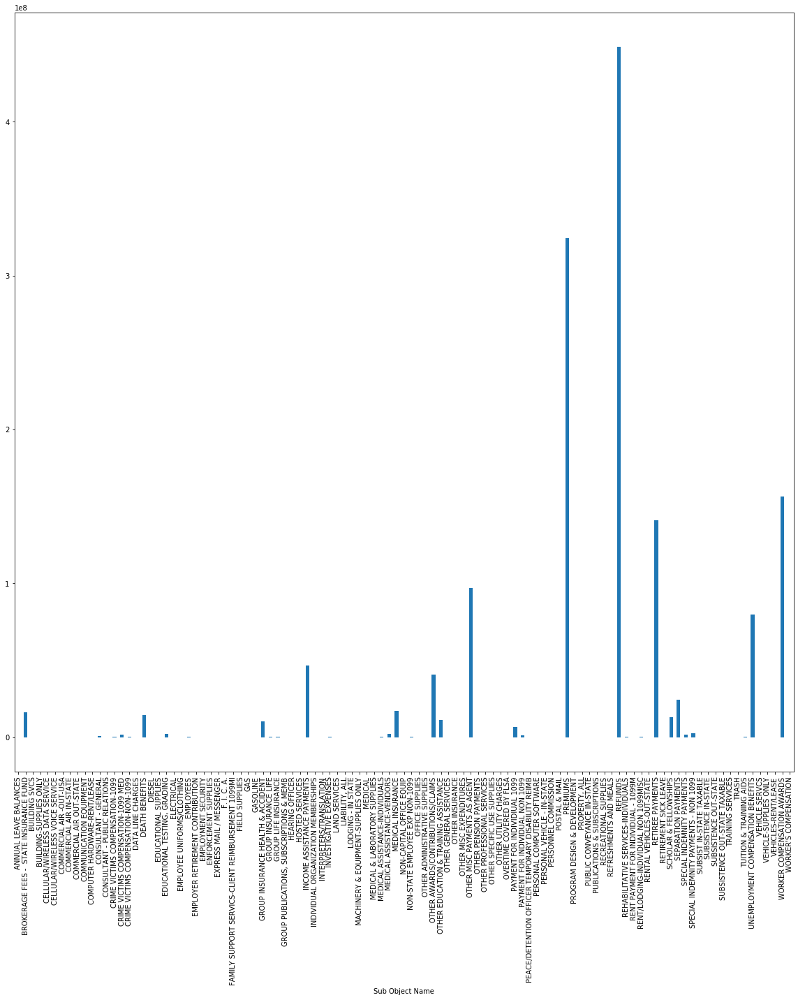

In [791]:
grouped_Redacted_sub_2018 = fy2018[fy2018['Vendor Name'] == 'REDACTED'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_Redacted_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_Redacted_sub_2018['Amount'].agg(np.sum)

Sub Object Name
ANNUAL LEAVE BALANCES                     2.877024e+04
AUTO PHYSICAL DAMAGE                      7.390000e+01
BROKERAGE FEES -  STATE INSURANCE FUND    1.601852e+07
BUILDING-SUPPLIES ONLY                    0.000000e+00
CELLULAR/WIRELESS DATA SERVICE            2.520000e+03
                                              ...     
VEHICLE SERVCS                            1.101700e+02
VEHICLE-SUPPLIES ONLY                     0.000000e+00
VEHICLES-RENT/LEASE                       4.108460e+03
WORKER COMPENSATION AWARDS                1.621956e+08
WORKER'S COMPENSATION                     3.692510e+03
Name: Amount, Length: 103, dtype: float64

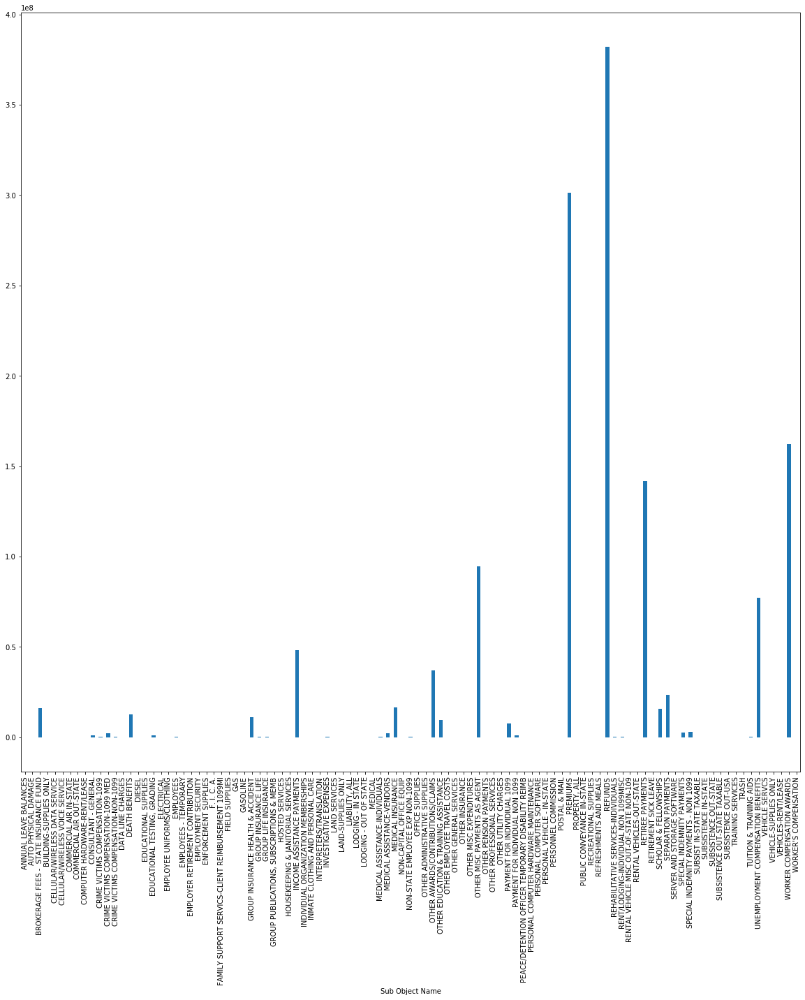

In [792]:
grouped_Redacted_sub_2019 = fy2019[fy2019['Vendor Name'] == 'REDACTED'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_Redacted_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_Redacted_sub_2019['Amount'].agg(np.sum)

In [793]:
grouped_Redacted_sub_sum_2018 = grouped_Redacted_sub_2018['Amount'].agg(np.sum)
grouped_Redacted_sub_max_sum_2018 = grouped_Redacted_sub_sum_2018.max()
grouped_Redacted_sub_name_sum_2018 = grouped_Redacted_sub_sum_2018.idxmax()
grouped_Redacted_sub_name_sum_2018= grouped_Redacted_sub_name_sum_2018.strip()

grouped_Redacted_sub_sum_2019 = grouped_Redacted_sub_2019['Amount'].agg(np.sum)
grouped_Redacted_sub_max_sum_2019 = grouped_Redacted_sub_sum_2019.max()
grouped_Redacted_sub_name_sum_2019 = grouped_Redacted_sub_sum_2019.idxmax()
grouped_Redacted_sub_name_sum_2019 = grouped_Redacted_sub_name_sum_2019.strip()

print("For 2018, " + grouped_Redacted_sub_name_sum_2018 + " had the most expenditure for the total cost of Redacted at " + str(grouped_Redacted_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_Redacted_sub_name_sum_2019 + " had the most expenditure for the total cost of Redacted at " + str(grouped_Redacted_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_Redacted_sub_max_sum_2019 - grouped_Redacted_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, REFUNDS had the most expenditure for the total cost of Redacted at 448595001.3700001.
For 2019, REFUNDS had the most expenditure for the total cost of Redacted at 382022421.76000005.
The average increase/decrease was -66572579.610000074 between 2018 and 2019.


Sub Object Name
ANNUAL LEAVE BALANCES                     1.123520e+03
BROKERAGE FEES -  STATE INSURANCE FUND    1.163276e+06
BUILDING SVCS                             0.000000e+00
BUILDING-SUPPLIES ONLY                   -1.336383e+02
CELLULAR/WIRELESS DATA SERVICE            1.140000e+02
                                              ...     
VEHICLE SERVCS                           -1.064447e+03
VEHICLE-SUPPLIES ONLY                    -6.000000e+00
VEHICLES-RENT/LEASE                       4.032920e+02
WORKER COMPENSATION AWARDS                3.541955e+05
WORKER'S COMPENSATION                     1.418128e+02
Name: Amount, Length: 105, dtype: float64

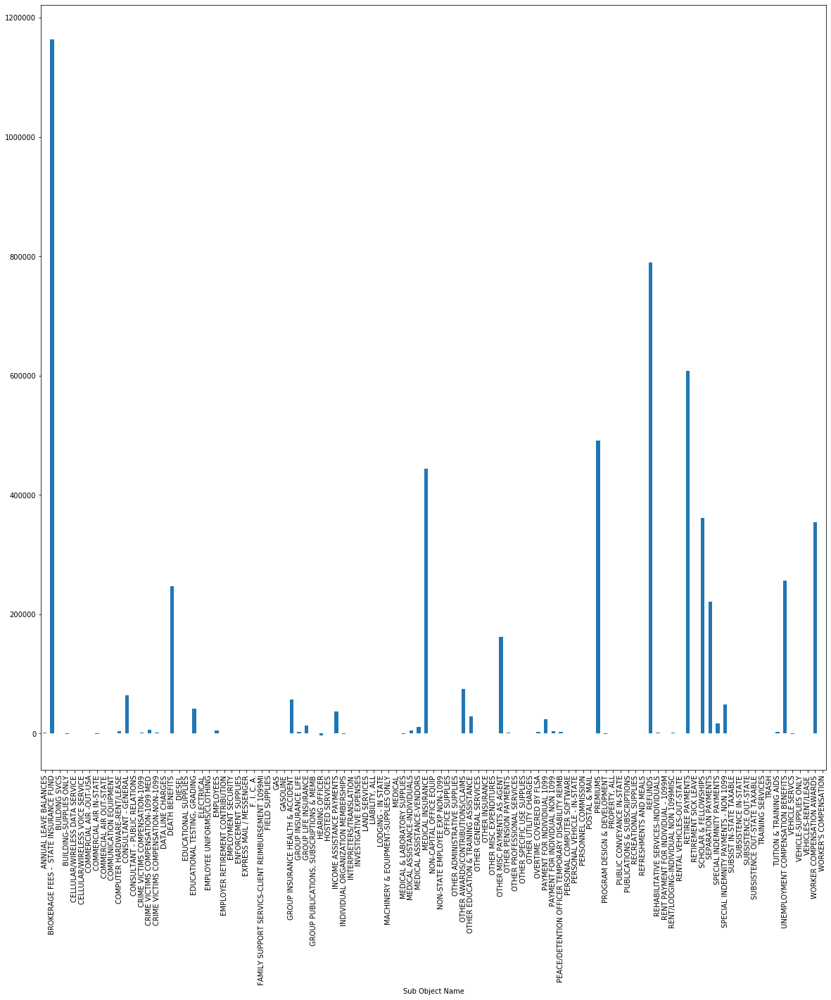

In [794]:
grouped_Redacted_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_Redacted_sub_2018['Amount'].agg(np.mean)

Sub Object Name
ANNUAL LEAVE BALANCES                     1.106548e+03
AUTO PHYSICAL DAMAGE                      7.390000e+01
BROKERAGE FEES -  STATE INSURANCE FUND    1.001158e+06
BUILDING-SUPPLIES ONLY                    0.000000e+00
CELLULAR/WIRELESS DATA SERVICE            1.400000e+02
                                              ...     
VEHICLE SERVCS                            2.203400e+01
VEHICLE-SUPPLIES ONLY                     0.000000e+00
VEHICLES-RENT/LEASE                       2.738973e+02
WORKER COMPENSATION AWARDS                3.880278e+05
WORKER'S COMPENSATION                     1.538546e+02
Name: Amount, Length: 103, dtype: float64

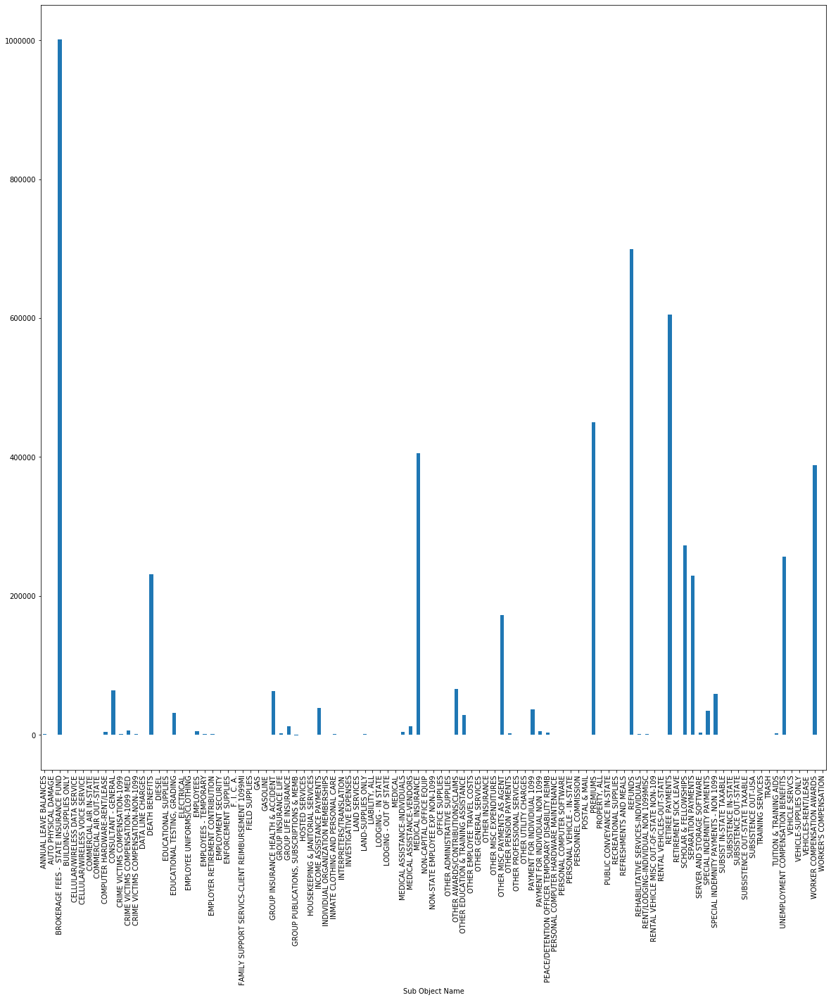

In [795]:
grouped_Redacted_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_Redacted_sub_2019['Amount'].agg(np.mean)

In [796]:
grouped_Redacted_sub_mean_2018 = grouped_Redacted_sub_2018['Amount'].agg(np.mean)
grouped_Redacted_sub_max_mean_2018 = grouped_Redacted_sub_mean_2018.max()
grouped_Redacted_sub_name_mean_2018 = grouped_Redacted_sub_mean_2018.idxmax()
grouped_Redacted_sub_name_mean_2018= grouped_Redacted_sub_name_mean_2018.strip()

grouped_Redacted_sub_mean_2019 = grouped_Redacted_sub_2019['Amount'].agg(np.mean)
grouped_Redacted_sub_max_mean_2019 = grouped_Redacted_sub_mean_2019.max()
grouped_Redacted_sub_name_mean_2019 = grouped_Redacted_sub_mean_2019.idxmax()
grouped_Redacted_sub_name_mean_2019 = grouped_Redacted_sub_name_mean_2019.strip()

print("For 2018, " + grouped_Redacted_sub_name_mean_2018 + " had the most expenditure for the average cost of Redacted at " + str(grouped_Redacted_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_Redacted_sub_name_mean_2019 + " had the most expenditure for the average cost of Redacted at " + str(grouped_Redacted_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_Redacted_sub_max_mean_2019 - grouped_Redacted_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, BROKERAGE FEES -  STATE INSURANCE FUND had the most expenditure for the average cost of Redacted at 1163275.902142857.
For 2019, BROKERAGE FEES -  STATE INSURANCE FUND had the most expenditure for the average cost of Redacted at 1001157.720625.
The average increase/decrease was -162118.181517857 between 2018 and 2019.


Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN       8488.48
AWARDS AND RECOGNITION                       2393.25
BUILDING SVCS                                 183.88
BUILDING-SUPPLIES ONLY                      18923.67
BULK FOOD & DIETARY                           613.06
                                              ...   
TRAINING-SUPPLIES                            4418.76
VEHICLE OPERATING COSTS                        39.98
VEHICLE SERVCS                                166.99
VEHICLE-SUPPLIES ONLY                        6493.06
VOICE OVER INTERNET (VOIP)-STATE OWNED/O     1209.62
Name: Amount, Length: 91, dtype: float64

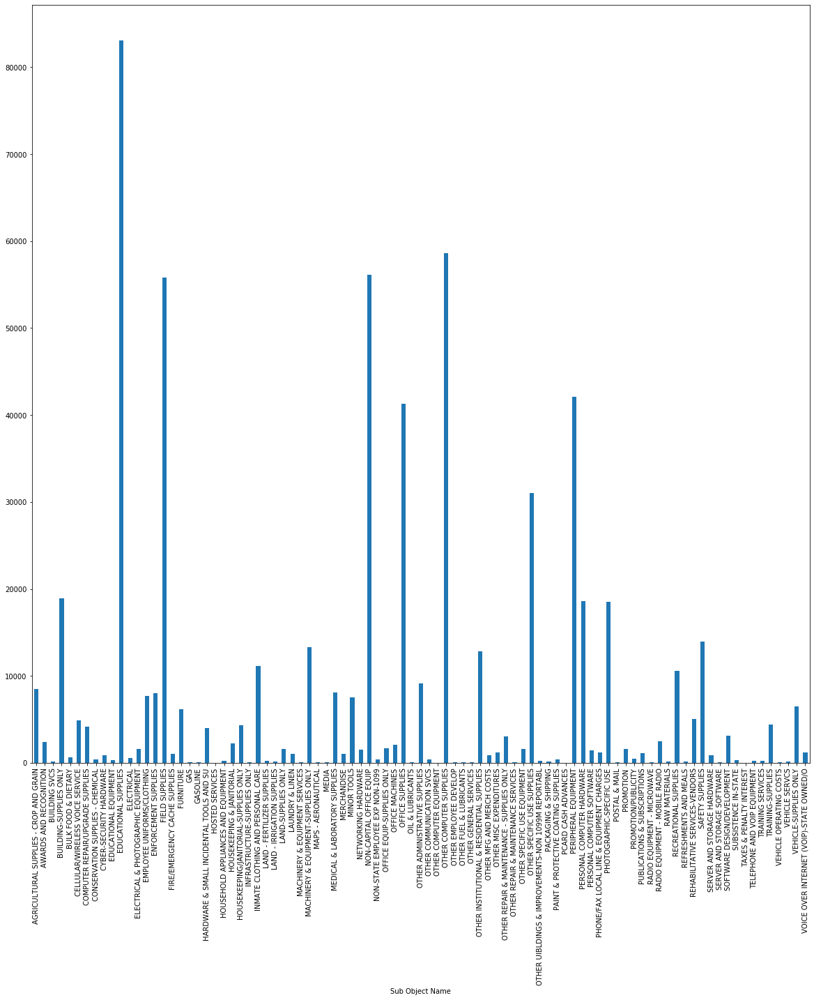

In [797]:
grouped_Amazon_sub_2018 = fy2018[fy2018['Vendor Name'] == 'PCARD - AMAZON MKTPLACE PMTS'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_Amazon_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_Amazon_sub_2018['Amount'].agg(np.sum)

Sub Object Name
AGRICULTURAL SUPPLIES - ANIMALS                         404.86
AGRICULTURAL SUPPLIES - CROP AND GRAIN                 2582.17
AWARDS AND RECOGNITION                                   72.18
BUILDING-SUPPLIES ONLY                                 1111.36
CELLULAR/WIRELESS VOICE SERVICE                        2212.37
CONSERVATION SUPPLIES - CHEMICAL                        134.57
EDUCATIONAL SUPPLIES                                   3479.79
EMPLOYEE UNIFORMS/CLOTHING                              639.39
ENFORCEMENT SUPPLIES                                   1838.83
FIELD SUPPLIES                                        11519.71
HARDWARE & SMALL INCIDENTAL TOOLS AND SU                180.41
HOUSEKEEPING & JANITORIAL                               157.95
HOUSEKEEPING/JANITORIAL-SUPPLIES ONLY                   701.96
INFRASTRUCTURE-SUPPLIES ONLY                            504.83
INMATE CLOTHING AND PERSONAL CARE                        65.35
LAND - IRRIGATION SUPPLIES             

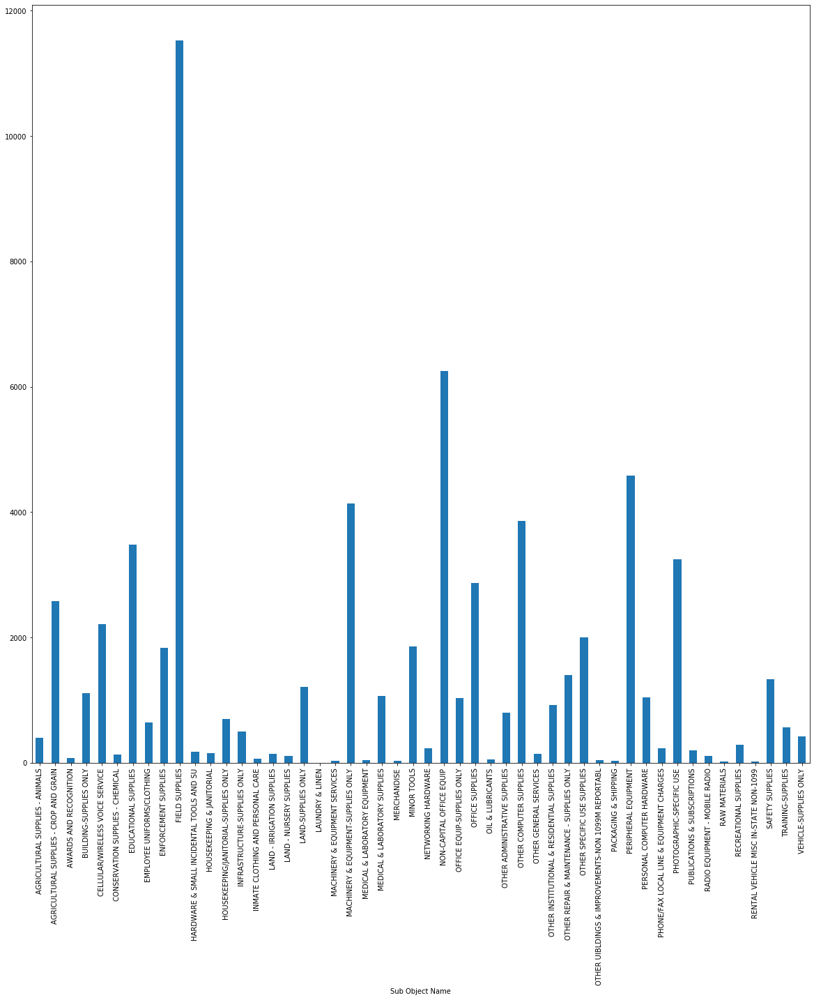

In [798]:
grouped_Amazon_sub_2019 = fy2019[fy2019['Vendor Name'] == 'PCARD - AMAZON MKTPLACE PMTS'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_Amazon_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_Amazon_sub_2019['Amount'].agg(np.sum)

In [799]:
grouped_Amazon_sub_sum_2018 = grouped_Amazon_sub_2018['Amount'].agg(np.sum)
grouped_Amazon_sub_max_sum_2018 = grouped_Amazon_sub_sum_2018.max()
grouped_Amazon_sub_name_sum_2018 = grouped_Amazon_sub_sum_2018.idxmax()
grouped_Amazon_sub_name_sum_2018= grouped_Amazon_sub_name_sum_2018.strip()

grouped_Amazon_sub_sum_2019 = grouped_Amazon_sub_2019['Amount'].agg(np.sum)
grouped_Amazon_sub_max_sum_2019 = grouped_Amazon_sub_sum_2019.max()
grouped_Amazon_sub_name_sum_2019 = grouped_Amazon_sub_sum_2019.idxmax()
grouped_Amazon_sub_name_sum_2019 = grouped_Amazon_sub_name_sum_2019.strip()

print("For 2018, " + grouped_Amazon_sub_name_sum_2018 + " had the most expenditure for the total cost of Amazon at " + str(grouped_Amazon_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_Amazon_sub_name_sum_2019 + " had the most expenditure for the total cost of Amazon at " + str(grouped_Amazon_sub_max_sum_2019) + ".")
#print("The average increase/decrease was " + str(grouped_Amazon_sub_max_sum_2019 - grouped_Amazon_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, EDUCATIONAL SUPPLIES had the most expenditure for the total cost of Amazon at 83035.72000000002.
For 2019, FIELD SUPPLIES had the most expenditure for the total cost of Amazon at 11519.710000000003.


Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN      184.532174
AWARDS AND RECOGNITION                      113.964286
BUILDING SVCS                               183.880000
BUILDING-SUPPLIES ONLY                      175.219167
BULK FOOD & DIETARY                         102.176667
                                               ...    
TRAINING-SUPPLIES                           126.250286
VEHICLE OPERATING COSTS                      39.980000
VEHICLE SERVCS                               27.831667
VEHICLE-SUPPLIES ONLY                        92.758000
VOICE OVER INTERNET (VOIP)-STATE OWNED/O    302.405000
Name: Amount, Length: 91, dtype: float64

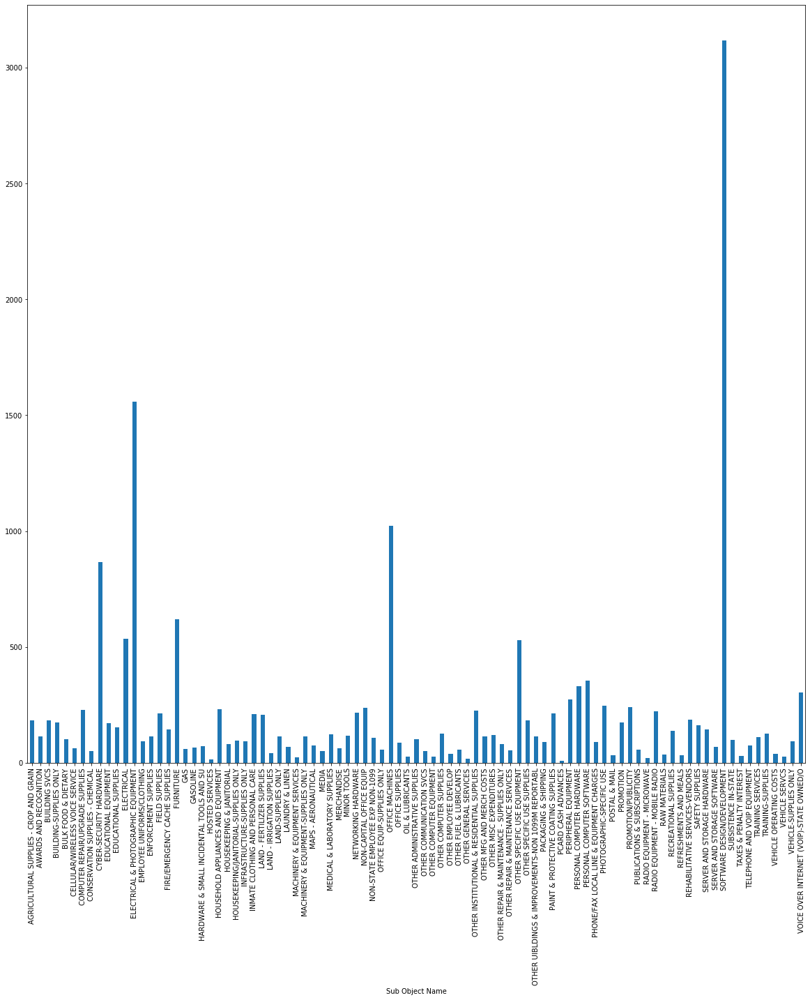

In [800]:
grouped_Amazon_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_Amazon_sub_2018['Amount'].agg(np.mean)

Sub Object Name
AGRICULTURAL SUPPLIES - ANIMALS                        404.860000
AGRICULTURAL SUPPLIES - CROP AND GRAIN                 184.440714
AWARDS AND RECOGNITION                                  36.090000
BUILDING-SUPPLIES ONLY                                  79.382857
CELLULAR/WIRELESS VOICE SERVICE                        245.818889
CONSERVATION SUPPLIES - CHEMICAL                       134.570000
EDUCATIONAL SUPPLIES                                    86.994750
EMPLOYEE UNIFORMS/CLOTHING                              58.126364
ENFORCEMENT SUPPLIES                                    96.780526
FIELD SUPPLIES                                         151.575132
HARDWARE & SMALL INCIDENTAL TOOLS AND SU                18.041000
HOUSEKEEPING & JANITORIAL                               31.590000
HOUSEKEEPING/JANITORIAL-SUPPLIES ONLY                   63.814545
INFRASTRUCTURE-SUPPLIES ONLY                           168.276667
INMATE CLOTHING AND PERSONAL CARE                       32.6

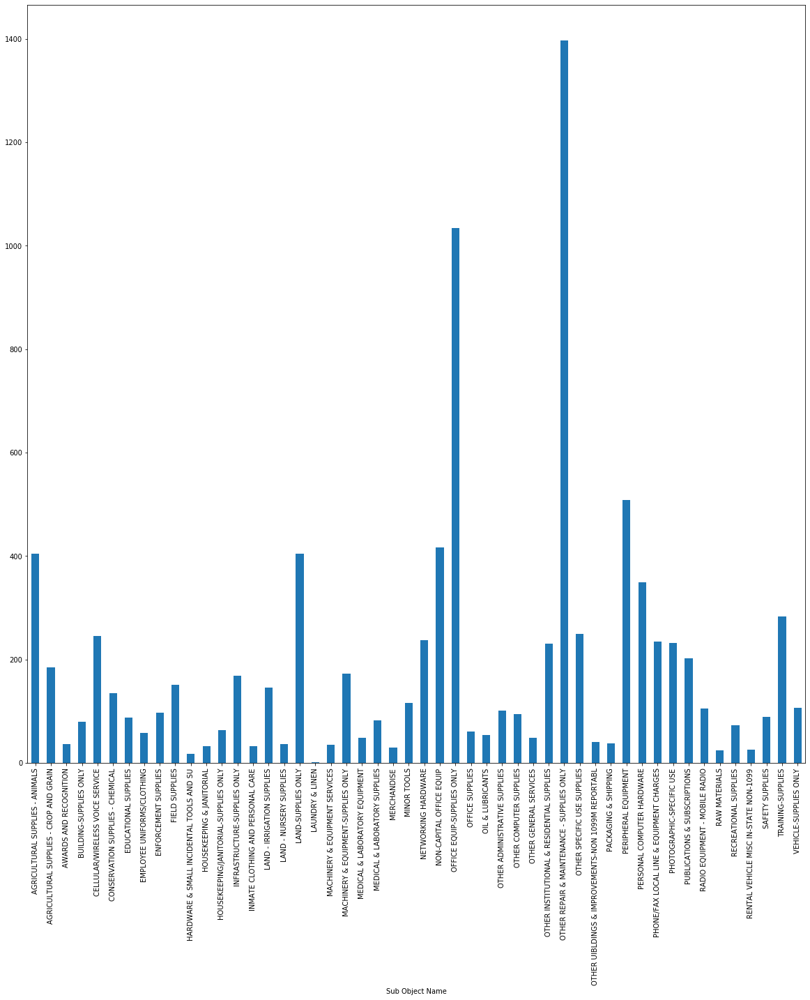

In [801]:
grouped_Amazon_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_Amazon_sub_2019['Amount'].agg(np.mean)

In [802]:
grouped_Amazon_sub_mean_2018 = grouped_Amazon_sub_2018['Amount'].agg(np.mean)
grouped_Amazon_sub_max_mean_2018 = grouped_Amazon_sub_mean_2018.max()
grouped_Amazon_sub_name_mean_2018 = grouped_Amazon_sub_mean_2018.idxmax()
grouped_Amazon_sub_name_mean_2018= grouped_Amazon_sub_name_mean_2018.strip()

grouped_Amazon_sub_mean_2019 = grouped_Amazon_sub_2019['Amount'].agg(np.mean)
grouped_Amazon_sub_max_mean_2019 = grouped_Amazon_sub_mean_2019.max()
grouped_Amazon_sub_name_mean_2019 = grouped_Amazon_sub_mean_2019.idxmax()
grouped_Amazon_sub_name_mean_2019 = grouped_Amazon_sub_name_mean_2019.strip()

print("For 2018, " + grouped_Amazon_sub_name_mean_2018 + " had the most expenditure for the average cost of Amazon at " + str(grouped_Amazon_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_Amazon_sub_name_mean_2019 + " had the most expenditure for the average cost of Amazon at " + str(grouped_Amazon_sub_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_Amazon_sub_max_mean_2019 - grouped_Amazon_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, SOFTWARE DESIGN/DEVELOPMENT had the most expenditure for the average cost of Amazon at 3115.9.
For 2019, OTHER REPAIR & MAINTENANCE - SUPPLIES ONLY had the most expenditure for the average cost of Amazon at 1396.0.


Sub Object Name
BUILDING SVCS                                            1297.97
BUILDINGG IMPROVEMENT-DEPT OF PUBLIC WORKS ONLY         66669.00
BULK FOOD & DIETARY                                      4232.40
CONSULTANT - ARCHITECTS AND ENGINEERING                 25000.00
ELECTRICAL                                            8963135.40
FIELD SUPPLIES                                            500.00
FUEL OIL                                                   17.01
GAS                                                        90.78
GASOLINE                                                  819.89
INFRASTRUCTURE - 1099M REPORTABLE                        2039.91
INMATE CLOTHING AND PERSONAL CARE                       31051.31
MERCHANDISE                                               112.57
OFFICE SPACE-RENT/LEASE                                 28048.54
OTHER GENERAL SERVICES                                   4897.00
OTHER PROFESSIONAL SERVICES                             93399.24
OTHER REN

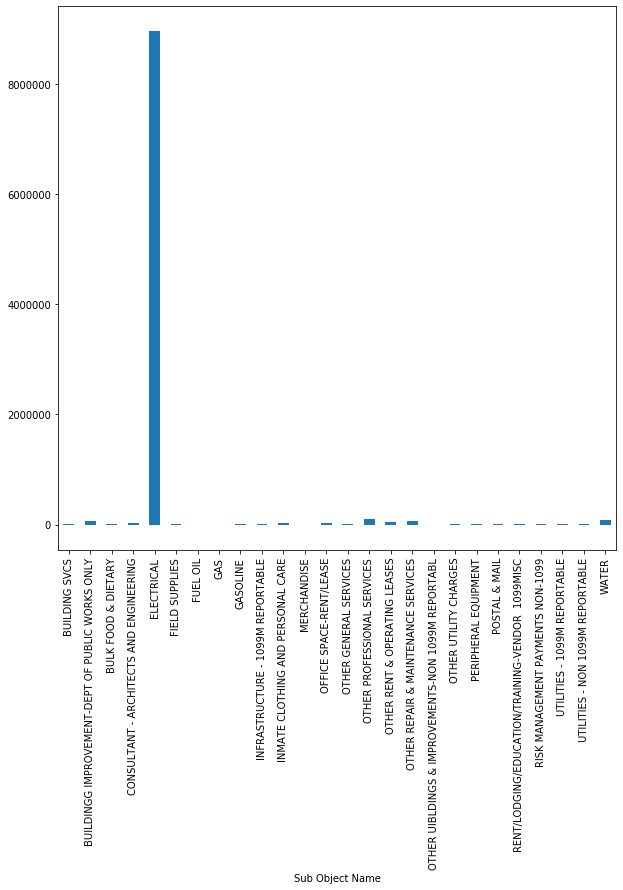

In [803]:
grouped_IdahoPower_sub_2018 = fy2018[fy2018['Vendor Name'] == 'IDAHO POWER COMPANY'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_IdahoPower_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_IdahoPower_sub_2018['Amount'].agg(np.sum)

Sub Object Name
BUILDING SVCS                                             1698.10
BUILDINGG IMPROVEMENT-DEPT OF PUBLIC WORKS ONLY          70405.94
BUILDINGS - 1099M REPORTABLE                               697.00
BULK FOOD & DIETARY                                       4646.72
ELECTRICAL                                            10010082.18
GASOLINE                                                   812.08
INFRASTRUCTURE - 1099M REPORTABLE                        63884.24
INMATE CLOTHING AND PERSONAL CARE                         1232.32
LAND SERVICES                                             1038.00
LODGING - OUT OF STATE                                     280.00
MEDICAL & LABORATORY SUPPLIES                              286.66
OFFICE SPACE-RENT/LEASE                                  28890.03
OTHER BUILDINGS & IMPROVEMENTS - 1099M REPORTABLE        14766.00
OTHER GENERAL SERVICES                                    6579.00
OTHER PROFESSIONAL SERVICES                             4963

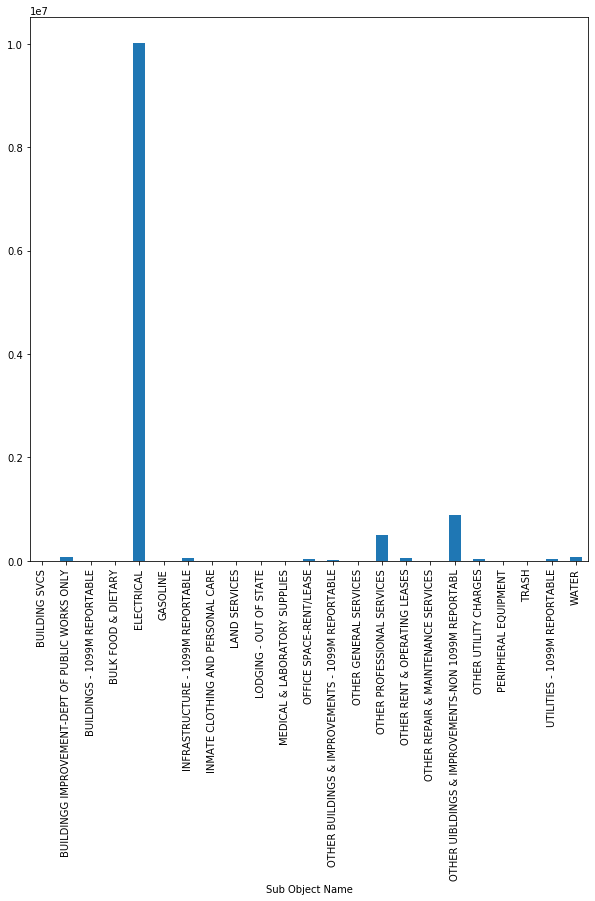

In [804]:
grouped_IdahoPower_sub_2019 = fy2019[fy2019['Vendor Name'] == 'IDAHO POWER COMPANY'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_IdahoPower_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_IdahoPower_sub_2019['Amount'].agg(np.sum)

In [805]:
grouped_IdahoPower_sub_sum_2018 = grouped_IdahoPower_sub_2018['Amount'].agg(np.sum)
grouped_IdahoPower_sub_max_sum_2018 = grouped_IdahoPower_sub_sum_2018.max()
grouped_IdahoPower_sub_name_sum_2018 = grouped_IdahoPower_sub_sum_2018.idxmax()
grouped_IdahoPower_sub_name_sum_2018= grouped_IdahoPower_sub_name_sum_2018.strip()

grouped_IdahoPower_sub_sum_2019 = grouped_IdahoPower_sub_2019['Amount'].agg(np.sum)
grouped_IdahoPower_sub_max_sum_2019 = grouped_IdahoPower_sub_sum_2019.max()
grouped_IdahoPower_sub_name_sum_2019 = grouped_IdahoPower_sub_sum_2019.idxmax()
grouped_IdahoPower_sub_name_sum_2019 = grouped_IdahoPower_sub_name_sum_2019.strip()

print("For 2018, " + grouped_IdahoPower_sub_name_sum_2018 + " had the most expenditure for the total cost of Idaho Power Company at " + str(grouped_IdahoPower_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_IdahoPower_sub_name_sum_2019 + " had the most expenditure for the total cost of Idaho Power Company at " + str(grouped_IdahoPower_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_IdahoPower_sub_max_sum_2019 - grouped_IdahoPower_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, ELECTRICAL had the most expenditure for the total cost of Idaho Power Company at 8963135.40000001.
For 2019, ELECTRICAL had the most expenditure for the total cost of Idaho Power Company at 10010082.179999996.
The average increase/decrease was 1046946.7799999863 between 2018 and 2019.


Sub Object Name
BUILDING SVCS                                           108.164167
BUILDINGG IMPROVEMENT-DEPT OF PUBLIC WORKS ONLY       11111.500000
BULK FOOD & DIETARY                                    4232.400000
CONSULTANT - ARCHITECTS AND ENGINEERING               25000.000000
ELECTRICAL                                             3895.321773
FIELD SUPPLIES                                          500.000000
FUEL OIL                                                 17.010000
GAS                                                      90.780000
GASOLINE                                                273.296667
INFRASTRUCTURE - 1099M REPORTABLE                      1019.955000
INMATE CLOTHING AND PERSONAL CARE                     31051.310000
MERCHANDISE                                             112.570000
OFFICE SPACE-RENT/LEASE                                2337.378333
OTHER GENERAL SERVICES                                 4897.000000
OTHER PROFESSIONAL SERVICES                   

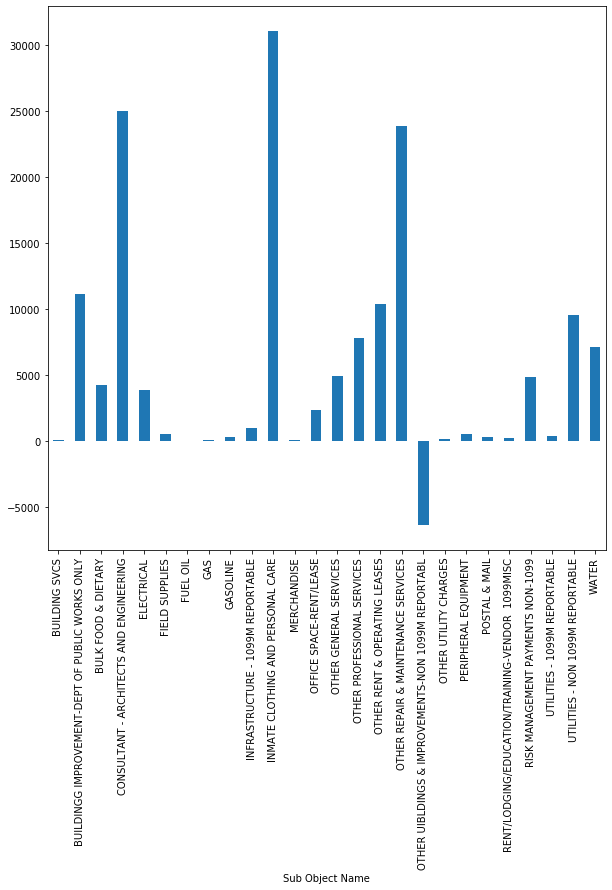

In [806]:
grouped_IdahoPower_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_IdahoPower_sub_2018['Amount'].agg(np.mean)

Sub Object Name
BUILDING SVCS                                            130.623077
BUILDINGG IMPROVEMENT-DEPT OF PUBLIC WORKS ONLY        23468.646667
BUILDINGS - 1099M REPORTABLE                             697.000000
BULK FOOD & DIETARY                                     4646.720000
ELECTRICAL                                              4529.448950
GASOLINE                                                 270.693333
INFRASTRUCTURE - 1099M REPORTABLE                      21294.746667
INMATE CLOTHING AND PERSONAL CARE                       1232.320000
LAND SERVICES                                           1038.000000
LODGING - OUT OF STATE                                   280.000000
MEDICAL & LABORATORY SUPPLIES                            286.660000
OFFICE SPACE-RENT/LEASE                                 2407.502500
OTHER BUILDINGS & IMPROVEMENTS - 1099M REPORTABLE      14766.000000
OTHER GENERAL SERVICES                                  6579.000000
OTHER PROFESSIONAL SERVICES     

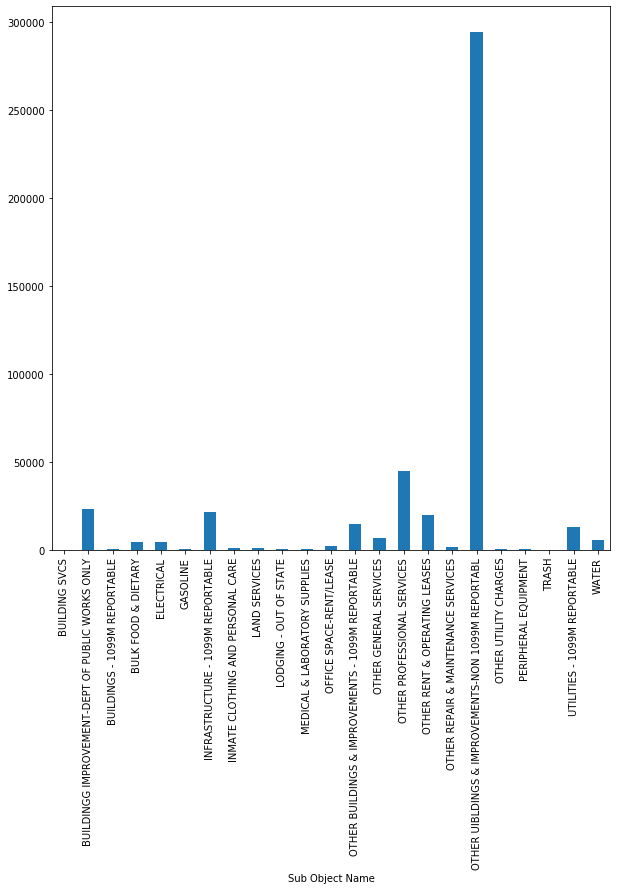

In [807]:
grouped_IdahoPower_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_IdahoPower_sub_2019['Amount'].agg(np.mean)

In [808]:
grouped_IdahoPower_sub_mean_2018 = grouped_IdahoPower_sub_2018['Amount'].agg(np.mean)
grouped_IdahoPower_sub_max_mean_2018 = grouped_IdahoPower_sub_mean_2018.max()
grouped_IdahoPower_sub_name_mean_2018 = grouped_IdahoPower_sub_mean_2018.idxmax()
grouped_IdahoPower_sub_name_mean_2018= grouped_IdahoPower_sub_name_mean_2018.strip()

grouped_IdahoPower_sub_mean_2019 = grouped_IdahoPower_sub_2019['Amount'].agg(np.mean)
grouped_IdahoPower_sub_max_mean_2019 = grouped_IdahoPower_sub_mean_2019.max()
grouped_IdahoPower_sub_name_mean_2019 = grouped_IdahoPower_sub_mean_2019.idxmax()
grouped_IdahoPower_sub_name_mean_2019 = grouped_IdahoPower_sub_name_mean_2019.strip()

print("For 2018, " + grouped_IdahoPower_sub_name_mean_2018 + " had the most expenditure for the average cost of Idaho Power Company at " + str(grouped_IdahoPower_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_IdahoPower_sub_name_mean_2019 + " had the most expenditure for the average cost of Idaho Power Company at " + str(grouped_IdahoPower_sub_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_IdahoPower_sub_max_mean_2019 - grouped_IdahoPower_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, INMATE CLOTHING AND PERSONAL CARE had the most expenditure for the average cost of Idaho Power Company at 31051.31.
For 2019, OTHER UIBLDINGS & IMPROVEMENTS-NON 1099M REPORTABL had the most expenditure for the average cost of Idaho Power Company at 294457.3333333333.


Sub Object Name
AWARDS AND RECOGNITION                             40.40
BUILDING-SUPPLIES ONLY                            839.14
BULK FOOD & DIETARY                             19547.72
BULK FRESH FOOD-DAIRY PRODUCTS                      0.00
EDUCATIONAL SUPPLIES                             1365.98
EMPLOYEE UNIFORMS/CLOTHING                          5.77
FIELD SUPPLIES                                    195.08
HARDWARE & SMALL INCIDENTAL TOOLS AND SU          542.50
HOUSEHOLD EQUIPMENT-FLOORING                    17743.17
HOUSEKEEPING & JANITORIAL                     1048016.07
HOUSEKEEPING & JANITORIAL SERVICES               1406.78
HOUSEKEEPING/JANITORIAL-SUPPLIES ONLY          463807.56
INFRASTRUCTURE SERVICES                         -6210.23
INFRASTRUCTURE-SUPPLIES ONLY                       34.10
INMATE CLOTHING AND PERSONAL CARE              524782.32
LAND SERVICES                                    1584.98
LAND-SUPPLIES ONLY                                130.70
LAUNDRY        

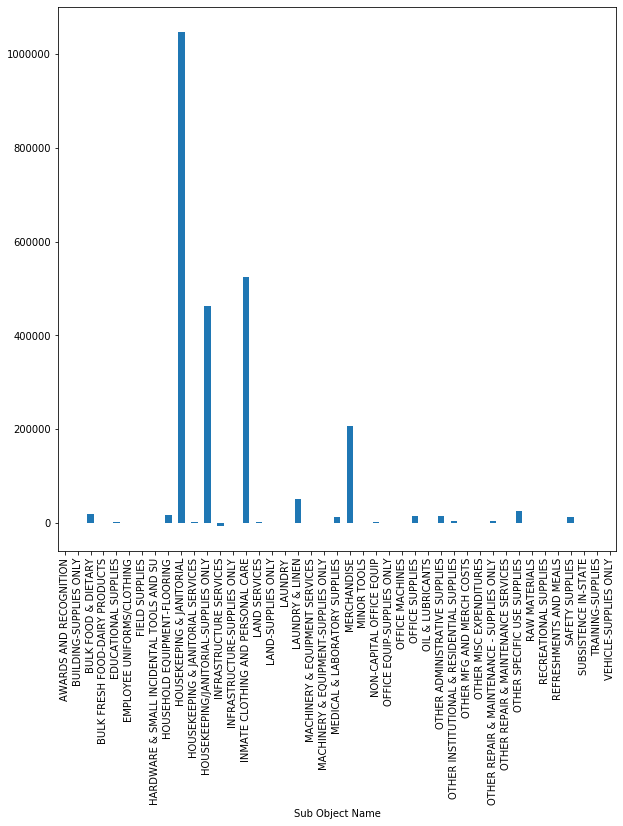

In [809]:
grouped_Brady_sub_2018 = fy2018[fy2018['Vendor Name'] == 'BRADY INDUSTRIES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_Brady_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_Brady_sub_2018['Amount'].agg(np.sum)

Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN            224.31
BUILDING-SUPPLIES ONLY                           1356.24
BULK FOOD & DIETARY                             22112.00
BULK FRESH FOOD-DAIRY PRODUCTS                      0.00
CONSERVATION SUPPLIES - CHEMICAL                  142.31
FURNITURE                                         484.94
HARDWARE & SMALL INCIDENTAL TOOLS AND SU         1358.81
HOUSEHOLD APPLIANCES AND EQUIPMENT               4000.00
HOUSEKEEPING & JANITORIAL                     1078743.55
HOUSEKEEPING & JANITORIAL SERVICES               2652.34
HOUSEKEEPING/JANITORIAL-SUPPLIES ONLY          523805.23
INMATE CLOTHING AND PERSONAL CARE              499632.97
LAND SERVICES                                     571.20
LAND-SUPPLIES ONLY                                963.54
LAUNDRY & LINEN                                 62156.57
LODGING - OUT OF STATE                              0.00
MACHINERY & EQUIPMENT SERVICES                    502.62
MACHINERY & EQU

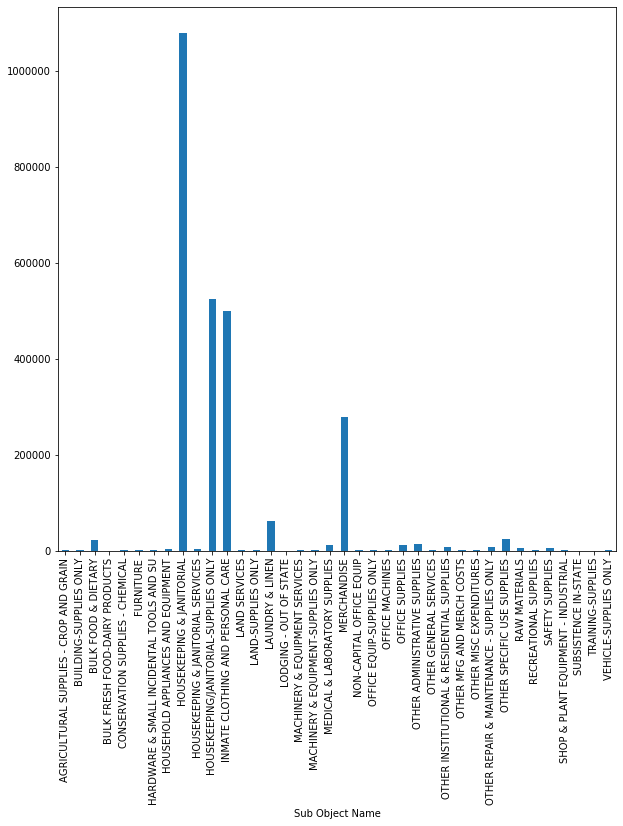

In [810]:
grouped_Brady_sub_2019 = fy2019[fy2019['Vendor Name'] == 'BRADY INDUSTRIES'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_Brady_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_Brady_sub_2019['Amount'].agg(np.sum)

In [811]:
grouped_Brady_sub_sum_2018 = grouped_Brady_sub_2018['Amount'].agg(np.sum)
grouped_Brady_sub_max_sum_2018 = grouped_Brady_sub_sum_2018.max()
grouped_Brady_sub_name_sum_2018 = grouped_Brady_sub_sum_2018.idxmax()
grouped_Brady_sub_name_sum_2018= grouped_Brady_sub_name_sum_2018.strip()

grouped_Brady_sub_sum_2019 = grouped_Brady_sub_2019['Amount'].agg(np.sum)
grouped_Brady_sub_max_sum_2019 = grouped_Brady_sub_sum_2019.max()
grouped_Brady_sub_name_sum_2019 = grouped_Brady_sub_sum_2019.idxmax()
grouped_Brady_sub_name_sum_2019 = grouped_Brady_sub_name_sum_2019.strip()

print("For 2018, " + grouped_Brady_sub_name_sum_2018 + " had the most expenditure for the total cost of Brady Industries at " + str(grouped_Brady_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_Brady_sub_name_sum_2019 + " had the most expenditure for the total cost of Brady Industries at " + str(grouped_Brady_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_Brady_sub_max_sum_2019 - grouped_Brady_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, HOUSEKEEPING & JANITORIAL had the most expenditure for the total cost of Brady Industries at 1048016.0700000003.
For 2019, HOUSEKEEPING & JANITORIAL had the most expenditure for the total cost of Brady Industries at 1078743.55.
The average increase/decrease was 30727.47999999975 between 2018 and 2019.


Sub Object Name
AWARDS AND RECOGNITION                           40.400000
BUILDING-SUPPLIES ONLY                           34.964167
BULK FOOD & DIETARY                             187.958846
BULK FRESH FOOD-DAIRY PRODUCTS                    0.000000
EDUCATIONAL SUPPLIES                            136.598000
EMPLOYEE UNIFORMS/CLOTHING                        5.770000
FIELD SUPPLIES                                  195.080000
HARDWARE & SMALL INCIDENTAL TOOLS AND SU         27.125000
HOUSEHOLD EQUIPMENT-FLOORING                   2217.896250
HOUSEKEEPING & JANITORIAL                      1874.805134
HOUSEKEEPING & JANITORIAL SERVICES              140.678000
HOUSEKEEPING/JANITORIAL-SUPPLIES ONLY           461.500060
INFRASTRUCTURE SERVICES                        -776.278750
INFRASTRUCTURE-SUPPLIES ONLY                     34.100000
INMATE CLOTHING AND PERSONAL CARE              3475.379603
LAND SERVICES                                   396.245000
LAND-SUPPLIES ONLY                      

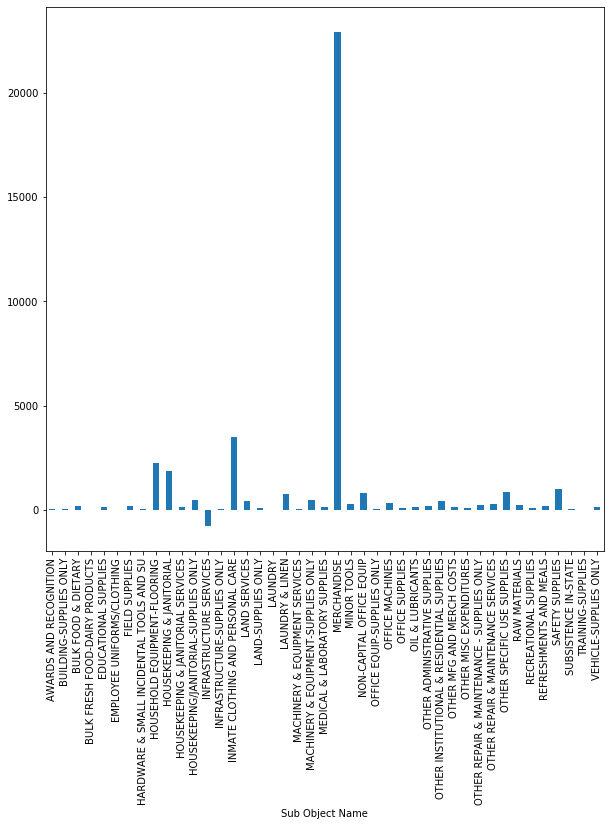

In [812]:
grouped_Brady_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_Brady_sub_2018['Amount'].agg(np.mean)

Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN          112.155000
BUILDING-SUPPLIES ONLY                           33.906000
BULK FOOD & DIETARY                             223.353535
BULK FRESH FOOD-DAIRY PRODUCTS                    0.000000
CONSERVATION SUPPLIES - CHEMICAL                142.310000
FURNITURE                                       484.940000
HARDWARE & SMALL INCIDENTAL TOOLS AND SU         41.176061
HOUSEHOLD APPLIANCES AND EQUIPMENT             4000.000000
HOUSEKEEPING & JANITORIAL                      1912.665869
HOUSEKEEPING & JANITORIAL SERVICES              102.013077
HOUSEKEEPING/JANITORIAL-SUPPLIES ONLY           472.322119
INMATE CLOTHING AND PERSONAL CARE              2806.926798
LAND SERVICES                                   190.400000
LAND-SUPPLIES ONLY                               96.354000
LAUNDRY & LINEN                                 654.279684
LODGING - OUT OF STATE                            0.000000
MACHINERY & EQUIPMENT SERVICES          

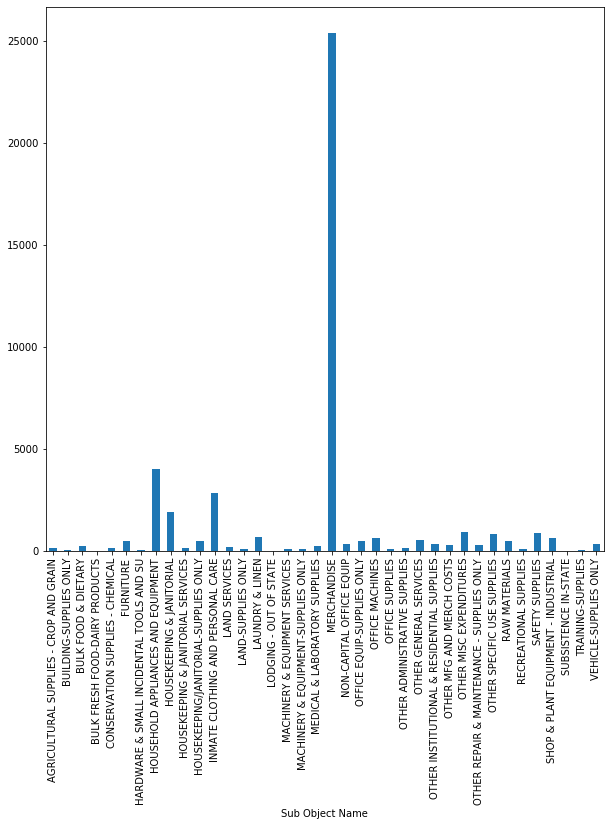

In [813]:
grouped_Brady_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_Brady_sub_2019['Amount'].agg(np.mean)

In [814]:
grouped_Brady_sub_mean_2018 = grouped_Brady_sub_2018['Amount'].agg(np.mean)
grouped_Brady_sub_max_mean_2018 = grouped_Brady_sub_mean_2018.max()
grouped_Brady_sub_name_mean_2018 = grouped_Brady_sub_mean_2018.idxmax()
grouped_Brady_sub_name_mean_2018= grouped_Brady_sub_name_mean_2018.strip()

grouped_Brady_sub_mean_2019 = grouped_Brady_sub_2019['Amount'].agg(np.mean)
grouped_Brady_sub_max_mean_2019 = grouped_Brady_sub_mean_2019.max()
grouped_Brady_sub_name_mean_2019 = grouped_Brady_sub_mean_2019.idxmax()
grouped_Brady_sub_name_mean_2019 = grouped_Brady_sub_name_mean_2019.strip()

print("For 2018, " + grouped_Brady_sub_name_mean_2018 + " had the most expenditure for the average cost of Brady Industries at " + str(grouped_Brady_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_Brady_sub_name_mean_2019 + " had the most expenditure for the average cost of Brady Industries at " + str(grouped_Brady_sub_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_Brady_sub_max_mean_2019 - grouped_Brady_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, MERCHANDISE had the most expenditure for the average cost of Brady Industries at 22947.38333333333.
For 2019, MERCHANDISE had the most expenditure for the average cost of Brady Industries at 25389.090909090908.
The average increase/decrease was 2441.7075757575767 between 2018 and 2019.


Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN      1655.70
AWARDS AND RECOGNITION                      2134.63
BUILDING SVCS                               1309.86
BUILDING-SUPPLIES ONLY                    149483.35
BULK FOOD & DIETARY                          597.96
                                            ...    
TRAINING-SUPPLIES                           1071.02
VEHICLE OPERATING COSTS                       30.58
VEHICLE SERVCS                              3805.40
VEHICLE-SUPPLIES ONLY                      38577.15
WATERCRAFT                                  2810.96
Name: Amount, Length: 62, dtype: float64

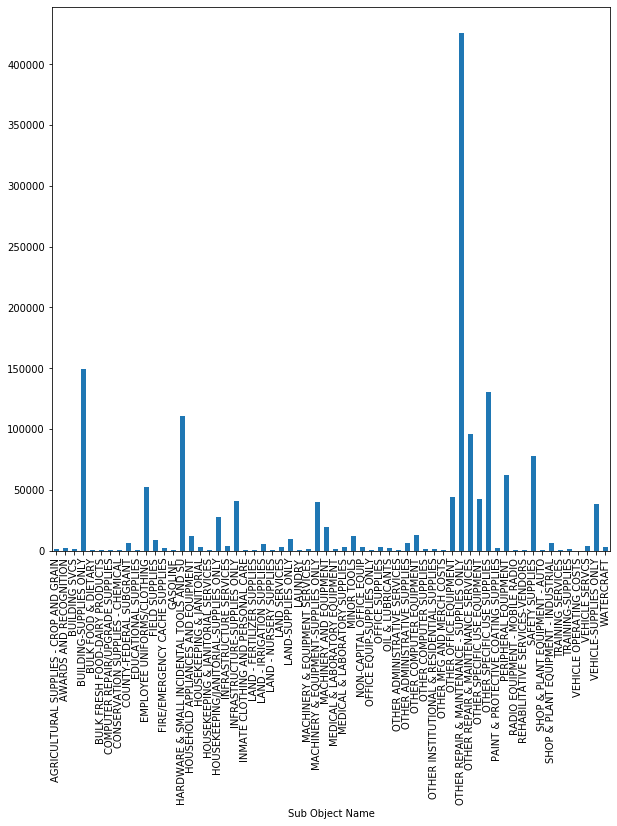

In [815]:
grouped_Grainger_sub_2018 = fy2018[fy2018['Vendor Name'] == 'WW GRAINGER INC'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_Grainger_sub_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_Grainger_sub_2018['Amount'].agg(np.sum)

Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN            58.24
BUILDING SVCS                                   1254.22
BUILDING-SUPPLIES ONLY                        139602.69
BULK FOOD & DIETARY                             2533.05
CONSERVATION SUPPLIES - CHEMICAL                 271.17
EDUCATIONAL SUPPLIES                             491.73
EMPLOYEE UNIFORMS/CLOTHING                      6811.24
FIELD SUPPLIES                                  2930.46
FIRE/EMERGENCY CACHE SUPPLIES                    150.78
FURNITURE                                      10109.73
HARDWARE & SMALL INCIDENTAL TOOLS AND SU      108914.83
HOUSEHOLD APPLIANCES AND EQUIPMENT              3246.38
HOUSEKEEPING & JANITORIAL                       3202.35
HOUSEKEEPING/JANITORIAL-SUPPLIES ONLY          19808.29
IMPROVEMENTS - 1099M REPORTABLE                  319.44
INFRASTRUCTURE SERVICES                         1475.30
INFRASTRUCTURE-SUPPLIES ONLY                    6379.79
INMATE CLOTHING AND PERSONAL CAR

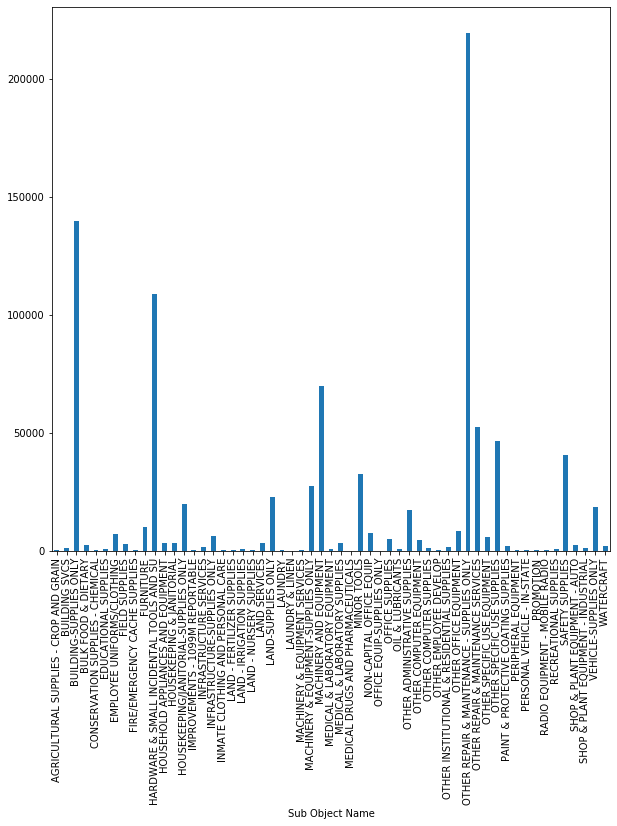

In [816]:
grouped_Grainger_sub_2019 = fy2019[fy2019['Vendor Name'] == 'WW GRAINGER INC'].groupby('Sub Object Name')
plt.xticks(rotation='vertical')
grouped_Grainger_sub_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_Grainger_sub_2019['Amount'].agg(np.sum)

In [817]:
grouped_Grainger_sub_sum_2018 = grouped_Grainger_sub_2018['Amount'].agg(np.sum)
grouped_Grainger_sub_max_sum_2018 = grouped_Grainger_sub_sum_2018.max()
grouped_Grainger_sub_name_sum_2018 = grouped_Grainger_sub_sum_2018.idxmax()
grouped_Grainger_sub_name_sum_2018= grouped_Grainger_sub_name_sum_2018.strip()

grouped_Grainger_sub_sum_2019 = grouped_Grainger_sub_2019['Amount'].agg(np.sum)
grouped_Grainger_sub_max_sum_2019 = grouped_Grainger_sub_sum_2019.max()
grouped_Grainger_sub_name_sum_2019 = grouped_Grainger_sub_sum_2019.idxmax()
grouped_Grainger_sub_name_sum_2019 = grouped_Grainger_sub_name_sum_2019.strip()

print("For 2018, " + grouped_Grainger_sub_name_sum_2018 + " had the most expenditure for the total cost of WW Grainger at " + str(grouped_Grainger_sub_max_sum_2018) + ".")
print("For 2019, " + grouped_Grainger_sub_name_sum_2019 + " had the most expenditure for the total cost of WW Grainger at " + str(grouped_Grainger_sub_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_Grainger_sub_max_sum_2019 - grouped_Grainger_sub_max_sum_2018) + " between 2018 and 2019.")

For 2018, OTHER REPAIR & MAINTENANCE - SUPPLIES ONLY had the most expenditure for the total cost of WW Grainger at 426006.65999999986.
For 2019, OTHER REPAIR & MAINTENANCE - SUPPLIES ONLY had the most expenditure for the total cost of WW Grainger at 219581.12.
The average increase/decrease was -206425.53999999986 between 2018 and 2019.


Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN    1655.700000
AWARDS AND RECOGNITION                     533.657500
BUILDING SVCS                              187.122857
BUILDING-SUPPLIES ONLY                     315.365717
BULK FOOD & DIETARY                         85.422857
                                             ...     
TRAINING-SUPPLIES                          214.204000
VEHICLE OPERATING COSTS                     30.580000
VEHICLE SERVCS                            1902.700000
VEHICLE-SUPPLIES ONLY                      344.438839
WATERCRAFT                                 936.986667
Name: Amount, Length: 62, dtype: float64

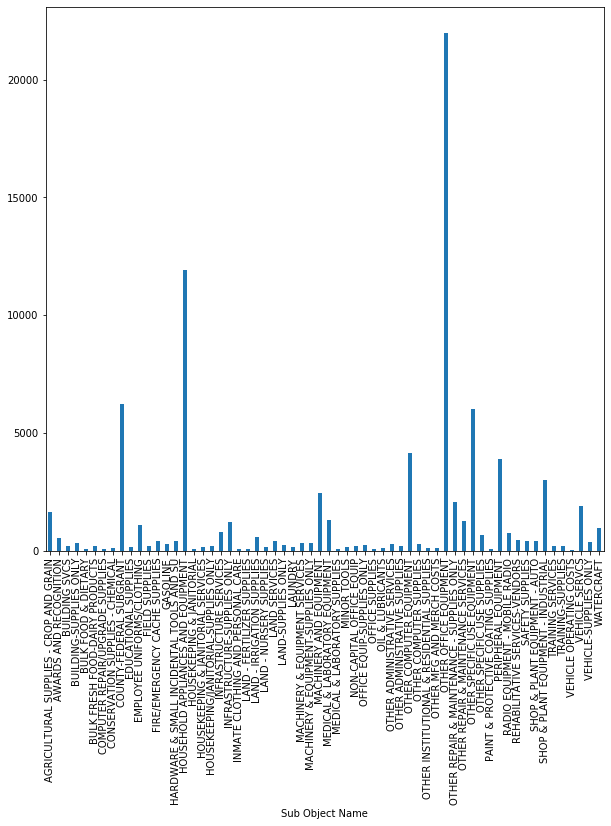

In [818]:
grouped_Grainger_sub_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_Grainger_sub_2018['Amount'].agg(np.mean)

Sub Object Name
AGRICULTURAL SUPPLIES - CROP AND GRAIN          58.240000
BUILDING SVCS                                  139.357778
BUILDING-SUPPLIES ONLY                         393.247014
BULK FOOD & DIETARY                            316.631250
CONSERVATION SUPPLIES - CHEMICAL                90.390000
EDUCATIONAL SUPPLIES                           163.910000
EMPLOYEE UNIFORMS/CLOTHING                     200.330588
FIELD SUPPLIES                                  94.530968
FIRE/EMERGENCY CACHE SUPPLIES                  150.780000
FURNITURE                                     3369.910000
HARDWARE & SMALL INCIDENTAL TOOLS AND SU       475.610611
HOUSEHOLD APPLIANCES AND EQUIPMENT            3246.380000
HOUSEKEEPING & JANITORIAL                       84.272368
HOUSEKEEPING/JANITORIAL-SUPPLIES ONLY          250.737848
IMPROVEMENTS - 1099M REPORTABLE                319.440000
INFRASTRUCTURE SERVICES                        737.650000
INFRASTRUCTURE-SUPPLIES ONLY                   425.31933

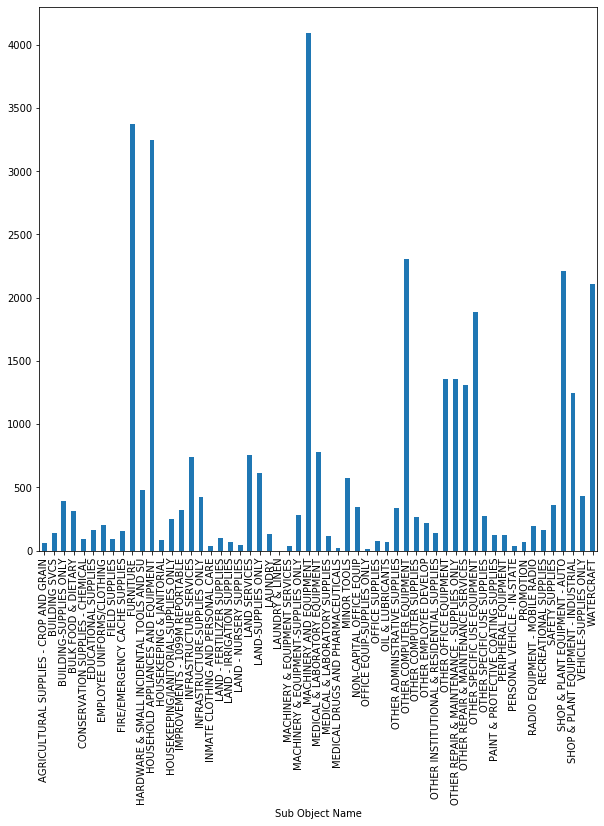

In [819]:
grouped_Grainger_sub_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_Grainger_sub_2019['Amount'].agg(np.mean)

In [820]:
grouped_Grainger_sub_mean_2018 = grouped_Grainger_sub_2018['Amount'].agg(np.mean)
grouped_Grainger_sub_max_mean_2018 = grouped_Grainger_sub_mean_2018.max()
grouped_Grainger_sub_name_mean_2018 = grouped_Grainger_sub_mean_2018.idxmax()
grouped_Grainger_sub_name_mean_2018= grouped_Grainger_sub_name_mean_2018.strip()

grouped_Grainger_sub_mean_2019 = grouped_Grainger_sub_2019['Amount'].agg(np.mean)
grouped_Grainger_sub_max_mean_2019 = grouped_Grainger_sub_mean_2019.max()
grouped_Grainger_sub_name_mean_2019 = grouped_Grainger_sub_mean_2019.idxmax()
grouped_Grainger_sub_name_mean_2019 = grouped_Grainger_sub_name_mean_2019.strip()

print("For 2018, " + grouped_Grainger_sub_name_mean_2018 + " had the most expenditure for the total cost of WW Grainger at " + str(grouped_Grainger_sub_max_mean_2018) + ".")
print("For 2019, " + grouped_Grainger_sub_name_mean_2019 + " had the most expenditure for the total cost of WW Grainger at " + str(grouped_Grainger_sub_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_Grainger_sub_max_mean_2019 - grouped_Grainger_sub_max_mean_2018) + " between 2018 and 2019.")

For 2018, OTHER OFFICE EQUIPMENT had the most expenditure for the total cost of WW Grainger at 21982.35.
For 2019, MACHINERY AND EQUIPMENT had the most expenditure for the total cost of WW Grainger at 4094.8964705882354.


**Question 5** (15 points)<br/>
Identify areas of potential increased efficiencies and subsequent potential cost savings that could be realized. I want you to at least investigate health care costs and travel costs and one more of your choosing. On travel try to identify if acquiring statewide contracts outside of current existing contracts (ie for out of state flights or hotels) would be useful. Investigate other cost savings options as you see fit. Use visualizations as appropriate.

In [821]:
# Explore Health Care Costs

In [822]:
grouped_group_insur_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'GROUP INSURANCE HEALTH & ACCIDENT'].groupby('Vendor Name')

In [823]:
grouped_group_insur_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'GROUP INSURANCE HEALTH & ACCIDENT'].groupby('Vendor Name')

In [824]:
grouped_group_insur_vendor_sum_2018 = grouped_group_insur_vendor_2018['Amount'].agg(np.sum)
grouped_group_insur_vendor_max_sum_2018 = grouped_group_insur_vendor_sum_2018.max()
grouped_group_insur_vendor_name_sum_2018 = grouped_group_insur_vendor_sum_2018.idxmax()
grouped_group_insur_vendor_name_sum_2018= grouped_group_insur_vendor_name_sum_2018.strip()

grouped_group_insur_vendor_sum_2019 = grouped_group_insur_vendor_2019['Amount'].agg(np.sum)
grouped_group_insur_vendor_max_sum_2019 = grouped_group_insur_vendor_sum_2019.max()
grouped_group_insur_vendor_name_sum_2019 = grouped_group_insur_vendor_sum_2019.idxmax()
grouped_group_insur_vendor_name_sum_2019 = grouped_group_insur_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_group_insur_vendor_name_sum_2018 + " had the most expenditure for the total cost of Group Insuramce Health & Accident at " + str(grouped_group_insur_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_group_insur_vendor_name_sum_2019 + " had the most expenditure for the total cost of Group Insuramce Health & Accident at " + str(grouped_group_insur_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_group_insur_vendor_max_sum_2019 - grouped_group_insur_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, REDACTED had the most expenditure for the total cost of Group Insuramce Health & Accident at 10436211.84.
For 2019, REDACTED had the most expenditure for the total cost of Group Insuramce Health & Accident at 11199869.02000001.
The average increase/decrease was 763657.1800000109 between 2018 and 2019.


In [825]:
grouped_group_insur_vendor_mean_2018 = grouped_group_insur_vendor_2018['Amount'].agg(np.mean)
grouped_group_insur_vendor_max_mean_2018 = grouped_group_insur_vendor_mean_2018.max()
grouped_group_insur_vendor_name_mean_2018 = grouped_group_insur_vendor_mean_2018.idxmax()
grouped_group_insur_vendor_name_mean_2018= grouped_group_insur_vendor_name_mean_2018.strip()

grouped_group_insur_vendor_mean_2019 = grouped_group_insur_vendor_2019['Amount'].agg(np.mean)
grouped_group_insur_vendor_max_mean_2019 = grouped_group_insur_vendor_mean_2019.max()
grouped_group_insur_vendor_name_mean_2019 = grouped_group_insur_vendor_mean_2019.idxmax()
grouped_group_insur_vendor_name_mean_2019 = grouped_group_insur_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_group_insur_vendor_name_mean_2018 + " had the most expenditure for the average cost of Group Insuramce Health & Accident at " + str(grouped_group_insur_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_group_insur_vendor_name_mean_2019 + " had the most expenditure for the average cost of Group Insuramce Health & Accident at " + str(grouped_group_insur_vendor_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_group_insur_vendor_max_mean_2019 - grouped_group_insur_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, REDACTED had the most expenditure for the average cost of Group Insuramce Health & Accident at 57028.479999999996.
For 2019, REDACTED had the most expenditure for the average cost of Group Insuramce Health & Accident at 62569.10067039112.
The average increase/decrease was 5540.620670391123 between 2018 and 2019.


Agency Name
ADMINISTRATION, DEPARTMENT OF                         3.156563e+08
AGING, COMMISSION ON                                  2.329632e+04
AGRICULTURE, DEPARTMENT OF                            3.932807e+06
ARTS, IDAHO COMMISSION ON THE                         5.400000e+03
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE       2.779406e+05
BRAND INSPECTOR, STATE                                5.761000e+01
CATASTROPHIC HEALTH CARE                              1.971449e+07
COMMERCE, DEPARTMENT OF                               1.904667e+05
CONSERVATION, OFFICE OF SPECIES                       1.034390e+07
CORRECTION, DEPARTMENT OF                             1.107000e+02
EDUCATION, STATE BOARD OF                             6.341477e+07
EDUCATION, STATE DEPARTMENT OF                        2.029250e+05
FISH AND GAME, DEPARTMENT OF                          1.718746e+06
HEALTH AND WELFARE, DEPARTMENT OF                     6.952861e+07
HEALTH DISTRICT 1 (PANHANDLE)                     

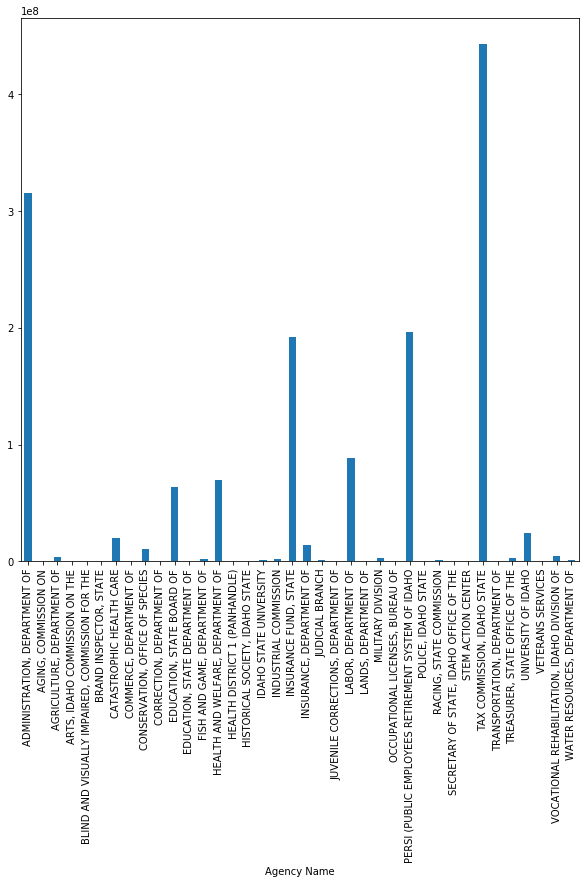

In [826]:
grouped_redacted_agency_2018 = fy2018[fy2018['Vendor Name'] == 'REDACTED'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_redacted_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_redacted_agency_2018['Amount'].agg(np.sum)

Agency Name
ADMINISTRATION, DEPARTMENT OF                         2.943530e+08
AGING, COMMISSION ON                                  3.950000e+02
AGRICULTURE, DEPARTMENT OF                            4.789377e+06
ATTORNEY GENERAL, OFFICE OF THE                       1.425000e+02
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE       2.704340e+05
BRAND INSPECTOR, STATE                                6.882000e+01
CATASTROPHIC HEALTH CARE                              1.728959e+07
COMMERCE, DEPARTMENT OF                               1.032884e+05
CONSERVATION, OFFICE OF SPECIES                       6.160544e+06
DRUG POLICY, OFFICE OF                                1.786200e+03
EDUCATION, STATE BOARD OF                             6.990612e+07
EDUCATION, STATE DEPARTMENT OF                        1.472850e+05
ENVIRONMENTAL QUALITY, DEPARTMENT OF                  8.139000e+05
FISH AND GAME, DEPARTMENT OF                          2.947882e+06
HEALTH AND WELFARE, DEPARTMENT OF                 

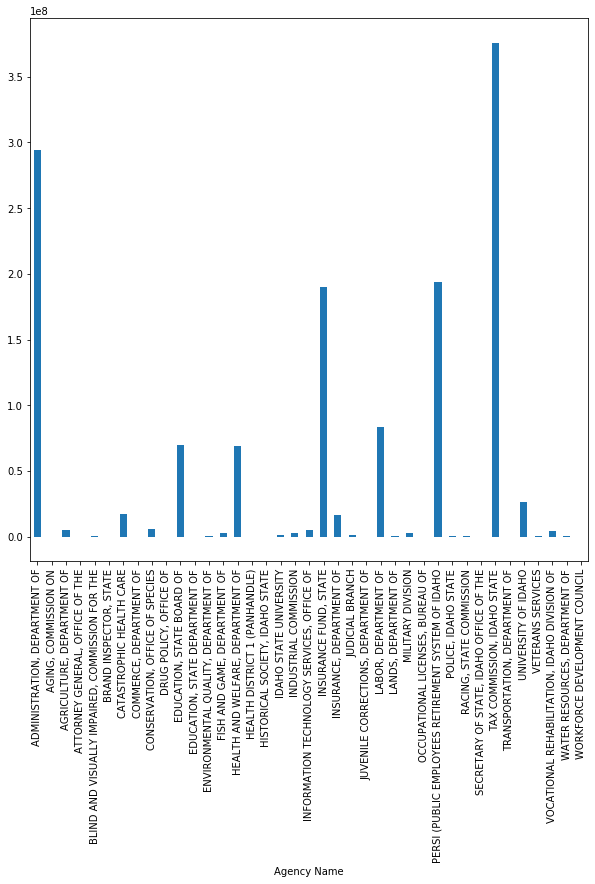

In [827]:
grouped_redacted_agency_2019 = fy2019[fy2019['Vendor Name'] == 'REDACTED'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_redacted_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_redacted_agency_2019['Amount'].agg(np.sum)

In [828]:
grouped_redacted_agency_sum_2018 = grouped_redacted_agency_2018['Amount'].agg(np.sum)
grouped_redacted_agency_max_sum_2018 = grouped_redacted_agency_sum_2018.max()
grouped_redacted_agency_name_sum_2018 = grouped_redacted_agency_sum_2018.idxmax()
grouped_redacted_agency_name_sum_2018= grouped_redacted_agency_name_sum_2018.strip()

grouped_redacted_agency_sum_2019 = grouped_redacted_agency_2019['Amount'].agg(np.sum)
grouped_redacted_agency_max_sum_2019 = grouped_redacted_agency_sum_2019.max()
grouped_redacted_agency_name_sum_2019 = grouped_redacted_agency_sum_2019.idxmax()
grouped_redacted_agency_name_sum_2019 = grouped_redacted_agency_name_sum_2019.strip()

print("For 2018, " + grouped_redacted_agency_name_sum_2018 + " had the most expenditure for the total cost of Group Insuramce Health & Accident from Redacted at " + str(grouped_redacted_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_redacted_agency_name_sum_2019 + " had the most expenditure for the total cost of Group Insuramce Health & Accident from Redacted at " + str(grouped_redacted_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_redacted_agency_max_sum_2019 - grouped_redacted_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, TAX COMMISSION, IDAHO STATE had the most expenditure for the total cost of Group Insuramce Health & Accident from Redacted at 443450195.27000004.
For 2019, TAX COMMISSION, IDAHO STATE had the most expenditure for the total cost of Group Insuramce Health & Accident from Redacted at 376063656.3400001.
The average increase/decrease was -67386538.92999995 between 2018 and 2019.


Agency Name
ADMINISTRATION, DEPARTMENT OF                         5.140981e+05
AGING, COMMISSION ON                                  4.659264e+03
AGRICULTURE, DEPARTMENT OF                            4.855318e+04
ARTS, IDAHO COMMISSION ON THE                         9.000000e+02
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE       1.440106e+03
BRAND INSPECTOR, STATE                                2.880500e+01
CATASTROPHIC HEALTH CARE                              2.011683e+05
COMMERCE, DEPARTMENT OF                               7.618668e+03
CONSERVATION, OFFICE OF SPECIES                       1.723984e+05
CORRECTION, DEPARTMENT OF                             1.107000e+02
EDUCATION, STATE BOARD OF                             1.243427e+06
EDUCATION, STATE DEPARTMENT OF                        2.029250e+04
FISH AND GAME, DEPARTMENT OF                          2.410584e+03
HEALTH AND WELFARE, DEPARTMENT OF                     3.418319e+04
HEALTH DISTRICT 1 (PANHANDLE)                     

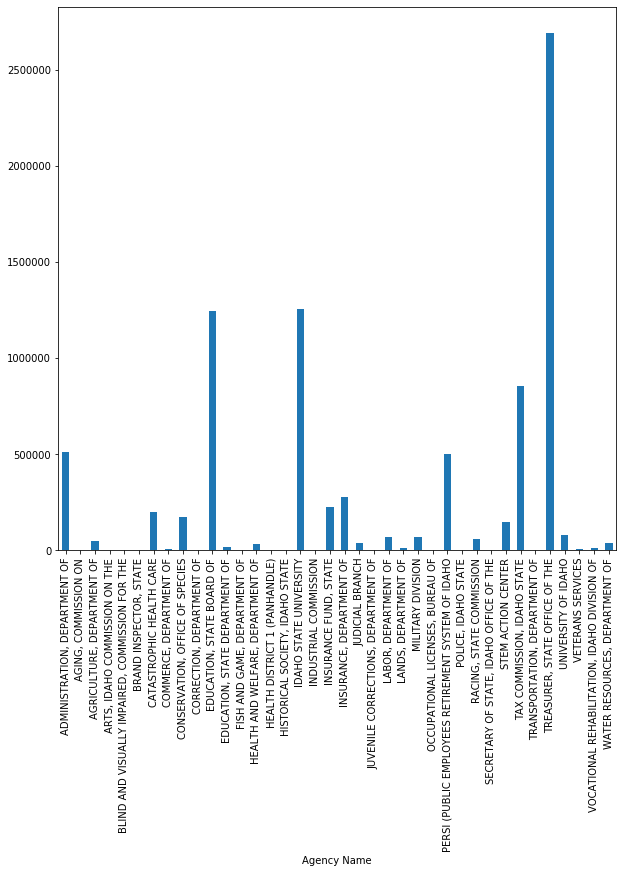

In [829]:
grouped_redacted_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_redacted_agency_2018['Amount'].agg(np.mean)

Agency Name
ADMINISTRATION, DEPARTMENT OF                         6.570380e+05
AGING, COMMISSION ON                                  3.950000e+02
AGRICULTURE, DEPARTMENT OF                            9.390935e+04
ATTORNEY GENERAL, OFFICE OF THE                       7.125000e+01
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE       1.365828e+03
BRAND INSPECTOR, STATE                                1.720500e+01
CATASTROPHIC HEALTH CARE                              1.600888e+05
COMMERCE, DEPARTMENT OF                               5.436233e+03
CONSERVATION, OFFICE OF SPECIES                       1.665012e+05
DRUG POLICY, OFFICE OF                                1.786200e+03
EDUCATION, STATE BOARD OF                             9.986589e+05
EDUCATION, STATE DEPARTMENT OF                        8.182500e+03
ENVIRONMENTAL QUALITY, DEPARTMENT OF                  7.399091e+04
FISH AND GAME, DEPARTMENT OF                          4.181392e+03
HEALTH AND WELFARE, DEPARTMENT OF                 

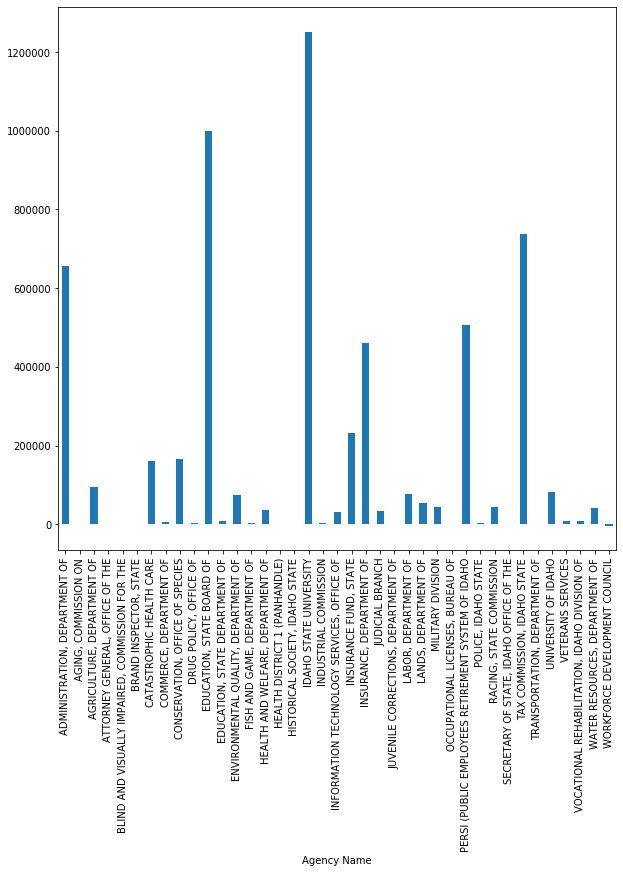

In [830]:
grouped_redacted_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_redacted_agency_2019['Amount'].agg(np.mean)

In [831]:
grouped_redacted_agency_mean_2018 = grouped_redacted_agency_2018['Amount'].agg(np.mean)
grouped_redacted_agency_max_mean_2018 = grouped_redacted_agency_mean_2018.max()
grouped_redacted_agency_name_mean_2018 = grouped_redacted_agency_mean_2018.idxmax()
grouped_redacted_agency_name_mean_2018= grouped_redacted_agency_name_mean_2018.strip()

grouped_redacted_agency_mean_2019 = grouped_redacted_agency_2019['Amount'].agg(np.mean)
grouped_redacted_agency_max_mean_2019 = grouped_redacted_agency_mean_2019.max()
grouped_redacted_agency_name_mean_2019 = grouped_redacted_agency_mean_2019.idxmax()
grouped_redacted_agency_name_mean_2019 = grouped_redacted_agency_name_mean_2019.strip()

print("For 2018, " + grouped_redacted_agency_name_mean_2018 + " had the most expenditure for the average cost of Group Insuramce Health & Accident from Redacted at " + str(grouped_redacted_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_redacted_agency_name_mean_2019 + " had the most expenditure for the average cost of Group Insuramce Health & Accident from Redacted at " + str(grouped_redacted_agency_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_redacted_agency_max_mean_2019 - grouped_redacted_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, TREASURER, STATE OFFICE OF THE had the most expenditure for the average cost of Group Insuramce Health & Accident from Redacted at 2691500.0.
For 2019, IDAHO STATE UNIVERSITY had the most expenditure for the average cost of Group Insuramce Health & Accident from Redacted at 1252369.0.


Summary Object Name
ADMINISTRATIVE SUPPLIES      -8.614000e+01
AWARDS CONTR & CLAIMS         6.569740e+08
COMMUNICATION COSTS           2.491460e+03
COMPUTER SERVICES             3.055700e+02
COMPUTER SUPPLIES             1.414100e+02
EDUC & TRAIN ASSISTANCE       2.499371e+07
EMPLOYEE BENEFITS             1.085387e+07
EMPLOYEE DEVELOPMENT COSTS   -6.109500e+02
EMPLOYEE TRAVEL COSTS         1.767450e+03
FUEL & LUBRICANTS COSTS       1.252690e+03
GENERAL SERVICES              2.076961e+06
GROSS SALARY & WAGE           2.691622e+05
INSURANCE                     5.093800e+02
MISC EXPENDITURES             2.441849e+05
MISC PMTS AS AGENT            5.533465e+08
PENSION PAYMENTS              1.969358e+08
PROFESSIONAL SERVICES         1.708685e+07
RENTALS & OPER LEASES         7.997760e+03
REPAIR & MAINT SUPPLIES      -7.753100e+02
REPAIR & MAINT SVCS          -6.760900e+02
SPECIFIC USE EQUIPMENT        1.300000e+03
SPECIFIC USE SUPPLIES         1.256840e+03
UTILITY CHARGES               2.24

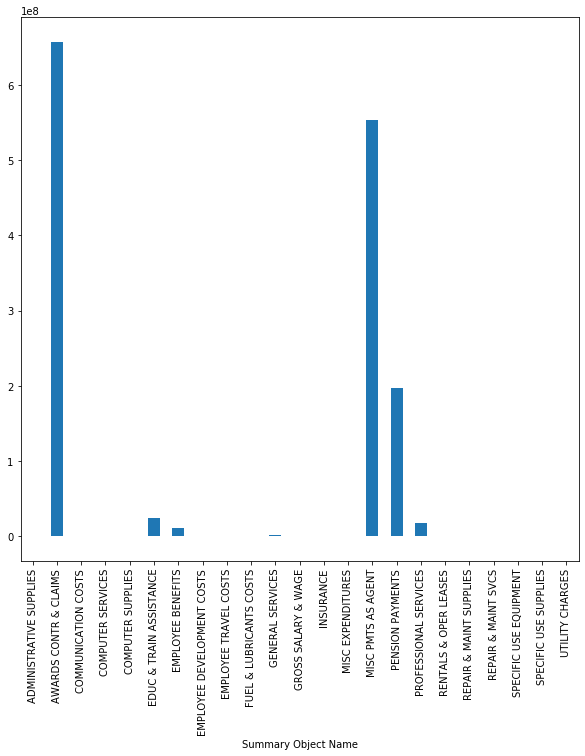

In [832]:
grouped_redacted_summary_2018 = fy2018[fy2018['Vendor Name'] == 'REDACTED'].groupby('Summary Object Name')
plt.xticks(rotation='vertical')
grouped_redacted_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_redacted_summary_2018['Amount'].agg(np.sum)

Summary Object Name
ADMINISTRATIVE SUPPLIES      -8.330700e+02
AWARDS CONTR & CLAIMS         6.365465e+08
COMMUNICATION COSTS           2.892190e+03
COMPUTER SERVICES             6.495500e+02
COMPUTER SUPPLIES             4.969160e+03
EDUC & TRAIN ASSISTANCE       2.604097e+07
EMPLOYEE BENEFITS             1.161923e+07
EMPLOYEE DEVELOPMENT COSTS    1.540000e+03
EMPLOYEE TRAVEL COSTS         1.088298e+04
FUEL & LUBRICANTS COSTS       2.863320e+03
GENERAL SERVICES              1.135421e+06
GROSS SALARY & WAGE           2.938990e+05
INST & RESIDENT SUPPLIES      8.060800e+02
INSURANCE                     4.674400e+02
MISC EXPENDITURES             2.195159e+05
MISC PMTS AS AGENT            4.851107e+08
PENSION PAYMENTS              1.944441e+08
PROFESSIONAL SERVICES         1.687539e+07
RENTALS & OPER LEASES         7.992980e+03
REPAIR & MAINT SUPPLIES       2.197750e+03
REPAIR & MAINT SVCS           7.742700e+02
SPECIFIC USE SUPPLIES         1.434250e+03
UTILITY CHARGES               1.87

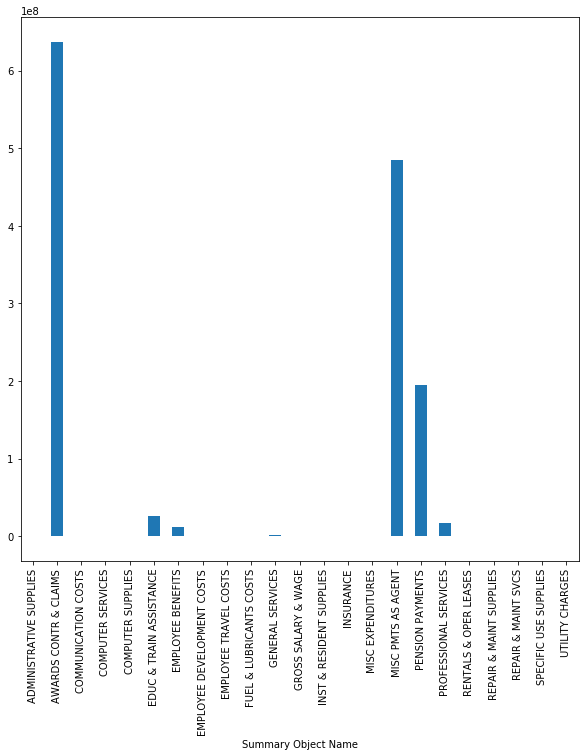

In [833]:
grouped_redacted_summary_2019 = fy2019[fy2019['Vendor Name'] == 'REDACTED'].groupby('Summary Object Name')
plt.xticks(rotation='vertical')
grouped_redacted_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_redacted_summary_2019['Amount'].agg(np.sum)

In [834]:
grouped_redacted_summary_sum_2018 = grouped_redacted_summary_2018['Amount'].agg(np.sum)
grouped_redacted_summary_max_sum_2018 = grouped_redacted_summary_sum_2018.max()
grouped_redacted_summary_name_sum_2018 = grouped_redacted_summary_sum_2018.idxmax()
grouped_redacted_summary_name_sum_2018= grouped_redacted_summary_name_sum_2018.strip()

grouped_redacted_summary_sum_2019 = grouped_redacted_summary_2019['Amount'].agg(np.sum)
grouped_redacted_summary_max_sum_2019 = grouped_redacted_summary_sum_2019.max()
grouped_redacted_summary_name_sum_2019 = grouped_redacted_summary_sum_2019.idxmax()
grouped_redacted_summary_name_sum_2019 = grouped_redacted_summary_name_sum_2019.strip()

print("For 2018, " + grouped_redacted_summary_name_sum_2018 + " had the most expenditure for the total cost of Group Insuramce Health & Accident from Redacted at " + str(grouped_redacted_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_redacted_summary_name_sum_2019 + " had the most expenditure for the total cost of Group Insuramce Health & Accident from Redacted at " + str(grouped_redacted_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_redacted_summary_max_sum_2019 - grouped_redacted_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, AWARDS CONTR & CLAIMS had the most expenditure for the total cost of Group Insuramce Health & Accident from Redacted at 656973960.2699986.
For 2019, AWARDS CONTR & CLAIMS had the most expenditure for the total cost of Group Insuramce Health & Accident from Redacted at 636546466.280002.
The average increase/decrease was -20427493.989996552 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SUPPLIES           -3.445600
AWARDS CONTR & CLAIMS         153069.422244
COMMUNICATION COSTS               51.905417
COMPUTER SERVICES                 43.652857
COMPUTER SUPPLIES                 35.352500
EDUC & TRAIN ASSISTANCE        27495.832332
EMPLOYEE BENEFITS              21240.457730
EMPLOYEE DEVELOPMENT COSTS       -46.996154
EMPLOYEE TRAVEL COSTS             19.211413
FUEL & LUBRICANTS COSTS          104.390833
GENERAL SERVICES               25962.006875
GROSS SALARY & WAGE             5078.532642
INSURANCE                        127.345000
MISC EXPENDITURES                540.232058
MISC PMTS AS AGENT            321152.928683
PENSION PAYMENTS              432826.027055
PROFESSIONAL SERVICES         177988.056250
RENTALS & OPER LEASES            727.069091
REPAIR & MAINT SUPPLIES          -55.379286
REPAIR & MAINT SVCS              -84.511250
SPECIFIC USE EQUIPMENT           650.000000
SPECIFIC USE SUPPLIES             33.968649
UTILITY CHAR

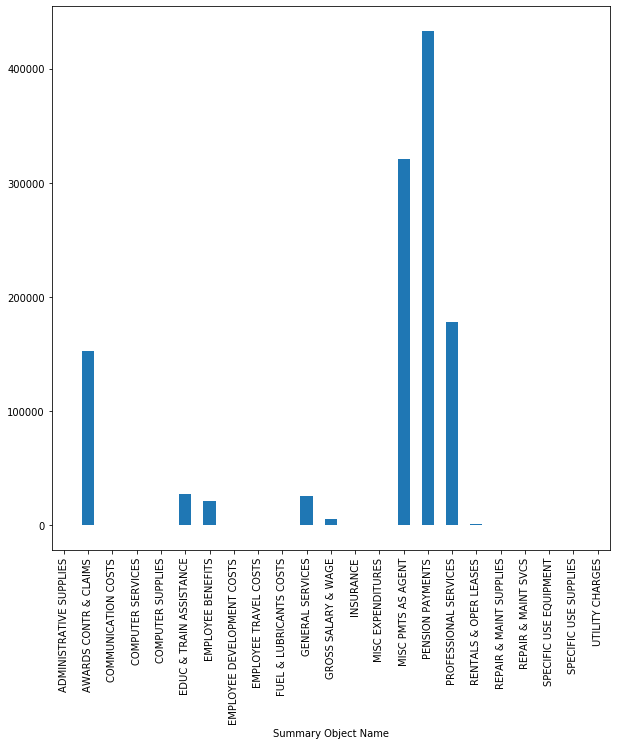

In [835]:
grouped_redacted_summary_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_redacted_summary_2018['Amount'].agg(np.mean)

Summary Object Name
ADMINISTRATIVE SUPPLIES          -49.004118
AWARDS CONTR & CLAIMS         148795.340411
COMMUNICATION COSTS               76.110263
COMPUTER SERVICES                 92.792857
COMPUTER SUPPLIES                621.145000
EDUC & TRAIN ASSISTANCE        28998.851982
EMPLOYEE BENEFITS              22782.805824
EMPLOYEE DEVELOPMENT COSTS       140.000000
EMPLOYEE TRAVEL COSTS             93.016923
FUEL & LUBRICANTS COSTS          168.430588
GENERAL SERVICES               16455.375507
GROSS SALARY & WAGE             5156.121930
INST & RESIDENT SUPPLIES         806.080000
INSURANCE                         93.488000
MISC EXPENDITURES                618.354535
MISC PMTS AS AGENT            321052.767161
PENSION PAYMENTS              431139.974479
PROFESSIONAL SERVICES         165445.007843
RENTALS & OPER LEASES            499.561250
REPAIR & MAINT SUPPLIES          219.775000
REPAIR & MAINT SVCS               77.427000
SPECIFIC USE SUPPLIES             43.462121
UTILITY CHAR

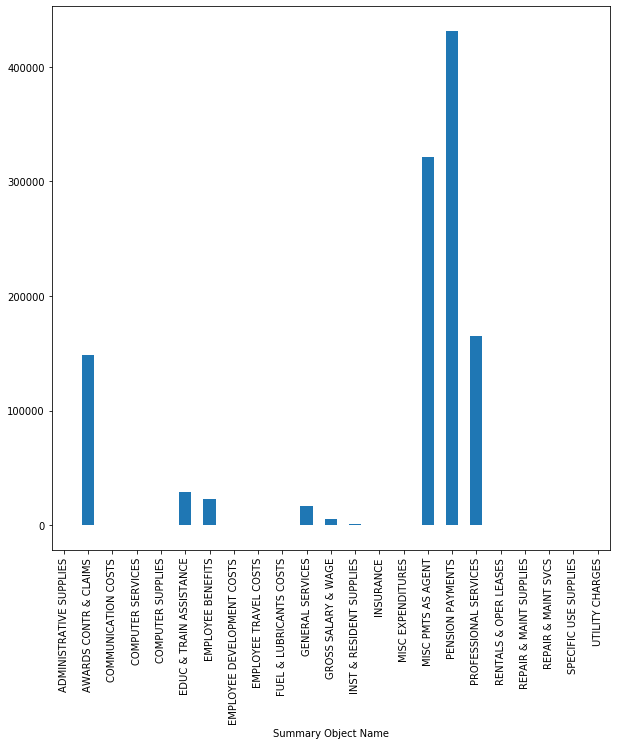

In [836]:
grouped_redacted_summary_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_redacted_summary_2019['Amount'].agg(np.mean)

In [837]:
grouped_redacted_summary_mean_2018 = grouped_redacted_summary_2018['Amount'].agg(np.mean)
grouped_redacted_summary_max_mean_2018 = grouped_redacted_summary_mean_2018.max()
grouped_redacted_summary_name_mean_2018 = grouped_redacted_summary_mean_2018.idxmax()
grouped_redacted_summary_name_mean_2018= grouped_redacted_summary_name_mean_2018.strip()

grouped_redacted_summary_mean_2019 = grouped_redacted_summary_2019['Amount'].agg(np.mean)
grouped_redacted_summary_max_mean_2019 = grouped_redacted_summary_mean_2019.max()
grouped_redacted_summary_name_mean_2019 = grouped_redacted_summary_mean_2019.idxmax()
grouped_redacted_summary_name_mean_2019 = grouped_redacted_summary_name_mean_2019.strip()

print("For 2018, " + grouped_redacted_summary_name_mean_2018 + " had the most expenditure for the average cost of Group Insuramce Health & Accident from Redacted at " + str(grouped_redacted_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_redacted_summary_name_mean_2019 + " had the most expenditure for the average cost of Group Insuramce Health & Accident from Redacted at " + str(grouped_redacted_summary_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_redacted_summary_max_mean_2019 - grouped_redacted_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, PENSION PAYMENTS had the most expenditure for the average cost of Group Insuramce Health & Accident from Redacted at 432826.0270549454.
For 2019, PENSION PAYMENTS had the most expenditure for the average cost of Group Insuramce Health & Accident from Redacted at 431139.9744789358.
The average increase/decrease was -1686.0525760095916 between 2018 and 2019.


In [838]:
grouped_medical_supplies_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'MEDICAL & LABORATORY SUPPLIES'].groupby('Vendor Name')

In [839]:
grouped_medical_supplies_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'MEDICAL & LABORATORY SUPPLIES'].groupby('Vendor Name')

In [840]:
grouped_medical_supplies_vendor_sum_2018 = grouped_medical_supplies_vendor_2018['Amount'].agg(np.sum)
grouped_medical_supplies_vendor_max_sum_2018 = grouped_medical_supplies_vendor_sum_2018.max()
grouped_medical_supplies_vendor_name_sum_2018 = grouped_medical_supplies_vendor_sum_2018.idxmax()
grouped_medical_supplies_vendor_name_sum_2018= grouped_medical_supplies_vendor_name_sum_2018.strip()

grouped_medical_supplies_vendor_sum_2019 = grouped_medical_supplies_vendor_2019['Amount'].agg(np.sum)
grouped_medical_supplies_vendor_max_sum_2019 = grouped_medical_supplies_vendor_sum_2019.max()
grouped_medical_supplies_vendor_name_sum_2019 = grouped_medical_supplies_vendor_sum_2019.idxmax()
grouped_medical_supplies_vendor_name_sum_2019 = grouped_medical_supplies_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_medical_supplies_vendor_name_sum_2018 + " had the most expenditure for the total cost of Medical and Laboratory Supplies at " + str(grouped_medical_supplies_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_medical_supplies_vendor_name_sum_2019 + " had the most expenditure for the total cost of Medical and Laboratory Supplies at " + str(grouped_medical_supplies_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_medical_supplies_vendor_max_sum_2019 - grouped_medical_supplies_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, MAGELLAN RX MANAGEMENT INC had the most expenditure for the total cost of Medical and Laboratory Supplies at 6277308.819999999.
For 2019, MAGELLAN RX MANAGEMENT INC had the most expenditure for the total cost of Medical and Laboratory Supplies at 6892943.59.
The average increase/decrease was 615634.7700000005 between 2018 and 2019.


In [841]:
grouped_medical_supplies_vendor_mean_2018 = grouped_medical_supplies_vendor_2018['Amount'].agg(np.mean)
grouped_medical_supplies_vendor_max_mean_2018 = grouped_medical_supplies_vendor_mean_2018.max()
grouped_medical_supplies_vendor_name_mean_2018 = grouped_medical_supplies_vendor_mean_2018.idxmax()
grouped_medical_supplies_vendor_name_mean_2018= grouped_medical_supplies_vendor_name_mean_2018.strip()

grouped_medical_supplies_vendor_mean_2019 = grouped_medical_supplies_vendor_2019['Amount'].agg(np.mean)
grouped_medical_supplies_vendor_max_mean_2019 = grouped_medical_supplies_vendor_mean_2019.max()
grouped_medical_supplies_vendor_name_mean_2019 = grouped_medical_supplies_vendor_mean_2019.idxmax()
grouped_medical_supplies_vendor_name_mean_2019 = grouped_medical_supplies_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_medical_supplies_vendor_name_mean_2018 + " had the most expenditure for the average cost of Medical and Laboratory Supplies at " + str(grouped_medical_supplies_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_medical_supplies_vendor_name_mean_2019 + " had the most expenditure for the average cost of Medical and Laboratory Supplies at " + str(grouped_medical_supplies_vendor_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_medical_supplies_vendor_max_mean_2019 - grouped_medical_supplies_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, MAGELLAN RX MANAGEMENT INC had the most expenditure for the average cost of Medical and Laboratory Supplies at 209243.6273333333.
For 2019, MAGELLAN RX MANAGEMENT INC had the most expenditure for the average cost of Medical and Laboratory Supplies at 255294.20703703703.
The average increase/decrease was 46050.57970370373 between 2018 and 2019.


Agency Name
HEALTH AND WELFARE, DEPARTMENT OF    6531739.54
Name: Amount, dtype: float64

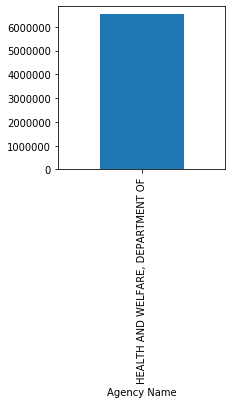

In [842]:
grouped_medical_supplies_agency_2018 = fy2018[fy2018['Vendor Name'] == 'MAGELLAN RX MANAGEMENT INC'].groupby('Agency Name')
grouped_medical_supplies_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_medical_supplies_agency_2018['Amount'].agg(np.sum)

Agency Name
HEALTH AND WELFARE, DEPARTMENT OF    7274964.53
Name: Amount, dtype: float64

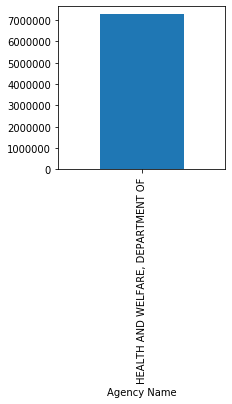

In [843]:
grouped_medical_supplies_agency_2019 = fy2019[fy2019['Vendor Name'] == 'MAGELLAN RX MANAGEMENT INC'].groupby('Agency Name')
grouped_medical_supplies_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_medical_supplies_agency_2019['Amount'].agg(np.sum)

In [844]:
grouped_medical_supplies_agency_sum_2018 = grouped_medical_supplies_agency_2018['Amount'].agg(np.sum)
grouped_medical_supplies_agency_max_sum_2018 = grouped_medical_supplies_agency_sum_2018.max()
grouped_medical_supplies_agency_name_sum_2018 = grouped_medical_supplies_agency_sum_2018.idxmax()
grouped_medical_supplies_agency_name_sum_2018= grouped_medical_supplies_agency_name_sum_2018.strip()

grouped_medical_supplies_agency_sum_2019 = grouped_medical_supplies_agency_2019['Amount'].agg(np.sum)
grouped_medical_supplies_agency_max_sum_2019 = grouped_medical_supplies_agency_sum_2019.max()
grouped_medical_supplies_agency_name_sum_2019 = grouped_medical_supplies_agency_sum_2019.idxmax()
grouped_medical_supplies_agency_name_sum_2019 = grouped_medical_supplies_agency_name_sum_2019.strip()

print("For 2018, " + grouped_medical_supplies_agency_name_sum_2018 + " had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management at " + str(grouped_medical_supplies_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_medical_supplies_agency_name_sum_2019 + " had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management at " + str(grouped_medical_supplies_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_medical_supplies_agency_max_sum_2019 - grouped_medical_supplies_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management at 6531739.54.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management at 7274964.529999999.
The average increase/decrease was 743224.9899999993 between 2018 and 2019.


Agency Name
HEALTH AND WELFARE, DEPARTMENT OF    167480.501026
Name: Amount, dtype: float64

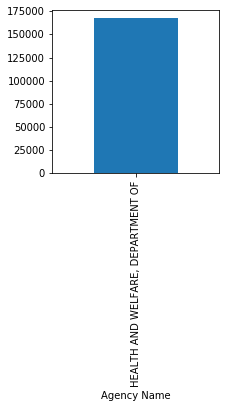

In [845]:
grouped_medical_supplies_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_medical_supplies_agency_2018['Amount'].agg(np.mean)

Agency Name
HEALTH AND WELFARE, DEPARTMENT OF    177438.159268
Name: Amount, dtype: float64

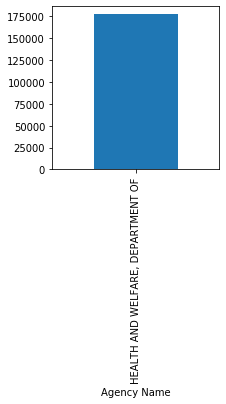

In [846]:
grouped_medical_supplies_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_medical_supplies_agency_2019['Amount'].agg(np.mean)

In [847]:
grouped_medical_supplies_agency_mean_2018 = grouped_medical_supplies_agency_2018['Amount'].agg(np.mean)
grouped_medical_supplies_agency_max_mean_2018 = grouped_medical_supplies_agency_mean_2018.max()
grouped_medical_supplies_agency_name_mean_2018 = grouped_medical_supplies_agency_mean_2018.idxmax()
grouped_medical_supplies_agency_name_mean_2018= grouped_medical_supplies_agency_name_mean_2018.strip()

grouped_medical_supplies_agency_mean_2019 = grouped_medical_supplies_agency_2019['Amount'].agg(np.mean)
grouped_medical_supplies_agency_max_mean_2019 = grouped_medical_supplies_agency_mean_2019.max()
grouped_medical_supplies_agency_name_mean_2019 = grouped_medical_supplies_agency_mean_2019.idxmax()
grouped_medical_supplies_agency_name_mean_2019 = grouped_medical_supplies_agency_name_mean_2019.strip()

print("For 2018, " + grouped_medical_supplies_agency_name_mean_2018 + " had the most expenditure for the average cost of Medical and Laboratory Supplies from Magellian RX Management at " + str(grouped_medical_supplies_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_medical_supplies_agency_name_mean_2019 + " had the most expenditure for the average cost of Medical and Laboratory Supplies from Magellian RX Management at " + str(grouped_medical_supplies_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_medical_supplies_agency_max_mean_2019 - grouped_medical_supplies_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the average cost of Medical and Laboratory Supplies from Magellian RX Management at 167480.50102564102.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the average cost of Medical and Laboratory Supplies from Magellian RX Management at 177438.15926829266.
The average increase/decrease was 9957.65824265164 between 2018 and 2019.


Summary Object Name
PROFESSIONAL SERVICES     254430.72
SPECIFIC USE SUPPLIES    6277308.82
Name: Amount, dtype: float64

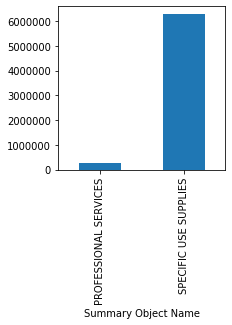

In [848]:
grouped_medical_supplies_summary_2018 = fy2018[fy2018['Vendor Name'] == 'MAGELLAN RX MANAGEMENT INC'].groupby('Summary Object Name')
plt.xticks(rotation='vertical')
grouped_medical_supplies_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_medical_supplies_summary_2018['Amount'].agg(np.sum)

Summary Object Name
PROFESSIONAL SERVICES     382020.94
SPECIFIC USE SUPPLIES    6892943.59
Name: Amount, dtype: float64

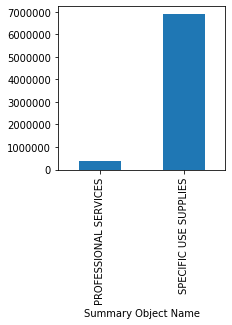

In [849]:
grouped_medical_supplies_summary_2019 = fy2019[fy2019['Vendor Name'] == 'MAGELLAN RX MANAGEMENT INC'].groupby('Summary Object Name')
plt.xticks(rotation='vertical')
grouped_medical_supplies_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_medical_supplies_summary_2019['Amount'].agg(np.sum)

In [850]:
grouped_medical_supplies_summary_sum_2018 = grouped_medical_supplies_summary_2018['Amount'].agg(np.sum)
grouped_medical_supplies_summary_max_sum_2018 = grouped_medical_supplies_summary_sum_2018.max()
grouped_medical_supplies_summary_name_sum_2018 = grouped_medical_supplies_summary_sum_2018.idxmax()
grouped_medical_supplies_summary_name_sum_2018= grouped_medical_supplies_summary_name_sum_2018.strip()

grouped_medical_supplies_summary_sum_2019 = grouped_medical_supplies_summary_2019['Amount'].agg(np.sum)
grouped_medical_supplies_summary_max_sum_2019 = grouped_medical_supplies_summary_sum_2019.max()
grouped_medical_supplies_summary_name_sum_2019 = grouped_medical_supplies_summary_sum_2019.idxmax()
grouped_medical_supplies_summary_name_sum_2019 = grouped_medical_supplies_summary_name_sum_2019.strip()

print("For 2018, " + grouped_medical_supplies_summary_name_sum_2018 + " had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management at " + str(grouped_medical_supplies_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_medical_supplies_summary_name_sum_2019 + " had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management at " + str(grouped_medical_supplies_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_medical_supplies_summary_max_sum_2019 - grouped_medical_supplies_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, SPECIFIC USE SUPPLIES had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management at 6277308.819999999.
For 2019, SPECIFIC USE SUPPLIES had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management at 6892943.59.
The average increase/decrease was 615634.7700000005 between 2018 and 2019.


Summary Object Name
PROFESSIONAL SERVICES     28270.080000
SPECIFIC USE SUPPLIES    209243.627333
Name: Amount, dtype: float64

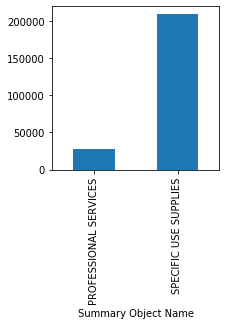

In [851]:
grouped_medical_supplies_summary_2018['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_medical_supplies_summary_2018['Amount'].agg(np.mean)

Summary Object Name
PROFESSIONAL SERVICES     27287.210000
SPECIFIC USE SUPPLIES    255294.207037
Name: Amount, dtype: float64

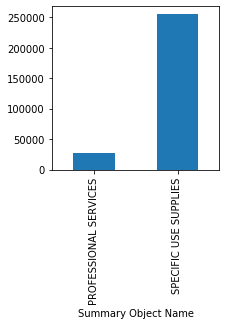

In [852]:
grouped_medical_supplies_summary_2019['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_medical_supplies_summary_2019['Amount'].agg(np.mean)

In [853]:
grouped_medical_supplies_summary_mean_2018 = grouped_medical_supplies_summary_2018['Amount'].agg(np.mean)
grouped_medical_supplies_summary_max_mean_2018 = grouped_medical_supplies_summary_mean_2018.max()
grouped_medical_supplies_summary_name_mean_2018 = grouped_medical_supplies_summary_mean_2018.idxmax()
grouped_medical_supplies_summary_name_mean_2018= grouped_medical_supplies_summary_name_mean_2018.strip()

grouped_medical_supplies_summary_mean_2019 = grouped_medical_supplies_summary_2019['Amount'].agg(np.mean)
grouped_medical_supplies_summary_max_mean_2019 = grouped_medical_supplies_summary_mean_2019.max()
grouped_medical_supplies_summary_name_mean_2019 = grouped_medical_supplies_summary_mean_2019.idxmax()
grouped_medical_supplies_summary_name_mean_2019 = grouped_medical_supplies_summary_name_mean_2019.strip()

print("For 2018, " + grouped_medical_supplies_summary_name_mean_2018 + " had the most expenditure for the average cost of Medical and Laboratory Supplies from Magellian RX Management at " + str(grouped_medical_supplies_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_medical_supplies_summary_name_mean_2019 + " had the most expenditure for the average cost of Medical and Laboratory Supplies from Magellian RX Management at " + str(grouped_medical_supplies_summary_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_medical_supplies_summary_max_mean_2019 - grouped_medical_supplies_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, SPECIFIC USE SUPPLIES had the most expenditure for the average cost of Medical and Laboratory Supplies from Magellian RX Management at 209243.6273333333.
For 2019, SPECIFIC USE SUPPLIES had the most expenditure for the average cost of Medical and Laboratory Supplies from Magellian RX Management at 255294.20703703703.
The average increase/decrease was 46050.57970370373 between 2018 and 2019.


In [854]:
grouped_fica_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'F. I. C. A.'].groupby('Vendor Name')

In [855]:
grouped_fica_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'F. I. C. A.'].groupby('Vendor Name')

In [856]:
grouped_fica_vendor_sum_2018 = grouped_fica_vendor_2018['Amount'].agg(np.sum)
grouped_fica_vendor_max_sum_2018 = grouped_fica_vendor_sum_2018.max()
grouped_fica_vendor_name_sum_2018 = grouped_fica_vendor_sum_2018.idxmax()
grouped_fica_vendor_name_sum_2018= grouped_fica_vendor_name_sum_2018.strip()

grouped_fica_vendor_sum_2019 = grouped_fica_vendor_2019['Amount'].agg(np.sum)
grouped_fica_vendor_max_sum_2019 = grouped_fica_vendor_sum_2019.max()
grouped_fica_vendor_name_sum_2019 = grouped_fica_vendor_sum_2019.idxmax()
grouped_fica_vendor_name_sum_2019 = grouped_fica_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_fica_vendor_name_sum_2018 + " had the most expenditure for the total cost of FICA at " + str(grouped_fica_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_fica_vendor_name_sum_2019 + " had the most expenditure for the total cost of FICA at " + str(grouped_fica_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_fica_vendor_max_sum_2019 - grouped_fica_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, BOISE STATE UNIVERSITY had the most expenditure for the total cost of FICA at 893084.9299999999.
For 2019, BOISE STATE UNIVERSITY had the most expenditure for the total cost of FICA at 502526.64999999997.
The average increase/decrease was -390558.27999999997 between 2018 and 2019.


In [857]:
grouped_fica_vendor_mean_2018 = grouped_fica_vendor_2018['Amount'].agg(np.mean)
grouped_fica_vendor_max_mean_2018 = grouped_fica_vendor_mean_2018.max()
grouped_fica_vendor_name_mean_2018 = grouped_fica_vendor_mean_2018.idxmax()
grouped_fica_vendor_name_mean_2018= grouped_fica_vendor_name_mean_2018.strip()

grouped_fica_vendor_mean_2019 = grouped_fica_vendor_2019['Amount'].agg(np.mean)
grouped_fica_vendor_max_mean_2019 = grouped_fica_vendor_mean_2019.max()
grouped_fica_vendor_name_mean_2019 = grouped_fica_vendor_mean_2019.idxmax()
grouped_fica_vendor_name_mean_2019 = grouped_fica_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_fica_vendor_name_mean_2018 + " had the most expenditure for the average cost of FICA at " + str(grouped_fica_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_fica_vendor_name_mean_2019 + " had the most expenditure for the average cost of FICA at " + str(grouped_fica_vendor_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_fica_vendor_max_mean_2019 - grouped_fica_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, OFFICE OF FINANCIAL SERVICES had the most expenditure for the average cost of FICA at 11391.33.
For 2019, BOISE STATE UNIVERSITY had the most expenditure for the average cost of FICA at 7390.097794117646.


In [858]:
grouped_medical_assist_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'MEDICAL ASSISTANCE-VENDORS'].groupby('Vendor Name')

In [859]:
grouped_medical_assist_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'MEDICAL ASSISTANCE-VENDORS'].groupby('Vendor Name')

In [860]:
grouped_medical_assist_vendor_sum_2018 = grouped_medical_assist_vendor_2018['Amount'].agg(np.sum)
grouped_medical_assist_vendor_max_sum_2018 = grouped_medical_assist_vendor_sum_2018.max()
grouped_medical_assist_vendor_name_sum_2018 = grouped_medical_assist_vendor_sum_2018.idxmax()
grouped_medical_assist_vendor_name_sum_2018= grouped_medical_assist_vendor_name_sum_2018.strip()

grouped_medical_assist_vendor_sum_2019 = grouped_medical_assist_vendor_2019['Amount'].agg(np.sum)
grouped_medical_assist_vendor_max_sum_2019 = grouped_medical_assist_vendor_sum_2019.max()
grouped_medical_assist_vendor_name_sum_2019 = grouped_medical_assist_vendor_sum_2019.idxmax()
grouped_medical_assist_vendor_name_sum_2019 = grouped_medical_assist_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_medical_assist_vendor_name_sum_2018 + " had the most expenditure for the total cost of Medical Assistance-Vendors at " + str(grouped_medical_assist_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_medical_assist_vendor_name_sum_2019 + " had the most expenditure for the total cost of Medical Assistance-Vendors at " + str(grouped_medical_assist_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_medical_assist_vendor_max_sum_2019 - grouped_medical_assist_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, ST LUKE'S REGIONAL MEDICAL CENTER had the most expenditure for the total cost of Medical Assistance-Vendors at 162422053.5100001.
For 2019, ST LUKE'S REGIONAL MEDICAL CENTER had the most expenditure for the total cost of Medical Assistance-Vendors at 150124328.26000008.
The average increase/decrease was -12297725.25000003 between 2018 and 2019.


In [861]:
grouped_medical_assist_vendor_mean_2018 = grouped_medical_assist_vendor_2018['Amount'].agg(np.mean)
grouped_medical_assist_vendor_max_mean_2018 = grouped_medical_assist_vendor_mean_2018.max()
grouped_medical_assist_vendor_name_mean_2018 = grouped_medical_assist_vendor_mean_2018.idxmax()
grouped_medical_assist_vendor_name_mean_2018= grouped_medical_assist_vendor_name_mean_2018.strip()

grouped_medical_assist_vendor_mean_2019 = grouped_medical_assist_vendor_2019['Amount'].agg(np.mean)
grouped_medical_assist_vendor_max_mean_2019 = grouped_medical_assist_vendor_mean_2019.max()
grouped_medical_assist_vendor_name_mean_2019 = grouped_medical_assist_vendor_mean_2019.idxmax()
grouped_medical_assist_vendor_name_mean_2019 = grouped_medical_assist_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_medical_assist_vendor_name_mean_2018 + " had the most expenditure for the average cost of Medical Assistance-Vendors at " + str(grouped_medical_assist_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_medical_assist_vendor_name_mean_2019 + " had the most expenditure for the average cost of Medical Assistance-Vendors at " + str(grouped_medical_assist_vendor_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_medical_assist_vendor_max_mean_2019 - grouped_medical_assist_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, DEPARTMENT HEALTH & HUMAN SERVICES had the most expenditure for the average cost of Medical Assistance-Vendors at 5898437.976923076.
For 2019, DEPARTMENT HEALTH & HUMAN SERVICES had the most expenditure for the average cost of Medical Assistance-Vendors at 6070950.038461537.
The average increase/decrease was 172512.06153846066 between 2018 and 2019.


Agency Name
HEALTH AND WELFARE, DEPARTMENT OF    76679883.2
VETERANS SERVICES                       23088.0
Name: Amount, dtype: float64

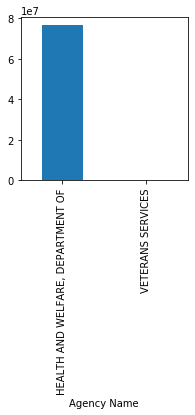

In [862]:
grouped_dept_health_agency_2018 = fy2018[fy2018['Vendor Name'] == 'DEPARTMENT HEALTH & HUMAN SERVICES'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_dept_health_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_dept_health_agency_2018['Amount'].agg(np.sum)

Agency Name
HEALTH AND WELFARE, DEPARTMENT OF    78922378.5
VETERANS SERVICES                       23432.5
Name: Amount, dtype: float64

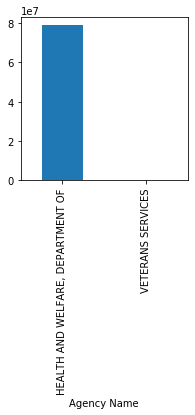

In [863]:
grouped_dept_health_agency_2019 = fy2019[fy2019['Vendor Name'] == 'DEPARTMENT HEALTH & HUMAN SERVICES'].groupby('Agency Name')
plt.xticks(rotation='vertical')
grouped_dept_health_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_dept_health_agency_2019['Amount'].agg(np.sum)

In [864]:
grouped_dept_health_agency_sum_2018 = grouped_dept_health_agency_2018['Amount'].agg(np.sum)
grouped_dept_health_agency_max_sum_2018 = grouped_dept_health_agency_sum_2018.max()
grouped_dept_health_agency_name_sum_2018 = grouped_dept_health_agency_sum_2018.idxmax()
grouped_dept_health_agency_name_sum_2018= grouped_dept_health_agency_name_sum_2018.strip()

grouped_dept_health_agency_sum_2019 = grouped_dept_health_agency_2019['Amount'].agg(np.sum)
grouped_dept_health_agency_max_sum_2019 = grouped_dept_health_agency_sum_2019.max()
grouped_dept_health_agency_name_sum_2019 = grouped_dept_health_agency_sum_2019.idxmax()
grouped_dept_health_agency_name_sum_2019 = grouped_dept_health_agency_name_sum_2019.strip()

print("For 2018, " + grouped_dept_health_agency_name_sum_2018 + " had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services at " + str(grouped_dept_health_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_dept_health_agency_name_sum_2019 + " had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services at " + str(grouped_dept_health_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_dept_health_agency_max_sum_2019 - grouped_dept_health_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services at 76679883.19999999.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services at 78922378.49999999.
The average increase/decrease was 2242495.299999997 between 2018 and 2019.


Agency Name
HEALTH AND WELFARE, DEPARTMENT OF    4.510581e+06
VETERANS SERVICES                    2.308800e+04
Name: Amount, dtype: float64

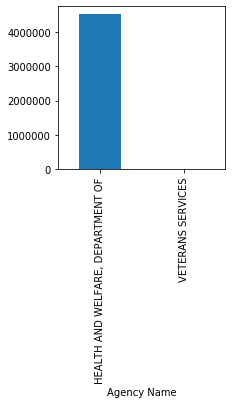

In [865]:
grouped_dept_health_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_dept_health_agency_2018['Amount'].agg(np.mean)

Agency Name
HEALTH AND WELFARE, DEPARTMENT OF    5637312.75
VETERANS SERVICES                      23432.50
Name: Amount, dtype: float64

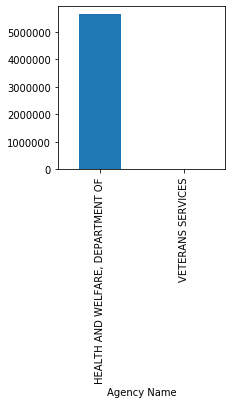

In [866]:
grouped_dept_health_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_dept_health_agency_2019['Amount'].agg(np.mean)

In [867]:
grouped_dept_health_agency_mean_2018 = grouped_dept_health_agency_2018['Amount'].agg(np.mean)
grouped_dept_health_agency_max_mean_2018 = grouped_dept_health_agency_mean_2018.max()
grouped_dept_health_agency_name_mean_2018 = grouped_dept_health_agency_mean_2018.idxmax()
grouped_dept_health_agency_name_mean_2018= grouped_dept_health_agency_name_mean_2018.strip()

grouped_dept_health_agency_mean_2019 = grouped_dept_health_agency_2019['Amount'].agg(np.mean)
grouped_dept_health_agency_max_mean_2019 = grouped_dept_health_agency_mean_2019.max()
grouped_dept_health_agency_name_mean_2019 = grouped_dept_health_agency_mean_2019.idxmax()
grouped_dept_health_agency_name_mean_2019 = grouped_dept_health_agency_name_mean_2019.strip()

print("For 2018, " + grouped_dept_health_agency_name_mean_2018 + " had the most expenditure for the average cost of Medical Assistance-Vendors from the Department Health & Human Services at " + str(grouped_dept_health_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_dept_health_agency_name_mean_2019 + " had the most expenditure for the average cost of Medical Assistance-Vendors from the Department Health & Human Services at " + str(grouped_dept_health_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_dept_health_agency_max_mean_2019 - grouped_dept_health_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the average cost of Medical Assistance-Vendors from the Department Health & Human Services at 4510581.364705882.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the average cost of Medical Assistance-Vendors from the Department Health & Human Services at 5637312.749999999.
The average increase/decrease was 1126731.385294117 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES         189.5
AWARDS CONTR & CLAIMS      76679693.7
MISC EXPENDITURES             23088.0
Name: Amount, dtype: float64

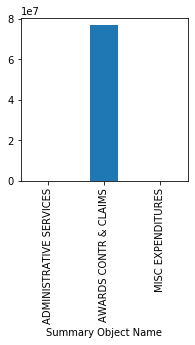

In [868]:
grouped_dept_health_summary_2018 = fy2018[fy2018['Vendor Name'] == 'DEPARTMENT HEALTH & HUMAN SERVICES'].groupby('Summary Object Name')
plt.xticks(rotation='vertical')
grouped_dept_health_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_dept_health_summary_2018['Amount'].agg(np.sum)

Summary Object Name
ADMINISTRATIVE SERVICES          28.0
AWARDS CONTR & CLAIMS      78922350.5
MISC EXPENDITURES             23432.5
Name: Amount, dtype: float64

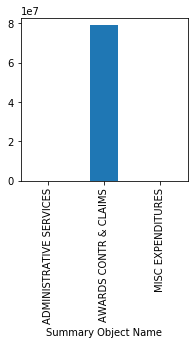

In [869]:
grouped_dept_health_summary_2019 = fy2019[fy2019['Vendor Name'] == 'DEPARTMENT HEALTH & HUMAN SERVICES'].groupby('Summary Object Name')
plt.xticks(rotation='vertical')
grouped_dept_health_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_dept_health_summary_2019['Amount'].agg(np.sum)

In [870]:
grouped_dept_health_summary_sum_2018 = grouped_dept_health_summary_2018['Amount'].agg(np.sum)
grouped_dept_health_summary_max_sum_2018 = grouped_dept_health_summary_sum_2018.max()
grouped_dept_health_summary_name_sum_2018 = grouped_dept_health_summary_sum_2018.idxmax()
grouped_dept_health_summary_name_sum_2018= grouped_dept_health_summary_name_sum_2018.strip()

grouped_dept_health_summary_sum_2019 = grouped_dept_health_summary_2019['Amount'].agg(np.sum)
grouped_dept_health_summary_max_sum_2019 = grouped_dept_health_summary_sum_2019.max()
grouped_dept_health_summary_name_sum_2019 = grouped_dept_health_summary_sum_2019.idxmax()
grouped_dept_health_summary_name_sum_2019 = grouped_dept_health_summary_name_sum_2019.strip()

print("For 2018, " + grouped_dept_health_summary_name_sum_2018 + " had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services at " + str(grouped_dept_health_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_dept_health_summary_name_sum_2019 + " had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services at " + str(grouped_dept_health_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_dept_health_summary_max_sum_2019 - grouped_dept_health_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, AWARDS CONTR & CLAIMS had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services at 76679693.69999999.
For 2019, AWARDS CONTR & CLAIMS had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services at 78922350.49999999.
The average increase/decrease was 2242656.799999997 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES    4.737500e+01
AWARDS CONTR & CLAIMS      5.898438e+06
MISC EXPENDITURES          2.308800e+04
Name: Amount, dtype: float64

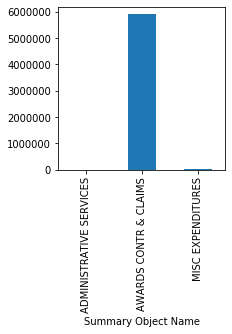

In [871]:
grouped_dept_health_summary_2018['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_dept_health_summary_2018['Amount'].agg(np.mean)

Summary Object Name
ADMINISTRATIVE SERVICES    2.800000e+01
AWARDS CONTR & CLAIMS      6.070950e+06
MISC EXPENDITURES          2.343250e+04
Name: Amount, dtype: float64

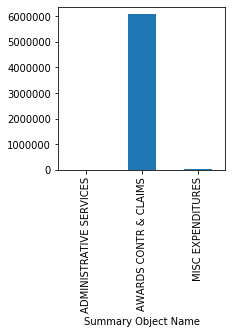

In [872]:
grouped_dept_health_summary_2019['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_dept_health_summary_2019['Amount'].agg(np.mean)

In [873]:
grouped_dept_health_summary_mean_2018 = grouped_dept_health_summary_2018['Amount'].agg(np.mean)
grouped_dept_health_summary_max_mean_2018 = grouped_dept_health_summary_mean_2018.max()
grouped_dept_health_summary_name_mean_2018 = grouped_dept_health_summary_mean_2018.idxmax()
grouped_dept_health_summary_name_mean_2018= grouped_dept_health_summary_name_mean_2018.strip()

grouped_dept_health_summary_mean_2019 = grouped_dept_health_summary_2019['Amount'].agg(np.mean)
grouped_dept_health_summary_max_mean_2019 = grouped_dept_health_summary_mean_2019.max()
grouped_dept_health_summary_name_mean_2019 = grouped_dept_health_summary_mean_2019.idxmax()
grouped_dept_health_summary_name_mean_2019 = grouped_dept_health_summary_name_mean_2019.strip()

print("For 2018, " + grouped_dept_health_summary_name_mean_2018 + " had the most expenditure for the average cost of Medical Assistance-Vendors from the Department Health & Human Services at " + str(grouped_dept_health_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_dept_health_summary_name_mean_2019 + " had the most expenditure for the average cost of Medical Assistance-Vendors from the Department Health & Human Services at " + str(grouped_dept_health_summary_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_dept_health_summary_max_mean_2019 - grouped_dept_health_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, AWARDS CONTR & CLAIMS had the most expenditure for the average cost of Medical Assistance-Vendors from the Department Health & Human Services at 5898437.976923076.
For 2019, AWARDS CONTR & CLAIMS had the most expenditure for the average cost of Medical Assistance-Vendors from the Department Health & Human Services at 6070950.038461537.
The average increase/decrease was 172512.06153846066 between 2018 and 2019.


In [874]:
print("Listed below are areas of potential cost savings for health care.")

print("\r\n" + grouped_group_insur_vendor_name_sum_2018 + " had the most expenditure for the total cost of Group Insuramce Health & Accident with an average increase of " + str(grouped_group_insur_vendor_max_sum_2019 - grouped_group_insur_vendor_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_medical_supplies_vendor_name_sum_2018 + " had the most expenditure for the total cost of Medical and Laboratory Supplies with an average increase was " + str(grouped_medical_supplies_vendor_max_sum_2019 - grouped_medical_supplies_vendor_max_sum_2018) + " between 2018 and 2019.")

print("\r\n " + grouped_medical_supplies_agency_name_sum_2018 + " had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management with an average increase of " + str(grouped_medical_supplies_agency_max_sum_2019 - grouped_medical_supplies_agency_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_medical_supplies_summary_name_sum_2018 + " had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management with an average increase of " + str(grouped_medical_supplies_summary_max_sum_2019 - grouped_medical_supplies_summary_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_dept_health_agency_name_sum_2018 + " had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services with an average increase of " + str(grouped_dept_health_agency_max_sum_2019 - grouped_dept_health_agency_max_sum_2018) + " between 2018 and 2019.")


print("\r\n" + grouped_dept_health_summary_name_sum_2018 + " had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services with an average increase of " + str(grouped_dept_health_summary_max_sum_2019 - grouped_dept_health_summary_max_sum_2018) + " between 2018 and 2019.")

Listed below are areas of potential cost savings for health care.

REDACTED had the most expenditure for the total cost of Group Insuramce Health & Accident with an average increase of 763657.1800000109 between 2018 and 2019.

MAGELLAN RX MANAGEMENT INC had the most expenditure for the total cost of Medical and Laboratory Supplies with an average increase was 615634.7700000005 between 2018 and 2019.

 HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management with an average increase of 743224.9899999993 between 2018 and 2019.

SPECIFIC USE SUPPLIES had the most expenditure for the total cost of Medical and Laboratory Supplies from Magellian RX Management with an average increase of 615634.7700000005 between 2018 and 2019.

HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Medical Assistance-Vendors from the Department Health & Human Services with an average increase of 224

In [875]:
# Explore Travel Costs

In [876]:
grouped_subsistence_instate_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'SUBSISTENCE IN-STATE'].groupby('Vendor Name')

In [877]:
grouped_subsistence_instate_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'SUBSISTENCE IN-STATE'].groupby('Vendor Name')

In [878]:
grouped_subsistence_instate_vendor_sum_2018 = grouped_subsistence_instate_vendor_2018['Amount'].agg(np.sum)
grouped_subsistence_instate_vendor_max_sum_2018 = grouped_subsistence_instate_vendor_sum_2018.max()
grouped_subsistence_instate_vendor_name_sum_2018 = grouped_subsistence_instate_vendor_sum_2018.idxmax()
grouped_subsistence_instate_vendor_name_sum_2018= grouped_subsistence_instate_vendor_name_sum_2018.strip()

grouped_subsistence_instate_vendor_sum_2019 = grouped_subsistence_instate_vendor_2019['Amount'].agg(np.sum)
grouped_subsistence_instate_vendor_max_sum_2019 = grouped_subsistence_instate_vendor_sum_2019.max()
grouped_subsistence_instate_vendor_name_sum_2019 = grouped_subsistence_instate_vendor_sum_2019.idxmax()
grouped_subsistence_instate_vendor_name_sum_2019 = grouped_subsistence_instate_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_subsistence_instate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Substistence In-State at " + str(grouped_subsistence_instate_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_subsistence_instate_vendor_name_sum_2019 + " had the most expenditure for the total cost of Substistence In-State at " + str(grouped_subsistence_instate_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_subsistence_instate_vendor_max_sum_2019 - grouped_subsistence_instate_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, PCARD GENERIC VENDOR had the most expenditure for the total cost of Substistence In-State at 290559.41.
For 2019, PCARD GENERIC VENDOR had the most expenditure for the total cost of Substistence In-State at 292884.0900000001.
The average increase/decrease was 2324.6800000001094 between 2018 and 2019.


In [879]:
grouped_subsistence_instate_vendor_mean_2018 = grouped_subsistence_instate_vendor_2018['Amount'].agg(np.mean)
grouped_subsistence_instate_vendor_max_mean_2018 = grouped_subsistence_instate_vendor_mean_2018.max()
grouped_subsistence_instate_vendor_name_mean_2018 = grouped_subsistence_instate_vendor_mean_2018.idxmax()
grouped_subsistence_instate_vendor_name_mean_2018= grouped_subsistence_instate_vendor_name_mean_2018.strip()

grouped_subsistence_instate_vendor_mean_2019 = grouped_subsistence_instate_vendor_2019['Amount'].agg(np.mean)
grouped_subsistence_instate_vendor_max_mean_2019 = grouped_subsistence_instate_vendor_mean_2019.max()
grouped_subsistence_instate_vendor_name_mean_2019 = grouped_subsistence_instate_vendor_mean_2019.idxmax()
grouped_subsistence_instate_vendor_name_mean_2019 = grouped_subsistence_instate_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_subsistence_instate_vendor_name_mean_2018 + " had the most expenditure for the average cost of Substistence In-State at " + str(grouped_subsistence_instate_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_subsistence_instate_vendor_name_mean_2019 + " had the most expenditure for the average cost of Substistence In-State at " + str(grouped_subsistence_instate_vendor_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_subsistence_instate_vendor_max_mean_2019 - grouped_subsistence_instate_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, STRATEGIES FOR YOUTH INC had the most expenditure for the average cost of Substistence In-State at 58750.0.
For 2019, HAPPY DAY CATERING & EVENT RENTAL had the most expenditure for the average cost of Substistence In-State at 90193.5.


Agency Name
ADMINISTRATION, DEPARTMENT OF                        -2.141798e+04
AGING, COMMISSION ON                                  0.000000e+00
AGRICULTURE, DEPARTMENT OF                            0.000000e+00
ATTORNEY GENERAL, OFFICE OF THE                      -4.895800e+02
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE      -5.120000e+00
BUILDING SAFETY, DIVISION OF                         -5.127500e+03
CAREER-TECHNICAL EDUCATION, DIVISION OF               0.000000e+00
COMMERCE, DEPARTMENT OF                              -5.672000e+01
CONSERVATION, OFFICE OF SPECIES                      -1.155300e+02
CONSERVATION, SOIL AND WATER COMMISSION              -5.799500e+02
CONTROLLER, OFFICE OF THE STATE                      -2.742930e+03
CORRECTION, DEPARTMENT OF                            -2.131628e-14
CORRECTIONAL INDUSTRIES                               0.000000e+00
DRUG POLICY, OFFICE OF                                0.000000e+00
EDUCATION, STATE BOARD OF                         

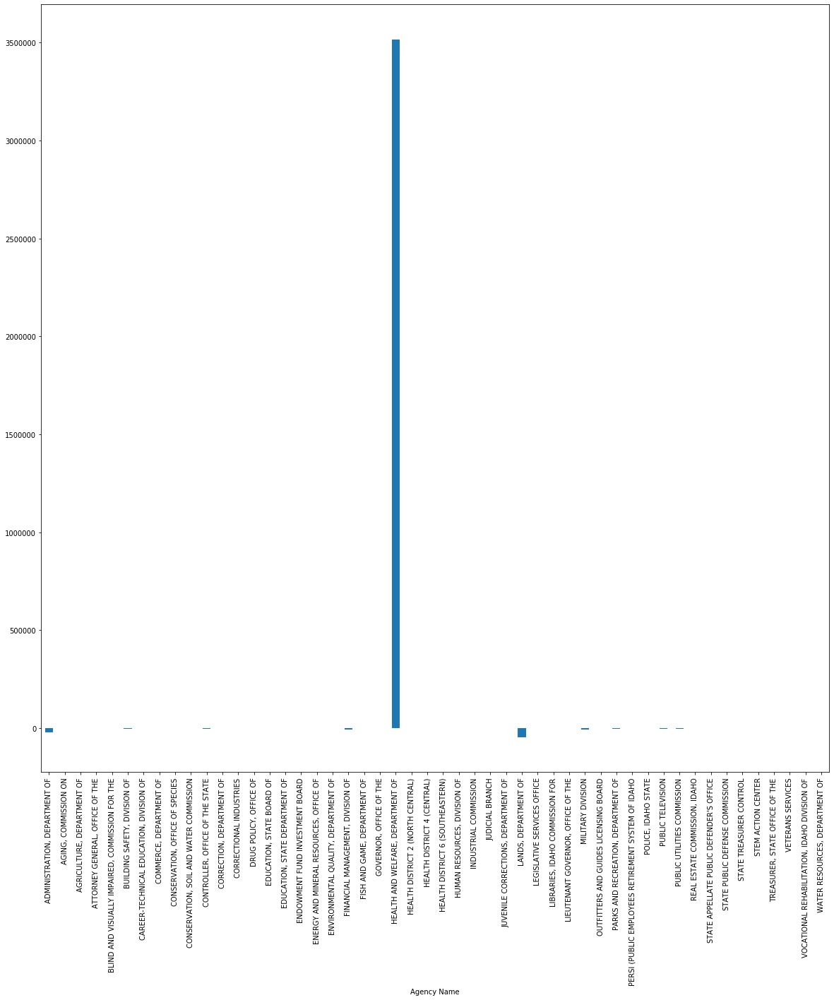

In [880]:
grouped_pcard_generic_agency_2018 = fy2018[fy2018['Vendor Name'] == 'PCARD GENERIC VENDOR'].groupby('Agency Name')
grouped_pcard_generic_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_pcard_generic_agency_2018['Amount'].agg(np.sum)

Agency Name
ADMINISTRATION, DEPARTMENT OF                     -1.358571e+04
AGING, COMMISSION ON                               0.000000e+00
AGRICULTURE, DEPARTMENT OF                        -4.500000e+02
ARTS, IDAHO COMMISSION ON THE                      0.000000e+00
ATTORNEY GENERAL, OFFICE OF THE                   -2.349520e+03
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE   -1.802000e+01
BUILDING SAFETY, DIVISION OF                      -2.593110e+03
CAREER-TECHNICAL EDUCATION, DIVISION OF            2.273737e-13
COMMERCE, DEPARTMENT OF                           -2.797000e+01
CONSERVATION, OFFICE OF SPECIES                    1.136868e-13
CONSERVATION, SOIL AND WATER COMMISSION           -8.002100e+02
CONTROLLER, OFFICE OF THE STATE                   -3.016990e+03
CORRECTION, DEPARTMENT OF                         -4.547474e-13
DRUG POLICY, OFFICE OF                            -2.110370e+03
EDUCATION, STATE BOARD OF                          0.000000e+00
EDUCATION, STATE DEPARTMENT 

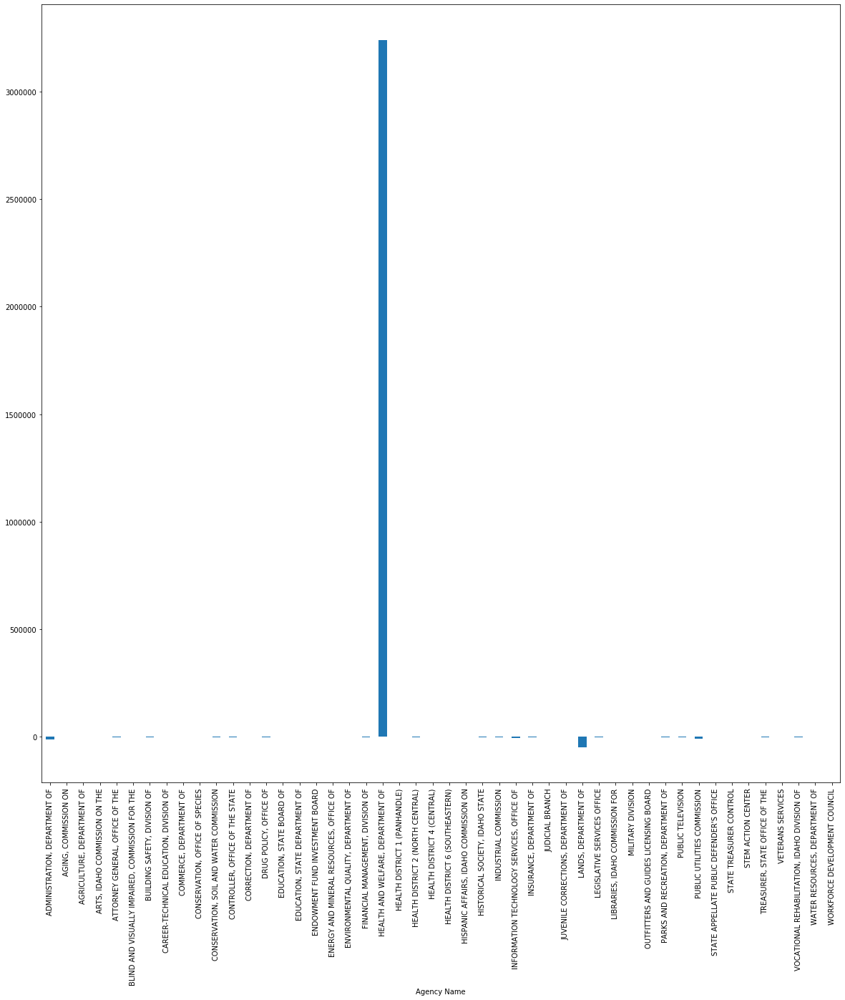

In [881]:
grouped_pcard_generic_agency_2019 = fy2019[fy2019['Vendor Name'] == 'PCARD GENERIC VENDOR'].groupby('Agency Name')
grouped_pcard_generic_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_pcard_generic_agency_2019['Amount'].agg(np.sum)

In [882]:
grouped_pcard_generic_agency_sum_2018 = grouped_pcard_generic_agency_2018['Amount'].agg(np.sum)
grouped_pcard_generic_agency_max_sum_2018 = grouped_pcard_generic_agency_sum_2018.max()
grouped_pcard_generic_agency_name_sum_2018 = grouped_pcard_generic_agency_sum_2018.idxmax()
grouped_pcard_generic_agency_name_sum_2018= grouped_pcard_generic_agency_name_sum_2018.strip()

grouped_pcard_generic_agency_sum_2019 = grouped_pcard_generic_agency_2019['Amount'].agg(np.sum)
grouped_pcard_generic_agency_max_sum_2019 = grouped_pcard_generic_agency_sum_2019.max()
grouped_pcard_generic_agency_name_sum_2019 = grouped_pcard_generic_agency_sum_2019.idxmax()
grouped_pcard_generic_agency_name_sum_2019 = grouped_pcard_generic_agency_name_sum_2019.strip()

print("For 2018, " + grouped_pcard_generic_agency_name_sum_2018 + " had the most expenditure for the total cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_pcard_generic_agency_name_sum_2019 + " had the most expenditure for the total cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_pcard_generic_agency_max_sum_2019 - grouped_pcard_generic_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Pcard Generic Vendor from the Substistence In-State at 3516731.1000000252.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Pcard Generic Vendor from the Substistence In-State at 3240031.520000003.
The average increase/decrease was -276699.5800000224 between 2018 and 2019.


Agency Name
ADMINISTRATION, DEPARTMENT OF                        -6.953890e+01
AGING, COMMISSION ON                                  0.000000e+00
AGRICULTURE, DEPARTMENT OF                            0.000000e+00
ATTORNEY GENERAL, OFFICE OF THE                      -9.791600e+01
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE      -5.120000e+00
BUILDING SAFETY, DIVISION OF                         -1.553788e+02
CAREER-TECHNICAL EDUCATION, DIVISION OF               0.000000e+00
COMMERCE, DEPARTMENT OF                              -6.302222e+00
CONSERVATION, OFFICE OF SPECIES                      -1.698971e+00
CONSERVATION, SOIL AND WATER COMMISSION              -1.487051e+01
CONTROLLER, OFFICE OF THE STATE                      -1.371465e+02
CORRECTION, DEPARTMENT OF                            -2.131628e-15
CORRECTIONAL INDUSTRIES                               0.000000e+00
DRUG POLICY, OFFICE OF                                0.000000e+00
EDUCATION, STATE BOARD OF                         

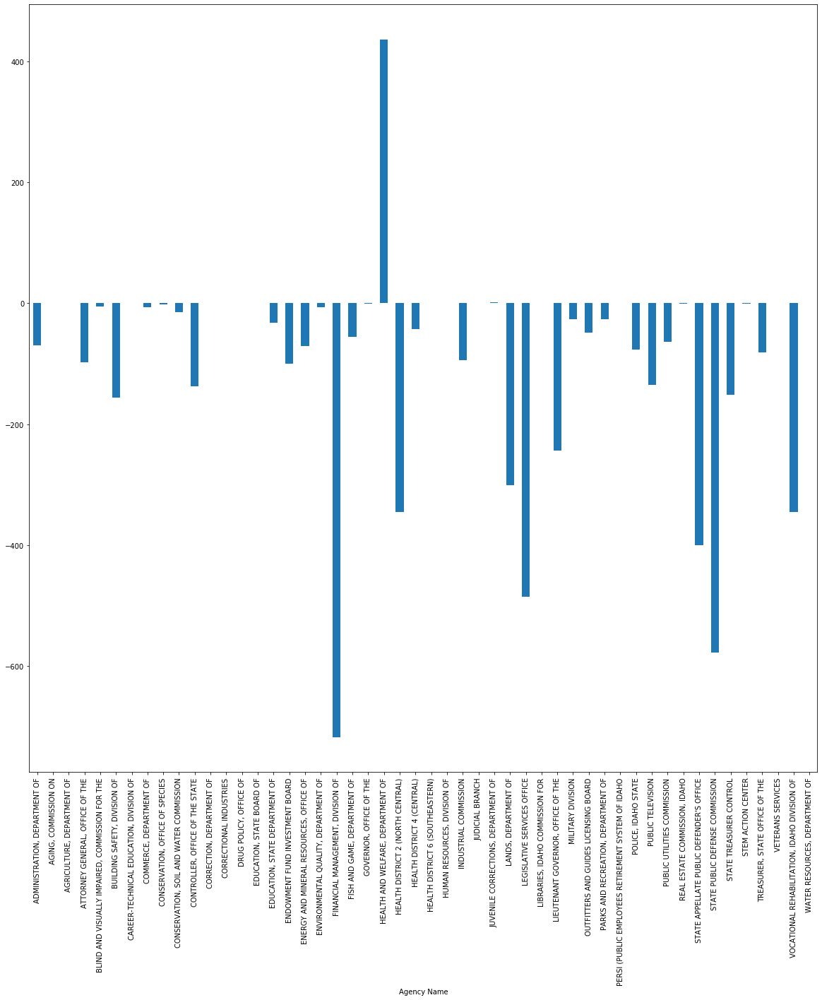

In [883]:
grouped_pcard_generic_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_pcard_generic_agency_2018['Amount'].agg(np.mean)

Agency Name
ADMINISTRATION, DEPARTMENT OF                     -4.067578e+01
AGING, COMMISSION ON                               0.000000e+00
AGRICULTURE, DEPARTMENT OF                        -2.250000e+01
ARTS, IDAHO COMMISSION ON THE                      0.000000e+00
ATTORNEY GENERAL, OFFICE OF THE                   -1.468450e+02
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE   -1.802000e+01
BUILDING SAFETY, DIVISION OF                      -1.620694e+02
CAREER-TECHNICAL EDUCATION, DIVISION OF            5.684342e-15
COMMERCE, DEPARTMENT OF                           -2.797000e+00
CONSERVATION, OFFICE OF SPECIES                    4.210624e-15
CONSERVATION, SOIL AND WATER COMMISSION           -2.162730e+01
CONTROLLER, OFFICE OF THE STATE                   -8.619971e+01
CORRECTION, DEPARTMENT OF                         -4.547474e-14
DRUG POLICY, OFFICE OF                            -8.441480e+01
EDUCATION, STATE BOARD OF                          0.000000e+00
EDUCATION, STATE DEPARTMENT 

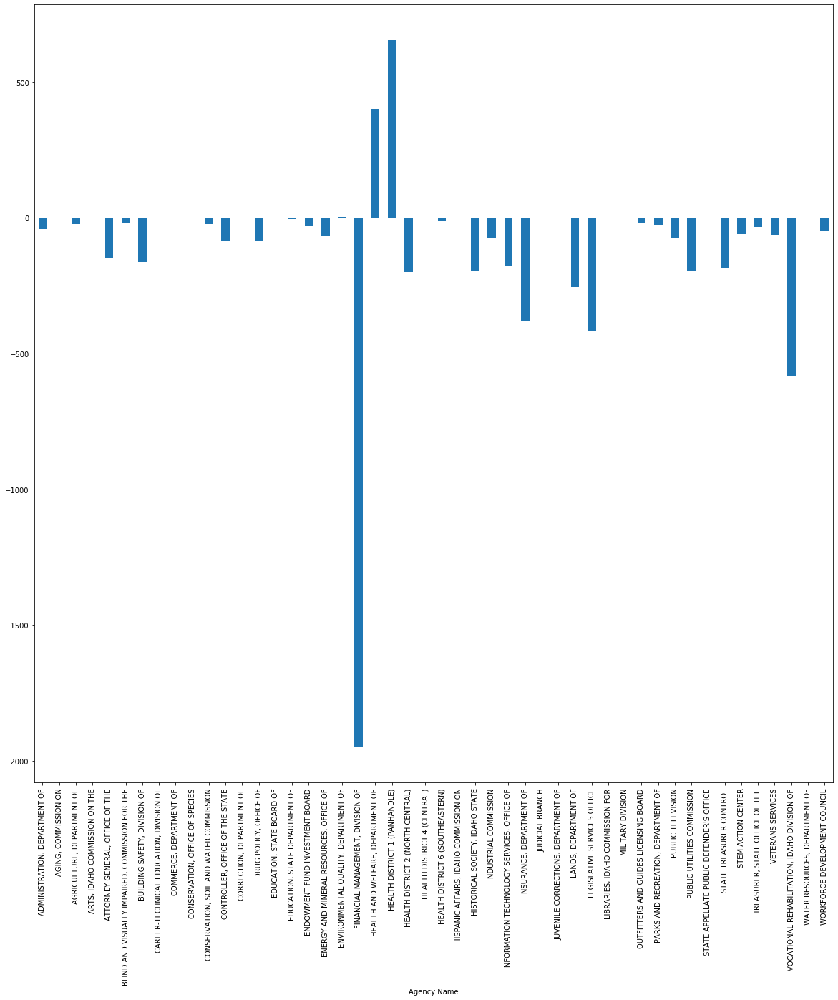

In [884]:
grouped_pcard_generic_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_pcard_generic_agency_2019['Amount'].agg(np.mean)

In [885]:
grouped_pcard_generic_agency_mean_2018 = grouped_pcard_generic_agency_2018['Amount'].agg(np.mean)
grouped_pcard_generic_agency_max_mean_2018 = grouped_pcard_generic_agency_mean_2018.max()
grouped_pcard_generic_agency_name_mean_2018 = grouped_pcard_generic_agency_mean_2018.idxmax()
grouped_pcard_generic_agency_name_mean_2018= grouped_pcard_generic_agency_name_mean_2018.strip()

grouped_pcard_generic_agency_mean_2019 = grouped_pcard_generic_agency_2019['Amount'].agg(np.mean)
grouped_pcard_generic_agency_max_mean_2019 = grouped_pcard_generic_agency_mean_2019.max()
grouped_pcard_generic_agency_name_mean_2019 = grouped_pcard_generic_agency_mean_2019.idxmax()
grouped_pcard_generic_agency_name_mean_2019 = grouped_pcard_generic_agency_name_mean_2019.strip()

print("For 2018, " + grouped_pcard_generic_agency_name_mean_2018 + " had the most expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_pcard_generic_agency_name_mean_2019 + " had the most expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_agency_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_pcard_generic_agency_max_mean_2019 - grouped_pcard_generic_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at 436.5898324022378.
For 2019, HEALTH DISTRICT 1 (PANHANDLE) had the most expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at 655.99.


In [886]:
grouped_pcard_generic_agency_mean_2018 = grouped_pcard_generic_agency_2018['Amount'].agg(np.mean)
grouped_pcard_generic_agency_min_mean_2018 = grouped_pcard_generic_agency_mean_2018.min()
grouped_pcard_generic_agency_name_mean_2018 = grouped_pcard_generic_agency_mean_2018.idxmin()
grouped_pcard_generic_agency_name_mean_2018= grouped_pcard_generic_agency_name_mean_2018.strip()

grouped_pcard_generic_agency_mean_2019 = grouped_pcard_generic_agency_2019['Amount'].agg(np.mean)
grouped_pcard_generic_agency_min_mean_2019 = grouped_pcard_generic_agency_mean_2019.min()
grouped_pcard_generic_agency_name_mean_2019 = grouped_pcard_generic_agency_mean_2019.idxmin()
grouped_pcard_generic_agency_name_mean_2019 = grouped_pcard_generic_agency_name_mean_2019.strip()

print("For 2018, " + grouped_pcard_generic_agency_name_mean_2018 + " had the least expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_agency_min_mean_2018) + ".")
print("For 2019, " + grouped_pcard_generic_agency_name_mean_2019 + " had the least expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_agency_min_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_pcard_generic_agency_min_mean_2019 - grouped_pcard_generic_agency_min_mean_2018) + " between 2018 and 2019.")

For 2018, FINANCIAL MANAGEMENT, DIVISION OF had the least expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at -717.6477777777777.
For 2019, FINANCIAL MANAGEMENT, DIVISION OF had the least expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at -1950.43.
The average increase/decrease was -1232.7822222222223 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES         15946.11
ADMINISTRATIVE SUPPLIES        391460.14
AWARDS CONTR & CLAIMS            7249.07
BLDG & IMPROVEMENTS                 0.00
COMMUNICATION COSTS             37294.42
COMPUTER EQUIPMENT                 22.46
COMPUTER SERVICES                4457.00
COMPUTER SUPPLIES               93071.60
EDUC & TRAIN ASSISTANCE         11409.56
EMPLOYEE DEVELOPMENT COSTS     258285.28
EMPLOYEE TRAVEL COSTS         1195038.41
FUEL & LUBRICANTS COSTS           162.89
GENERAL SERVICES                13463.27
INST & RESIDENT SUPPLIES       727275.62
INSURANCE                          69.99
MFG & MERCH COSTS                   0.00
MISC EXPENDITURES                4502.72
OFFICE EQUIPMENT                    0.00
PROFESSIONAL SERVICES           34911.96
PROPERTY & IMPROVEMENTS           719.28
RENTALS & OPER LEASES           54082.00
REPAIR & MAINT SUPPLIES        202984.07
REPAIR & MAINT SVCS             24913.14
SPECIFIC USE EQUIPMENT           9138

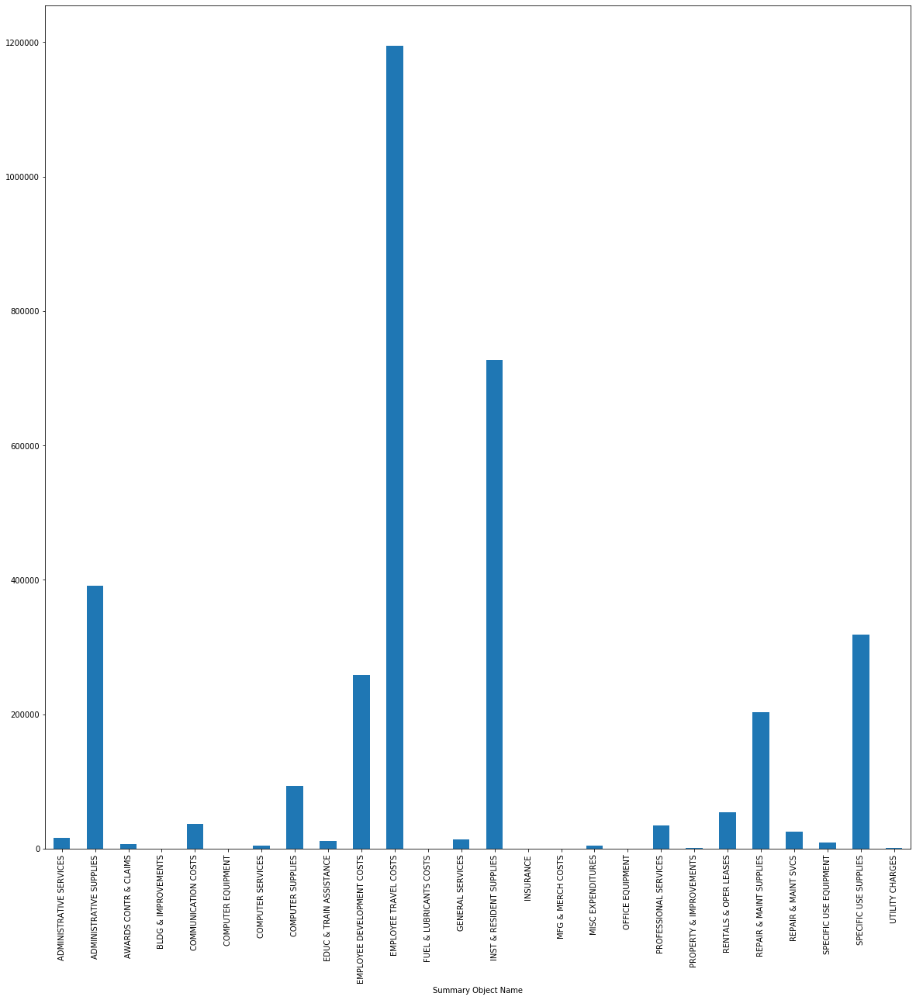

In [887]:
grouped_pcard_generic_summary_2018 = fy2018[fy2018['Vendor Name'] == 'PCARD GENERIC VENDOR'].groupby('Summary Object Name')
grouped_pcard_generic_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_pcard_generic_summary_2018['Amount'].agg(np.sum)

Summary Object Name
ADMINISTRATIVE SERVICES            24606.11
ADMINISTRATIVE SUPPLIES           422457.81
AWARDS CONTR & CLAIMS               5439.40
BLDG & IMPROVEMENTS                  252.32
COMMUNICATION COSTS                15563.58
COMPUTER EQUIPMENT                  9190.09
COMPUTER SERVICES                   5068.99
COMPUTER SUPPLIES                  97042.37
EDUC & TRAIN ASSISTANCE             8733.15
EMPLOYEE DEVELOPMENT COSTS        302651.07
EMPLOYEE TRAVEL COSTS            1164739.03
FED PMTS TO SUBGRANTEES                0.00
FUEL & LUBRICANTS COSTS              126.54
GENERAL SERVICES                   13472.18
INST & RESIDENT SUPPLIES          378471.29
INSURANCE                             12.44
MFG & MERCH COSTS                     -6.90
MISC EXPENDITURES                   9785.82
MOTORIZED/NON-MOTORIZED EQUIP       4375.80
PROFESSIONAL SERVICES              22503.39
RENTALS & OPER LEASES              46623.04
REPAIR & MAINT SUPPLIES           230957.22
REPAIR & MAI

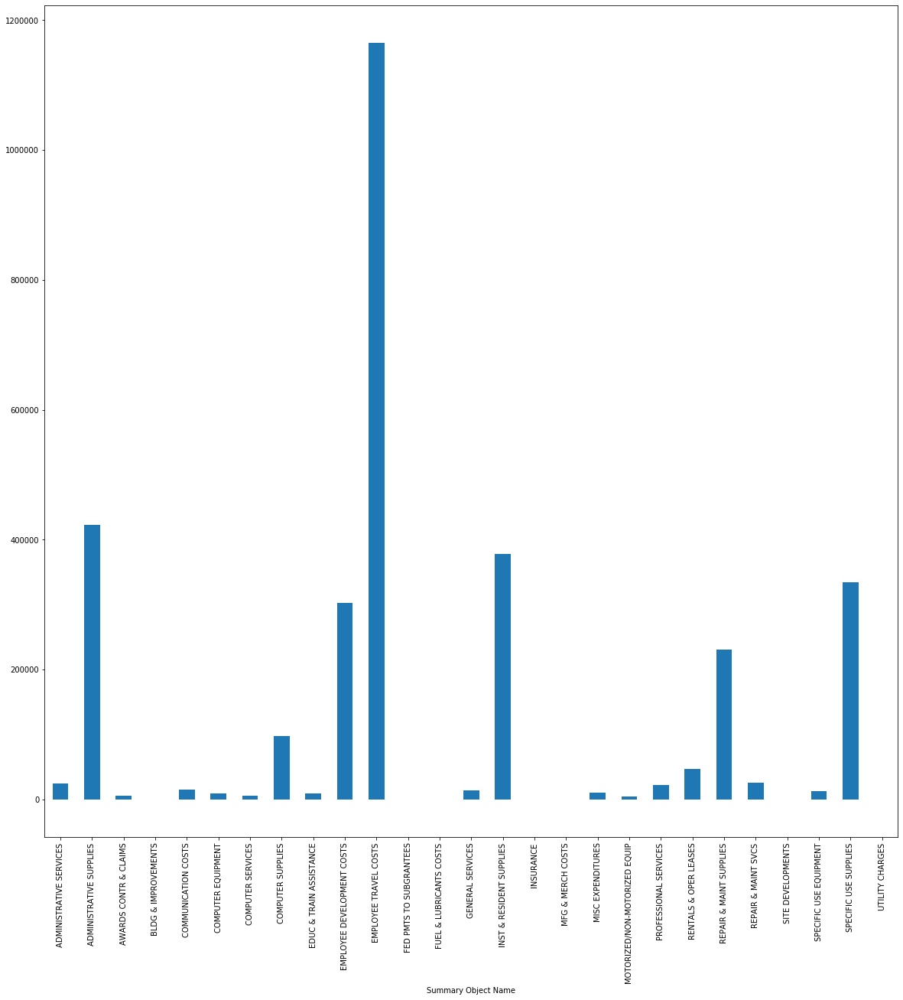

In [888]:
grouped_pcard_generic_summary_2019 = fy2019[fy2019['Vendor Name'] == 'PCARD GENERIC VENDOR'].groupby('Summary Object Name')
grouped_pcard_generic_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_pcard_generic_summary_2019['Amount'].agg(np.sum)

In [889]:
grouped_pcard_generic_summary_sum_2018 = grouped_pcard_generic_summary_2018['Amount'].agg(np.sum)
grouped_pcard_generic_summary_max_sum_2018 = grouped_pcard_generic_summary_sum_2018.max()
grouped_pcard_generic_summary_name_sum_2018 = grouped_pcard_generic_summary_sum_2018.idxmax()
grouped_pcard_generic_summary_name_sum_2018= grouped_pcard_generic_summary_name_sum_2018.strip()

grouped_pcard_generic_summary_sum_2019 = grouped_pcard_generic_summary_2019['Amount'].agg(np.sum)
grouped_pcard_generic_summary_max_sum_2019 = grouped_pcard_generic_summary_sum_2019.max()
grouped_pcard_generic_summary_name_sum_2019 = grouped_pcard_generic_summary_sum_2019.idxmax()
grouped_pcard_generic_summary_name_sum_2019 = grouped_pcard_generic_summary_name_sum_2019.strip()

print("For 2018, " + grouped_pcard_generic_summary_name_sum_2018 + " had the most expenditure for the total cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_pcard_generic_summary_name_sum_2019 + " had the most expenditure for the total cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_pcard_generic_summary_max_sum_2019 - grouped_pcard_generic_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEE TRAVEL COSTS had the most expenditure for the total cost of Pcard Generic Vendor from the Substistence In-State at 1195038.4099999976.
For 2019, EMPLOYEE TRAVEL COSTS had the most expenditure for the total cost of Pcard Generic Vendor from the Substistence In-State at 1164739.029999999.
The average increase/decrease was -30299.37999999849 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES        169.639468
ADMINISTRATIVE SUPPLIES        302.987724
AWARDS CONTR & CLAIMS          181.226750
BLDG & IMPROVEMENTS              0.000000
COMMUNICATION COSTS            119.917749
COMPUTER EQUIPMENT               3.208571
COMPUTER SERVICES              202.590909
COMPUTER SUPPLIES              177.957170
EDUC & TRAIN ASSISTANCE        300.251579
EMPLOYEE DEVELOPMENT COSTS     368.978971
EMPLOYEE TRAVEL COSTS          313.411595
FUEL & LUBRICANTS COSTS          2.857719
GENERAL SERVICES                93.494931
INST & RESIDENT SUPPLIES      1652.899136
INSURANCE                       23.330000
MFG & MERCH COSTS                0.000000
MISC EXPENDITURES                8.201676
OFFICE EQUIPMENT                 0.000000
PROFESSIONAL SERVICES          171.980099
PROPERTY & IMPROVEMENTS        719.280000
RENTALS & OPER LEASES          380.859155
REPAIR & MAINT SUPPLIES        269.925625
REPAIR & MAINT SVCS            145.690877
SPECIFIC USE E

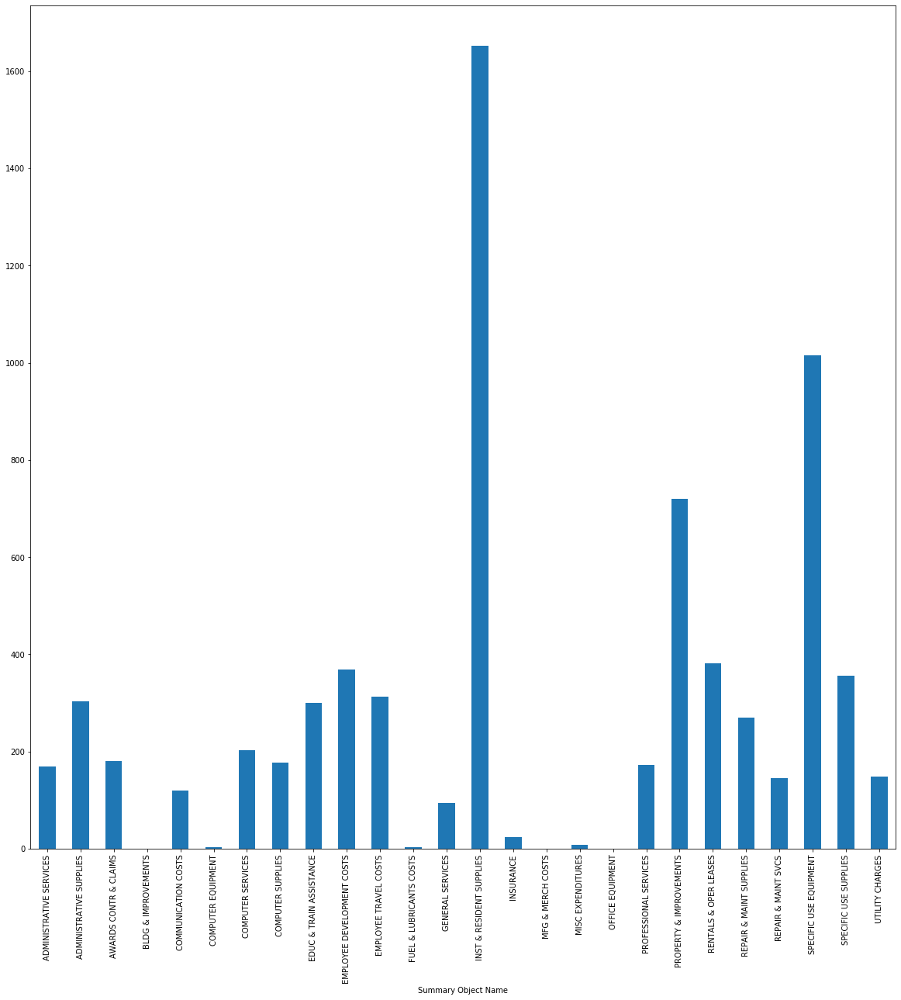

In [890]:
grouped_pcard_generic_summary_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_pcard_generic_summary_2018['Amount'].agg(np.mean)

Summary Object Name
ADMINISTRATIVE SERVICES           341.751528
ADMINISTRATIVE SUPPLIES           309.719802
AWARDS CONTR & CLAIMS             129.509524
BLDG & IMPROVEMENTS               252.320000
COMMUNICATION COSTS                65.393193
COMPUTER EQUIPMENT               1531.681667
COMPUTER SERVICES                 133.394474
COMPUTER SUPPLIES                 214.221567
EDUC & TRAIN ASSISTANCE           229.819737
EMPLOYEE DEVELOPMENT COSTS        380.693170
EMPLOYEE TRAVEL COSTS             316.505171
FED PMTS TO SUBGRANTEES             0.000000
FUEL & LUBRICANTS COSTS             3.086341
GENERAL SERVICES                   94.874507
INST & RESIDENT SUPPLIES          870.048943
INSURANCE                          12.440000
MFG & MERCH COSTS                  -1.725000
MISC EXPENDITURES                  17.018817
MOTORIZED/NON-MOTORIZED EQUIP    1093.950000
PROFESSIONAL SERVICES             125.018833
RENTALS & OPER LEASES             291.394000
REPAIR & MAINT SUPPLIES           3

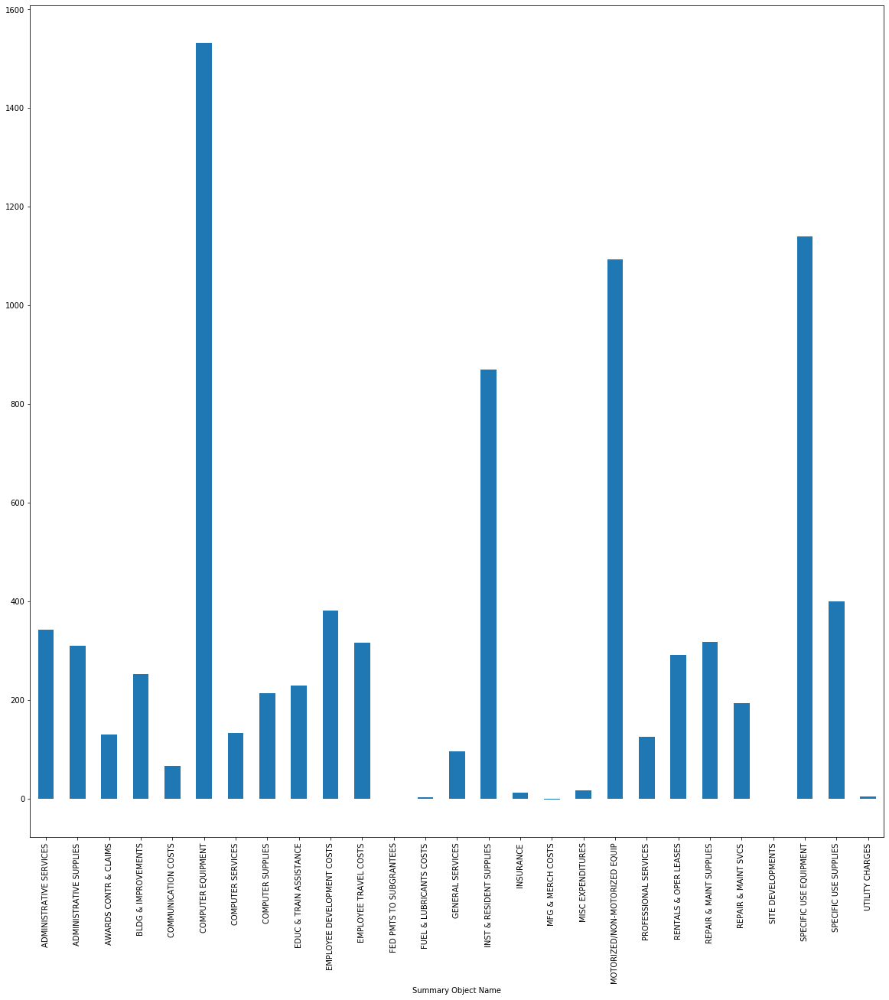

In [891]:
grouped_pcard_generic_summary_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_pcard_generic_summary_2019['Amount'].agg(np.mean)

In [892]:
grouped_pcard_generic_summary_mean_2018 = grouped_pcard_generic_summary_2018['Amount'].agg(np.mean)
grouped_pcard_generic_summary_max_mean_2018 = grouped_pcard_generic_summary_mean_2018.max()
grouped_pcard_generic_summary_name_mean_2018 = grouped_pcard_generic_summary_mean_2018.idxmax()
grouped_pcard_generic_summary_name_mean_2018= grouped_pcard_generic_summary_name_mean_2018.strip()

grouped_pcard_generic_summary_mean_2019 = grouped_pcard_generic_summary_2019['Amount'].agg(np.mean)
grouped_pcard_generic_summary_max_mean_2019 = grouped_pcard_generic_summary_mean_2019.max()
grouped_pcard_generic_summary_name_mean_2019 = grouped_pcard_generic_summary_mean_2019.idxmax()
grouped_pcard_generic_summary_name_mean_2019 = grouped_pcard_generic_summary_name_mean_2019.strip()

print("For 2018, " + grouped_pcard_generic_summary_name_mean_2018 + " had the most expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_pcard_generic_summary_name_mean_2019 + " had the most expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at " + str(grouped_pcard_generic_summary_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_pcard_generic_summary_max_mean_2019 - grouped_pcard_generic_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, INST & RESIDENT SUPPLIES had the most expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at 1652.8991363636353.
For 2019, COMPUTER EQUIPMENT had the most expenditure for the average cost of Pcard Generic Vendor from the Substistence In-State at 1531.6816666666666.


In [893]:
grouped_lodging_instate_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'LODGING - IN STATE'].groupby('Vendor Name')

In [894]:
grouped_lodging_instate_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'LODGING - IN STATE'].groupby('Vendor Name')

In [895]:
grouped_lodging_instate_vendor_sum_2018 = grouped_lodging_instate_vendor_2018['Amount'].agg(np.sum)
grouped_lodging_instate_vendor_max_sum_2018 = grouped_lodging_instate_vendor_sum_2018.max()
grouped_lodging_instate_vendor_name_sum_2018 = grouped_lodging_instate_vendor_sum_2018.idxmax()
grouped_lodging_instate_vendor_name_sum_2018= grouped_lodging_instate_vendor_name_sum_2018.strip()

grouped_lodging_instate_vendor_sum_2019 = grouped_lodging_instate_vendor_2019['Amount'].agg(np.sum)
grouped_lodging_instate_vendor_max_sum_2019 = grouped_lodging_instate_vendor_sum_2019.max()
grouped_lodging_instate_vendor_name_sum_2019 = grouped_lodging_instate_vendor_sum_2019.idxmax()
grouped_lodging_instate_vendor_name_sum_2019 = grouped_lodging_instate_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_lodging_instate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Lodging - In State at " + str(grouped_lodging_instate_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_lodging_instate_vendor_name_sum_2019 + " had the most expenditure for the total cost of Lodging - In State at " + str(grouped_lodging_instate_vendor_max_sum_2019) + ".")
#print("The average increase/decrease was " + str(grouped_lodging_instate_vendor_max_sum_2019 - grouped_lodging_instate_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, BOISE HOTEL PARTNERS LC had the most expenditure for the total cost of Lodging - In State at 255343.82.
For 2019, RIVERSIDE HOSPITALITY LLC had the most expenditure for the total cost of Lodging - In State at 213963.24000000002.


In [896]:
grouped_lodging_instate_vendor_mean_2018 = grouped_lodging_instate_vendor_2018['Amount'].agg(np.mean)
grouped_lodging_instate_vendor_max_mean_2018 = grouped_lodging_instate_vendor_mean_2018.max()
grouped_lodging_instate_vendor_name_mean_2018 = grouped_lodging_instate_vendor_mean_2018.idxmax()
grouped_lodging_instate_vendor_name_mean_2018= grouped_lodging_instate_vendor_name_mean_2018.strip()

grouped_lodging_instate_vendor_mean_2019 = grouped_lodging_instate_vendor_2019['Amount'].agg(np.mean)
grouped_lodging_instate_vendor_max_mean_2019 = grouped_lodging_instate_vendor_mean_2019.max()
grouped_lodging_instate_vendor_name_mean_2019 = grouped_lodging_instate_vendor_mean_2019.idxmax()
grouped_lodging_instate_vendor_name_mean_2019 = grouped_lodging_instate_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_lodging_instate_vendor_name_mean_2018 + " had the most expenditure for the average cost of Lodging - In State at " + str(grouped_lodging_instate_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_lodging_instate_vendor_name_mean_2019 + " had the most expenditure for the average cost of Lodging - In State at " + str(grouped_lodging_instate_vendor_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_lodging_instate_vendor_max_mean_2019 - grouped_lodging_instate_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, PCARD - TRINITY PINES CAMP AND CO had the most expenditure for the average cost of Lodging - In State at 5911.0.
For 2019, LAURENCE H NELSON had the most expenditure for the average cost of Lodging - In State at 5780.0.


Agency Name
ADMINISTRATION, DEPARTMENT OF               651.00
AGING, COMMISSION ON                       1112.00
CORRECTION, DEPARTMENT OF                 93642.40
ENVIRONMENTAL QUALITY, DEPARTMENT OF      16242.83
FISH AND GAME, DEPARTMENT OF               1257.25
HEALTH AND WELFARE, DEPARTMENT OF         20006.00
HEALTH DISTRICT 1 (PANHANDLE)               819.00
HEALTH DISTRICT 7 (EASTERN)                 554.00
INSURANCE FUND, STATE                       890.00
INSURANCE, DEPARTMENT OF                    819.00
JUDICIAL BRANCH                             166.00
JUVENILE CORRECTIONS, DEPARTMENT OF        6038.00
LABOR, DEPARTMENT OF                       4983.00
OCCUPATIONAL LICENSES, BUREAU OF           1765.60
OUTFITTERS AND GUIDES LICENSING BOARD      1573.00
TAX COMMISSION, IDAHO STATE                9202.00
TRANSPORTATION, DEPARTMENT OF            122202.14
WATER RESOURCES, DEPARTMENT OF             2311.00
Name: Amount, dtype: float64

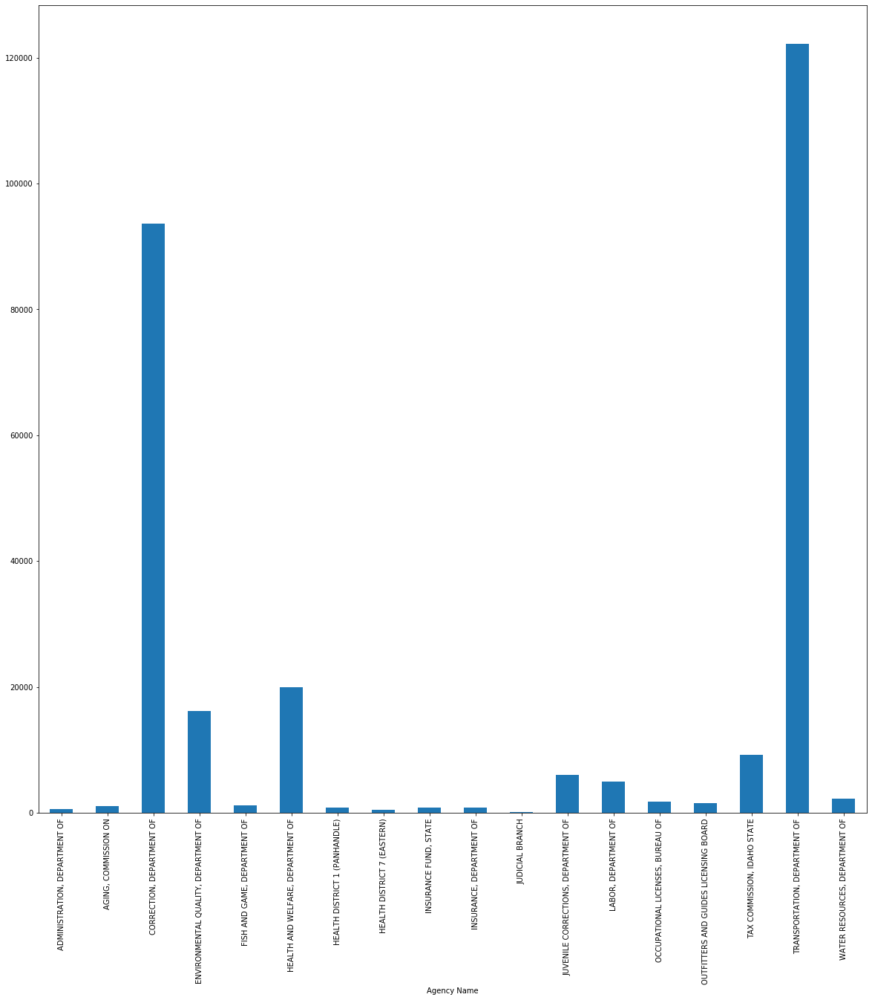

In [897]:
grouped_boise_hotel_agency_2018 = fy2018[fy2018['Vendor Name'] == 'BOISE HOTEL PARTNERS LC'].groupby('Agency Name')
grouped_boise_hotel_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_boise_hotel_agency_2018['Amount'].agg(np.sum)

Agency Name
ADMINISTRATION, DEPARTMENT OF               282.00
AGING, COMMISSION ON                       1313.00
CORRECTION, DEPARTMENT OF                104184.04
EDUCATION, STATE DEPARTMENT OF              188.00
ENVIRONMENTAL QUALITY, DEPARTMENT OF      11482.00
FISH AND GAME, DEPARTMENT OF               1313.66
HEALTH AND WELFARE, DEPARTMENT OF         17068.00
HEALTH DISTRICT 2 (NORTH CENTRAL)           282.00
HEALTH DISTRICT 4 (CENTRAL)                 843.00
HEALTH DISTRICT 7 (EASTERN)                 844.00
INSURANCE, DEPARTMENT OF                    280.00
JUDICIAL BRANCH                             426.00
JUVENILE CORRECTIONS, DEPARTMENT OF        3642.00
LABOR, DEPARTMENT OF                       5508.00
OCCUPATIONAL LICENSES, BUREAU OF            656.00
OUTFITTERS AND GUIDES LICENSING BOARD      2150.00
TAX COMMISSION, IDAHO STATE                3784.00
TRANSPORTATION, DEPARTMENT OF             78707.09
WATER RESOURCES, DEPARTMENT OF             2170.00
Name: Amount, dtype

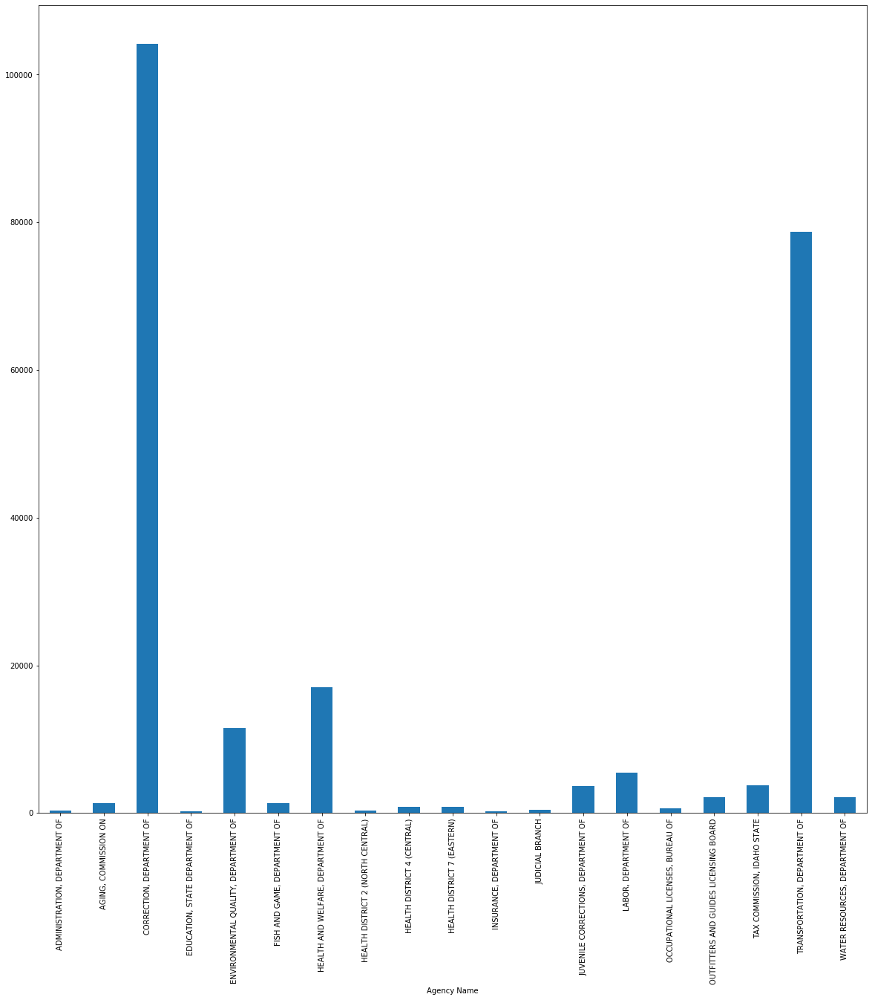

In [898]:
grouped_boise_hotel_agency_2019 = fy2019[fy2019['Vendor Name'] == 'BOISE HOTEL PARTNERS LC'].groupby('Agency Name')
grouped_boise_hotel_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_boise_hotel_agency_2019['Amount'].agg(np.sum)

In [899]:
grouped_boise_hotel_agency_sum_2018 = grouped_boise_hotel_agency_2018['Amount'].agg(np.sum)
grouped_boise_hotel_agency_max_sum_2018 = grouped_boise_hotel_agency_sum_2018.max()
grouped_boise_hotel_agency_name_sum_2018 = grouped_boise_hotel_agency_sum_2018.idxmax()
grouped_boise_hotel_agency_name_sum_2018= grouped_boise_hotel_agency_name_sum_2018.strip()

grouped_boise_hotel_agency_sum_2019 = grouped_boise_hotel_agency_2019['Amount'].agg(np.sum)
grouped_boise_hotel_agency_max_sum_2019 = grouped_boise_hotel_agency_sum_2019.max()
grouped_boise_hotel_agency_name_sum_2019 = grouped_boise_hotel_agency_sum_2019.idxmax()
grouped_boise_hotel_agency_name_sum_2019 = grouped_boise_hotel_agency_name_sum_2019.strip()

print("For 2018, " + grouped_boise_hotel_agency_name_sum_2018 + " had the most expenditure for the total cost of Boise Hotel Partners LC from the Lodging - In State at " + str(grouped_boise_hotel_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_boise_hotel_agency_name_sum_2019 + " had the most expenditure for the total cost of Boise Hotel Partners LC from the Lodging - In State at " + str(grouped_boise_hotel_agency_max_sum_2019) + ".")
#print("The average increase/decrease was " + str(grouped_boise_hotel_agency_max_sum_2019 - grouped_boise_hotel_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, TRANSPORTATION, DEPARTMENT OF had the most expenditure for the total cost of Boise Hotel Partners LC from the Lodging - In State at 122202.14.
For 2019, CORRECTION, DEPARTMENT OF had the most expenditure for the total cost of Boise Hotel Partners LC from the Lodging - In State at 104184.04.


Agency Name
ADMINISTRATION, DEPARTMENT OF             651.000000
AGING, COMMISSION ON                      278.000000
CORRECTION, DEPARTMENT OF                 454.574757
ENVIRONMENTAL QUALITY, DEPARTMENT OF      222.504521
FISH AND GAME, DEPARTMENT OF              179.607143
HEALTH AND WELFARE, DEPARTMENT OF         307.784615
HEALTH DISTRICT 1 (PANHANDLE)             819.000000
HEALTH DISTRICT 7 (EASTERN)               138.500000
INSURANCE FUND, STATE                     296.666667
INSURANCE, DEPARTMENT OF                  204.750000
JUDICIAL BRANCH                            83.000000
JUVENILE CORRECTIONS, DEPARTMENT OF       194.774194
LABOR, DEPARTMENT OF                      311.437500
OCCUPATIONAL LICENSES, BUREAU OF          147.133333
OUTFITTERS AND GUIDES LICENSING BOARD     393.250000
TAX COMMISSION, IDAHO STATE              1840.400000
TRANSPORTATION, DEPARTMENT OF             492.750565
WATER RESOURCES, DEPARTMENT OF            192.583333
Name: Amount, dtype: float64

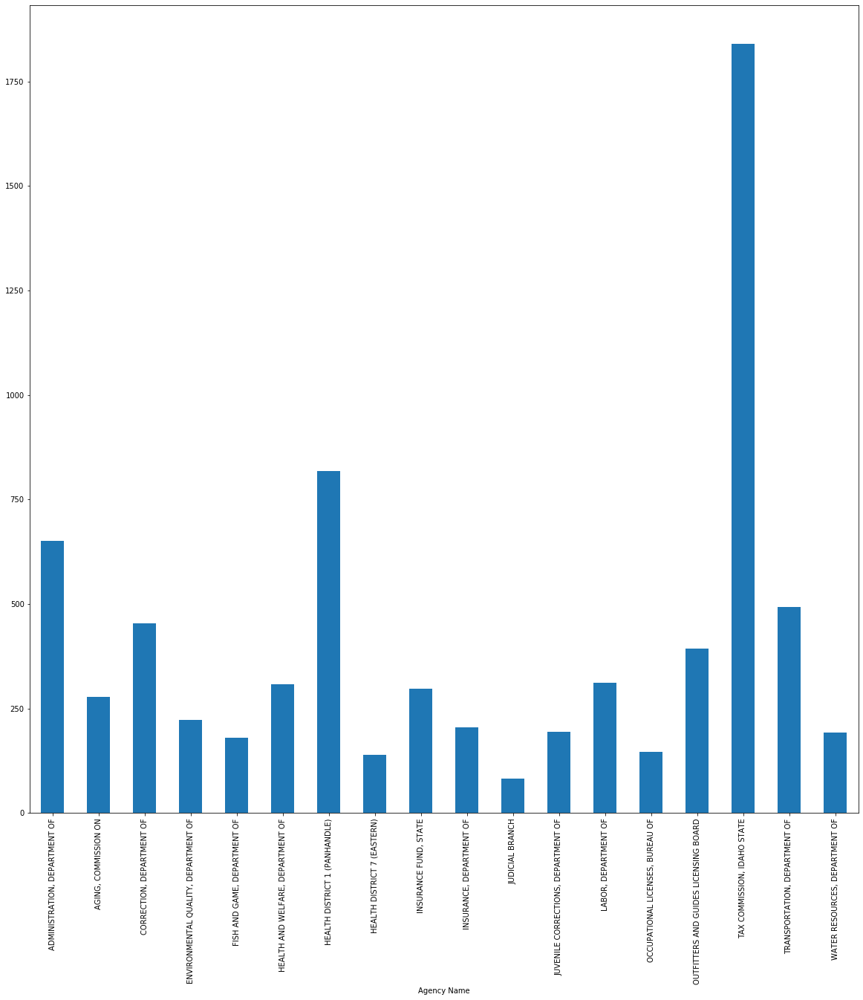

In [900]:
grouped_boise_hotel_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_boise_hotel_agency_2018['Amount'].agg(np.mean)

Agency Name
ADMINISTRATION, DEPARTMENT OF            282.000000
AGING, COMMISSION ON                     328.250000
CORRECTION, DEPARTMENT OF                500.884808
EDUCATION, STATE DEPARTMENT OF           188.000000
ENVIRONMENTAL QUALITY, DEPARTMENT OF     212.629630
FISH AND GAME, DEPARTMENT OF             262.732000
HEALTH AND WELFARE, DEPARTMENT OF        334.666667
HEALTH DISTRICT 2 (NORTH CENTRAL)        282.000000
HEALTH DISTRICT 4 (CENTRAL)              120.428571
HEALTH DISTRICT 7 (EASTERN)              105.500000
INSURANCE, DEPARTMENT OF                 140.000000
JUDICIAL BRANCH                          106.500000
JUVENILE CORRECTIONS, DEPARTMENT OF      145.680000
LABOR, DEPARTMENT OF                     367.200000
OCCUPATIONAL LICENSES, BUREAU OF         164.000000
OUTFITTERS AND GUIDES LICENSING BOARD    430.000000
TAX COMMISSION, IDAHO STATE              946.000000
TRANSPORTATION, DEPARTMENT OF            382.073252
WATER RESOURCES, DEPARTMENT OF           217.000000


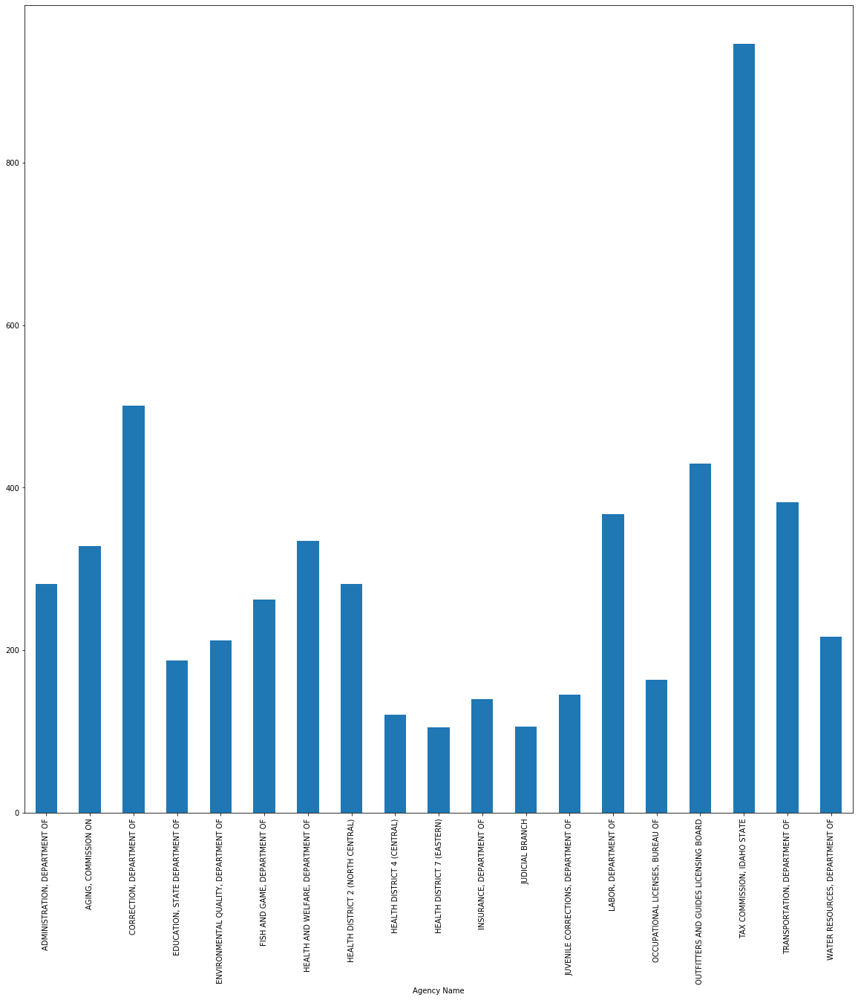

In [901]:
grouped_boise_hotel_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_boise_hotel_agency_2019['Amount'].agg(np.mean)

In [902]:
grouped_boise_hotel_agency_mean_2018 = grouped_boise_hotel_agency_2018['Amount'].agg(np.mean)
grouped_boise_hotel_agency_max_mean_2018 = grouped_boise_hotel_agency_mean_2018.max()
grouped_boise_hotel_agency_name_mean_2018 = grouped_boise_hotel_agency_mean_2018.idxmax()
grouped_boise_hotel_agency_name_mean_2018= grouped_boise_hotel_agency_name_mean_2018.strip()

grouped_boise_hotel_agency_mean_2019 = grouped_boise_hotel_agency_2019['Amount'].agg(np.mean)
grouped_boise_hotel_agency_max_mean_2019 = grouped_boise_hotel_agency_mean_2019.max()
grouped_boise_hotel_agency_name_mean_2019 = grouped_boise_hotel_agency_mean_2019.idxmax()
grouped_boise_hotel_agency_name_mean_2019 = grouped_boise_hotel_agency_name_mean_2019.strip()

print("For 2018, " + grouped_boise_hotel_agency_name_mean_2018 + " had the most expenditure for the average cost of Boise Hotel Partners LC from the Lodging - In State at " + str(grouped_boise_hotel_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_boise_hotel_agency_name_mean_2019 + " had the most expenditure for the average cost of Boise Hotel Partners LC from the Lodging - In State at " + str(grouped_boise_hotel_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_hotel_agency_max_mean_2019 - grouped_boise_hotel_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, TAX COMMISSION, IDAHO STATE had the most expenditure for the average cost of Boise Hotel Partners LC from the Lodging - In State at 1840.4.
For 2019, TAX COMMISSION, IDAHO STATE had the most expenditure for the average cost of Boise Hotel Partners LC from the Lodging - In State at 946.0.
The average increase/decrease was -894.4000000000001 between 2018 and 2019.


Summary Object Name
EMPLOYEE DEVELOPMENT COSTS       890.00
EMPLOYEE TRAVEL COSTS         277486.22
MISC EXPENDITURES               1088.00
NON FED PMTS SUBGRANTEES        3720.00
RENTALS & OPER LEASES           1050.00
Name: Amount, dtype: float64

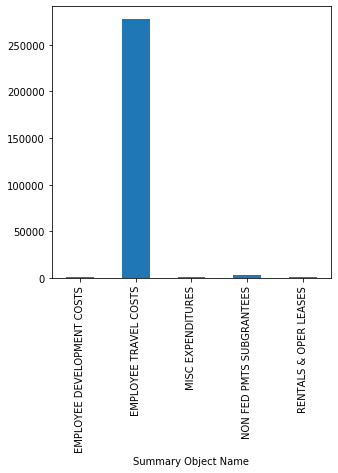

In [903]:
grouped_boise_hotel_summary_2018 = fy2018[fy2018['Vendor Name'] == 'BOISE HOTEL PARTNERS LC'].groupby('Summary Object Name')
grouped_boise_hotel_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(5,5))
grouped_boise_hotel_summary_2018['Amount'].agg(np.sum)

Summary Object Name
EMPLOYEE TRAVEL COSTS    227627.79
MISC EXPENDITURES          3182.00
MISC PMTS AS AGENT           93.00
RENTALS & OPER LEASES      4220.00
Name: Amount, dtype: float64

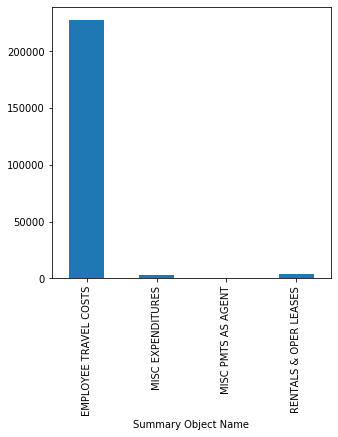

In [904]:
grouped_boise_hotel_summary_2019 = fy2019[fy2019['Vendor Name'] == 'BOISE HOTEL PARTNERS LC'].groupby('Summary Object Name')
grouped_boise_hotel_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(5,5))
grouped_boise_hotel_summary_2019['Amount'].agg(np.sum)

In [905]:
grouped_boise_hotel_summary_sum_2018 = grouped_boise_hotel_summary_2018['Amount'].agg(np.sum)
grouped_boise_hotel_summary_max_sum_2018 = grouped_boise_hotel_summary_sum_2018.max()
grouped_boise_hotel_summary_name_sum_2018 = grouped_boise_hotel_summary_sum_2018.idxmax()
grouped_boise_hotel_summary_name_sum_2018= grouped_boise_hotel_summary_name_sum_2018.strip()

grouped_boise_hotel_summary_sum_2019 = grouped_boise_hotel_summary_2019['Amount'].agg(np.sum)
grouped_boise_hotel_summary_max_sum_2019 = grouped_boise_hotel_summary_sum_2019.max()
grouped_boise_hotel_summary_name_sum_2019 = grouped_boise_hotel_summary_sum_2019.idxmax()
grouped_boise_hotel_summary_name_sum_2019 = grouped_boise_hotel_summary_name_sum_2019.strip()

print("For 2018, " + grouped_boise_hotel_summary_name_sum_2018 + " had the most expenditure for the total cost of Boise Hotel Partners LC from the Lodging - In State at " + str(grouped_boise_hotel_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_boise_hotel_summary_name_sum_2019 + " had the most expenditure for the total cost of Boise Hotel Partners LC from the Lodging - In State at " + str(grouped_boise_hotel_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_hotel_summary_max_sum_2019 - grouped_boise_hotel_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEE TRAVEL COSTS had the most expenditure for the total cost of Boise Hotel Partners LC from the Lodging - In State at 277486.22.
For 2019, EMPLOYEE TRAVEL COSTS had the most expenditure for the total cost of Boise Hotel Partners LC from the Lodging - In State at 227627.78999999998.
The average increase/decrease was -49858.42999999999 between 2018 and 2019.


Summary Object Name
EMPLOYEE DEVELOPMENT COSTS     296.666667
EMPLOYEE TRAVEL COSTS          406.275578
MISC EXPENDITURES              136.000000
NON FED PMTS SUBGRANTEES      1860.000000
RENTALS & OPER LEASES          525.000000
Name: Amount, dtype: float64

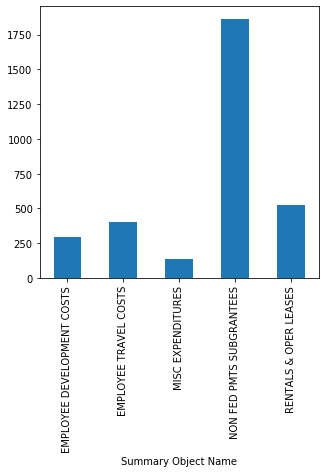

In [906]:
grouped_boise_hotel_summary_2018['Amount'].agg(np.mean).plot.bar(figsize=(5,5))
grouped_boise_hotel_summary_2018['Amount'].agg(np.mean)

Summary Object Name
EMPLOYEE TRAVEL COSTS    383.211768
MISC EXPENDITURES        353.555556
MISC PMTS AS AGENT        93.000000
RENTALS & OPER LEASES    383.636364
Name: Amount, dtype: float64

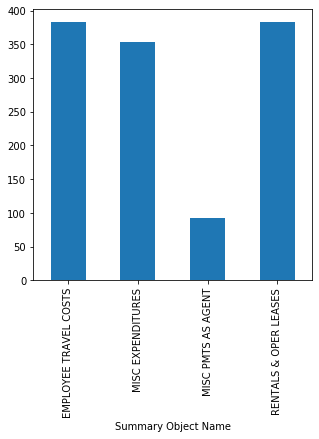

In [907]:
grouped_boise_hotel_summary_2019['Amount'].agg(np.mean).plot.bar(figsize=(5,5))
grouped_boise_hotel_summary_2019['Amount'].agg(np.mean)

In [908]:
grouped_boise_hotel_summary_mean_2018 = grouped_boise_hotel_summary_2018['Amount'].agg(np.mean)
grouped_boise_hotel_summary_max_mean_2018 = grouped_boise_hotel_summary_mean_2018.max()
grouped_boise_hotel_summary_name_mean_2018 = grouped_boise_hotel_summary_mean_2018.idxmax()
grouped_boise_hotel_summary_name_mean_2018= grouped_boise_hotel_summary_name_mean_2018.strip()

grouped_boise_hotel_summary_mean_2019 = grouped_boise_hotel_summary_2019['Amount'].agg(np.mean)
grouped_boise_hotel_summary_max_mean_2019 = grouped_boise_hotel_summary_mean_2019.max()
grouped_boise_hotel_summary_name_mean_2019 = grouped_boise_hotel_summary_mean_2019.idxmax()
grouped_boise_hotel_summary_name_mean_2019 = grouped_boise_hotel_summary_name_mean_2019.strip()

print("For 2018, " + grouped_boise_hotel_summary_name_mean_2018 + " had the most expenditure for the average cost of Boise Hotel Partners LC from the Lodging - In State at " + str(grouped_boise_hotel_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_boise_hotel_summary_name_mean_2019 + " had the most expenditure for the average cost of Boise Hotel Partners LC from the Lodging - In State at " + str(grouped_boise_hotel_summary_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_boise_hotel_summary_max_mean_2019 - grouped_boise_hotel_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, NON FED PMTS SUBGRANTEES had the most expenditure for the average cost of Boise Hotel Partners LC from the Lodging - In State at 1860.0.
For 2019, RENTALS & OPER LEASES had the most expenditure for the average cost of Boise Hotel Partners LC from the Lodging - In State at 383.6363636363636.


Agency Name
ACCOUNTANCY, STATE BOARD OF                  1205.00
AGING, COMMISSION ON                         1814.40
ARTS, IDAHO COMMISSION ON THE                5148.09
CAREER-TECHNICAL EDUCATION, DIVISION OF     96016.90
COMMERCE, DEPARTMENT OF                     19373.12
CONSERVATION, SOIL AND WATER COMMISSION       432.53
CORRECTION, DEPARTMENT OF                    3449.60
EDUCATION, STATE BOARD OF                   12698.64
EDUCATION, STATE DEPARTMENT OF              34009.07
ENVIRONMENTAL QUALITY, DEPARTMENT OF         6566.00
FISH AND GAME, DEPARTMENT OF                  786.00
HEALTH AND WELFARE, DEPARTMENT OF          135451.33
HEALTH DISTRICT 6 (SOUTHEASTERN)                0.00
HISTORICAL SOCIETY, IDAHO STATE               910.00
INSURANCE FUND, STATE                        1395.00
INSURANCE, DEPARTMENT OF                     1183.60
JUDICIAL BRANCH                            104146.12
JUVENILE CORRECTIONS, DEPARTMENT OF           117.00
LABOR, DEPARTMENT OF              

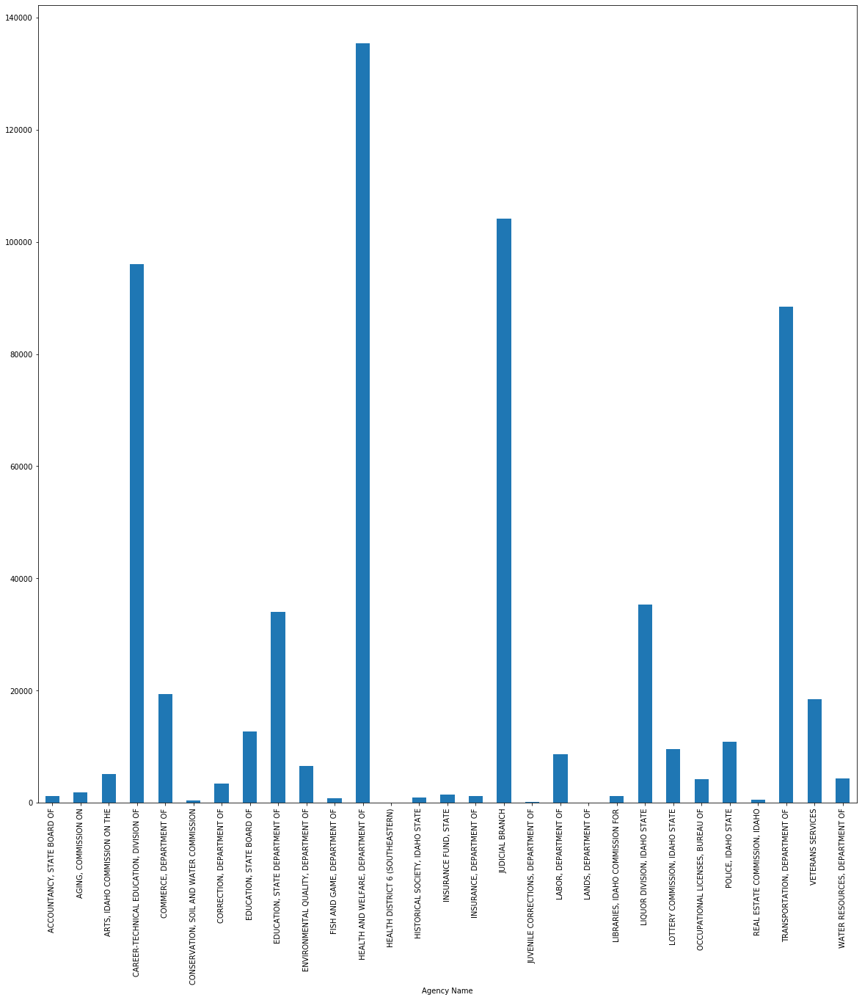

In [909]:
grouped_riverside_agency_2018 = fy2018[fy2018['Vendor Name'] == 'RIVERSIDE HOSPITALITY LLC'].groupby('Agency Name')
grouped_riverside_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_riverside_agency_2018['Amount'].agg(np.sum)

Agency Name
ACCOUNTANCY, STATE BOARD OF                           564.00
AGING, COMMISSION ON                                 8966.20
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE       392.00
CAREER-TECHNICAL EDUCATION, DIVISION OF             75394.22
COMMERCE, DEPARTMENT OF                             26438.31
CORRECTION, DEPARTMENT OF                            1989.70
EDUCATION, STATE BOARD OF                           17794.64
EDUCATION, STATE DEPARTMENT OF                      69702.30
ENVIRONMENTAL QUALITY, DEPARTMENT OF                79256.60
HEALTH AND WELFARE, DEPARTMENT OF                  136361.25
HEALTH DISTRICT 1 (PANHANDLE)                        1044.00
HEALTH DISTRICT 2 (NORTH CENTRAL)                    1316.00
HEALTH DISTRICT 4 (CENTRAL)                          1428.00
HEALTH DISTRICT 6 (SOUTHEASTERN)                      470.00
INSURANCE FUND, STATE                                 932.00
INSURANCE, DEPARTMENT OF                            10273.00
JUDICIAL BRA

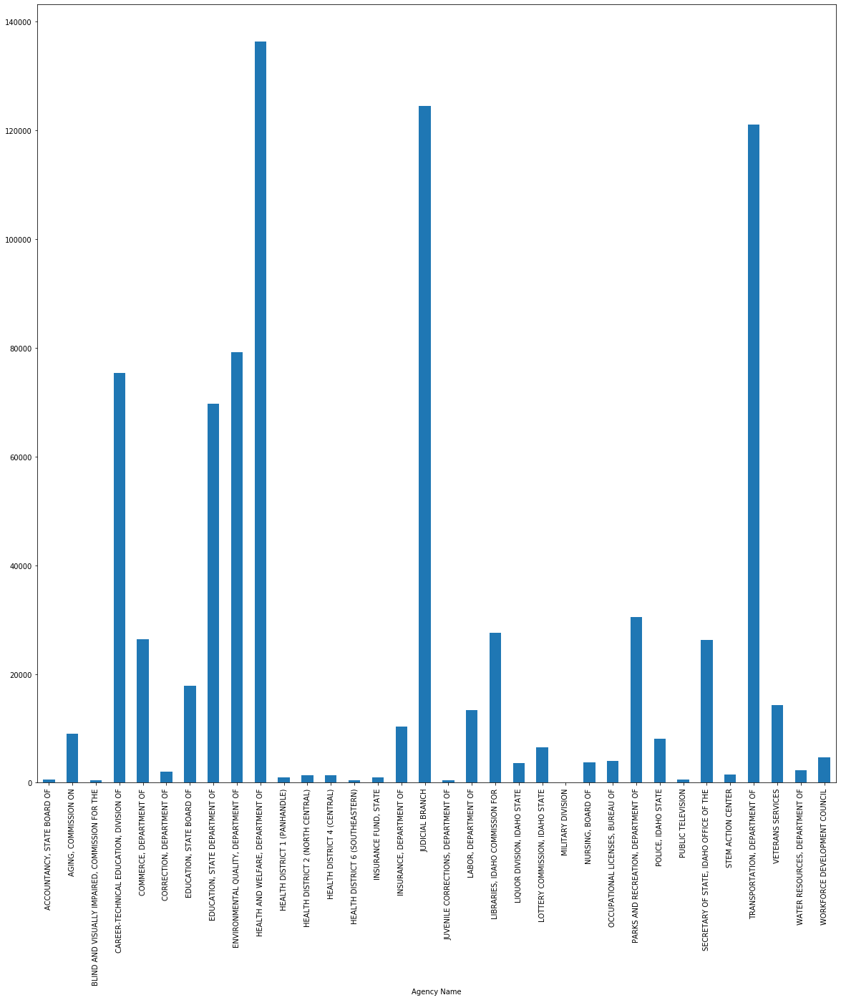

In [910]:
grouped_riverside_agency_2019 = fy2019[fy2019['Vendor Name'] == 'RIVERSIDE HOSPITALITY LLC'].groupby('Agency Name')
grouped_riverside_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_riverside_agency_2019['Amount'].agg(np.sum)

In [911]:
grouped_riverside_agency_sum_2018 = grouped_riverside_agency_2018['Amount'].agg(np.sum)
grouped_riverside_agency_max_sum_2018 = grouped_riverside_agency_sum_2018.max()
grouped_riverside_agency_name_sum_2018 = grouped_riverside_agency_sum_2018.idxmax()
grouped_riverside_agency_name_sum_2018= grouped_riverside_agency_name_sum_2018.strip()

grouped_riverside_agency_sum_2019 = grouped_riverside_agency_2019['Amount'].agg(np.sum)
grouped_riverside_agency_max_sum_2019 = grouped_riverside_agency_sum_2019.max()
grouped_riverside_agency_name_sum_2019 = grouped_riverside_agency_sum_2019.idxmax()
grouped_riverside_agency_name_sum_2019 = grouped_riverside_agency_name_sum_2019.strip()

print("For 2018, " + grouped_riverside_agency_name_sum_2018 + " had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State at " + str(grouped_riverside_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_riverside_agency_name_sum_2019 + " had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State at " + str(grouped_riverside_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_riverside_agency_max_sum_2019 - grouped_riverside_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State at 135451.33000000002.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State at 136361.25000000003.
The average increase/decrease was 909.9200000000128 between 2018 and 2019.


Agency Name
ACCOUNTANCY, STATE BOARD OF                 301.250000
AGING, COMMISSION ON                        907.200000
ARTS, IDAHO COMMISSION ON THE              1287.022500
CAREER-TECHNICAL EDUCATION, DIVISION OF    2824.026471
COMMERCE, DEPARTMENT OF                    1937.312000
CONSERVATION, SOIL AND WATER COMMISSION     144.176667
CORRECTION, DEPARTMENT OF                   344.960000
EDUCATION, STATE BOARD OF                  4232.880000
EDUCATION, STATE DEPARTMENT OF             1133.635667
ENVIRONMENTAL QUALITY, DEPARTMENT OF        218.866667
FISH AND GAME, DEPARTMENT OF                786.000000
HEALTH AND WELFARE, DEPARTMENT OF          1631.943735
HEALTH DISTRICT 6 (SOUTHEASTERN)              0.000000
HISTORICAL SOCIETY, IDAHO STATE             303.333333
INSURANCE FUND, STATE                       232.500000
INSURANCE, DEPARTMENT OF                    394.533333
JUDICIAL BRANCH                            2814.760000
JUVENILE CORRECTIONS, DEPARTMENT OF          39.00000

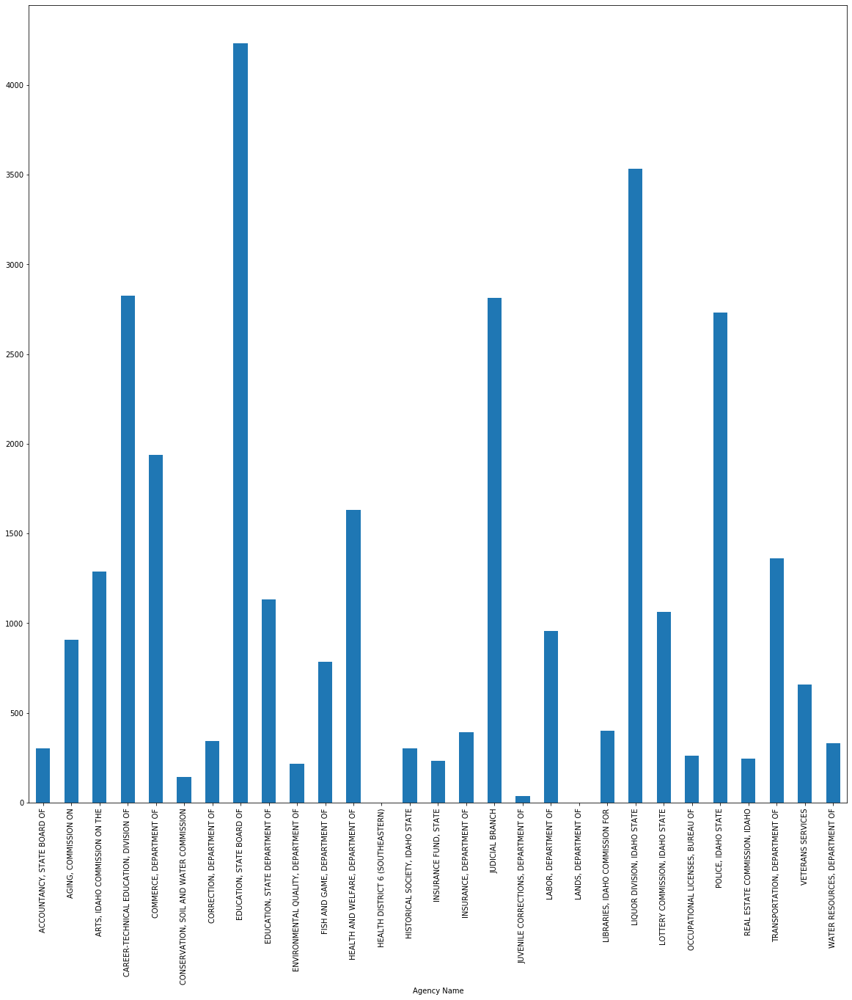

In [912]:
grouped_riverside_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_riverside_agency_2018['Amount'].agg(np.mean)

Agency Name
ACCOUNTANCY, STATE BOARD OF                          282.000000
AGING, COMMISSION ON                                4483.100000
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE      392.000000
CAREER-TECHNICAL EDUCATION, DIVISION OF             8377.135556
COMMERCE, DEPARTMENT OF                             2403.482727
CORRECTION, DEPARTMENT OF                            284.242857
EDUCATION, STATE BOARD OF                           3558.928000
EDUCATION, STATE DEPARTMENT OF                      1124.230645
ENVIRONMENTAL QUALITY, DEPARTMENT OF                2085.700000
HEALTH AND WELFARE, DEPARTMENT OF                   2066.079545
HEALTH DISTRICT 1 (PANHANDLE)                       1044.000000
HEALTH DISTRICT 2 (NORTH CENTRAL)                    658.000000
HEALTH DISTRICT 4 (CENTRAL)                         1428.000000
HEALTH DISTRICT 6 (SOUTHEASTERN)                     156.666667
INSURANCE FUND, STATE                                233.000000
INSURANCE, DEPARTMENT OF    

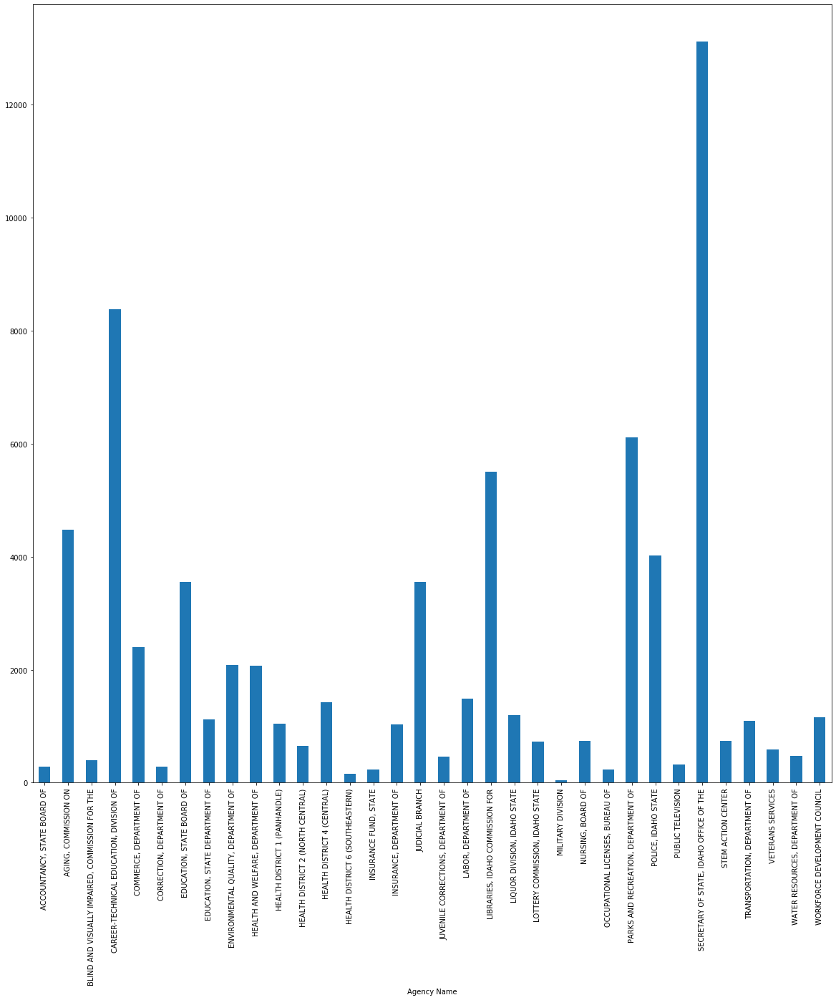

In [913]:
grouped_riverside_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_riverside_agency_2019['Amount'].agg(np.mean)

In [914]:
grouped_riverside_agency_mean_2018 = grouped_riverside_agency_2018['Amount'].agg(np.mean)
grouped_riverside_agency_max_mean_2018 = grouped_riverside_agency_mean_2018.max()
grouped_riverside_agency_name_mean_2018 = grouped_riverside_agency_mean_2018.idxmax()
grouped_riverside_agency_name_mean_2018= grouped_riverside_agency_name_mean_2018.strip()

grouped_riverside_agency_mean_2019 = grouped_riverside_agency_2019['Amount'].agg(np.mean)
grouped_riverside_agency_max_mean_2019 = grouped_riverside_agency_mean_2019.max()
grouped_riverside_agency_name_mean_2019 = grouped_riverside_agency_mean_2019.idxmax()
grouped_riverside_agency_name_mean_2019 = grouped_riverside_agency_name_mean_2019.strip()

print("For 2018, " + grouped_riverside_agency_name_mean_2018 + " had the most expenditure for the average cost of Riverside Hospitality LLC from the Lodging - In State at " + str(grouped_riverside_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_riverside_agency_name_mean_2019 + " had the most expenditure for the average cost of Riverside Hospitality LLC from the Lodging - In State at " + str(grouped_riverside_agency_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_riverside_agency_max_mean_2019 - grouped_riverside_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, EDUCATION, STATE BOARD OF had the most expenditure for the average cost of Riverside Hospitality LLC from the Lodging - In State at 4232.88.
For 2019, SECRETARY OF STATE, IDAHO OFFICE OF THE had the most expenditure for the average cost of Riverside Hospitality LLC from the Lodging - In State at 13117.6.


Summary Object Name
ADMINISTRATIVE SERVICES           12.00
EMPLOYEE DEVELOPMENT COSTS      1674.00
EMPLOYEE TRAVEL COSTS         412361.06
GENERAL SERVICES                8718.00
MISC EXPENDITURES              57944.30
RENTALS & OPER LEASES         125577.42
Name: Amount, dtype: float64

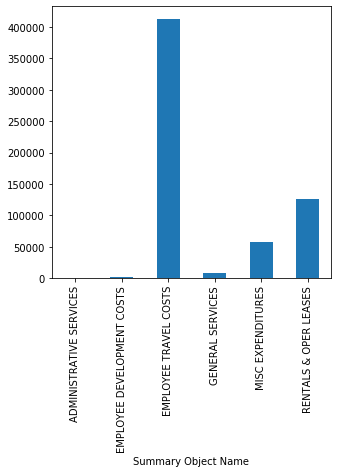

In [915]:
grouped_riverside_summary_2018 = fy2018[fy2018['Vendor Name'] == 'RIVERSIDE HOSPITALITY LLC'].groupby('Summary Object Name')
grouped_riverside_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(5,5))
grouped_riverside_summary_2018['Amount'].agg(np.sum)

Summary Object Name
ADMINISTRATIVE SERVICES         -898.00
EDUC & TRAIN ASSISTANCE          693.00
EMPLOYEE DEVELOPMENT COSTS       932.00
EMPLOYEE TRAVEL COSTS         525756.45
GENERAL SERVICES               10376.00
MISC EXPENDITURES             123042.08
PROFESSIONAL SERVICES              0.00
RENTALS & OPER LEASES         165571.76
Name: Amount, dtype: float64

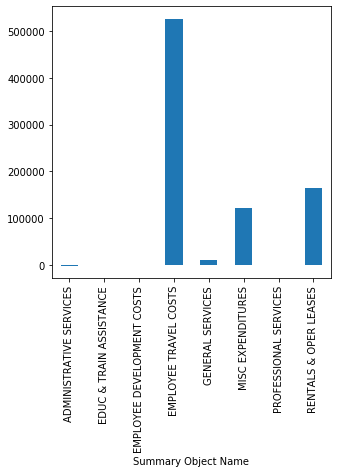

In [916]:
grouped_riverside_summary_2019 = fy2019[fy2019['Vendor Name'] == 'RIVERSIDE HOSPITALITY LLC'].groupby('Summary Object Name')
grouped_riverside_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(5,5))
grouped_riverside_summary_2019['Amount'].agg(np.sum)

In [917]:
grouped_riverside_summary_sum_2018 = grouped_riverside_summary_2018['Amount'].agg(np.sum)
grouped_riverside_summary_max_sum_2018 = grouped_riverside_summary_sum_2018.max()
grouped_riverside_summary_name_sum_2018 = grouped_riverside_summary_sum_2018.idxmax()
grouped_riverside_summary_name_sum_2018= grouped_riverside_summary_name_sum_2018.strip()

grouped_riverside_summary_sum_2019 = grouped_riverside_summary_2019['Amount'].agg(np.sum)
grouped_riverside_summary_max_sum_2019 = grouped_riverside_summary_sum_2019.max()
grouped_riverside_summary_name_sum_2019 = grouped_riverside_summary_sum_2019.idxmax()
grouped_riverside_summary_name_sum_2019 = grouped_riverside_summary_name_sum_2019.strip()

print("For 2018, " + grouped_riverside_summary_name_sum_2018 + " had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State at " + str(grouped_riverside_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_riverside_summary_name_sum_2019 + " had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State at " + str(grouped_riverside_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_riverside_summary_max_sum_2019 - grouped_riverside_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEE TRAVEL COSTS had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State at 412361.0599999998.
For 2019, EMPLOYEE TRAVEL COSTS had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State at 525756.4499999997.
The average increase/decrease was 113395.3899999999 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES         12.000000
EMPLOYEE DEVELOPMENT COSTS     239.142857
EMPLOYEE TRAVEL COSTS         1436.798118
GENERAL SERVICES              4359.000000
MISC EXPENDITURES             1136.162745
RENTALS & OPER LEASES         1569.717750
Name: Amount, dtype: float64

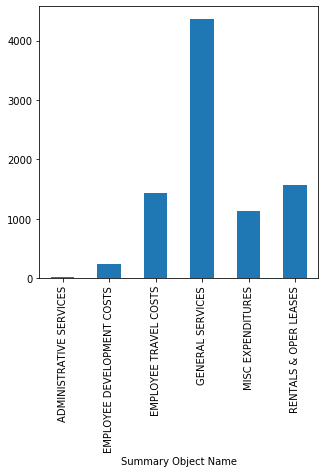

In [918]:
grouped_riverside_summary_2018['Amount'].agg(np.mean).plot.bar(figsize=(5,5))
grouped_riverside_summary_2018['Amount'].agg(np.mean)

Summary Object Name
ADMINISTRATIVE SERVICES       -299.333333
EDUC & TRAIN ASSISTANCE        693.000000
EMPLOYEE DEVELOPMENT COSTS     233.000000
EMPLOYEE TRAVEL COSTS         1723.791639
GENERAL SERVICES              5188.000000
MISC EXPENDITURES             2085.458983
PROFESSIONAL SERVICES            0.000000
RENTALS & OPER LEASES         1860.356854
Name: Amount, dtype: float64

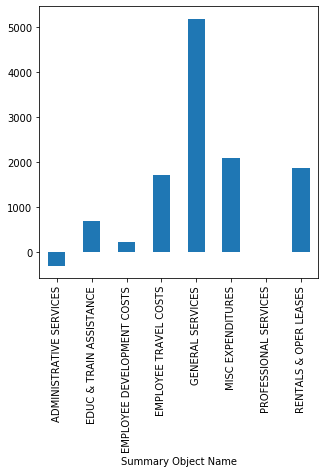

In [919]:
grouped_riverside_summary_2019['Amount'].agg(np.mean).plot.bar(figsize=(5,5))
grouped_riverside_summary_2019['Amount'].agg(np.mean)

In [920]:
grouped_riverside_summary_mean_2018 = grouped_riverside_summary_2018['Amount'].agg(np.mean)
grouped_riverside_summary_max_mean_2018 = grouped_riverside_summary_mean_2018.max()
grouped_riverside_summary_name_mean_2018 = grouped_riverside_summary_mean_2018.idxmax()
grouped_riverside_summary_name_mean_2018= grouped_riverside_summary_name_mean_2018.strip()

grouped_riverside_summary_mean_2019 = grouped_riverside_summary_2019['Amount'].agg(np.mean)
grouped_riverside_summary_max_mean_2019 = grouped_riverside_summary_mean_2019.max()
grouped_riverside_summary_name_mean_2019 = grouped_riverside_summary_mean_2019.idxmax()
grouped_riverside_summary_name_mean_2019 = grouped_riverside_summary_name_mean_2019.strip()

print("For 2018, " + grouped_riverside_summary_name_mean_2018 + " had the most expenditure for the average cost of Riverside Hospitality LLC from the Lodging - In State at " + str(grouped_riverside_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_riverside_summary_name_mean_2019 + " had the most expenditure for the average cost of Riverside Hospitality LLC from the Lodging - In State at " + str(grouped_riverside_summary_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_riverside_summary_max_mean_2019 - grouped_riverside_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, GENERAL SERVICES had the most expenditure for the average cost of Riverside Hospitality LLC from the Lodging - In State at 4359.0.
For 2019, GENERAL SERVICES had the most expenditure for the average cost of Riverside Hospitality LLC from the Lodging - In State at 5188.0.
The average increase/decrease was 829.0 between 2018 and 2019.


In [921]:
grouped_vehicle_instate_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'PERSONAL VEHICLE - IN-STATE'].groupby('Vendor Name')

In [922]:
grouped_vehicle_instate_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'PERSONAL VEHICLE - IN-STATE'].groupby('Vendor Name')

In [923]:
grouped_vehicle_instate_vendor_sum_2018 = grouped_vehicle_instate_vendor_2018['Amount'].agg(np.sum)
grouped_vehicle_instate_vendor_max_sum_2018 = grouped_vehicle_instate_vendor_sum_2018.max()
grouped_vehicle_instate_vendor_name_sum_2018 = grouped_vehicle_instate_vendor_sum_2018.idxmax()
grouped_vehicle_instate_vendor_name_sum_2018= grouped_vehicle_instate_vendor_name_sum_2018.strip()

grouped_vehicle_instate_vendor_sum_2019 = grouped_vehicle_instate_vendor_2019['Amount'].agg(np.sum)
grouped_vehicle_instate_vendor_max_sum_2019 = grouped_vehicle_instate_vendor_sum_2019.max()
grouped_vehicle_instate_vendor_name_sum_2019 = grouped_vehicle_instate_vendor_sum_2019.idxmax()
grouped_vehicle_instate_vendor_name_sum_2019 = grouped_vehicle_instate_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_vehicle_instate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Personal Vehicle - In-State at " + str(grouped_vehicle_instate_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_vehicle_instate_vendor_name_sum_2019 + " had the most expenditure for the total cost of Personal Vehicle - In-State at " + str(grouped_vehicle_instate_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_vehicle_instate_vendor_max_sum_2019 - grouped_vehicle_instate_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the total cost of Personal Vehicle - In-State at 125351.71000000002.
For 2019, ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the total cost of Personal Vehicle - In-State at 142503.00999999998.
The average increase/decrease was 17151.29999999996 between 2018 and 2019.


In [924]:
grouped_vehicle_instate_vendor_mean_2018 = grouped_vehicle_instate_vendor_2018['Amount'].agg(np.mean)
grouped_vehicle_instate_vendor_max_mean_2018 = grouped_vehicle_instate_vendor_mean_2018.max()
grouped_vehicle_instate_vendor_name_mean_2018 = grouped_vehicle_instate_vendor_mean_2018.idxmax()
grouped_vehicle_instate_vendor_name_mean_2018= grouped_vehicle_instate_vendor_name_mean_2018.strip()

grouped_vehicle_instate_vendor_mean_2019 = grouped_vehicle_instate_vendor_2019['Amount'].agg(np.mean)
grouped_vehicle_instate_vendor_max_mean_2019 = grouped_vehicle_instate_vendor_mean_2019.max()
grouped_vehicle_instate_vendor_name_mean_2019 = grouped_vehicle_instate_vendor_mean_2019.idxmax()
grouped_vehicle_instate_vendor_name_mean_2019 = grouped_vehicle_instate_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_vehicle_instate_vendor_name_mean_2018 + " had the most expenditure for the average cost of Personal Vehicle - In-State at " + str(grouped_vehicle_instate_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_vehicle_instate_vendor_name_mean_2019 + " had the most expenditure for the average cost of Personal Vehicle - In-State at " + str(grouped_vehicle_instate_vendor_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_vehicle_instate_vendor_max_mean_2019 - grouped_vehicle_instate_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the average cost of Personal Vehicle - In-State at 6267.585500000001.
For 2019, ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the average cost of Personal Vehicle - In-State at 4318.273030303029.
The average increase/decrease was -1949.3124696969717 between 2018 and 2019.


Agency Name
IDAHO STATE UNIVERSITY    33019369.12
Name: Amount, dtype: float64

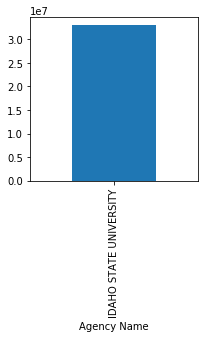

In [925]:
grouped_office_finance_agency_2018 = fy2018[fy2018['Vendor Name'] == 'ISU OFFICE OF FINANCE AND ADMINISTRATION'].groupby('Agency Name')
grouped_office_finance_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_office_finance_agency_2018['Amount'].agg(np.sum)

Agency Name
IDAHO STATE UNIVERSITY    39089773.44
Name: Amount, dtype: float64

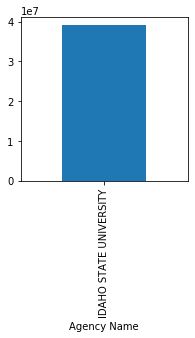

In [926]:
grouped_office_finance_agency_2019 = fy2019[fy2019['Vendor Name'] == 'ISU OFFICE OF FINANCE AND ADMINISTRATION'].groupby('Agency Name')
grouped_office_finance_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_office_finance_agency_2019['Amount'].agg(np.sum)

In [927]:
grouped_office_finance_agency_sum_2018 = grouped_office_finance_agency_2018['Amount'].agg(np.sum)
grouped_office_finance_agency_max_sum_2018 = grouped_office_finance_agency_sum_2018.max()
grouped_office_finance_agency_name_sum_2018 = grouped_office_finance_agency_sum_2018.idxmax()
grouped_office_finance_agency_name_sum_2018= grouped_office_finance_agency_name_sum_2018.strip()

grouped_office_finance_agency_sum_2019 = grouped_office_finance_agency_2019['Amount'].agg(np.sum)
grouped_office_finance_agency_max_sum_2019 = grouped_office_finance_agency_sum_2019.max()
grouped_office_finance_agency_name_sum_2019 = grouped_office_finance_agency_sum_2019.idxmax()
grouped_office_finance_agency_name_sum_2019 = grouped_office_finance_agency_name_sum_2019.strip()

print("For 2018, " + grouped_office_finance_agency_name_sum_2018 + " had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at " + str(grouped_office_finance_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_office_finance_agency_name_sum_2019 + " had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at " + str(grouped_office_finance_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_office_finance_agency_max_sum_2019 - grouped_office_finance_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, IDAHO STATE UNIVERSITY had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at 33019369.11999999.
For 2019, IDAHO STATE UNIVERSITY had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at 39089773.440000005.
The average increase/decrease was 6070404.320000015 between 2018 and 2019.


Agency Name
IDAHO STATE UNIVERSITY    18878.998925
Name: Amount, dtype: float64

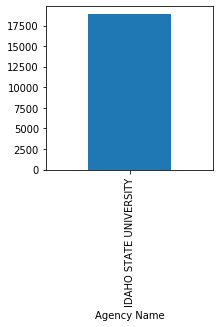

In [928]:
grouped_office_finance_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_office_finance_agency_2018['Amount'].agg(np.mean)

Agency Name
IDAHO STATE UNIVERSITY    14801.125877
Name: Amount, dtype: float64

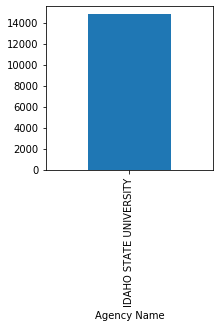

In [929]:
grouped_office_finance_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(3,3))
grouped_office_finance_agency_2019['Amount'].agg(np.mean)

In [930]:
grouped_office_finance_agency_mean_2018 = grouped_office_finance_agency_2018['Amount'].agg(np.mean)
grouped_office_finance_agency_max_mean_2018 = grouped_office_finance_agency_mean_2018.max()
grouped_office_finance_agency_name_mean_2018 = grouped_office_finance_agency_mean_2018.idxmax()
grouped_office_finance_agency_name_mean_2018= grouped_office_finance_agency_name_mean_2018.strip()

grouped_office_finance_agency_mean_2019 = grouped_office_finance_agency_2019['Amount'].agg(np.mean)
grouped_office_finance_agency_max_mean_2019 = grouped_office_finance_agency_mean_2019.max()
grouped_office_finance_agency_name_mean_2019 = grouped_office_finance_agency_mean_2019.idxmax()
grouped_office_finance_agency_name_mean_2019 = grouped_office_finance_agency_name_mean_2019.strip()

print("For 2018, " + grouped_office_finance_agency_name_mean_2018 + " had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at " + str(grouped_office_finance_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_office_finance_agency_name_mean_2019 + " had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at " + str(grouped_office_finance_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_office_finance_agency_max_mean_2019 - grouped_office_finance_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, IDAHO STATE UNIVERSITY had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at 18878.99892510005.
For 2019, IDAHO STATE UNIVERSITY had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at 14801.12587656191.
The average increase/decrease was -4077.873048538142 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES           409778.63
ADMINISTRATIVE SUPPLIES           274825.88
BLDG & IMPROVEMENTS              2535923.15
COMMUNICATION COSTS              1070204.12
COMPUTER EQUIPMENT               1661192.16
COMPUTER SERVICES                1170725.42
COMPUTER SUPPLIES                 389506.55
EDUC MATERIAL & EQUIP            2961063.16
EMPLOYEE BENEFITS                 156770.82
EMPLOYEE DEVELOPMENT COSTS        392901.00
EMPLOYEE TRAVEL COSTS            1006725.99
FUEL & LUBRICANTS COSTS            91528.04
GENERAL SERVICES                 1441698.11
GROSS SALARY & WAGE               -85449.47
INST & RESIDENT SUPPLIES          387802.72
INSURANCE                         598689.92
MFG & MERCH COSTS                    327.16
MISC EXPENDITURES                6795643.98
MOTORIZED/NON-MOTORIZED EQUIP     235861.16
OFFICE EQUIPMENT                  180055.56
PROFESSIONAL SERVICES            1961220.64
PROPERTY & IMPROVEMENTS           710577.35
RENTALS & OP

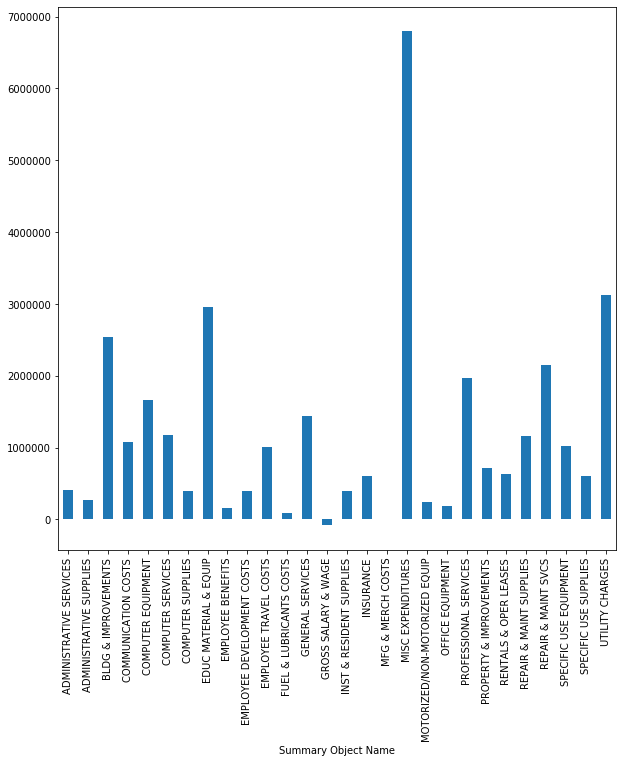

In [931]:
grouped_office_finance_summary_2018 = fy2018[fy2018['Vendor Name'] == 'ISU OFFICE OF FINANCE AND ADMINISTRATION'].groupby('Summary Object Name')
grouped_office_finance_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_office_finance_summary_2018['Amount'].agg(np.sum)

Summary Object Name
ADMINISTRATIVE SERVICES           441069.33
ADMINISTRATIVE SUPPLIES           192657.31
BLDG & IMPROVEMENTS              1507597.89
COMMUNICATION COSTS               971388.11
COMPUTER EQUIPMENT                762340.10
COMPUTER SERVICES                1360160.95
COMPUTER SUPPLIES                 665327.88
EDUC MATERIAL & EQUIP            3213890.87
EMPLOYEE BENEFITS                 195289.38
EMPLOYEE DEVELOPMENT COSTS        516594.55
EMPLOYEE TRAVEL COSTS             943252.34
FUEL & LUBRICANTS COSTS           114039.06
GENERAL SERVICES                 1987672.43
GROSS SALARY & WAGE              -130682.80
INST & RESIDENT SUPPLIES          531921.01
INSURANCE                         637061.13
MFG & MERCH COSTS                   4100.75
MISC EXPENDITURES                7425982.07
MOTORIZED/NON-MOTORIZED EQUIP     160540.61
OFFICE EQUIPMENT                  128006.12
PROFESSIONAL SERVICES            4173442.14
PROPERTY & IMPROVEMENTS          3510806.58
RENTALS & OP

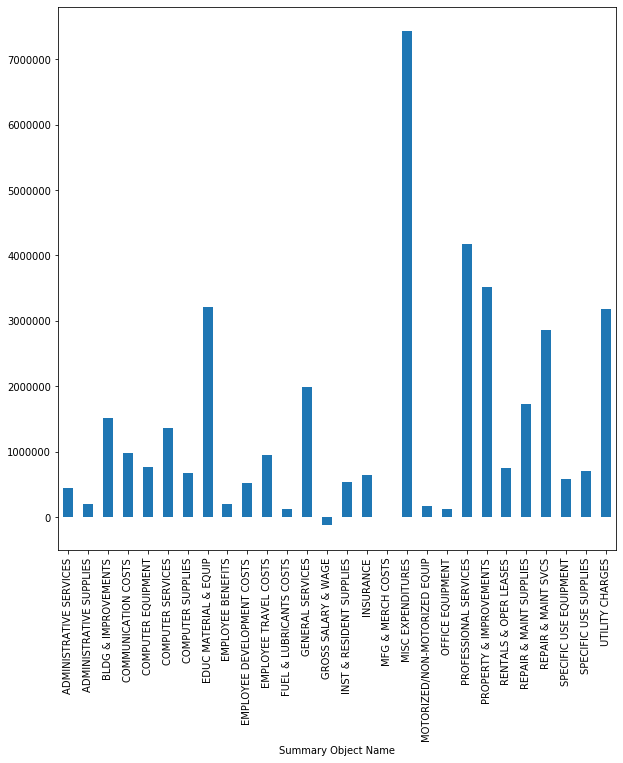

In [932]:
grouped_office_finance_summary_2019 = fy2019[fy2019['Vendor Name'] == 'ISU OFFICE OF FINANCE AND ADMINISTRATION'].groupby('Summary Object Name')
grouped_office_finance_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_office_finance_summary_2019['Amount'].agg(np.sum)

In [933]:
grouped_office_finance_summary_sum_2018 = grouped_office_finance_summary_2018['Amount'].agg(np.sum)
grouped_office_finance_summary_max_sum_2018 = grouped_office_finance_summary_sum_2018.max()
grouped_office_finance_summary_name_sum_2018 = grouped_office_finance_summary_sum_2018.idxmax()
grouped_office_finance_summary_name_sum_2018= grouped_office_finance_summary_name_sum_2018.strip()

grouped_office_finance_summary_sum_2019 = grouped_office_finance_summary_2019['Amount'].agg(np.sum)
grouped_office_finance_summary_max_sum_2019 = grouped_office_finance_summary_sum_2019.max()
grouped_office_finance_summary_name_sum_2019 = grouped_office_finance_summary_sum_2019.idxmax()
grouped_office_finance_summary_name_sum_2019 = grouped_office_finance_summary_name_sum_2019.strip()

print("For 2018, " + grouped_office_finance_summary_name_sum_2018 + " had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at " + str(grouped_office_finance_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_office_finance_summary_name_sum_2019 + " had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at " + str(grouped_office_finance_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_office_finance_summary_max_sum_2019 - grouped_office_finance_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, MISC EXPENDITURES had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at 6795643.979999999.
For 2019, MISC EXPENDITURES had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable at 7425982.069999997.
The average increase/decrease was 630338.089999998 between 2018 and 2019.


In [934]:
grouped_office_finance_summary_mean_2018 = grouped_office_finance_summary_2018['Amount'].agg(np.mean)
grouped_office_finance_summary_max_mean_2018 = grouped_office_finance_summary_mean_2018.max()
grouped_office_finance_summary_name_mean_2018 = grouped_office_finance_summary_mean_2018.idxmax()
grouped_office_finance_summary_name_mean_2018= grouped_office_finance_summary_name_mean_2018.strip()

grouped_office_finance_summary_mean_2019 = grouped_office_finance_summary_2019['Amount'].agg(np.mean)
grouped_office_finance_summary_max_mean_2019 = grouped_office_finance_summary_mean_2019.max()
grouped_office_finance_summary_name_mean_2019 = grouped_office_finance_summary_mean_2019.idxmax()
grouped_office_finance_summary_name_mean_2019 = grouped_office_finance_summary_name_mean_2019.strip()

print("For 2018, " + grouped_office_finance_summary_name_mean_2018 + " had the most expenditure for the total cost of Personal Vehicle - In-State at " + str(grouped_office_finance_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_office_finance_summary_name_mean_2019 + " had the most expenditure for the total cost of Personal Vehicle - In-State at " + str(grouped_office_finance_summary_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_office_finance_summary_max_mean_2019 - grouped_office_finance_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, BLDG & IMPROVEMENTS had the most expenditure for the total cost of Personal Vehicle - In-State at 316990.39375.
For 2019, PROPERTY & IMPROVEMENTS had the most expenditure for the total cost of Personal Vehicle - In-State at 1170268.86.


In [935]:
grouped_subsistence_outstate_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'SUBSISTENCE OUT-STATE'].groupby('Vendor Name')

In [936]:
grouped_subsistence_outstate_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'SUBSISTENCE OUT-STATE'].groupby('Vendor Name')

In [937]:
grouped_subsistence_outstate_vendor_sum_2018 = grouped_subsistence_outstate_vendor_2018['Amount'].agg(np.sum)
grouped_subsistence_outstate_vendor_max_sum_2018 = grouped_subsistence_outstate_vendor_sum_2018.max()
grouped_subsistence_outstate_vendor_name_sum_2018 = grouped_subsistence_outstate_vendor_sum_2018.idxmax()
grouped_subsistence_outstate_vendor_name_sum_2018= grouped_subsistence_outstate_vendor_name_sum_2018.strip()

grouped_subsistence_outstate_vendor_sum_2019 = grouped_subsistence_outstate_vendor_2019['Amount'].agg(np.sum)
grouped_subsistence_outstate_vendor_max_sum_2019 = grouped_subsistence_outstate_vendor_sum_2019.max()
grouped_subsistence_outstate_vendor_name_sum_2019 = grouped_subsistence_outstate_vendor_sum_2019.idxmax()
grouped_subsistence_outstate_vendor_name_sum_2019 = grouped_subsistence_outstate_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_subsistence_outstate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Subsistence - Out-State at " + str(grouped_subsistence_outstate_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_subsistence_outstate_vendor_name_sum_2019 + " had the most expenditure for the total cost of Subsistence - Out-State at " + str(grouped_subsistence_outstate_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_subsistence_outstate_vendor_max_sum_2019 - grouped_subsistence_outstate_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, BOISE STATE UNIVERSITY had the most expenditure for the total cost of Subsistence - Out-State at 543620.6700000003.
For 2019, BOISE STATE UNIVERSITY had the most expenditure for the total cost of Subsistence - Out-State at 563949.36.
The average increase/decrease was 20328.68999999971 between 2018 and 2019.


In [938]:
grouped_subsistence_outstate_vendor_mean_2018 = grouped_subsistence_outstate_vendor_2018['Amount'].agg(np.mean)
grouped_subsistence_outstate_vendor_max_mean_2018 = grouped_subsistence_outstate_vendor_mean_2018.max()
grouped_subsistence_outstate_vendor_name_mean_2018 = grouped_subsistence_outstate_vendor_mean_2018.idxmax()
grouped_subsistence_outstate_vendor_name_mean_2018= grouped_subsistence_outstate_vendor_name_mean_2018.strip()

grouped_subsistence_outstate_vendor_mean_2019 = grouped_subsistence_outstate_vendor_2019['Amount'].agg(np.mean)
grouped_subsistence_outstate_vendor_max_mean_2019 = grouped_subsistence_outstate_vendor_mean_2019.max()
grouped_subsistence_outstate_vendor_name_mean_2019 = grouped_subsistence_outstate_vendor_mean_2019.idxmax()
grouped_subsistence_outstate_vendor_name_mean_2019 = grouped_subsistence_outstate_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_subsistence_outstate_vendor_name_mean_2018 + " had the most expenditure for the total cost of Subsistence - Out-State at " + str(grouped_subsistence_outstate_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_subsistence_outstate_vendor_name_mean_2019 + " had the most expenditure for the total cost of Subsistence - Out-State at " + str(grouped_subsistence_outstate_vendor_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_subsistence_outstate_vendor_max_mean_2019 - grouped_subsistence_outstate_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the total cost of Subsistence - Out-State at 15564.548333333332.
For 2019, ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the total cost of Subsistence - Out-State at 9962.233448275862.
The average increase/decrease was -5602.314885057471 between 2018 and 2019.


Agency Name
ADMINISTRATION, DEPARTMENT OF                           900865.95
AGING, COMMISSION ON                                     21302.08
AGRICULTURE, DEPARTMENT OF                              136520.67
ARTS, IDAHO COMMISSION ON THE                              622.74
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE          23294.00
BOISE STATE UNIVERSITY                                49359357.50
CAREER-TECHNICAL EDUCATION, DIVISION OF                   1683.01
COMMERCE, DEPARTMENT OF                                 695723.11
CONTROLLER, OFFICE OF THE STATE                            110.00
CORRECTION, DEPARTMENT OF                                49793.67
DRUG POLICY, OFFICE OF                                  293673.86
EDUCATION, STATE BOARD OF                               471732.85
EDUCATION, STATE DEPARTMENT OF                         4964649.25
ENVIRONMENTAL QUALITY, DEPARTMENT OF                    109122.13
FISH AND GAME, DEPARTMENT OF                             68396.3

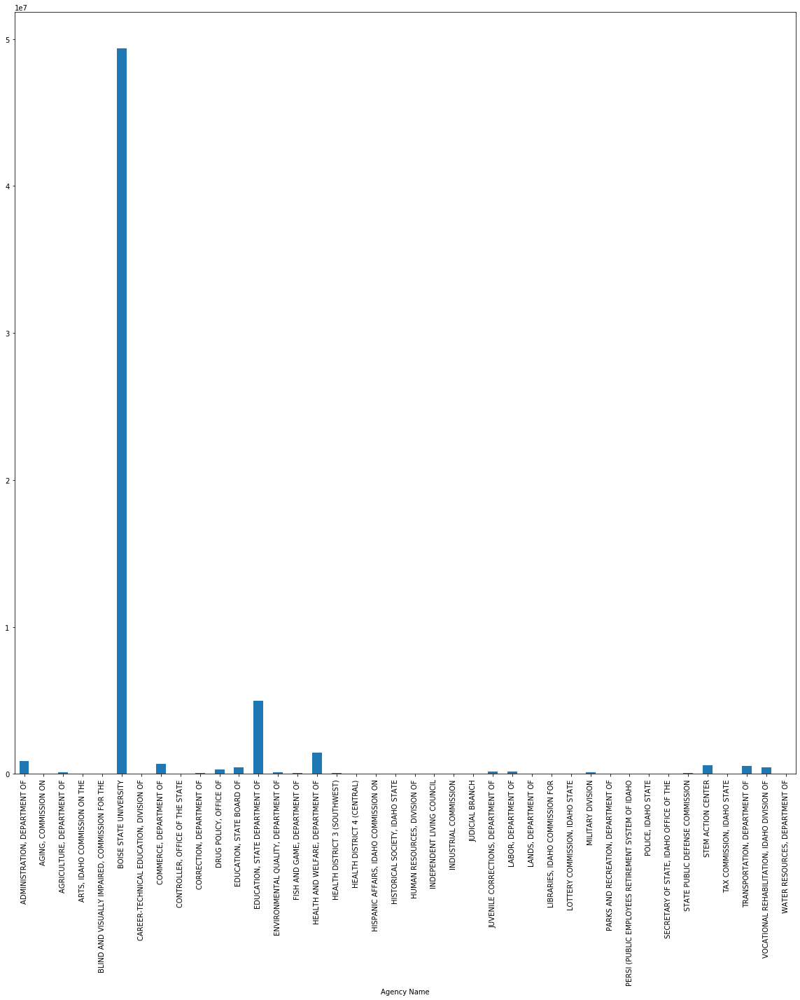

In [939]:
grouped_boise_state_agency_2018 = fy2018[fy2018['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Agency Name')
grouped_boise_state_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_boise_state_agency_2018['Amount'].agg(np.sum)

Agency Name
ADMINISTRATION, DEPARTMENT OF                        414842.40
AGING, COMMISSION ON                                  88114.36
AGRICULTURE, DEPARTMENT OF                            67806.53
ARTS, IDAHO COMMISSION ON THE                          5047.48
ATTORNEY GENERAL, OFFICE OF THE                         100.00
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE       25872.50
BOISE STATE UNIVERSITY                             54471852.35
CAREER-TECHNICAL EDUCATION, DIVISION OF                 556.17
COMMERCE, DEPARTMENT OF                              553115.29
CONTROLLER, OFFICE OF THE STATE                         140.00
CORRECTION, DEPARTMENT OF                             36375.00
DRUG POLICY, OFFICE OF                               150543.38
EDUCATION, STATE BOARD OF                            577040.65
EDUCATION, STATE DEPARTMENT OF                      4964753.57
ENVIRONMENTAL QUALITY, DEPARTMENT OF                 103373.72
FISH AND GAME, DEPARTMENT OF               

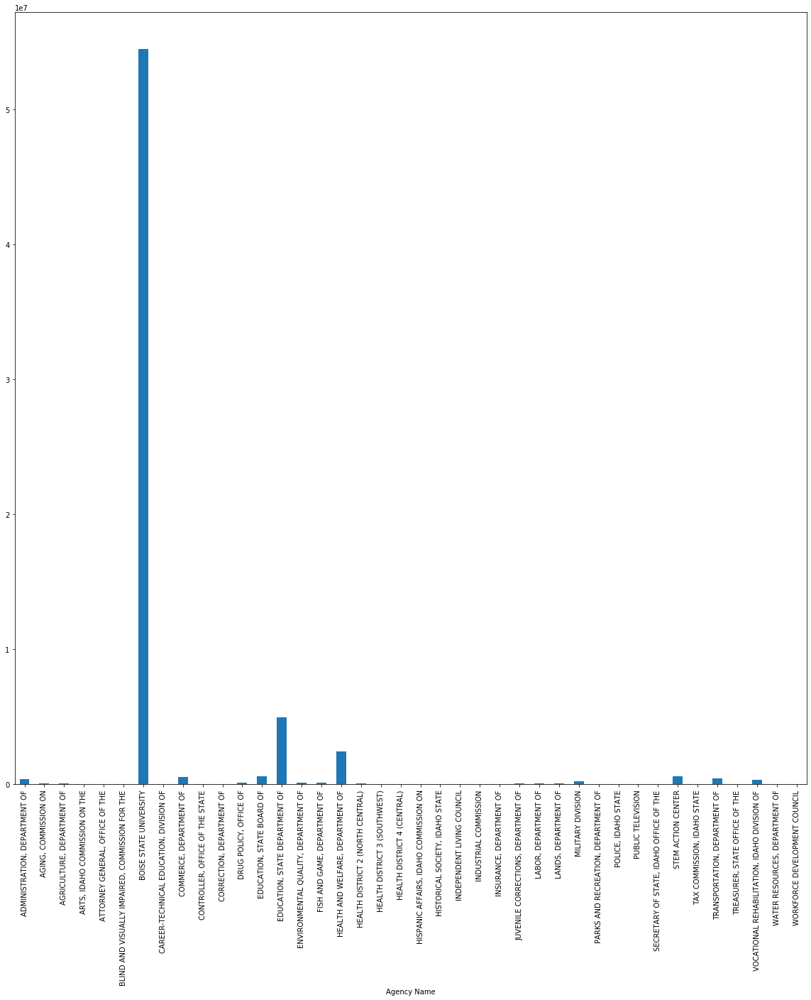

In [940]:
grouped_boise_state_agency_2019 = fy2019[fy2019['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Agency Name')
grouped_boise_state_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_boise_state_agency_2019['Amount'].agg(np.sum)

In [941]:
grouped_boise_state_agency_sum_2018 = grouped_boise_state_agency_2018['Amount'].agg(np.sum)
grouped_boise_state_agency_max_sum_2018 = grouped_boise_state_agency_sum_2018.max()
grouped_boise_state_agency_name_sum_2018 = grouped_boise_state_agency_sum_2018.idxmax()
grouped_boise_state_agency_name_sum_2018= grouped_boise_state_agency_name_sum_2018.strip()

grouped_boise_state_agency_sum_2019 = grouped_boise_state_agency_2019['Amount'].agg(np.sum)
grouped_boise_state_agency_max_sum_2019 = grouped_boise_state_agency_sum_2019.max()
grouped_boise_state_agency_name_sum_2019 = grouped_boise_state_agency_sum_2019.idxmax()
grouped_boise_state_agency_name_sum_2019 = grouped_boise_state_agency_name_sum_2019.strip()

print("For 2018, " + grouped_boise_state_agency_name_sum_2018 + " had the most expenditure for the total cost of Boise State University from Subsistence - Out-State at " + str(grouped_boise_state_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_boise_state_agency_name_sum_2019 + " had the most expenditure for the total cost of Boise State University from Subsistence - Out-State at " + str(grouped_boise_state_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_state_agency_max_sum_2019 - grouped_boise_state_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, BOISE STATE UNIVERSITY had the most expenditure for the total cost of Boise State University from Subsistence - Out-State at 49359357.50000012.
For 2019, BOISE STATE UNIVERSITY had the most expenditure for the total cost of Boise State University from Subsistence - Out-State at 54471852.35000007.
The average increase/decrease was 5112494.849999949 between 2018 and 2019.


Agency Name
ADMINISTRATION, DEPARTMENT OF                         20019.243333
AGING, COMMISSION ON                                   4260.416000
AGRICULTURE, DEPARTMENT OF                            27304.134000
ARTS, IDAHO COMMISSION ON THE                           622.740000
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE        4658.800000
BOISE STATE UNIVERSITY                                12305.997881
CAREER-TECHNICAL EDUCATION, DIVISION OF                 210.376250
COMMERCE, DEPARTMENT OF                               25767.522593
CONTROLLER, OFFICE OF THE STATE                          13.750000
CORRECTION, DEPARTMENT OF                              3556.690714
DRUG POLICY, OFFICE OF                                32630.428889
EDUCATION, STATE BOARD OF                             19655.535417
EDUCATION, STATE DEPARTMENT OF                        39717.194000
ENVIRONMENTAL QUALITY, DEPARTMENT OF                   1268.861977
FISH AND GAME, DEPARTMENT OF                      

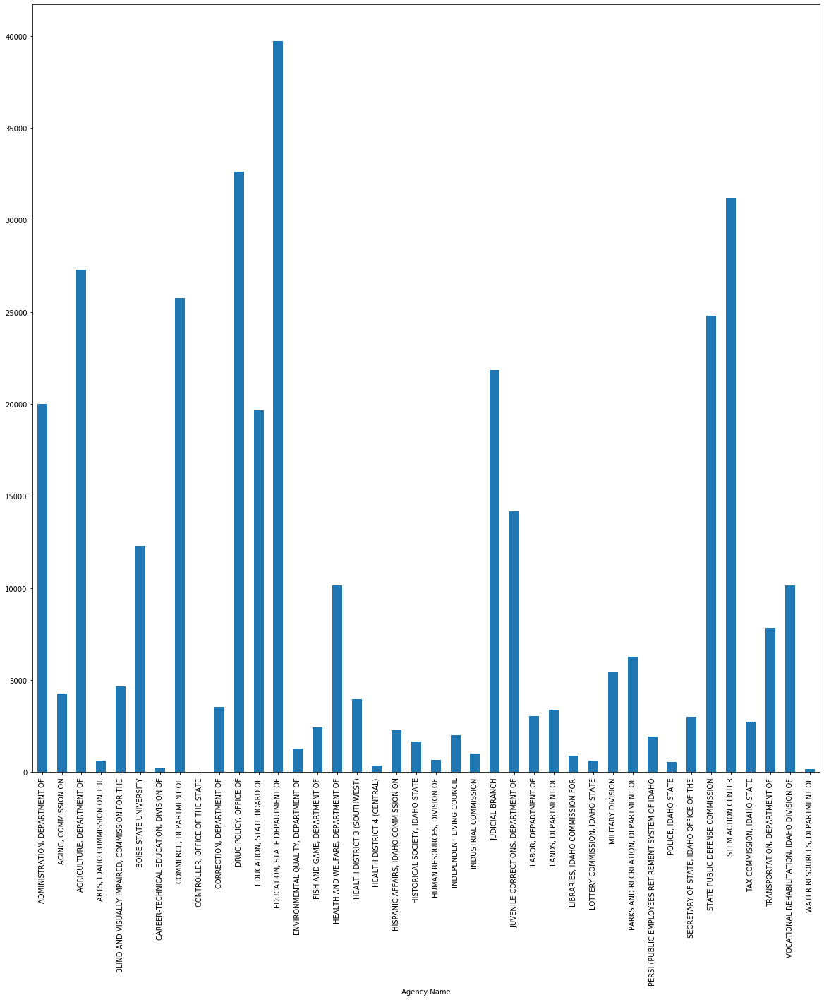

In [942]:
grouped_boise_state_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_boise_state_agency_2018['Amount'].agg(np.mean)

Agency Name
ADMINISTRATION, DEPARTMENT OF                      13382.012903
AGING, COMMISSION ON                                4005.198182
AGRICULTURE, DEPARTMENT OF                         13561.306000
ARTS, IDAHO COMMISSION ON THE                        560.831111
ATTORNEY GENERAL, OFFICE OF THE                       33.333333
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE     6468.125000
BOISE STATE UNIVERSITY                             13423.324877
CAREER-TECHNICAL EDUCATION, DIVISION OF               92.695000
COMMERCE, DEPARTMENT OF                            15803.294000
CONTROLLER, OFFICE OF THE STATE                       11.666667
CORRECTION, DEPARTMENT OF                           6062.500000
DRUG POLICY, OFFICE OF                             30108.676000
EDUCATION, STATE BOARD OF                          30370.560526
EDUCATION, STATE DEPARTMENT OF                     42799.599741
ENVIRONMENTAL QUALITY, DEPARTMENT OF                 876.048475
FISH AND GAME, DEPARTMENT OF

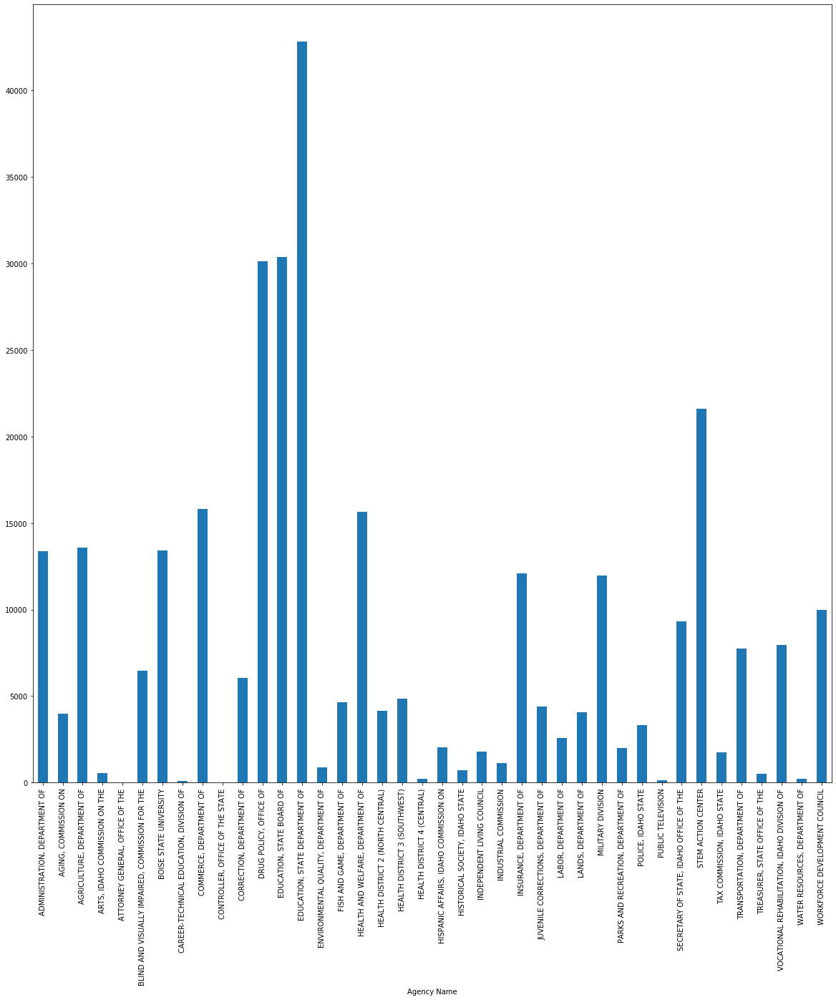

In [943]:
grouped_boise_state_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_boise_state_agency_2019['Amount'].agg(np.mean)

In [944]:
grouped_boise_state_agency_mean_2018 = grouped_boise_state_agency_2018['Amount'].agg(np.mean)
grouped_boise_state_agency_max_mean_2018 = grouped_boise_state_agency_mean_2018.max()
grouped_boise_state_agency_name_mean_2018 = grouped_boise_state_agency_mean_2018.idxmax()
grouped_boise_state_agency_name_mean_2018= grouped_boise_state_agency_name_mean_2018.strip()

grouped_boise_state_agency_mean_2019 = grouped_boise_state_agency_2019['Amount'].agg(np.mean)
grouped_boise_state_agency_max_mean_2019 = grouped_boise_state_agency_mean_2019.max()
grouped_boise_state_agency_name_mean_2019 = grouped_boise_state_agency_mean_2019.idxmax()
grouped_boise_state_agency_name_mean_2019 = grouped_boise_state_agency_name_mean_2019.strip()

print("For 2018, " + grouped_boise_state_agency_name_mean_2018 + " had the most expenditure for the average cost of Boise State University from Subsistence - Out-State at " + str(grouped_boise_state_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_boise_state_agency_name_mean_2019 + " had the most expenditure for the average cost of Boise State University from Subsistence - Out-State at " + str(grouped_boise_state_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_state_agency_max_mean_2019 - grouped_boise_state_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, EDUCATION, STATE DEPARTMENT OF had the most expenditure for the average cost of Boise State University from Subsistence - Out-State at 39717.193999999996.
For 2019, EDUCATION, STATE DEPARTMENT OF had the most expenditure for the average cost of Boise State University from Subsistence - Out-State at 42799.599741379316.
The average increase/decrease was 3082.40574137932 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES            638037.40
ADMINISTRATIVE SUPPLIES            652033.58
AWARDS CONTR & CLAIMS              627844.79
BLDG & IMPROVEMENTS                466354.60
COMMUNICATION COSTS               1296481.59
COMPUTER EQUIPMENT                 407027.15
COMPUTER SERVICES                  543936.37
COMPUTER SUPPLIES                 2401735.14
EDUC & TRAIN ASSISTANCE            459049.93
EDUC MATERIAL & EQUIP             3688757.08
EMPLOYEE BENEFITS                 1495706.46
EMPLOYEE DEVELOPMENT COSTS         901532.28
EMPLOYEE TRAVEL COSTS             1608811.46
FED PMTS TO SUBGRANTEES           4041090.75
FUEL & LUBRICANTS COSTS             52479.37
GENERAL SERVICES                  1554239.97
GROSS SALARY & WAGE              12442150.17
INST & RESIDENT SUPPLIES           381988.93
INSURANCE                         1500410.10
MFG & MERCH COSTS                     110.37
MISC EXPENDITURES                 3807344.85
MISC PMTS AS AGENT                1

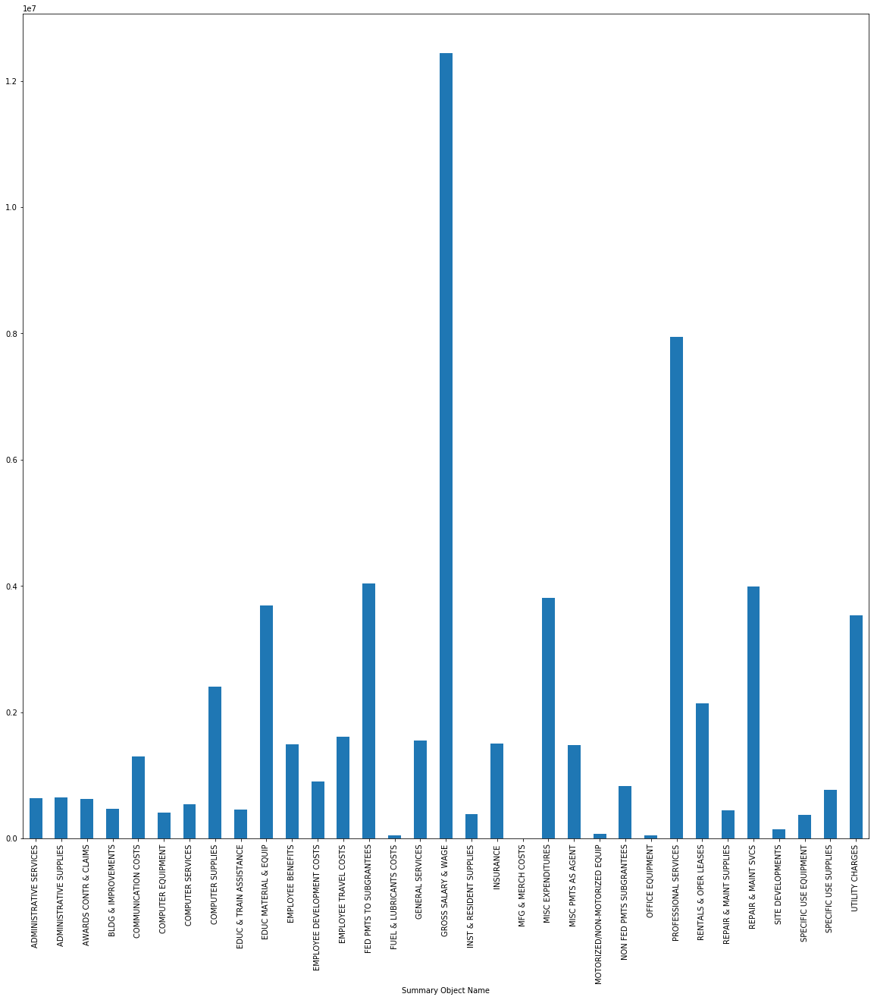

In [945]:
grouped_boise_state_summary_2018 = fy2018[fy2018['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Summary Object Name')
grouped_boise_state_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_boise_state_summary_2018['Amount'].agg(np.sum)

Summary Object Name
ADMINISTRATIVE SERVICES            690844.37
ADMINISTRATIVE SUPPLIES            656791.81
AWARDS CONTR & CLAIMS              190503.80
BLDG & IMPROVEMENTS                401683.06
COMMUNICATION COSTS               1175469.28
COMPUTER EQUIPMENT                 291435.73
COMPUTER SERVICES                 1097248.66
COMPUTER SUPPLIES                 5211084.91
EDUC & TRAIN ASSISTANCE            341595.86
EDUC MATERIAL & EQUIP             3484319.90
EMPLOYEE BENEFITS                 1725674.11
EMPLOYEE DEVELOPMENT COSTS         982102.60
EMPLOYEE TRAVEL COSTS             1529844.10
FED PMTS TO SUBGRANTEES           3828311.25
FUEL & LUBRICANTS COSTS             55161.95
GENERAL SERVICES                  1665586.90
GROSS SALARY & WAGE              13698103.96
INST & RESIDENT SUPPLIES           461966.84
INSURANCE                         1506015.06
MFG & MERCH COSTS                     867.07
MISC EXPENDITURES                 5848192.01
MISC PMTS AS AGENT                1

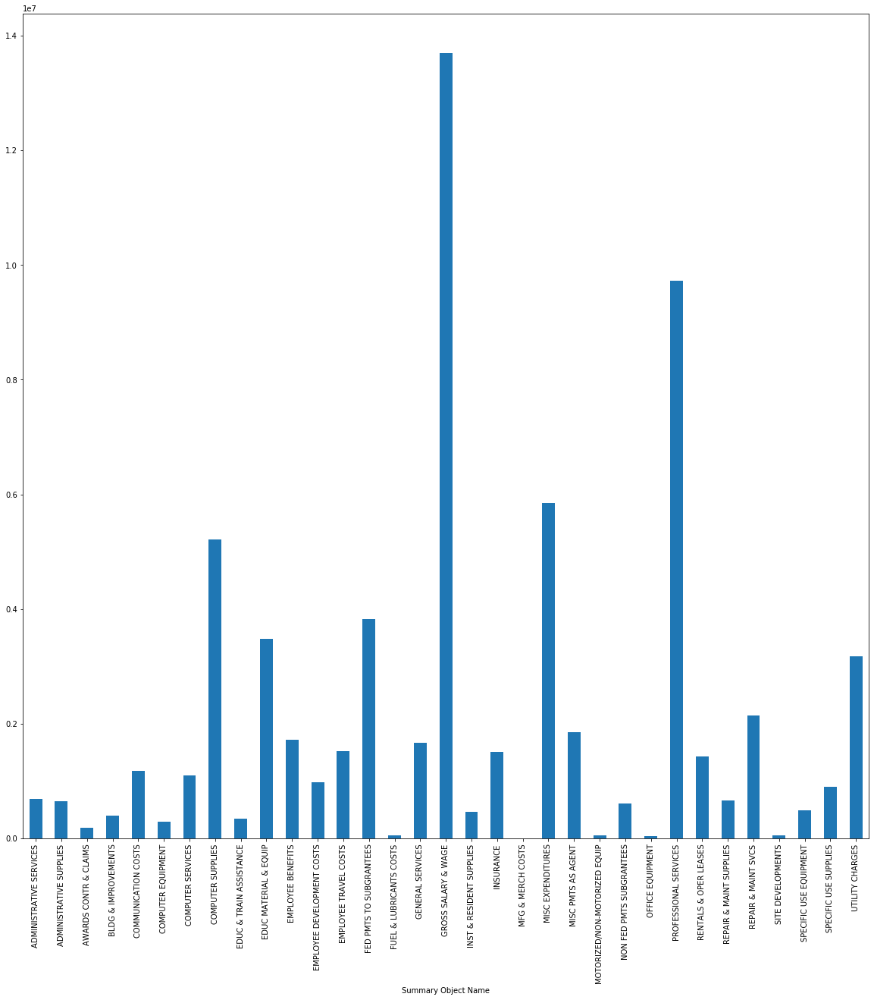

In [946]:
grouped_boise_state_summary_2019 = fy2019[fy2019['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Summary Object Name')
grouped_boise_state_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_boise_state_summary_2019['Amount'].agg(np.sum)

In [947]:
grouped_boise_state_summary_sum_2018 = grouped_boise_state_summary_2018['Amount'].agg(np.sum)
grouped_boise_state_summary_max_sum_2018 = grouped_boise_state_summary_sum_2018.max()
grouped_boise_state_summary_name_sum_2018 = grouped_boise_state_summary_sum_2018.idxmax()
grouped_boise_state_summary_name_sum_2018= grouped_boise_state_summary_name_sum_2018.strip()

grouped_boise_state_summary_sum_2019 = grouped_boise_state_summary_2019['Amount'].agg(np.sum)
grouped_boise_state_summary_max_sum_2019 = grouped_boise_state_summary_sum_2019.max()
grouped_boise_state_summary_name_sum_2019 = grouped_boise_state_summary_sum_2019.idxmax()
grouped_boise_state_summary_name_sum_2019 = grouped_boise_state_summary_name_sum_2019.strip()

print("For 2018, " + grouped_boise_state_summary_name_sum_2018 + " had the most expenditure for the total cost of Boise State University from Subsistence - Out-State at " + str(grouped_boise_state_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_boise_state_summary_name_sum_2019 + " had the most expenditure for the total cost of Boise State University from Subsistence - Out-State at " + str(grouped_boise_state_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_state_summary_max_sum_2019 - grouped_boise_state_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, GROSS SALARY & WAGE had the most expenditure for the total cost of Boise State University from Subsistence - Out-State at 12442150.169999998.
For 2019, GROSS SALARY & WAGE had the most expenditure for the total cost of Boise State University from Subsistence - Out-State at 13698103.960000003.
The average increase/decrease was 1255953.7900000047 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES            3222.411111
ADMINISTRATIVE SUPPLIES            3293.098889
AWARDS CONTR & CLAIMS             11626.755370
BLDG & IMPROVEMENTS               51817.177778
COMMUNICATION COSTS                4766.476434
COMPUTER EQUIPMENT                25439.196875
COMPUTER SERVICES                 15109.343611
COMPUTER SUPPLIES                 20704.613276
EDUC & TRAIN ASSISTANCE            9979.346304
EDUC MATERIAL & EQUIP             72328.570196
EMPLOYEE BENEFITS                  4824.859548
EMPLOYEE DEVELOPMENT COSTS         3954.088947
EMPLOYEE TRAVEL COSTS              2089.365532
FED PMTS TO SUBGRANTEES           40010.799505
FUEL & LUBRICANTS COSTS             771.755441
GENERAL SERVICES                   6369.835943
GROSS SALARY & WAGE               67620.381359
INST & RESIDENT SUPPLIES           4602.276265
INSURANCE                         44129.708824
MFG & MERCH COSTS                    36.790000
MISC EXPENDITURES                 14153.

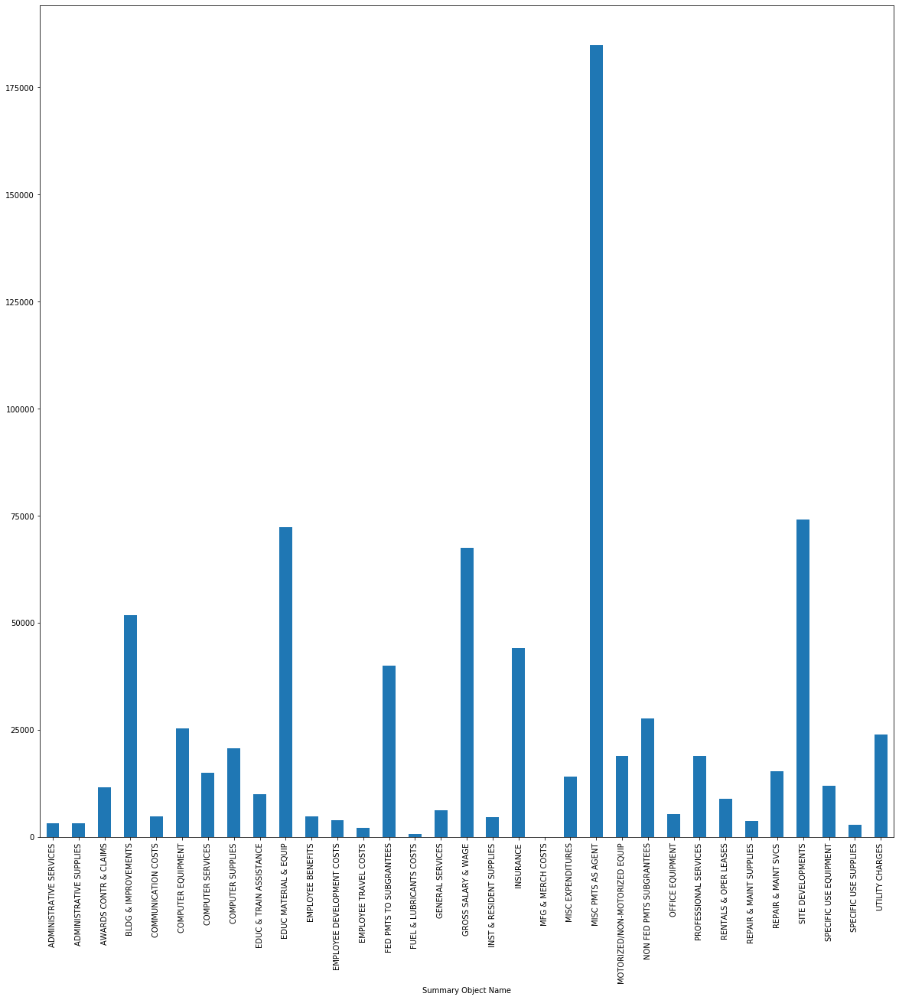

In [948]:
grouped_boise_state_summary_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_boise_state_summary_2018['Amount'].agg(np.mean)

Summary Object Name
ADMINISTRATIVE SERVICES            3437.036667
ADMINISTRATIVE SUPPLIES            2868.086507
AWARDS CONTR & CLAIMS              4646.434146
BLDG & IMPROVEMENTS               36516.641818
COMMUNICATION COSTS                4290.033869
COMPUTER EQUIPMENT                12671.118696
COMPUTER SERVICES                 19249.976491
COMPUTER SUPPLIES                 42024.878306
EDUC & TRAIN ASSISTANCE            9232.320541
EDUC MATERIAL & EQUIP             58071.998333
EMPLOYEE BENEFITS                  5359.236366
EMPLOYEE DEVELOPMENT COSTS         3748.483206
EMPLOYEE TRAVEL COSTS              2089.950956
FED PMTS TO SUBGRANTEES           39467.126289
FUEL & LUBRICANTS COSTS             848.645385
GENERAL SERVICES                   8164.641667
GROSS SALARY & WAGE               73251.892834
INST & RESIDENT SUPPLIES           4914.540851
INSURANCE                         40703.109730
MFG & MERCH COSTS                   108.383750
MISC EXPENDITURES                 21500.

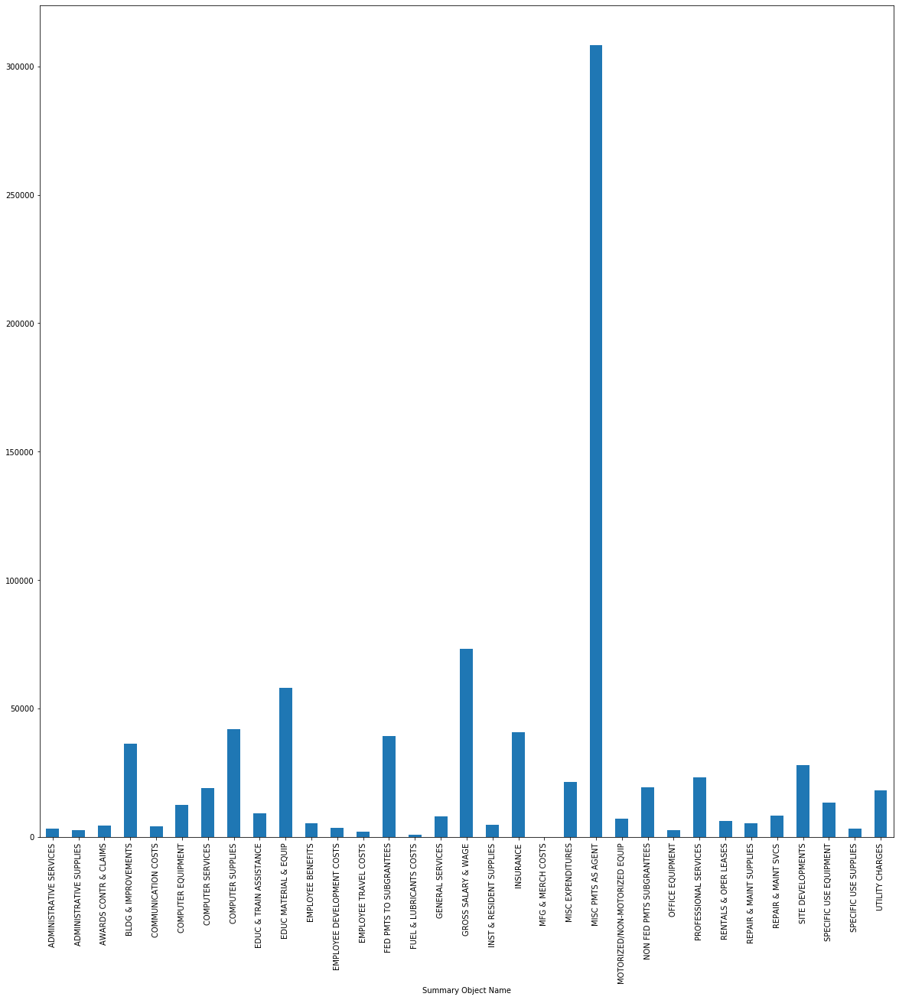

In [949]:
grouped_boise_state_summary_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_boise_state_summary_2019['Amount'].agg(np.mean)

In [950]:
grouped_boise_state_summary_mean_2018 = grouped_boise_state_summary_2018['Amount'].agg(np.mean)
grouped_boise_state_summary_max_mean_2018 = grouped_boise_state_summary_mean_2018.max()
grouped_boise_state_summary_name_mean_2018 = grouped_boise_state_summary_mean_2018.idxmax()
grouped_boise_state_summary_name_mean_2018= grouped_boise_state_summary_name_mean_2018.strip()

grouped_boise_state_summary_mean_2019 = grouped_boise_state_summary_2019['Amount'].agg(np.mean)
grouped_boise_state_summary_max_mean_2019 = grouped_boise_state_summary_mean_2019.max()
grouped_boise_state_summary_name_mean_2019 = grouped_boise_state_summary_mean_2019.idxmax()
grouped_boise_state_summary_name_mean_2019 = grouped_boise_state_summary_name_mean_2019.strip()

print("For 2018, " + grouped_boise_state_summary_name_mean_2018 + " had the most expenditure for the average cost of Boise State University from Subsistence - Out-State at " + str(grouped_boise_state_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_boise_state_summary_name_mean_2019 + " had the most expenditure for the average cost of Boise State University from Subsistence - Out-State at " + str(grouped_boise_state_summary_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_state_summary_max_mean_2019 - grouped_boise_state_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, MISC PMTS AS AGENT had the most expenditure for the average cost of Boise State University from Subsistence - Out-State at 184942.0.
For 2019, MISC PMTS AS AGENT had the most expenditure for the average cost of Boise State University from Subsistence - Out-State at 308310.0.
The average increase/decrease was 123368.0 between 2018 and 2019.


In [951]:
grouped_subsistence_instate_tax_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'SUBSIST IN-STATE TAXABLE'].groupby('Vendor Name')

In [952]:
grouped_subsistence_instate_tax_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'SUBSIST IN-STATE TAXABLE'].groupby('Vendor Name')

In [953]:
grouped_subsistence_instate_tax_vendor_sum_2018 = grouped_subsistence_instate_tax_vendor_2018['Amount'].agg(np.sum)
grouped_subsistence_instate_tax_vendor_max_sum_2018 = grouped_subsistence_instate_tax_vendor_sum_2018.max()
grouped_subsistence_instate_tax_vendor_name_sum_2018 = grouped_subsistence_instate_tax_vendor_sum_2018.idxmax()
grouped_subsistence_instate_tax_vendor_name_sum_2018= grouped_subsistence_instate_tax_vendor_name_sum_2018.strip()

grouped_subsistence_instate_tax_vendor_sum_2019 = grouped_subsistence_instate_tax_vendor_2019['Amount'].agg(np.sum)
grouped_subsistence_instate_tax_vendor_max_sum_2019 = grouped_subsistence_instate_tax_vendor_sum_2019.max()
grouped_subsistence_instate_tax_vendor_name_sum_2019 = grouped_subsistence_instate_tax_vendor_sum_2019.idxmax()
grouped_subsistence_instate_tax_vendor_name_sum_2019 = grouped_subsistence_instate_tax_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_subsistence_instate_tax_vendor_name_sum_2018 + " had the most expenditure for the total cost of Subsistence In-State Taxable at " + str(grouped_subsistence_instate_tax_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_subsistence_instate_tax_vendor_name_sum_2019 + " had the most expenditure for the total cost of Subsistence In-State Taxable at " + str(grouped_subsistence_instate_tax_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_subsistence_instate_tax_vendor_max_sum_2019 - grouped_subsistence_instate_tax_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the total cost of Subsistence In-State Taxable at 5446.25.
For 2019, ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the total cost of Subsistence In-State Taxable at 6565.21.
The average increase/decrease was 1118.96 between 2018 and 2019.


In [954]:
grouped_subsistence_instate_tax_vendor_mean_2018 = grouped_subsistence_instate_tax_vendor_2018['Amount'].agg(np.mean)
grouped_subsistence_instate_tax_vendor_max_mean_2018 = grouped_subsistence_instate_tax_vendor_mean_2018.max()
grouped_subsistence_instate_tax_vendor_name_mean_2018 = grouped_subsistence_instate_tax_vendor_mean_2018.idxmax()
grouped_subsistence_instate_tax_vendor_name_mean_2018= grouped_subsistence_instate_tax_vendor_name_mean_2018.strip()

grouped_subsistence_instate_tax_vendor_mean_2019 = grouped_subsistence_instate_tax_vendor_2019['Amount'].agg(np.mean)
grouped_subsistence_instate_tax_vendor_max_mean_2019 = grouped_subsistence_instate_tax_vendor_mean_2019.max()
grouped_subsistence_instate_tax_vendor_name_mean_2019 = grouped_subsistence_instate_tax_vendor_mean_2019.idxmax()
grouped_subsistence_instate_tax_vendor_name_mean_2019 = grouped_subsistence_instate_tax_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_subsistence_instate_tax_vendor_name_mean_2018 + " had the most expenditure for the average cost of Subsistence In-State Taxable at " + str(grouped_subsistence_instate_tax_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_subsistence_instate_tax_vendor_name_mean_2019 + " had the most expenditure for the average cost of Subsistence In-State Taxable at " + str(grouped_subsistence_instate_tax_vendor_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_subsistence_instate_tax_vendor_max_mean_2019 - grouped_subsistence_instate_tax_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, JASON R SPILLETT had the most expenditure for the average cost of Subsistence In-State Taxable at 792.0.
For 2019, CONNOR BENTLEY had the most expenditure for the average cost of Subsistence In-State Taxable at 711.0.


In [955]:
print("See Personal Vehicle - In-State for more information on ISU Office of Finance and Administration.")

See Personal Vehicle - In-State for more information on ISU Office of Finance and Administration.


In [956]:
grouped_lodging_outstate_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'LODGING - OUT OF STATE'].groupby('Vendor Name')

In [957]:
grouped_lodging_outstate_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'LODGING - OUT OF STATE'].groupby('Vendor Name')

In [958]:
grouped_lodging_outstate_vendor_sum_2018 = grouped_lodging_outstate_vendor_2018['Amount'].agg(np.sum)
grouped_lodging_outstate_vendor_max_sum_2018 = grouped_lodging_outstate_vendor_sum_2018.max()
grouped_lodging_outstate_vendor_name_sum_2018 = grouped_lodging_outstate_vendor_sum_2018.idxmax()
grouped_lodging_outstate_vendor_name_sum_2018= grouped_lodging_outstate_vendor_name_sum_2018.strip()

grouped_lodging_outstate_vendor_sum_2019 = grouped_lodging_outstate_vendor_2019['Amount'].agg(np.sum)
grouped_lodging_outstate_vendor_max_sum_2019 = grouped_lodging_outstate_vendor_sum_2019.max()
grouped_lodging_outstate_vendor_name_sum_2019 = grouped_lodging_outstate_vendor_sum_2019.idxmax()
grouped_lodging_outstate_vendor_name_sum_2019 = grouped_lodging_outstate_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_lodging_outstate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Lodging - Out of State at " + str(grouped_lodging_outstate_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_lodging_outstate_vendor_name_sum_2019 + " had the most expenditure for the total cost of Lodging - Out of State at " + str(grouped_lodging_outstate_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_lodging_outstate_vendor_max_sum_2019 - grouped_lodging_outstate_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, BANK OF AMERICA had the most expenditure for the total cost of Lodging - Out of State at 121681.52000000002.
For 2019, BANK OF AMERICA had the most expenditure for the total cost of Lodging - Out of State at 168399.83.
The average increase/decrease was 46718.30999999997 between 2018 and 2019.


In [959]:
grouped_lodging_outstate_vendor_mean_2018 = grouped_lodging_outstate_vendor_2018['Amount'].agg(np.mean)
grouped_lodging_outstate_vendor_max_mean_2018 = grouped_lodging_outstate_vendor_mean_2018.max()
grouped_lodging_outstate_vendor_name_mean_2018 = grouped_lodging_outstate_vendor_mean_2018.idxmax()
grouped_lodging_outstate_vendor_name_mean_2018= grouped_lodging_outstate_vendor_name_mean_2018.strip()

grouped_lodging_outstate_vendor_mean_2019 = grouped_lodging_outstate_vendor_2019['Amount'].agg(np.mean)
grouped_lodging_outstate_vendor_max_mean_2019 = grouped_lodging_outstate_vendor_mean_2019.max()
grouped_lodging_outstate_vendor_name_mean_2019 = grouped_lodging_outstate_vendor_mean_2019.idxmax()
grouped_lodging_outstate_vendor_name_mean_2019 = grouped_lodging_outstate_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_lodging_outstate_vendor_name_mean_2018 + " had the most expenditure for the average cost of Lodging - Out of State at " + str(grouped_lodging_outstate_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_lodging_outstate_vendor_name_mean_2019 + " had the most expenditure for the average cost of Lodging - Out of State at " + str(grouped_lodging_outstate_vendor_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_lodging_outstate_vendor_max_mean_2019 - grouped_lodging_outstate_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, DOYLE DUPONT LLC had the most expenditure for the average cost of Lodging - Out of State at 7160.01.
For 2019, PCARD - RAMADA INN PHX had the most expenditure for the average cost of Lodging - Out of State at 14739.17.


Agency Name
AGING, COMMISSION ON                      -3.118800e+02
ARTS, IDAHO COMMISSION ON THE             -1.136868e-13
COMMERCE, DEPARTMENT OF                   -1.062000e+01
ENDOWMENT FUND INVESTMENT BOARD           -1.985500e+02
ENERGY AND MINERAL RESOURCES, OFFICE OF    0.000000e+00
FISH AND GAME, DEPARTMENT OF              -7.404700e+04
INDUSTRIAL COMMISSION                      5.000000e+00
INSURANCE, DEPARTMENT OF                  -4.049980e+03
JUVENILE CORRECTIONS, DEPARTMENT OF       -2.812852e+04
LAVA HOT SPRINGS FOUNDATION                7.004030e+04
LIBRARIES, IDAHO COMMISSION FOR           -3.484830e+03
MILITARY DIVISION                         -6.116190e+03
OUTFITTERS AND GUIDES LICENSING BOARD      1.218500e+02
PARKS AND RECREATION, DEPARTMENT OF       -2.413720e+04
PERFORMANCE EVALUATIONS, OFFICE OF        -2.899100e+02
PHARMACY, BOARD OF                        -9.757900e+02
POLICE, IDAHO STATE                       -2.665479e+04
PUBLIC TELEVISION                   

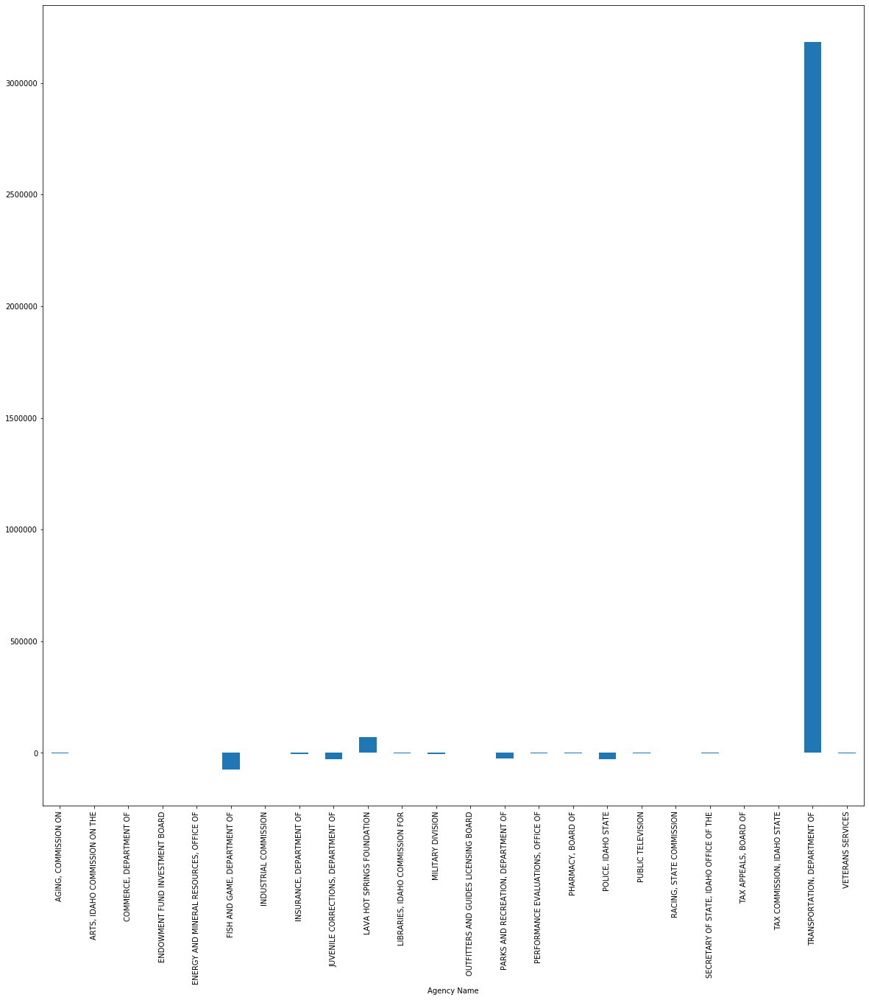

In [960]:
grouped_bank_america_agency_2018 = fy2018[fy2018['Vendor Name'] == 'BANK OF AMERICA'].groupby('Agency Name')
grouped_bank_america_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_bank_america_agency_2018['Amount'].agg(np.sum)

Agency Name
AGING, COMMISSION ON                           -1.732600e+02
ARTS, IDAHO COMMISSION ON THE                   7.105427e-15
CORRECTIONAL INDUSTRIES                         0.000000e+00
ENERGY AND MINERAL RESOURCES, OFFICE OF         0.000000e+00
FISH AND GAME, DEPARTMENT OF                   -5.840604e+04
HEALTH DISTRICT 1 (PANHANDLE)                   3.840000e+00
HEALTH DISTRICT 4 (CENTRAL)                     1.420000e+01
HEALTH DISTRICT 5 (SOUTH CENTRAL)               0.000000e+00
INDUSTRIAL COMMISSION                          -2.846800e+02
INSURANCE, DEPARTMENT OF                       -4.919360e+03
JUVENILE CORRECTIONS, DEPARTMENT OF            -3.131239e+04
LABOR, DEPARTMENT OF                            5.548000e+01
LAVA HOT SPRINGS FOUNDATION                     6.853547e+04
LIBRARIES, IDAHO COMMISSION FOR                -5.511160e+03
MILITARY DIVISION                              -1.048913e+04
PARKS AND RECREATION, DEPARTMENT OF            -2.516151e+04
PERFORMANCE 

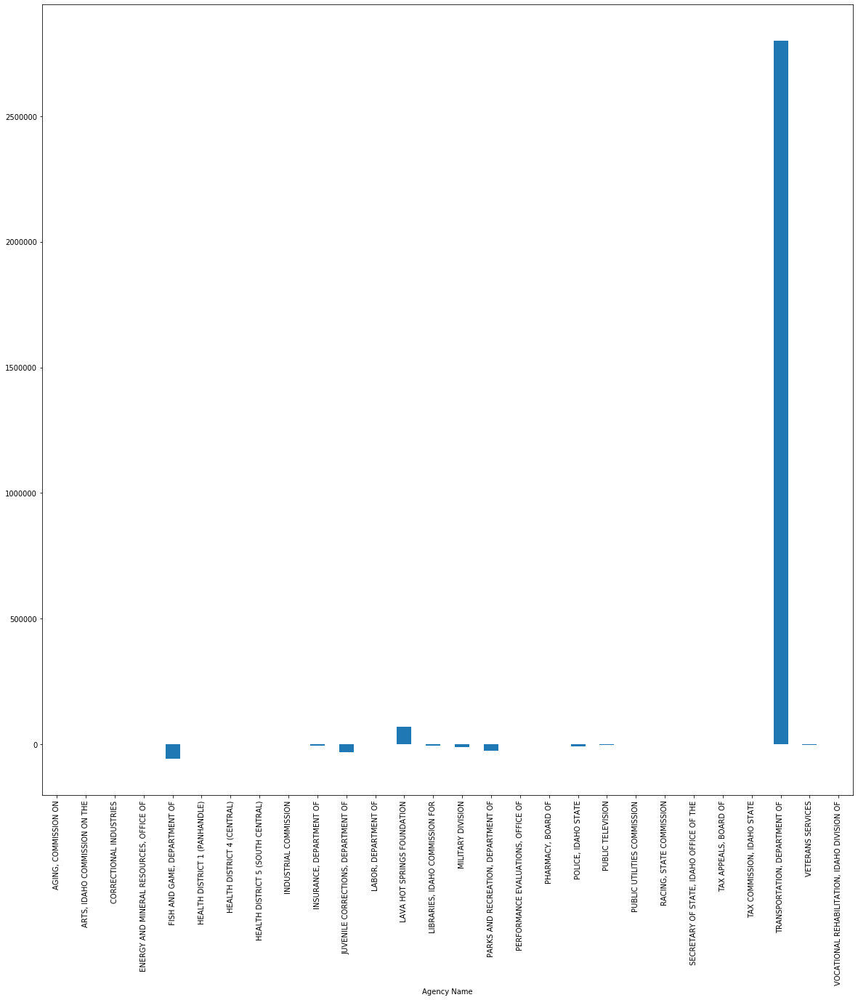

In [961]:
grouped_bank_america_agency_2019 = fy2019[fy2019['Vendor Name'] == 'BANK OF AMERICA'].groupby('Agency Name')
grouped_bank_america_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_bank_america_agency_2019['Amount'].agg(np.sum)

In [962]:
grouped_bank_america_agency_sum_2018 = grouped_bank_america_agency_2018['Amount'].agg(np.sum)
grouped_bank_america_agency_max_sum_2018 = grouped_bank_america_agency_sum_2018.max()
grouped_bank_america_agency_name_sum_2018 = grouped_bank_america_agency_sum_2018.idxmax()
grouped_bank_america_agency_name_sum_2018= grouped_bank_america_agency_name_sum_2018.strip()

grouped_bank_america_agency_sum_2019 = grouped_bank_america_agency_2019['Amount'].agg(np.sum)
grouped_bank_america_agency_max_sum_2019 = grouped_bank_america_agency_sum_2019.max()
grouped_bank_america_agency_name_sum_2019 = grouped_bank_america_agency_sum_2019.idxmax()
grouped_bank_america_agency_name_sum_2019 = grouped_bank_america_agency_name_sum_2019.strip()

print("For 2018, " + grouped_bank_america_agency_name_sum_2018 + " had the most expenditure for the total cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_bank_america_agency_name_sum_2019 + " had the most expenditure for the total cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_bank_america_agency_max_sum_2019 - grouped_bank_america_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, TRANSPORTATION, DEPARTMENT OF had the most expenditure for the total cost of Bank of America from Lodging - Out of State at 3185579.8099999996.
For 2019, TRANSPORTATION, DEPARTMENT OF had the most expenditure for the total cost of Bank of America from Lodging - Out of State at 2800755.5199999996.
The average increase/decrease was -384824.29000000004 between 2018 and 2019.


Agency Name
AGING, COMMISSION ON                      -1.039600e+02
ARTS, IDAHO COMMISSION ON THE             -7.579123e-15
COMMERCE, DEPARTMENT OF                   -5.310000e+00
ENDOWMENT FUND INVESTMENT BOARD           -9.927500e+01
ENERGY AND MINERAL RESOURCES, OFFICE OF    0.000000e+00
FISH AND GAME, DEPARTMENT OF              -1.042915e+03
INDUSTRIAL COMMISSION                      1.250000e+00
INSURANCE, DEPARTMENT OF                  -3.681800e+02
JUVENILE CORRECTIONS, DEPARTMENT OF       -3.961763e+02
LAVA HOT SPRINGS FOUNDATION                5.741008e+02
LIBRARIES, IDAHO COMMISSION FOR           -5.808050e+02
MILITARY DIVISION                         -3.219047e+02
OUTFITTERS AND GUIDES LICENSING BOARD      1.218500e+02
PARKS AND RECREATION, DEPARTMENT OF       -6.034300e+03
PERFORMANCE EVALUATIONS, OFFICE OF        -7.247750e+01
PHARMACY, BOARD OF                        -2.439475e+02
POLICE, IDAHO STATE                       -8.329622e+02
PUBLIC TELEVISION                   

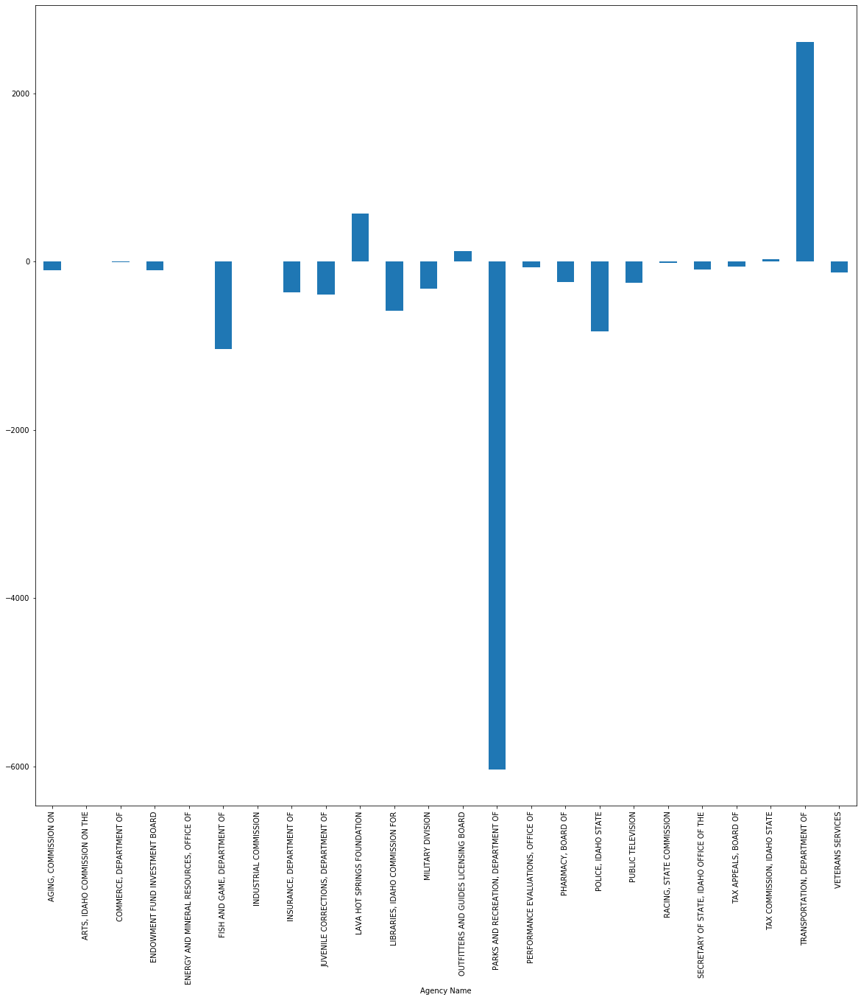

In [963]:
grouped_bank_america_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_bank_america_agency_2018['Amount'].agg(np.mean)

Agency Name
AGING, COMMISSION ON                           -5.775333e+01
ARTS, IDAHO COMMISSION ON THE                   8.881784e-16
CORRECTIONAL INDUSTRIES                         0.000000e+00
ENERGY AND MINERAL RESOURCES, OFFICE OF         0.000000e+00
FISH AND GAME, DEPARTMENT OF                   -1.168121e+03
HEALTH DISTRICT 1 (PANHANDLE)                   3.840000e+00
HEALTH DISTRICT 4 (CENTRAL)                     1.420000e+01
HEALTH DISTRICT 5 (SOUTH CENTRAL)               0.000000e+00
INDUSTRIAL COMMISSION                          -1.423400e+02
INSURANCE, DEPARTMENT OF                       -7.027657e+02
JUVENILE CORRECTIONS, DEPARTMENT OF            -3.518246e+02
LABOR, DEPARTMENT OF                            2.774000e+01
LAVA HOT SPRINGS FOUNDATION                     4.599696e+02
LIBRARIES, IDAHO COMMISSION FOR                -1.102232e+03
MILITARY DIVISION                              -3.616941e+02
PARKS AND RECREATION, DEPARTMENT OF            -6.290377e+03
PERFORMANCE 

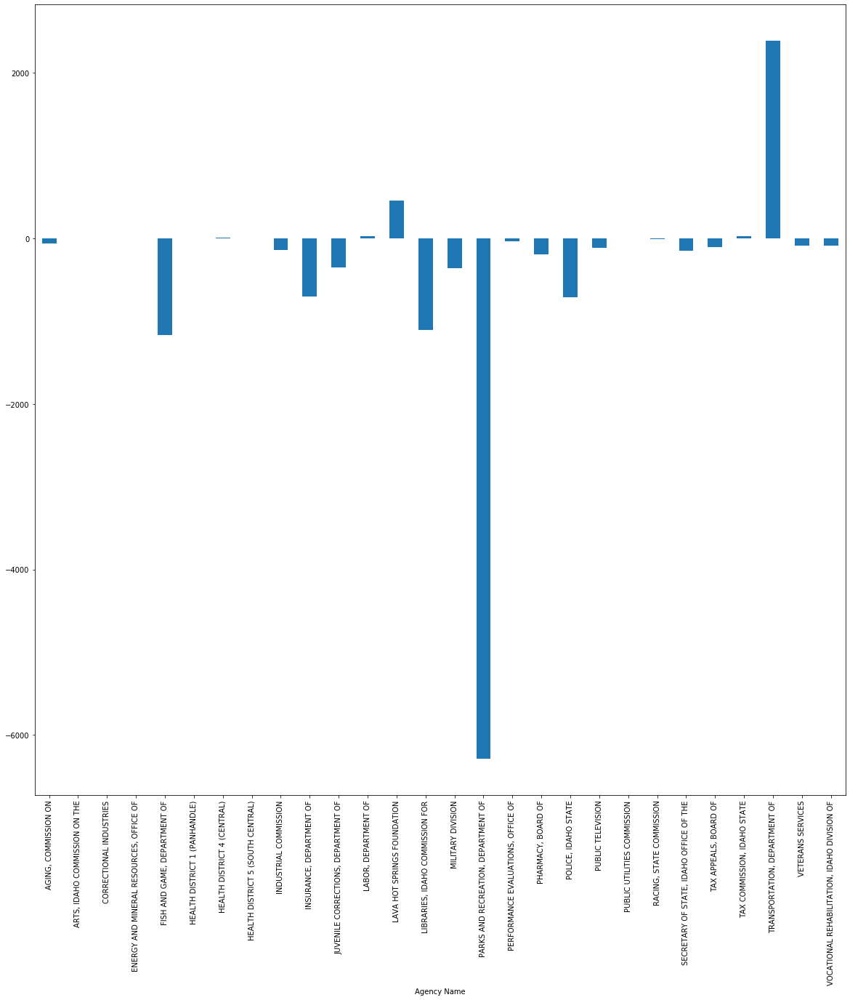

In [964]:
grouped_bank_america_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_bank_america_agency_2019['Amount'].agg(np.mean)

In [965]:
grouped_bank_america_agency_mean_2018 = grouped_bank_america_agency_2018['Amount'].agg(np.mean)
grouped_bank_america_agency_max_mean_2018 = grouped_bank_america_agency_mean_2018.max()
grouped_bank_america_agency_name_mean_2018 = grouped_bank_america_agency_mean_2018.idxmax()
grouped_bank_america_agency_name_mean_2018= grouped_bank_america_agency_name_mean_2018.strip()

grouped_bank_america_agency_mean_2019 = grouped_bank_america_agency_2019['Amount'].agg(np.mean)
grouped_bank_america_agency_max_mean_2019 = grouped_bank_america_agency_mean_2019.max()
grouped_bank_america_agency_name_mean_2019 = grouped_bank_america_agency_mean_2019.idxmax()
grouped_bank_america_agency_name_mean_2019 = grouped_bank_america_agency_name_mean_2019.strip()

print("For 2018, " + grouped_bank_america_agency_name_mean_2018 + " had the most expenditure for the average cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_bank_america_agency_name_mean_2019 + " had the most expenditure for the average cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_bank_america_agency_max_mean_2019 - grouped_bank_america_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, TRANSPORTATION, DEPARTMENT OF had the most expenditure for the average cost of Bank of America from Lodging - Out of State at 2613.2730188679243.
For 2019, TRANSPORTATION, DEPARTMENT OF had the most expenditure for the average cost of Bank of America from Lodging - Out of State at 2391.7638941075998.
The average increase/decrease was -221.50912476032454 between 2018 and 2019.


In [966]:
grouped_bank_america_agency_mean_2018 = grouped_bank_america_agency_2018['Amount'].agg(np.mean)
grouped_bank_america_agency_min_mean_2018 = grouped_bank_america_agency_mean_2018.min()
grouped_bank_america_agency_name_mean_2018 = grouped_bank_america_agency_mean_2018.idxmin()
grouped_bank_america_agency_name_mean_2018= grouped_bank_america_agency_name_mean_2018.strip()

grouped_bank_america_agency_mean_2019 = grouped_bank_america_agency_2019['Amount'].agg(np.mean)
grouped_bank_america_agency_min_mean_2019 = grouped_bank_america_agency_mean_2019.min()
grouped_bank_america_agency_name_mean_2019 = grouped_bank_america_agency_mean_2019.idxmin()
grouped_bank_america_agency_name_mean_2019 = grouped_bank_america_agency_name_mean_2019.strip()

print("For 2018, " + grouped_bank_america_agency_name_mean_2018 + " had the least expenditure for the average cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_agency_min_mean_2018) + ".")
print("For 2019, " + grouped_bank_america_agency_name_mean_2019 + " had the least expenditure for the average cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_agency_min_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_bank_america_agency_min_mean_2019 - grouped_bank_america_agency_min_mean_2018) + " between 2018 and 2019.")

For 2018, PARKS AND RECREATION, DEPARTMENT OF had the least expenditure for the average cost of Bank of America from Lodging - Out of State at -6034.3.
For 2019, PARKS AND RECREATION, DEPARTMENT OF had the least expenditure for the average cost of Bank of America from Lodging - Out of State at -6290.3775.
The average increase/decrease was -256.0774999999994 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES          6801.13
ADMINISTRATIVE SUPPLIES        238815.43
BLDG & IMPROVEMENTS              3139.85
COMMUNICATION COSTS              8227.21
COMPUTER SERVICES             1098595.96
COMPUTER SUPPLIES               84444.06
EMPLOYEE DEVELOPMENT COSTS     252316.97
EMPLOYEE TRAVEL COSTS          413466.84
FUEL & LUBRICANTS COSTS          3200.68
GENERAL SERVICES                44931.18
INST & RESIDENT SUPPLIES       -24694.03
INSURANCE                           0.00
MFG & MERCH COSTS               18944.58
MISC EXPENDITURES             -142855.84
PROFESSIONAL SERVICES           56532.35
PROPERTY & IMPROVEMENTS           400.50
RENTALS & OPER LEASES           15402.59
REPAIR & MAINT SUPPLIES        247348.60
REPAIR & MAINT SVCS            626604.90
SITE DEVELOPMENTS                 978.50
SPECIFIC USE EQUIPMENT           5554.80
SPECIFIC USE SUPPLIES          123329.86
UTILITY CHARGES                   920.63
Name: Amount, dtype: float64

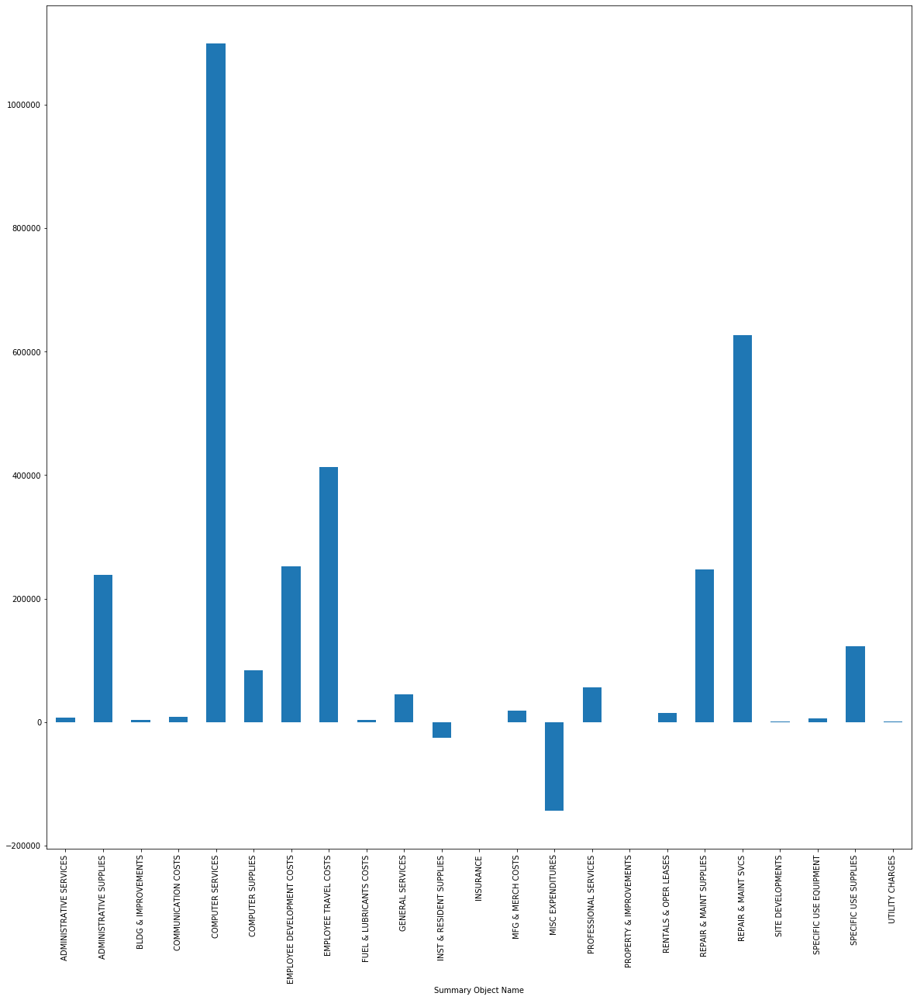

In [967]:
grouped_bank_america_summary_2018 = fy2018[fy2018['Vendor Name'] == 'BANK OF AMERICA'].groupby('Summary Object Name')
grouped_bank_america_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_bank_america_summary_2018['Amount'].agg(np.sum)

Summary Object Name
ADMINISTRATIVE SERVICES             4852.71
ADMINISTRATIVE SUPPLIES           222922.27
BLDG & IMPROVEMENTS                   51.60
COMMUNICATION COSTS                 4518.90
COMPUTER SERVICES                   3830.02
COMPUTER SUPPLIES                  30264.39
EMPLOYEE DEVELOPMENT COSTS        305837.00
EMPLOYEE TRAVEL COSTS             455371.21
FUEL & LUBRICANTS COSTS             2224.99
GENERAL SERVICES                   10255.11
INST & RESIDENT SUPPLIES          -27366.76
MFG & MERCH COSTS                  19602.42
MISC EXPENDITURES                 -50635.46
MOTORIZED/NON-MOTORIZED EQUIP       1159.60
PROFESSIONAL SERVICES              52008.98
PROPERTY & IMPROVEMENTS             2617.13
RENTALS & OPER LEASES               9594.12
REPAIR & MAINT SUPPLIES           118311.76
REPAIR & MAINT SVCS              1483028.07
SPECIFIC USE EQUIPMENT              3404.99
SPECIFIC USE SUPPLIES              65520.23
UTILITY CHARGES                     1736.79
Name: Amount

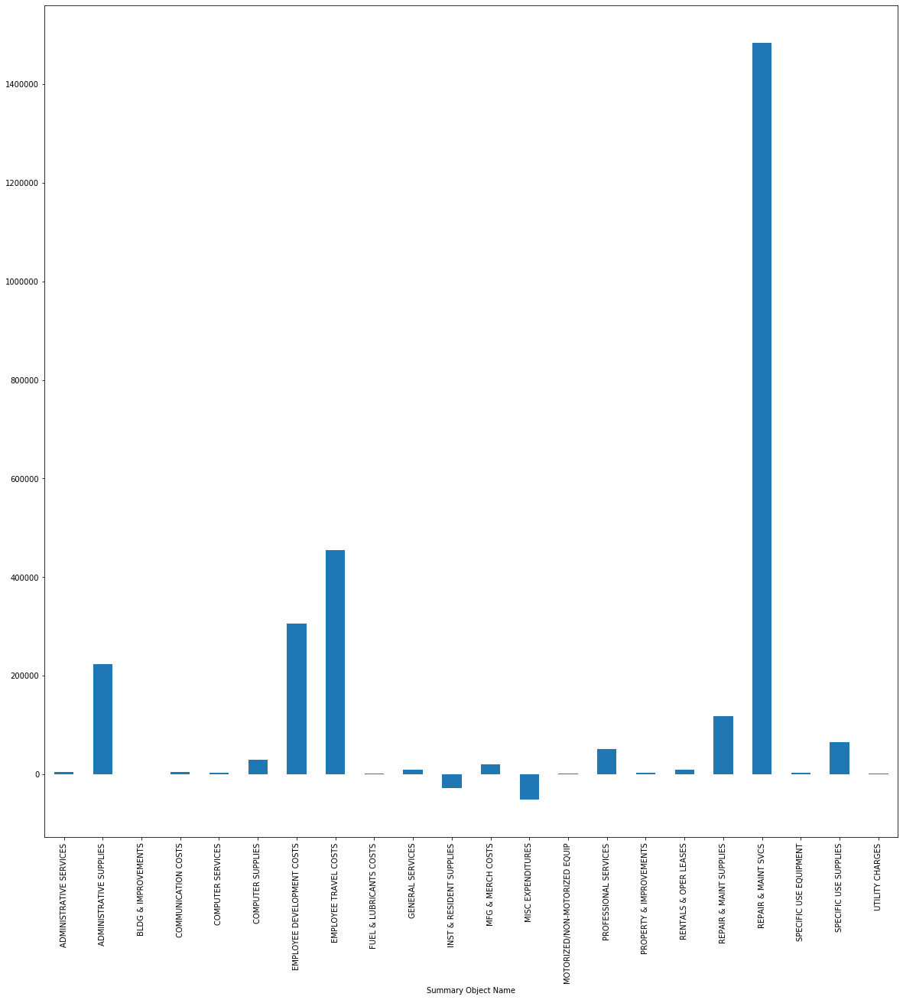

In [968]:
grouped_bank_america_summary_2019 = fy2019[fy2019['Vendor Name'] == 'BANK OF AMERICA'].groupby('Summary Object Name')
grouped_bank_america_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_bank_america_summary_2019['Amount'].agg(np.sum)

In [969]:
grouped_bank_america_summary_sum_2018 = grouped_bank_america_summary_2018['Amount'].agg(np.sum)
grouped_bank_america_summary_max_sum_2018 = grouped_bank_america_summary_sum_2018.max()
grouped_bank_america_summary_name_sum_2018 = grouped_bank_america_summary_sum_2018.idxmax()
grouped_bank_america_summary_name_sum_2018= grouped_bank_america_summary_name_sum_2018.strip()

grouped_bank_america_summary_sum_2019 = grouped_bank_america_summary_2019['Amount'].agg(np.sum)
grouped_bank_america_summary_max_sum_2019 = grouped_bank_america_summary_sum_2019.max()
grouped_bank_america_summary_name_sum_2019 = grouped_bank_america_summary_sum_2019.idxmax()
grouped_bank_america_summary_name_sum_2019 = grouped_bank_america_summary_name_sum_2019.strip()

print("For 2018, " + grouped_bank_america_summary_name_sum_2018 + " had the most expenditure for the total cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_bank_america_summary_name_sum_2019 + " had the most expenditure for the total cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_summary_max_sum_2019) + ".")
#print("The average increase/decrease was " + str(grouped_bank_america_summary_max_sum_2019 - grouped_bank_america_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, COMPUTER SERVICES had the most expenditure for the total cost of Bank of America from Lodging - Out of State at 1098595.96.
For 2019, REPAIR & MAINT SVCS had the most expenditure for the total cost of Bank of America from Lodging - Out of State at 1483028.0699999998.


Summary Object Name
ADMINISTRATIVE SERVICES         272.045200
ADMINISTRATIVE SUPPLIES        2843.040833
BLDG & IMPROVEMENTS            3139.850000
COMMUNICATION COSTS             128.550156
COMPUTER SERVICES             91549.663333
COMPUTER SUPPLIES               888.884842
EMPLOYEE DEVELOPMENT COSTS     2655.968105
EMPLOYEE TRAVEL COSTS          1114.465876
FUEL & LUBRICANTS COSTS         106.689333
GENERAL SERVICES                955.982553
INST & RESIDENT SUPPLIES      -3086.753750
INSURANCE                         0.000000
MFG & MERCH COSTS              1457.275385
MISC EXPENDITURES              -629.320881
PROFESSIONAL SERVICES          1284.826136
PROPERTY & IMPROVEMENTS         400.500000
RENTALS & OPER LEASES           302.011569
REPAIR & MAINT SUPPLIES        1089.641410
REPAIR & MAINT SVCS            9946.109524
SITE DEVELOPMENTS               978.500000
SPECIFIC USE EQUIPMENT         2777.400000
SPECIFIC USE SUPPLIES           806.077516
UTILITY CHARGES                  7

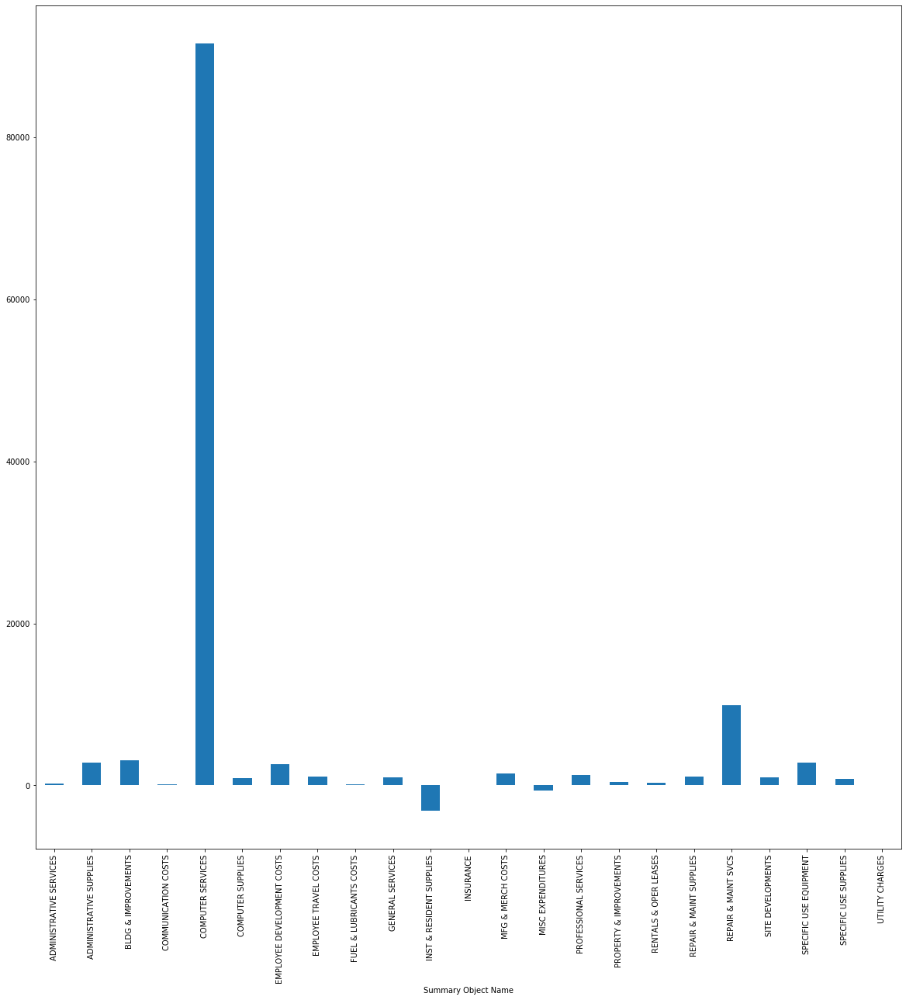

In [970]:
grouped_bank_america_summary_2018['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_bank_america_summary_2018['Amount'].agg(np.mean)

Summary Object Name
ADMINISTRATIVE SERVICES            285.453529
ADMINISTRATIVE SUPPLIES           2103.040283
BLDG & IMPROVEMENTS                 51.600000
COMMUNICATION COSTS                 54.444578
COMPUTER SERVICES                  766.004000
COMPUTER SUPPLIES                  351.911512
EMPLOYEE DEVELOPMENT COSTS        2446.696000
EMPLOYEE TRAVEL COSTS             1127.156460
FUEL & LUBRICANTS COSTS             88.999600
GENERAL SERVICES                   466.141364
INST & RESIDENT SUPPLIES         -3040.751111
MFG & MERCH COSTS                 1089.023333
MISC EXPENDITURES                 -228.087658
MOTORIZED/NON-MOTORIZED EQUIP     1159.600000
PROFESSIONAL SERVICES             1083.520417
PROPERTY & IMPROVEMENTS            436.188333
RENTALS & OPER LEASES              282.180000
REPAIR & MAINT SUPPLIES            591.558800
REPAIR & MAINT SVCS              42372.230571
SPECIFIC USE EQUIPMENT            1134.996667
SPECIFIC USE SUPPLIES              474.784275
UTILITY CHARGE

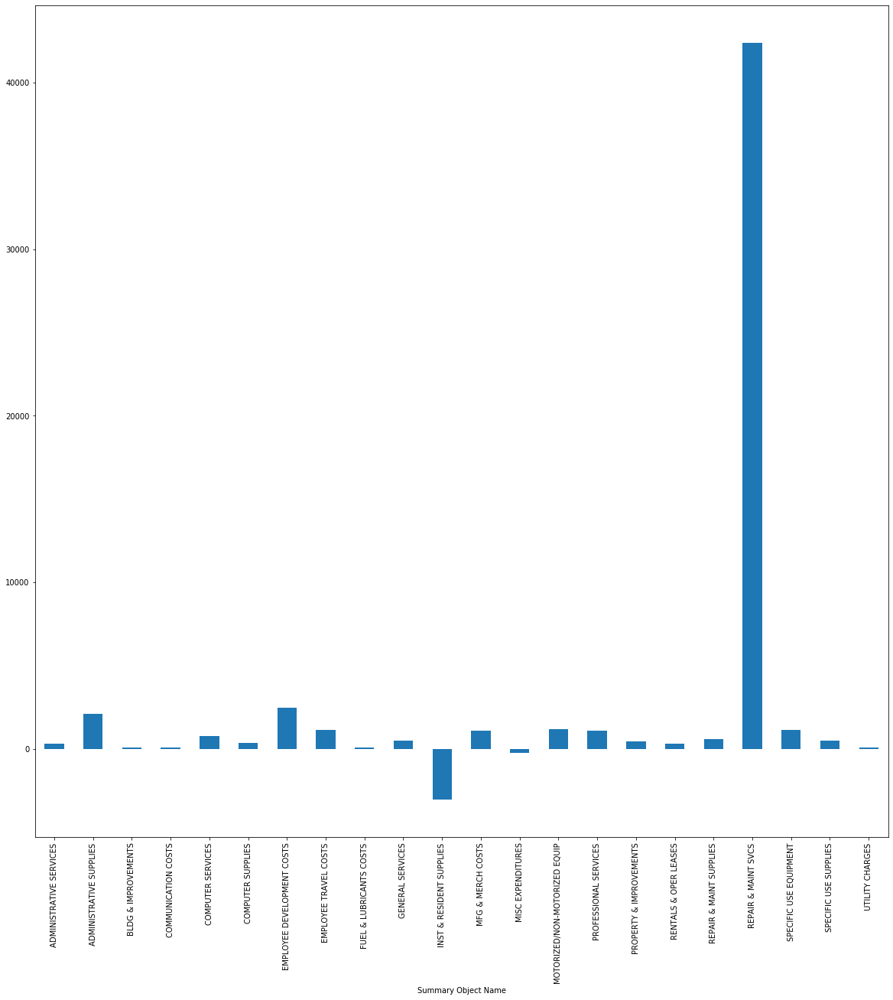

In [971]:
grouped_bank_america_summary_2019['Amount'].agg(np.mean).plot.bar(figsize=(20,20))
grouped_bank_america_summary_2019['Amount'].agg(np.mean)

In [972]:
grouped_bank_america_summary_mean_2018 = grouped_bank_america_summary_2018['Amount'].agg(np.mean)
grouped_bank_america_summary_max_mean_2018 = grouped_bank_america_summary_mean_2018.max()
grouped_bank_america_summary_name_mean_2018 = grouped_bank_america_summary_mean_2018.idxmax()
grouped_bank_america_summary_name_mean_2018= grouped_bank_america_summary_name_mean_2018.strip()

grouped_bank_america_summary_mean_2019 = grouped_bank_america_summary_2019['Amount'].agg(np.mean)
grouped_bank_america_summary_max_mean_2019 = grouped_bank_america_summary_mean_2019.max()
grouped_bank_america_summary_name_mean_2019 = grouped_bank_america_summary_mean_2019.idxmax()
grouped_bank_america_summary_name_mean_2019 = grouped_bank_america_summary_name_mean_2019.strip()

print("For 2018, " + grouped_bank_america_summary_name_mean_2018 + " had the most expenditure for the average cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_bank_america_summary_name_mean_2019 + " had the most expenditure for the average cost of Bank of America from Lodging - Out of State at " + str(grouped_bank_america_summary_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_bank_america_summary_max_mean_2019 - grouped_bank_america_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, COMPUTER SERVICES had the most expenditure for the average cost of Bank of America from Lodging - Out of State at 91549.66333333333.
For 2019, REPAIR & MAINT SVCS had the most expenditure for the average cost of Bank of America from Lodging - Out of State at 42372.23057142857.


In [973]:
grouped_air_outstate_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'COMMERCIAL AIR OUT-STATE'].groupby('Vendor Name')

In [974]:
grouped_air_outstate_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'COMMERCIAL AIR OUT-STATE'].groupby('Vendor Name')

In [975]:
grouped_air_outstate_vendor_sum_2018 = grouped_air_outstate_vendor_2018['Amount'].agg(np.sum)
grouped_air_outstate_vendor_max_sum_2018 = grouped_air_outstate_vendor_sum_2018.max()
grouped_air_outstate_vendor_name_sum_2018 = grouped_air_outstate_vendor_sum_2018.idxmax()
grouped_air_outstate_vendor_name_sum_2018= grouped_air_outstate_vendor_name_sum_2018.strip()

grouped_air_outstate_vendor_sum_2019 = grouped_air_outstate_vendor_2019['Amount'].agg(np.sum)
grouped_air_outstate_vendor_max_sum_2019 = grouped_air_outstate_vendor_sum_2019.max()
grouped_air_outstate_vendor_name_sum_2019 = grouped_air_outstate_vendor_sum_2019.idxmax()
grouped_air_outstate_vendor_name_sum_2019 = grouped_air_outstate_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_air_outstate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Commerical Air Out of State at " + str(grouped_air_outstate_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_air_outstate_vendor_name_sum_2019 + " had the most expenditure for the total cost of Commerical Air Out of State at " + str(grouped_air_outstate_vendor_max_sum_2019) + ".")
#print("The average increase/decrease was " + str(grouped_air_outstate_vendor_max_sum_2019 - grouped_air_outstate_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, PCARD - UNITED had the most expenditure for the total cost of Commerical Air Out of State at 384049.9399999993.
For 2019, PCARD - DELTA AIR had the most expenditure for the total cost of Commerical Air Out of State at 384762.42999999976.


In [976]:
grouped_air_outstate_vendor_mean_2018 = grouped_air_outstate_vendor_2018['Amount'].agg(np.mean)
grouped_air_outstate_vendor_max_mean_2018 = grouped_air_outstate_vendor_mean_2018.max()
grouped_air_outstate_vendor_name_mean_2018 = grouped_air_outstate_vendor_mean_2018.idxmax()
grouped_air_outstate_vendor_name_mean_2018= grouped_air_outstate_vendor_name_mean_2018.strip()

grouped_air_outstate_vendor_mean_2019 = grouped_air_outstate_vendor_2019['Amount'].agg(np.mean)
grouped_air_outstate_vendor_max_mean_2019 = grouped_air_outstate_vendor_mean_2019.max()
grouped_air_outstate_vendor_name_mean_2019 = grouped_air_outstate_vendor_mean_2019.idxmax()
grouped_air_outstate_vendor_name_mean_2019 = grouped_air_outstate_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_air_outstate_vendor_name_mean_2018 + " had the most expenditure for the average cost of Commerical Air Out of State at " + str(grouped_air_outstate_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_air_outstate_vendor_name_mean_2019 + " had the most expenditure for the average cost of Commerical Air Out of State at " + str(grouped_air_outstate_vendor_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_air_outstate_vendor_max_mean_2019 - grouped_air_outstate_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the average cost of Commerical Air Out of State at 9433.541249999998.
For 2019, BOISE STATE UNIVERSITY had the most expenditure for the average cost of Commerical Air Out of State at 5956.187457627119.


Agency Name
ADMINISTRATION, DEPARTMENT OF                       3727.56
AGRICULTURE, DEPARTMENT OF                         30764.45
ARTS, IDAHO COMMISSION ON THE                        823.00
ATTORNEY GENERAL, OFFICE OF THE                    19186.65
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE     1999.31
                                                     ...   
STEM ACTION CENTER                                 17044.50
TREASURER, STATE OFFICE OF THE                      5813.50
VETERANS SERVICES                                   2210.50
VETERINARY MEDICINE, BOARD OF                        453.10
VOCATIONAL REHABILITATION, IDAHO DIVISION OF        6703.23
Name: Amount, Length: 61, dtype: float64

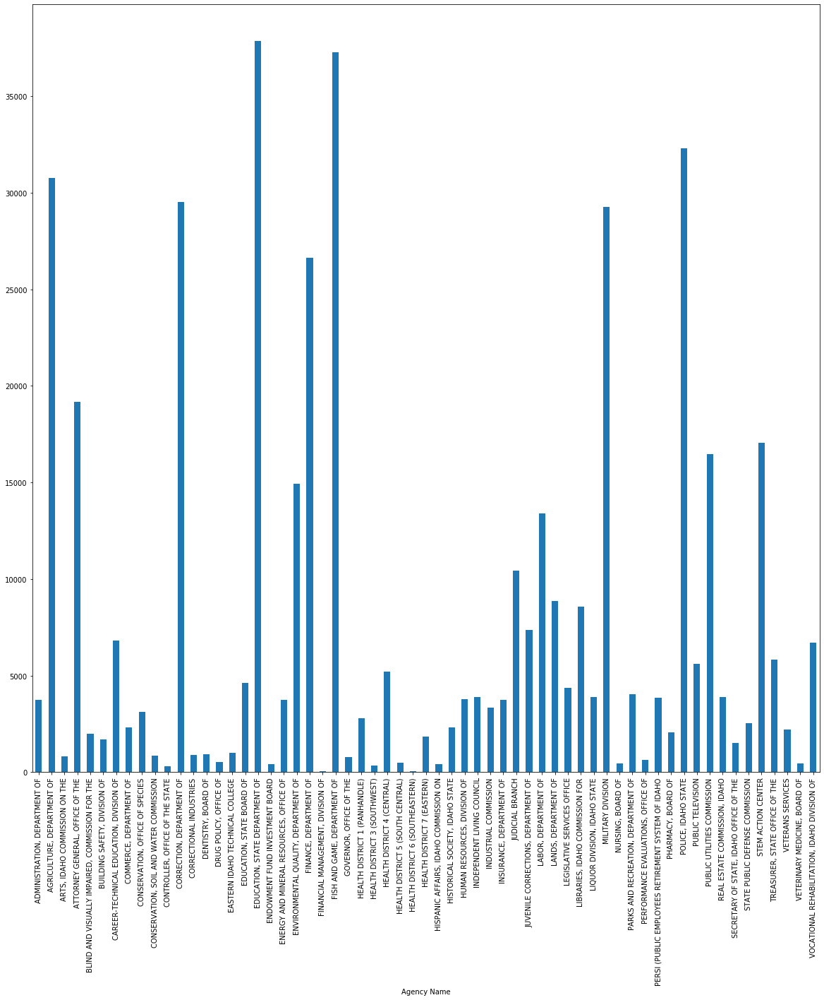

In [977]:
grouped_united_agency_2018 = fy2018[fy2018['Vendor Name'] == 'PCARD - UNITED'].groupby('Agency Name')
grouped_united_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_united_agency_2018['Amount'].agg(np.sum)

Agency Name
ADMINISTRATION, DEPARTMENT OF                   6729.39
AGING, COMMISSION ON                            1702.99
AGRICULTURE, DEPARTMENT OF                      7825.15
ARTS, IDAHO COMMISSION ON THE                     60.00
ATTORNEY GENERAL, OFFICE OF THE                 8464.50
                                                 ...   
STEM ACTION CENTER                               741.60
TREASURER, STATE OFFICE OF THE                  2136.60
VETERANS SERVICES                               8680.30
VOCATIONAL REHABILITATION, IDAHO DIVISION OF    2685.00
WATER RESOURCES, DEPARTMENT OF                  3882.00
Name: Amount, Length: 61, dtype: float64

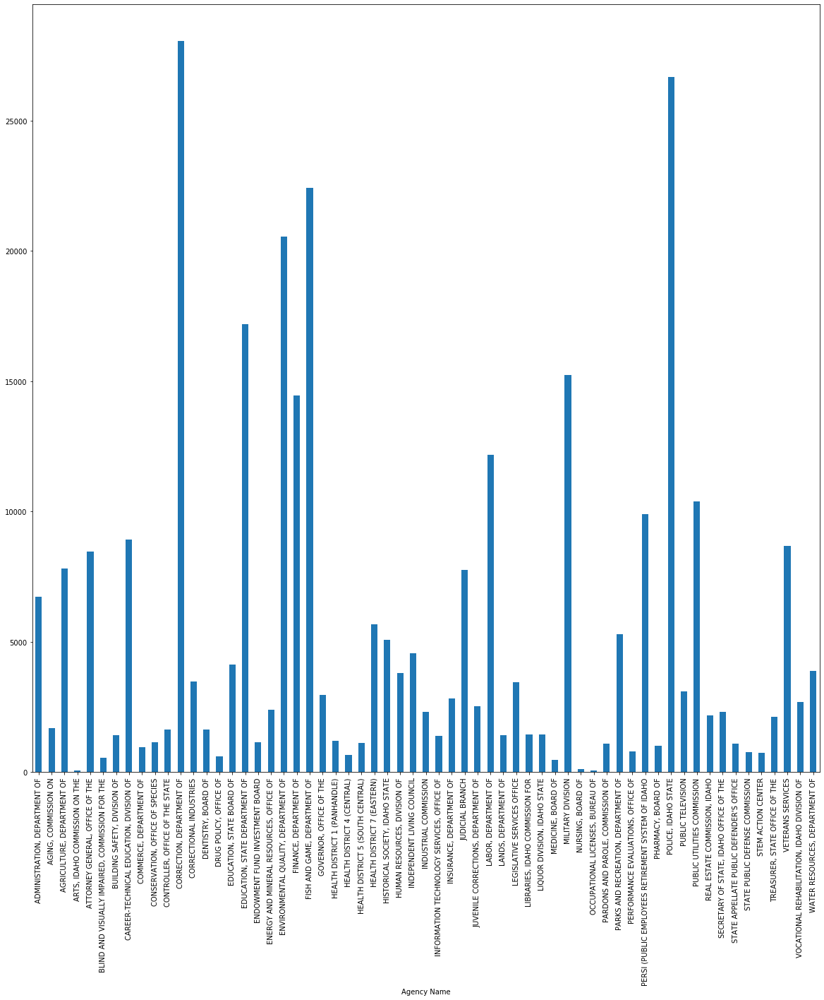

In [978]:
grouped_united_agency_2019 = fy2019[fy2019['Vendor Name'] == 'PCARD - UNITED'].groupby('Agency Name')
grouped_united_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_united_agency_2019['Amount'].agg(np.sum)

In [979]:
grouped_united_agency_sum_2018 = grouped_united_agency_2018['Amount'].agg(np.sum)
grouped_united_agency_max_sum_2018 = grouped_united_agency_sum_2018.max()
grouped_united_agency_name_sum_2018 = grouped_united_agency_sum_2018.idxmax()
grouped_united_agency_name_sum_2018= grouped_united_agency_name_sum_2018.strip()

grouped_united_agency_sum_2019 = grouped_united_agency_2019['Amount'].agg(np.sum)
grouped_united_agency_max_sum_2019 = grouped_united_agency_sum_2019.max()
grouped_united_agency_name_sum_2019 = grouped_united_agency_sum_2019.idxmax()
grouped_united_agency_name_sum_2019 = grouped_united_agency_name_sum_2019.strip()

print("For 2018, " + grouped_united_agency_name_sum_2018 + " had the most expenditure for the total cost of Pcard - United from Commerical Air Out of State at " + str(grouped_united_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_united_agency_name_sum_2019 + " had the most expenditure for the total cost of Pcard - United from Commerical Air Out of State at " + str(grouped_united_agency_max_sum_2019) + ".")
#print("The average increase/decrease was " + str(grouped_united_agency_max_sum_2019 - grouped_united_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, EDUCATION, STATE DEPARTMENT OF had the most expenditure for the total cost of Pcard - United from Commerical Air Out of State at 37853.07000000001.
For 2019, CORRECTION, DEPARTMENT OF had the most expenditure for the total cost of Pcard - United from Commerical Air Out of State at 28051.58.


In [980]:
grouped_united_agency_mean_2018 = grouped_united_agency_2018['Amount'].agg(np.mean)
grouped_united_agency_max_mean_2018 = grouped_united_agency_mean_2018.max()
grouped_united_agency_name_mean_2018 = grouped_united_agency_mean_2018.idxmax()
grouped_united_agency_name_mean_2018= grouped_united_agency_name_mean_2018.strip()

grouped_united_agency_mean_2019 = grouped_united_agency_2019['Amount'].agg(np.mean)
grouped_united_agency_max_mean_2019 = grouped_united_agency_mean_2019.max()
grouped_united_agency_name_mean_2019 = grouped_united_agency_mean_2019.idxmax()
grouped_united_agency_name_mean_2019 = grouped_united_agency_name_mean_2019.strip()

print("For 2018, " + grouped_united_agency_name_mean_2018 + " had the most expenditure for the average cost of Pcard - United from Commerical Air Out of State at " + str(grouped_united_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_united_agency_name_mean_2019 + " had the most expenditure for the average cost of Pcard - United from Commerical Air Out of State at " + str(grouped_united_agency_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_united_agency_max_mean_2019 - grouped_united_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, STEM ACTION CENTER had the most expenditure for the average cost of Pcard - United from Commerical Air Out of State at 2434.9285714285716.
For 2019, STATE APPELLATE PUBLIC DEFENDER'S OFFICE had the most expenditure for the average cost of Pcard - United from Commerical Air Out of State at 1086.2.


Agency Name
ADMINISTRATION, DEPARTMENT OF                          2050.30
AGRICULTURE, DEPARTMENT OF                             4575.50
ARTS, IDAHO COMMISSION ON THE                          1677.02
ATTORNEY GENERAL, OFFICE OF THE                        3410.00
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE        6786.70
BRAND INSPECTOR, STATE                                  129.60
BUILDING SAFETY, DIVISION OF                           5617.89
CAREER-TECHNICAL EDUCATION, DIVISION OF                6029.00
COMMERCE, DEPARTMENT OF                                1588.20
CONSERVATION, OFFICE OF SPECIES                        1051.80
CONSERVATION, SOIL AND WATER COMMISSION                1868.90
CONTROLLER, OFFICE OF THE STATE                         529.00
CORRECTION, DEPARTMENT OF                             10594.45
CORRECTIONAL INDUSTRIES                                 598.50
DRUG POLICY, OFFICE OF                                 2410.57
EASTERN IDAHO TECHNICAL COLLEGE            

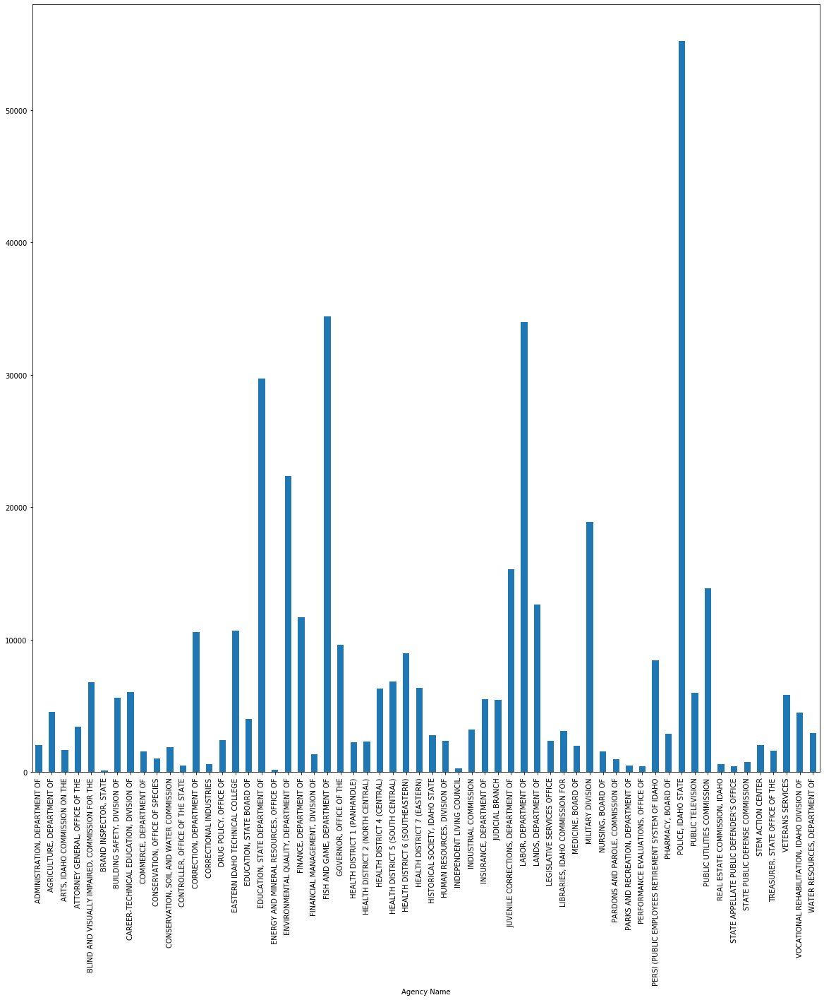

In [981]:
grouped_delta_agency_2018 = fy2018[fy2018['Vendor Name'] == 'PCARD - DELTA AIR'].groupby('Agency Name')
grouped_delta_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_delta_agency_2018['Amount'].agg(np.sum)

Agency Name
ADMINISTRATION, DEPARTMENT OF                          1612.90
AGING, COMMISSION ON                                   1609.70
AGRICULTURE, DEPARTMENT OF                             8431.50
ARTS, IDAHO COMMISSION ON THE                          1382.90
ATTORNEY GENERAL, OFFICE OF THE                        5027.60
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE        3637.20
BRAND INSPECTOR, STATE                                  478.00
BUILDING SAFETY, DIVISION OF                           2588.29
CAREER-TECHNICAL EDUCATION, DIVISION OF               31414.80
COMMERCE, DEPARTMENT OF                                1279.60
CONSERVATION, SOIL AND WATER COMMISSION                 433.10
CONTROLLER, OFFICE OF THE STATE                         883.90
CORRECTION, DEPARTMENT OF                             17108.22
CORRECTIONAL INDUSTRIES                                1131.20
DENTISTRY, BOARD OF                                     954.60
DRUG POLICY, OFFICE OF                     

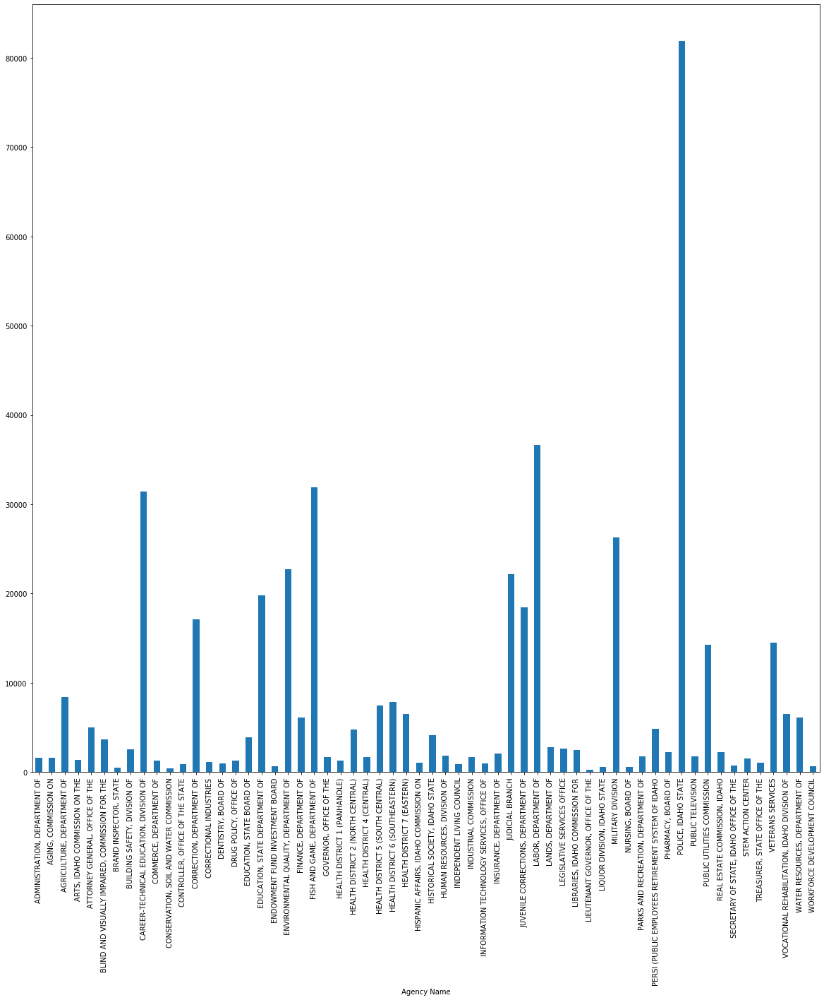

In [982]:
grouped_delta_agency_2019 = fy2019[fy2019['Vendor Name'] == 'PCARD - DELTA AIR'].groupby('Agency Name')
grouped_delta_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(20,20))
grouped_delta_agency_2019['Amount'].agg(np.sum)

In [983]:
grouped_delta_agency_sum_2018 = grouped_delta_agency_2018['Amount'].agg(np.sum)
grouped_delta_agency_max_sum_2018 = grouped_delta_agency_sum_2018.max()
grouped_delta_agency_name_sum_2018 = grouped_delta_agency_sum_2018.idxmax()
grouped_delta_agency_name_sum_2018= grouped_delta_agency_name_sum_2018.strip()

grouped_delta_agency_sum_2019 = grouped_delta_agency_2019['Amount'].agg(np.sum)
grouped_delta_agency_max_sum_2019 = grouped_delta_agency_sum_2019.max()
grouped_delta_agency_name_sum_2019 = grouped_delta_agency_sum_2019.idxmax()
grouped_delta_agency_name_sum_2019 = grouped_delta_agency_name_sum_2019.strip()

print("For 2018, " + grouped_delta_agency_name_sum_2018 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at " + str(grouped_delta_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_delta_agency_name_sum_2019 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at " + str(grouped_delta_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_delta_agency_max_sum_2019 - grouped_delta_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, POLICE, IDAHO STATE had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at 55225.12999999998.
For 2019, POLICE, IDAHO STATE had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at 81866.50999999997.
The average increase/decrease was 26641.379999999983 between 2018 and 2019.


In [984]:
grouped_delta_agency_mean_2018 = grouped_delta_agency_2018['Amount'].agg(np.mean)
grouped_delta_agency_max_mean_2018 = grouped_delta_agency_mean_2018.max()
grouped_delta_agency_name_mean_2018 = grouped_delta_agency_mean_2018.idxmax()
grouped_delta_agency_name_mean_2018= grouped_delta_agency_name_mean_2018.strip()

grouped_delta_agency_mean_2019 = grouped_delta_agency_2019['Amount'].agg(np.mean)
grouped_delta_agency_max_mean_2019 = grouped_delta_agency_mean_2019.max()
grouped_delta_agency_name_mean_2019 = grouped_delta_agency_mean_2019.idxmax()
grouped_delta_agency_name_mean_2019 = grouped_delta_agency_name_mean_2019.strip()

print("For 2018, " + grouped_delta_agency_name_mean_2018 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at " + str(grouped_delta_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_delta_agency_name_mean_2019 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at " + str(grouped_delta_agency_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_delta_agency_max_mean_2019 - grouped_delta_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, GOVERNOR, OFFICE OF THE had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at 1203.2625.
For 2019, PHARMACY, BOARD OF had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at 2280.0.


Summary Object Name
EDUC & TRAIN ASSISTANCE      1604.60
EMPLOYEE TRAVEL COSTS      404521.13
MISC EXPENDITURES           16012.29
PROFESSIONAL SERVICES         712.20
Name: Amount, dtype: float64

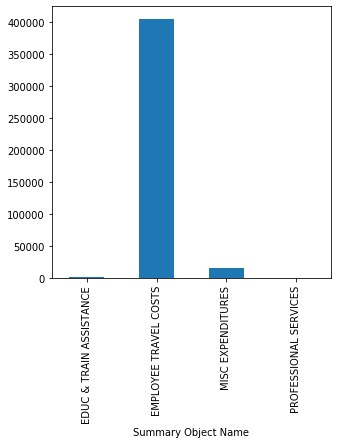

In [985]:
grouped_delta_summary_2018 = fy2018[fy2018['Vendor Name'] == 'PCARD - DELTA AIR'].groupby('Summary Object Name')
grouped_delta_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(5,5))
grouped_delta_summary_2018['Amount'].agg(np.sum)

Summary Object Name
EDUC & TRAIN ASSISTANCE          192.10
EMPLOYEE DEVELOPMENT COSTS       419.60
EMPLOYEE TRAVEL COSTS         443432.59
GENERAL SERVICES                 837.50
MISC EXPENDITURES              15985.99
PROFESSIONAL SERVICES            502.50
Name: Amount, dtype: float64

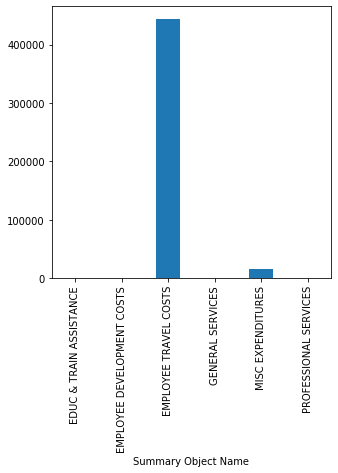

In [986]:
grouped_delta_summary_2019 = fy2019[fy2019['Vendor Name'] == 'PCARD - DELTA AIR'].groupby('Summary Object Name')
grouped_delta_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(5,5))
grouped_delta_summary_2019['Amount'].agg(np.sum)

In [987]:
grouped_delta_summary_sum_2018 = grouped_delta_summary_2018['Amount'].agg(np.sum)
grouped_delta_summary_max_sum_2018 = grouped_delta_summary_sum_2018.max()
grouped_delta_summary_name_sum_2018 = grouped_delta_summary_sum_2018.idxmax()
grouped_delta_summary_name_sum_2018= grouped_delta_summary_name_sum_2018.strip()

grouped_delta_summary_sum_2019 = grouped_delta_summary_2019['Amount'].agg(np.sum)
grouped_delta_summary_max_sum_2019 = grouped_delta_summary_sum_2019.max()
grouped_delta_summary_name_sum_2019 = grouped_delta_summary_sum_2019.idxmax()
grouped_delta_summary_name_sum_2019 = grouped_delta_summary_name_sum_2019.strip()

print("For 2018, " + grouped_delta_summary_name_sum_2018 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at " + str(grouped_delta_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_delta_summary_name_sum_2019 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at " + str(grouped_delta_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_delta_summary_max_sum_2019 - grouped_delta_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, EMPLOYEE TRAVEL COSTS had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at 404521.1299999991.
For 2019, EMPLOYEE TRAVEL COSTS had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at 443432.5899999998.
The average increase/decrease was 38911.46000000072 between 2018 and 2019.


In [988]:
grouped_delta_summary_mean_2018 = grouped_delta_summary_2018['Amount'].agg(np.mean)
grouped_delta_summary_max_mean_2018 = grouped_delta_summary_mean_2018.max()
grouped_delta_summary_name_mean_2018 = grouped_delta_summary_mean_2018.idxmax()
grouped_delta_summary_name_mean_2018= grouped_delta_summary_name_mean_2018.strip()

grouped_delta_summary_mean_2019 = grouped_delta_summary_2019['Amount'].agg(np.mean)
grouped_delta_summary_max_mean_2019 = grouped_delta_summary_mean_2019.max()
grouped_delta_summary_name_mean_2019 = grouped_delta_summary_mean_2019.idxmax()
grouped_delta_summary_name_mean_2019 = grouped_delta_summary_name_mean_2019.strip()

print("For 2018, " + grouped_delta_summary_name_mean_2018 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at " + str(grouped_delta_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_delta_summary_name_mean_2019 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at " + str(grouped_delta_summary_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_delta_summary_max_mean_2019 - grouped_delta_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, PROFESSIONAL SERVICES had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at 712.2.
For 2019, GENERAL SERVICES had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State at 837.5.


In [989]:
print("Listed below are areas of potential cost savings for travel.")

print("\r\n" + grouped_subsistence_instate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Substistence In-State with an average increase of " + str(grouped_subsistence_instate_vendor_max_sum_2019 - grouped_subsistence_instate_vendor_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_riverside_summary_name_sum_2018 + " had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State with an average increase of " + str(grouped_riverside_summary_max_sum_2019 - grouped_riverside_summary_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_vehicle_instate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Personal Vehicle - In-State with an average increase of " + str(grouped_vehicle_instate_vendor_max_sum_2019 - grouped_vehicle_instate_vendor_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_office_finance_summary_name_sum_2018 + " had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable with an average increase of " + str(grouped_office_finance_summary_max_sum_2019 - grouped_office_finance_summary_max_sum_2018) + " between 2018 and 2019.")

print("\r\n " + grouped_subsistence_outstate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Subsistence - Out-State with an average increase of " + str(grouped_subsistence_outstate_vendor_max_sum_2019 - grouped_subsistence_outstate_vendor_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_lodging_outstate_vendor_name_sum_2018 + " had the most expenditure for the total cost of Lodging - Out of State with an average increase of " + str(grouped_lodging_outstate_vendor_max_sum_2019 - grouped_lodging_outstate_vendor_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_delta_agency_name_sum_2018 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State with an average increase of " + str(grouped_delta_agency_max_sum_2019 - grouped_delta_agency_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_delta_summary_name_sum_2018 + " had the most expenditure for the total cost of Pcard - Delta Air from Commerical Air Out of State with an average increase of " + str(grouped_delta_summary_max_sum_2019 - grouped_delta_summary_max_sum_2018) + " between 2018 and 2019.")



Listed below are areas of potential cost savings for travel.

PCARD GENERIC VENDOR had the most expenditure for the total cost of Substistence In-State with an average increase of 2324.6800000001094 between 2018 and 2019.

EMPLOYEE TRAVEL COSTS had the most expenditure for the total cost of Riverside Hospitality LLC from the Lodging - In State with an average increase of 113395.3899999999 between 2018 and 2019.

ISU OFFICE OF FINANCE AND ADMINISTRATION had the most expenditure for the total cost of Personal Vehicle - In-State with an average increase of 17151.29999999996 between 2018 and 2019.

MISC EXPENDITURES had the most expenditure for the total cost of ISU Office of Finance and Administration from Personal Vehicle - In-State and Subsistence In-State Taxable with an average increase of 630338.089999998 between 2018 and 2019.

 BOISE STATE UNIVERSITY had the most expenditure for the total cost of Subsistence - Out-State with an average increase of 20328.68999999971 between 2018 and

In [990]:
# Explore Gross Salary & Wage Costs

In [991]:
grouped_employees_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'EMPLOYEES'].groupby('Vendor Name')

In [992]:
grouped_employees_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'EMPLOYEES'].groupby('Vendor Name')

In [993]:
grouped_employees_vendor_sum_2018 = grouped_employees_vendor_2018['Amount'].agg(np.sum)
grouped_employees_vendor_max_sum_2018 = grouped_employees_vendor_sum_2018.max()
grouped_employees_vendor_name_sum_2018 = grouped_employees_vendor_sum_2018.idxmax()
grouped_employees_vendor_name_sum_2018= grouped_employees_vendor_name_sum_2018.strip()

grouped_employees_vendor_sum_2019 = grouped_employees_vendor_2019['Amount'].agg(np.sum)
grouped_employees_vendor_max_sum_2019 = grouped_employees_vendor_sum_2019.max()
grouped_employees_vendor_name_sum_2019 = grouped_employees_vendor_sum_2019.idxmax()
grouped_employees_vendor_name_sum_2019 = grouped_employees_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_employees_vendor_name_sum_2018 + " had the most expenditure for the total cost of Employees at " + str(grouped_employees_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_employees_vendor_name_sum_2019 + " had the most expenditure for the total cost of Employees at " + str(grouped_employees_vendor_max_sum_2019) + ".")
#print("The average increase/decrease was " + str(grouped_employees_vendor_max_sum_2019 - grouped_employees_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, ISU PR-REV 25 had the most expenditure for the total cost of Employees at 857447.5499999998.
For 2019, UNIVERSITY OF IDAHO had the most expenditure for the total cost of Employees at 2197722.33.


In [994]:
grouped_employees_vendor_mean_2018 = grouped_employees_vendor_2018['Amount'].agg(np.mean)
grouped_employees_vendor_max_mean_2018 = grouped_employees_vendor_mean_2018.max()
grouped_employees_vendor_name_mean_2018 = grouped_employees_vendor_mean_2018.idxmax()
grouped_employees_vendor_name_mean_2018= grouped_employees_vendor_name_mean_2018.strip()

grouped_employees_vendor_mean_2019 = grouped_employees_vendor_2019['Amount'].agg(np.mean)
grouped_employees_vendor_max_mean_2019 = grouped_employees_vendor_mean_2019.max()
grouped_employees_vendor_name_mean_2019 = grouped_employees_vendor_mean_2019.idxmax()
grouped_employees_vendor_name_mean_2019 = grouped_employees_vendor_name_mean_2019.strip()

print("For 2018, " + grouped_employees_vendor_name_mean_2018 + " had the most expenditure for the average cost of Employees at " + str(grouped_employees_vendor_max_mean_2018) + ".")
print("For 2019, " + grouped_employees_vendor_name_mean_2019 + " had the most expenditure for the average cost of Employees at " + str(grouped_employees_vendor_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_employees_vendor_max_mean_2019 - grouped_employees_vendor_max_mean_2018) + " between 2018 and 2019.")

For 2018, IDAHO STATE UNIVERSITY had the most expenditure for the average cost of Employees at 81745.6.
For 2019, UNIVERSITY OF IDAHO had the most expenditure for the average cost of Employees at 95553.1447826087.


Agency Name
IDAHO STATE UNIVERSITY    10468487.88
Name: Amount, dtype: float64

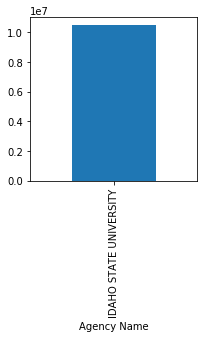

In [995]:
grouped_ISU_PR_REV_25_agency_2018 = fy2018[fy2018['Vendor Name'] == 'ISU PR-REV 25'].groupby('Agency Name')
grouped_ISU_PR_REV_25_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_ISU_PR_REV_25_agency_2018['Amount'].agg(np.sum)

Agency Name
IDAHO STATE UNIVERSITY    11113887.42
Name: Amount, dtype: float64

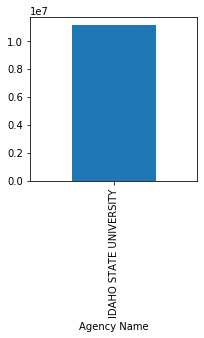

In [996]:
grouped_ISU_PR_REV_25_agency_2019 = fy2019[fy2019['Vendor Name'] == 'ISU PR-REV 25'].groupby('Agency Name')
grouped_ISU_PR_REV_25_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_ISU_PR_REV_25_agency_2019['Amount'].agg(np.sum)

In [997]:
grouped_ISU_PR_REV_25_agency_sum_2018 = grouped_ISU_PR_REV_25_agency_2018['Amount'].agg(np.sum)
grouped_ISU_PR_REV_25_agency_max_sum_2018 = grouped_ISU_PR_REV_25_agency_sum_2018.max()
grouped_ISU_PR_REV_25_agency_name_sum_2018 = grouped_ISU_PR_REV_25_agency_sum_2018.idxmax()
grouped_ISU_PR_REV_25_agency_name_sum_2018= grouped_ISU_PR_REV_25_agency_name_sum_2018.strip()

grouped_ISU_PR_REV_25_agency_sum_2019 = grouped_ISU_PR_REV_25_agency_2019['Amount'].agg(np.sum)
grouped_ISU_PR_REV_25_agency_max_sum_2019 = grouped_ISU_PR_REV_25_agency_sum_2019.max()
grouped_ISU_PR_REV_25_agency_name_sum_2019 = grouped_ISU_PR_REV_25_agency_sum_2019.idxmax()
grouped_ISU_PR_REV_25_agency_name_sum_2019 = grouped_ISU_PR_REV_25_agency_name_sum_2019.strip()

print("For 2018, " + grouped_ISU_PR_REV_25_agency_name_sum_2018 + " had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students at " + str(grouped_ISU_PR_REV_25_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_ISU_PR_REV_25_agency_name_sum_2019 + " had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students at " + str(grouped_ISU_PR_REV_25_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_ISU_PR_REV_25_agency_max_sum_2019 - grouped_ISU_PR_REV_25_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, IDAHO STATE UNIVERSITY had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students at 10468487.880000005.
For 2019, IDAHO STATE UNIVERSITY had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students at 11113887.420000002.
The average increase/decrease was 645399.5399999972 between 2018 and 2019.


In [998]:
grouped_ISU_PR_REV_25_agency_mean_2018 = grouped_ISU_PR_REV_25_agency_2018['Amount'].agg(np.mean)
grouped_ISU_PR_REV_25_agency_max_mean_2018 = grouped_ISU_PR_REV_25_agency_mean_2018.max()
grouped_ISU_PR_REV_25_agency_name_mean_2018 = grouped_ISU_PR_REV_25_agency_mean_2018.idxmax()
grouped_ISU_PR_REV_25_agency_name_mean_2018= grouped_ISU_PR_REV_25_agency_name_mean_2018.strip()

grouped_ISU_PR_REV_25_agency_mean_2019 = grouped_ISU_PR_REV_25_agency_2019['Amount'].agg(np.mean)
grouped_ISU_PR_REV_25_agency_max_mean_2019 = grouped_ISU_PR_REV_25_agency_mean_2019.max()
grouped_ISU_PR_REV_25_agency_name_mean_2019 = grouped_ISU_PR_REV_25_agency_mean_2019.idxmax()
grouped_ISU_PR_REV_25_agency_name_mean_2019 = grouped_ISU_PR_REV_25_agency_name_mean_2019.strip()

print("For 2018, " + grouped_ISU_PR_REV_25_agency_name_mean_2018 + " had the most expenditure for the average cost of ISU PR-REV 25 for Employees and Students at " + str(grouped_ISU_PR_REV_25_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_ISU_PR_REV_25_agency_name_mean_2019 + " had the most expenditure for the average cost of ISU PR-REV 25 for Employees and Students at " + str(grouped_ISU_PR_REV_25_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_ISU_PR_REV_25_agency_max_mean_2019 - grouped_ISU_PR_REV_25_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, IDAHO STATE UNIVERSITY had the most expenditure for the average cost of ISU PR-REV 25 for Employees and Students at 18462.941587301597.
For 2019, IDAHO STATE UNIVERSITY had the most expenditure for the average cost of ISU PR-REV 25 for Employees and Students at 16465.0184.
The average increase/decrease was -1997.923187301596 between 2018 and 2019.


Summary Object Name
EMPLOYEE BENEFITS         731260.85
EMPLOYEE TRAVEL COSTS        999.10
GROSS SALARY & WAGE      9736227.93
Name: Amount, dtype: float64

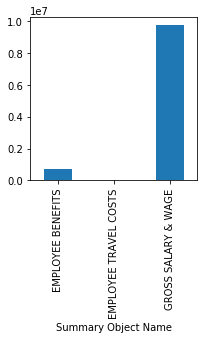

In [999]:
grouped_ISU_PR_REV_25_summary_2018 = fy2018[fy2018['Vendor Name'] == 'ISU PR-REV 25'].groupby('Summary Object Name')
grouped_ISU_PR_REV_25_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_ISU_PR_REV_25_summary_2018['Amount'].agg(np.sum)

Summary Object Name
EMPLOYEE BENEFITS          785494.23
EMPLOYEE TRAVEL COSTS           0.00
GROSS SALARY & WAGE      10328393.19
Name: Amount, dtype: float64

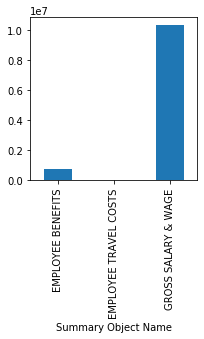

In [1000]:
grouped_ISU_PR_REV_25_summary_2019 = fy2019[fy2019['Vendor Name'] == 'ISU PR-REV 25'].groupby('Summary Object Name')
grouped_ISU_PR_REV_25_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(3,3))
grouped_ISU_PR_REV_25_summary_2019['Amount'].agg(np.sum)

In [1001]:
grouped_ISU_PR_REV_25_summary_sum_2018 = grouped_ISU_PR_REV_25_summary_2018['Amount'].agg(np.sum)
grouped_ISU_PR_REV_25_summary_max_sum_2018 = grouped_ISU_PR_REV_25_summary_sum_2018.max()
grouped_ISU_PR_REV_25_summary_name_sum_2018 = grouped_ISU_PR_REV_25_summary_sum_2018.idxmax()
grouped_ISU_PR_REV_25_summary_name_sum_2018= grouped_ISU_PR_REV_25_summary_name_sum_2018.strip()

grouped_ISU_PR_REV_25_summary_sum_2019 = grouped_ISU_PR_REV_25_summary_2019['Amount'].agg(np.sum)
grouped_ISU_PR_REV_25_summary_max_sum_2019 = grouped_ISU_PR_REV_25_summary_sum_2019.max()
grouped_ISU_PR_REV_25_summary_name_sum_2019 = grouped_ISU_PR_REV_25_summary_sum_2019.idxmax()
grouped_ISU_PR_REV_25_summary_name_sum_2019 = grouped_ISU_PR_REV_25_summary_name_sum_2019.strip()

print("For 2018, " + grouped_ISU_PR_REV_25_summary_name_sum_2018 + " had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students at " + str(grouped_ISU_PR_REV_25_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_ISU_PR_REV_25_summary_name_sum_2019 + " had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students at " + str(grouped_ISU_PR_REV_25_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_ISU_PR_REV_25_summary_max_sum_2019 - grouped_ISU_PR_REV_25_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, GROSS SALARY & WAGE had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students at 9736227.930000002.
For 2019, GROSS SALARY & WAGE had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students at 10328393.190000007.
The average increase/decrease was 592165.2600000054 between 2018 and 2019.


In [1002]:
grouped_ISU_PR_REV_25_summary_mean_2018 = grouped_ISU_PR_REV_25_summary_2018['Amount'].agg(np.mean)
grouped_ISU_PR_REV_25_summary_max_mean_2018 = grouped_ISU_PR_REV_25_summary_mean_2018.max()
grouped_ISU_PR_REV_25_summary_name_mean_2018 = grouped_ISU_PR_REV_25_summary_mean_2018.idxmax()
grouped_ISU_PR_REV_25_summary_name_mean_2018= grouped_ISU_PR_REV_25_summary_name_mean_2018.strip()

grouped_ISU_PR_REV_25_summary_mean_2019 = grouped_ISU_PR_REV_25_summary_2019['Amount'].agg(np.mean)
grouped_ISU_PR_REV_25_summary_max_mean_2019 = grouped_ISU_PR_REV_25_summary_mean_2019.max()
grouped_ISU_PR_REV_25_summary_name_mean_2019 = grouped_ISU_PR_REV_25_summary_mean_2019.idxmax()
grouped_ISU_PR_REV_25_summary_name_mean_2019 = grouped_ISU_PR_REV_25_summary_name_mean_2019.strip()

print("For 2018, " + grouped_ISU_PR_REV_25_summary_name_mean_2018 + " had the most expenditure for the average cost of ISU PR-REV 25 for Employees and Students at " + str(grouped_ISU_PR_REV_25_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_ISU_PR_REV_25_summary_name_mean_2019 + " had the most expenditure for the average cost of ISU PR-REV 25 for Employees and Students at " + str(grouped_ISU_PR_REV_25_summary_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_ISU_PR_REV_25_summary_max_mean_2019 - grouped_ISU_PR_REV_25_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, GROSS SALARY & WAGE had the most expenditure for the average cost of ISU PR-REV 25 for Employees and Students at 49172.86833333334.
For 2019, GROSS SALARY & WAGE had the most expenditure for the average cost of ISU PR-REV 25 for Employees and Students at 44711.65883116886.
The average increase/decrease was -4461.209502164478 between 2018 and 2019.


Agency Name
ADMINISTRATION, DEPARTMENT OF                     178442.33
AGRICULTURE, DEPARTMENT OF                         54825.60
ARTS, IDAHO COMMISSION ON THE                       3605.00
CAREER-TECHNICAL EDUCATION, DIVISION OF           688391.46
COMMERCE, DEPARTMENT OF                           209777.57
EDUCATION, STATE BOARD OF                        1096149.99
EDUCATION, STATE DEPARTMENT OF                   2617824.11
ENVIRONMENTAL QUALITY, DEPARTMENT OF               13092.01
FISH AND GAME, DEPARTMENT OF                      121685.00
HEALTH AND WELFARE, DEPARTMENT OF                6531157.45
HEALTH DISTRICT 1 (PANHANDLE)                        112.75
HEALTH DISTRICT 2 (NORTH CENTRAL)                    520.00
JUDICIAL BRANCH                                   223936.31
JUVENILE CORRECTIONS, DEPARTMENT OF                    0.00
LANDS, DEPARTMENT OF                               71681.85
MILITARY DIVISION                                 249936.53
PUBLIC TELEVISION           

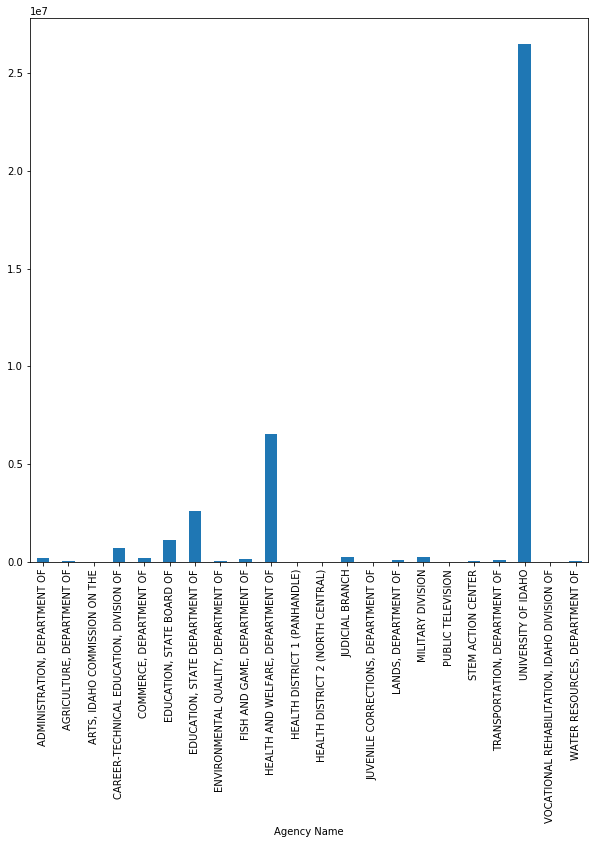

In [1003]:
grouped_uni_idaho_agency_2018 = fy2018[fy2018['Vendor Name'] == 'UNIVERSITY OF IDAHO'].groupby('Agency Name')
grouped_uni_idaho_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_uni_idaho_agency_2018['Amount'].agg(np.sum)

Agency Name
ADMINISTRATION, DEPARTMENT OF                     284949.67
AGRICULTURE, DEPARTMENT OF                        453750.78
CAREER-TECHNICAL EDUCATION, DIVISION OF           407733.51
COMMERCE, DEPARTMENT OF                           197574.20
EDUCATION, STATE BOARD OF                         599957.65
EDUCATION, STATE DEPARTMENT OF                   2110542.71
ENERGY AND MINERAL RESOURCES, OFFICE OF             8410.04
ENVIRONMENTAL QUALITY, DEPARTMENT OF               10241.31
FISH AND GAME, DEPARTMENT OF                      138018.52
GOVERNOR, OFFICE OF THE                             1169.76
HEALTH AND WELFARE, DEPARTMENT OF                7072285.56
HEALTH DISTRICT 1 (PANHANDLE)                        150.00
HEALTH DISTRICT 2 (NORTH CENTRAL)                    360.00
HISPANIC AFFAIRS, IDAHO COMMISSION ON               7046.99
JUDICIAL BRANCH                                   360725.00
JUVENILE CORRECTIONS, DEPARTMENT OF                   75.00
LANDS, DEPARTMENT OF        

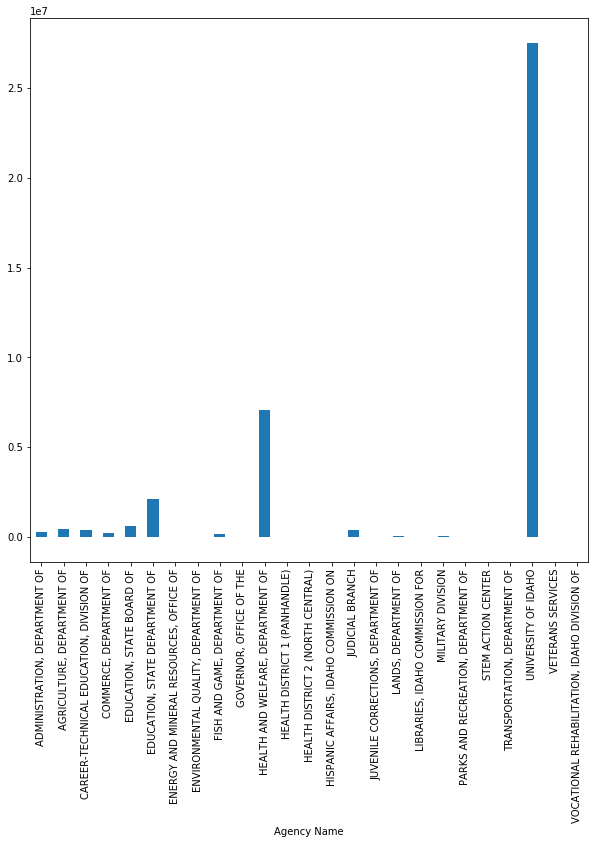

In [1004]:
grouped_uni_idaho_agency_2019 = fy2019[fy2019['Vendor Name'] == 'UNIVERSITY OF IDAHO'].groupby('Agency Name')
grouped_uni_idaho_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_uni_idaho_agency_2019['Amount'].agg(np.sum)

In [1005]:
grouped_uni_idaho_agency_sum_2018 = grouped_uni_idaho_agency_2018['Amount'].agg(np.sum)
grouped_uni_idaho_agency_max_sum_2018 = grouped_uni_idaho_agency_sum_2018.max()
grouped_uni_idaho_agency_name_sum_2018 = grouped_uni_idaho_agency_sum_2018.idxmax()
grouped_uni_idaho_agency_name_sum_2018= grouped_uni_idaho_agency_name_sum_2018.strip()

grouped_uni_idaho_agency_sum_2019 = grouped_uni_idaho_agency_2019['Amount'].agg(np.sum)
grouped_uni_idaho_agency_max_sum_2019 = grouped_uni_idaho_agency_sum_2019.max()
grouped_uni_idaho_agency_name_sum_2019 = grouped_uni_idaho_agency_sum_2019.idxmax()
grouped_uni_idaho_agency_name_sum_2019 = grouped_uni_idaho_agency_name_sum_2019.strip()

print("For 2018, " + grouped_uni_idaho_agency_name_sum_2018 + " had the most expenditure for the total cost of University of Idaho for Employees at " + str(grouped_uni_idaho_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_uni_idaho_agency_name_sum_2019 + " had the most expenditure for the total cost of University of Idaho for Employees at " + str(grouped_uni_idaho_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_uni_idaho_agency_max_sum_2019 - grouped_uni_idaho_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, UNIVERSITY OF IDAHO had the most expenditure for the total cost of University of Idaho for Employees at 26498525.88999991.
For 2019, UNIVERSITY OF IDAHO had the most expenditure for the total cost of University of Idaho for Employees at 27530843.770000007.
The average increase/decrease was 1032317.8800000958 between 2018 and 2019.


Agency Name
ADMINISTRATION, DEPARTMENT OF                     5948.077667
AGRICULTURE, DEPARTMENT OF                       10965.120000
ARTS, IDAHO COMMISSION ON THE                     3605.000000
CAREER-TECHNICAL EDUCATION, DIVISION OF          24585.409286
COMMERCE, DEPARTMENT OF                          14984.112143
EDUCATION, STATE BOARD OF                       182691.665000
EDUCATION, STATE DEPARTMENT OF                   36870.762113
ENVIRONMENTAL QUALITY, DEPARTMENT OF              1454.667778
FISH AND GAME, DEPARTMENT OF                     20280.833333
HEALTH AND WELFARE, DEPARTMENT OF               167465.575641
HEALTH DISTRICT 1 (PANHANDLE)                       37.583333
HEALTH DISTRICT 2 (NORTH CENTRAL)                  173.333333
JUDICIAL BRANCH                                  44787.262000
JUVENILE CORRECTIONS, DEPARTMENT OF                  0.000000
LANDS, DEPARTMENT OF                              7168.185000
MILITARY DIVISION                                83312.176

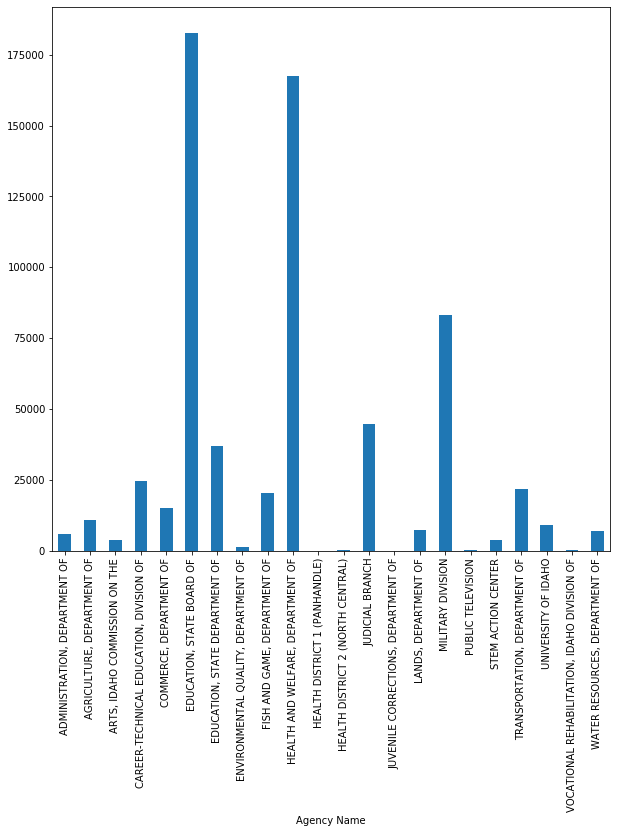

In [1006]:
grouped_uni_idaho_agency_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_uni_idaho_agency_2018['Amount'].agg(np.mean)

Agency Name
ADMINISTRATION, DEPARTMENT OF                     8904.677187
AGRICULTURE, DEPARTMENT OF                       41250.070909
CAREER-TECHNICAL EDUCATION, DIVISION OF          37066.682727
COMMERCE, DEPARTMENT OF                          19757.420000
EDUCATION, STATE BOARD OF                        35291.626471
EDUCATION, STATE DEPARTMENT OF                   44905.164043
ENERGY AND MINERAL RESOURCES, OFFICE OF            646.926154
ENVIRONMENTAL QUALITY, DEPARTMENT OF              1706.885000
FISH AND GAME, DEPARTMENT OF                      8118.736471
GOVERNOR, OFFICE OF THE                            233.952000
HEALTH AND WELFARE, DEPARTMENT OF               164471.757209
HEALTH DISTRICT 1 (PANHANDLE)                      150.000000
HEALTH DISTRICT 2 (NORTH CENTRAL)                  360.000000
HISPANIC AFFAIRS, IDAHO COMMISSION ON             1761.747500
JUDICIAL BRANCH                                  72145.000000
JUVENILE CORRECTIONS, DEPARTMENT OF                 18.750

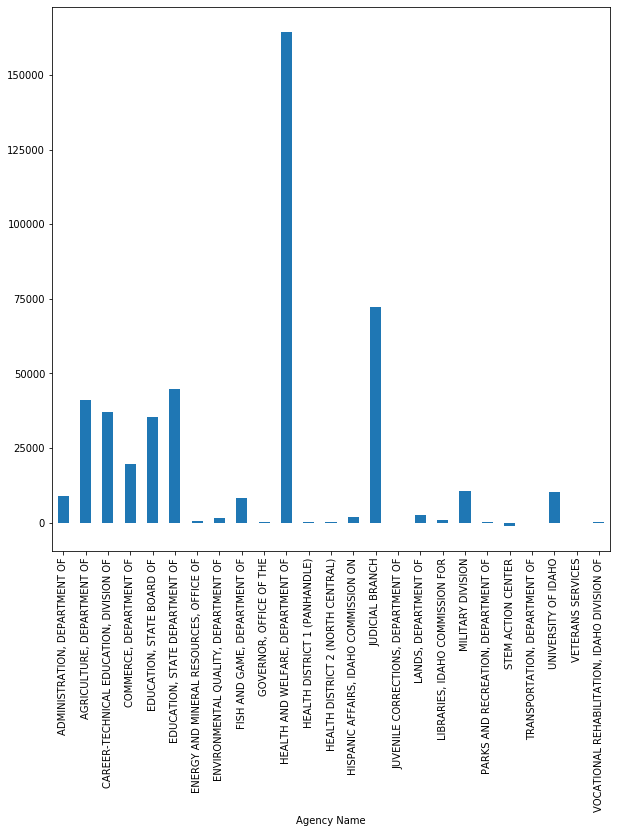

In [1007]:
grouped_uni_idaho_agency_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_uni_idaho_agency_2019['Amount'].agg(np.mean)

In [1008]:
grouped_uni_idaho_agency_mean_2018 = grouped_uni_idaho_agency_2018['Amount'].agg(np.mean)
grouped_uni_idaho_agency_max_mean_2018 = grouped_uni_idaho_agency_mean_2018.max()
grouped_uni_idaho_agency_name_mean_2018 = grouped_uni_idaho_agency_mean_2018.idxmax()
grouped_uni_idaho_agency_name_mean_2018= grouped_uni_idaho_agency_name_mean_2018.strip()

grouped_uni_idaho_agency_mean_2019 = grouped_uni_idaho_agency_2019['Amount'].agg(np.mean)
grouped_uni_idaho_agency_max_mean_2019 = grouped_uni_idaho_agency_mean_2019.max()
grouped_uni_idaho_agency_name_mean_2019 = grouped_uni_idaho_agency_mean_2019.idxmax()
grouped_uni_idaho_agency_name_mean_2019 = grouped_uni_idaho_agency_name_mean_2019.strip()

print("For 2018, " + grouped_uni_idaho_agency_name_mean_2018 + " had the most expenditure for the average cost of University of Idaho for Employees at " + str(grouped_uni_idaho_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_uni_idaho_agency_name_mean_2019 + " had the most expenditure for the average cost of University of Idaho for Employees at " + str(grouped_uni_idaho_agency_max_mean_2019) + ".")
#print("The average increase/decrease was " + str(grouped_uni_idaho_agency_max_mean_2019 - grouped_uni_idaho_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, EDUCATION, STATE BOARD OF had the most expenditure for the average cost of University of Idaho for Employees at 182691.665.
For 2019, HEALTH AND WELFARE, DEPARTMENT OF had the most expenditure for the average cost of University of Idaho for Employees at 164471.75720930228.


Summary Object Name
ADMINISTRATIVE SERVICES           260233.95
ADMINISTRATIVE SUPPLIES           162411.66
AWARDS CONTR & CLAIMS             180106.36
BLDG & IMPROVEMENTS              1228501.04
COMMUNICATION COSTS               232255.39
COMPUTER EQUIPMENT                530778.31
COMPUTER SERVICES                 350946.56
COMPUTER SUPPLIES                  52604.57
EDUC & TRAIN ASSISTANCE              817.96
EDUC MATERIAL & EQUIP            3011093.28
EMPLOYEE BENEFITS                 316553.11
EMPLOYEE DEVELOPMENT COSTS        380861.40
EMPLOYEE TRAVEL COSTS             900828.88
FED PMTS TO SUBGRANTEES          8768593.14
FUEL & LUBRICANTS COSTS            74135.86
GENERAL SERVICES                  475121.81
GROSS SALARY & WAGE              4456321.15
INST & RESIDENT SUPPLIES          133660.66
INSURANCE                        1732534.70
MFG & MERCH COSTS                   5350.03
MISC EXPENDITURES                1545530.00
MOTORIZED/NON-MOTORIZED EQUIP     698941.38
NATURAL RESO

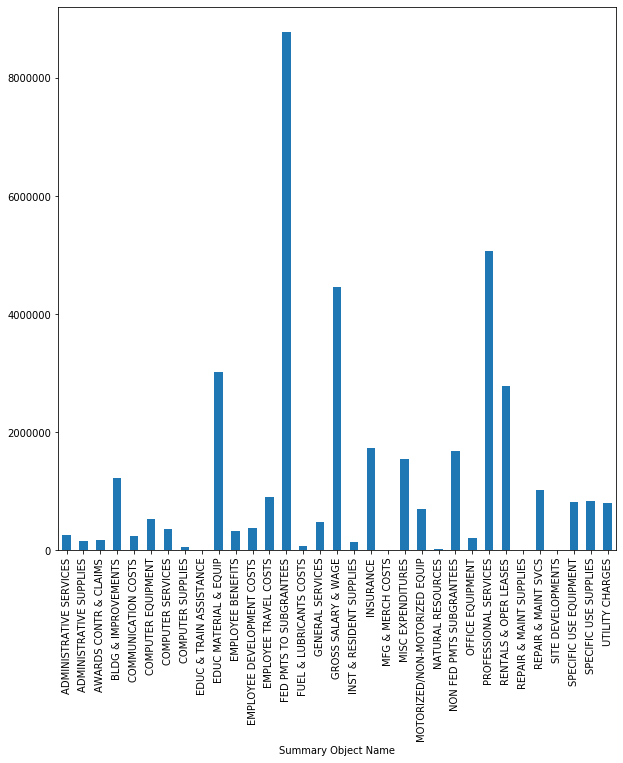

In [1009]:
grouped_uni_idaho_summary_2018 = fy2018[fy2018['Vendor Name'] == 'UNIVERSITY OF IDAHO'].groupby('Summary Object Name')
grouped_uni_idaho_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_uni_idaho_summary_2018['Amount'].agg(np.sum)

Summary Object Name
ADMINISTRATIVE SERVICES           454867.31
ADMINISTRATIVE SUPPLIES           215360.84
AWARDS CONTR & CLAIMS             286579.17
BLDG & IMPROVEMENTS              1101728.81
COMMUNICATION COSTS               501184.13
COMPUTER EQUIPMENT                377438.13
COMPUTER SERVICES                 617114.05
COMPUTER SUPPLIES                  30620.72
EDUC & TRAIN ASSISTANCE             2015.00
EDUC MATERIAL & EQUIP            3148114.45
EMPLOYEE BENEFITS                 401493.79
EMPLOYEE DEVELOPMENT COSTS        847901.17
EMPLOYEE TRAVEL COSTS            1048087.27
FED PMTS TO SUBGRANTEES          9323135.99
FUEL & LUBRICANTS COSTS            98007.51
GENERAL SERVICES                  476944.06
GROSS SALARY & WAGE              5063831.41
INST & RESIDENT SUPPLIES          156789.21
INSURANCE                        1535211.03
MFG & MERCH COSTS                   5105.05
MISC EXPENDITURES                1982839.47
MOTORIZED/NON-MOTORIZED EQUIP     238388.82
NATURAL RESO

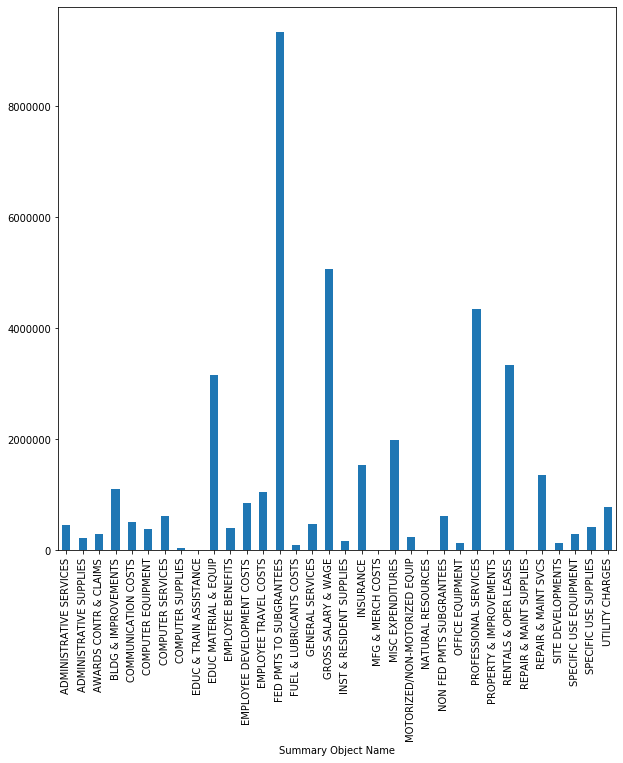

In [1010]:
grouped_uni_idaho_summary_2019 = fy2019[fy2019['Vendor Name'] == 'UNIVERSITY OF IDAHO'].groupby('Summary Object Name')
grouped_uni_idaho_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_uni_idaho_summary_2019['Amount'].agg(np.sum)

In [1011]:
grouped_uni_idaho_summary_sum_2018 = grouped_uni_idaho_summary_2018['Amount'].agg(np.sum)
grouped_uni_idaho_summary_max_sum_2018 = grouped_uni_idaho_summary_sum_2018.max()
grouped_uni_idaho_summary_name_sum_2018 = grouped_uni_idaho_summary_sum_2018.idxmax()
grouped_uni_idaho_summary_name_sum_2018= grouped_uni_idaho_summary_name_sum_2018.strip()

grouped_uni_idaho_summary_sum_2019 = grouped_uni_idaho_summary_2019['Amount'].agg(np.sum)
grouped_uni_idaho_summary_max_sum_2019 = grouped_uni_idaho_summary_sum_2019.max()
grouped_uni_idaho_summary_name_sum_2019 = grouped_uni_idaho_summary_sum_2019.idxmax()
grouped_uni_idaho_summary_name_sum_2019 = grouped_uni_idaho_summary_name_sum_2019.strip()

print("For 2018, " + grouped_uni_idaho_summary_name_sum_2018 + " had the most expenditure for the total cost of University of Idaho for Employees at " + str(grouped_uni_idaho_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_uni_idaho_summary_name_sum_2019 + " had the most expenditure for the total cost of University of Idaho for Employees at " + str(grouped_uni_idaho_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_uni_idaho_summary_max_sum_2019 - grouped_uni_idaho_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, FED PMTS TO SUBGRANTEES had the most expenditure for the total cost of University of Idaho for Employees at 8768593.140000002.
For 2019, FED PMTS TO SUBGRANTEES had the most expenditure for the total cost of University of Idaho for Employees at 9323135.99.
The average increase/decrease was 554542.8499999978 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES            2262.903913
ADMINISTRATIVE SUPPLIES            2082.200769
AWARDS CONTR & CLAIMS              5297.245882
BLDG & IMPROVEMENTS               68250.057778
COMMUNICATION COSTS                1416.191402
COMPUTER EQUIPMENT                13269.457750
COMPUTER SERVICES                  5483.540000
COMPUTER SUPPLIES                  1052.091400
EDUC & TRAIN ASSISTANCE             408.980000
EDUC MATERIAL & EQUIP            215078.091429
EMPLOYEE BENEFITS                   523.228281
EMPLOYEE DEVELOPMENT COSTS         4279.341573
EMPLOYEE TRAVEL COSTS              2246.456060
FED PMTS TO SUBGRANTEES           90397.867423
FUEL & LUBRICANTS COSTS            1015.559726
GENERAL SERVICES                   4949.185521
GROSS SALARY & WAGE               19983.502915
INST & RESIDENT SUPPLIES           2620.797255
INSURANCE                        108283.418750
MFG & MERCH COSTS                   535.003000
MISC EXPENDITURES                 14580.

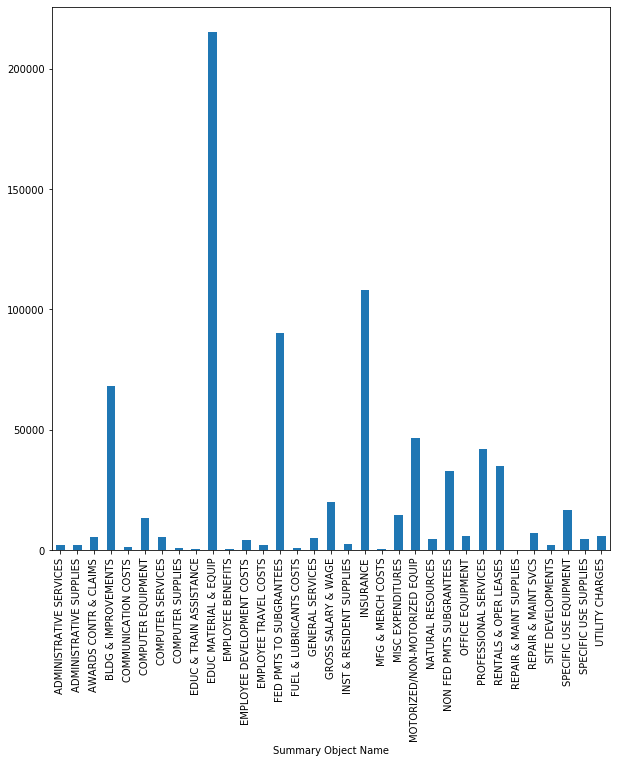

In [1012]:
grouped_uni_idaho_summary_2018['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_uni_idaho_summary_2018['Amount'].agg(np.mean)

Summary Object Name
ADMINISTRATIVE SERVICES            4641.503163
ADMINISTRATIVE SUPPLIES            2692.010500
AWARDS CONTR & CLAIMS              7745.382973
BLDG & IMPROVEMENTS               91810.734167
COMMUNICATION COSTS                4108.066639
COMPUTER EQUIPMENT                15097.525200
COMPUTER SERVICES                 10459.560169
COMPUTER SUPPLIES                  1458.129524
EDUC & TRAIN ASSISTANCE             503.750000
EDUC MATERIAL & EQUIP            224865.317857
EMPLOYEE BENEFITS                   709.352986
EMPLOYEE DEVELOPMENT COSTS         7309.492845
EMPLOYEE TRAVEL COSTS              2680.530102
FED PMTS TO SUBGRANTEES          100248.774086
FUEL & LUBRICANTS COSTS            1633.458500
GENERAL SERVICES                   3974.533833
GROSS SALARY & WAGE               35411.408462
INST & RESIDENT SUPPLIES           2703.262241
INSURANCE                        102347.402000
MFG & MERCH COSTS                   638.131250
MISC EXPENDITURES                 19828.

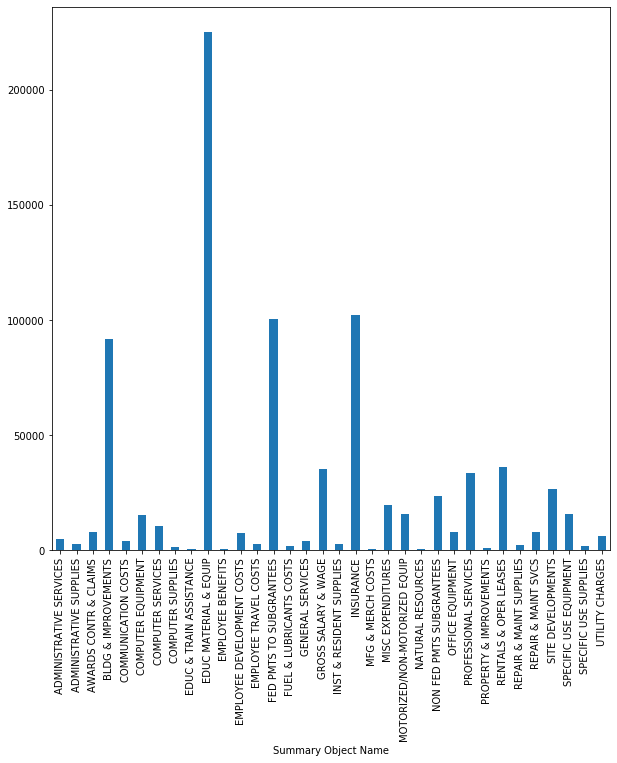

In [1013]:
grouped_uni_idaho_summary_2019['Amount'].agg(np.mean).plot.bar(figsize=(10,10))
grouped_uni_idaho_summary_2019['Amount'].agg(np.mean)

In [1014]:
grouped_uni_idaho_summary_mean_2018 = grouped_uni_idaho_summary_2018['Amount'].agg(np.mean)
grouped_uni_idaho_summary_max_mean_2018 = grouped_uni_idaho_summary_mean_2018.max()
grouped_uni_idaho_summary_name_mean_2018 = grouped_uni_idaho_summary_mean_2018.idxmax()
grouped_uni_idaho_summary_name_mean_2018= grouped_uni_idaho_summary_name_mean_2018.strip()

grouped_uni_idaho_summary_mean_2019 = grouped_uni_idaho_summary_2019['Amount'].agg(np.mean)
grouped_uni_idaho_summary_max_mean_2019 = grouped_uni_idaho_summary_mean_2019.max()
grouped_uni_idaho_summary_name_mean_2019 = grouped_uni_idaho_summary_mean_2019.idxmax()
grouped_uni_idaho_summary_name_mean_2019 = grouped_uni_idaho_summary_name_mean_2019.strip()

print("For 2018, " + grouped_uni_idaho_summary_name_mean_2018 + " had the most expenditure for the average cost of University of Idaho for Employees at " + str(grouped_uni_idaho_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_uni_idaho_summary_name_mean_2019 + " had the most expenditure for the average cost of University of Idaho for Employees at " + str(grouped_uni_idaho_summary_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_uni_idaho_summary_max_mean_2019 - grouped_uni_idaho_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, EDUC MATERIAL & EQUIP had the most expenditure for the average cost of University of Idaho for Employees at 215078.0914285714.
For 2019, EDUC MATERIAL & EQUIP had the most expenditure for the average cost of University of Idaho for Employees at 224865.3178571428.
The average increase/decrease was 9787.22642857139 between 2018 and 2019.


In [1015]:
grouped_employees_temp_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'EMPLOYEES - TEMPORARY'].groupby('Vendor Name')

In [1016]:
grouped_employees_temp_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'EMPLOYEES - TEMPORARY'].groupby('Vendor Name')

In [1017]:
grouped_employees_temp_vendor_sum_2018 = grouped_employees_temp_vendor_2018['Amount'].agg(np.sum)
grouped_employees_temp_vendor_max_sum_2018 = grouped_employees_temp_vendor_sum_2018.max()
grouped_employees_temp_vendor_name_sum_2018 = grouped_employees_temp_vendor_sum_2018.idxmax()
grouped_employees_temp_vendor_name_sum_2018= grouped_employees_temp_vendor_name_sum_2018.strip()

grouped_employees_temp_vendor_sum_2019 = grouped_employees_temp_vendor_2019['Amount'].agg(np.sum)
grouped_employees_temp_vendor_max_sum_2019 = grouped_employees_temp_vendor_sum_2019.max()
grouped_employees_temp_vendor_name_sum_2019 = grouped_employees_temp_vendor_sum_2019.idxmax()
grouped_employees_temp_vendor_name_sum_2019 = grouped_employees_temp_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_employees_temp_vendor_name_sum_2018 + " had the most expenditure for the total cost of Employees - Temporary at " + str(grouped_employees_temp_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_employees_temp_vendor_name_sum_2019 + " had the most expenditure for the total cost of Employees - Temporary " + str(grouped_employees_temp_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_employees_temp_vendor_max_sum_2019 - grouped_employees_temp_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, BOISE STATE UNIVERSITY had the most expenditure for the total cost of Employees - Temporary at 10582763.840000002.
For 2019, BOISE STATE UNIVERSITY had the most expenditure for the total cost of Employees - Temporary 11685595.26.
The average increase/decrease was 1102831.419999998 between 2018 and 2019.


Agency Name
ADMINISTRATION, DEPARTMENT OF                           900865.95
AGING, COMMISSION ON                                     21302.08
AGRICULTURE, DEPARTMENT OF                              136520.67
ARTS, IDAHO COMMISSION ON THE                              622.74
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE          23294.00
BOISE STATE UNIVERSITY                                49359357.50
CAREER-TECHNICAL EDUCATION, DIVISION OF                   1683.01
COMMERCE, DEPARTMENT OF                                 695723.11
CONTROLLER, OFFICE OF THE STATE                            110.00
CORRECTION, DEPARTMENT OF                                49793.67
DRUG POLICY, OFFICE OF                                  293673.86
EDUCATION, STATE BOARD OF                               471732.85
EDUCATION, STATE DEPARTMENT OF                         4964649.25
ENVIRONMENTAL QUALITY, DEPARTMENT OF                    109122.13
FISH AND GAME, DEPARTMENT OF                             68396.3

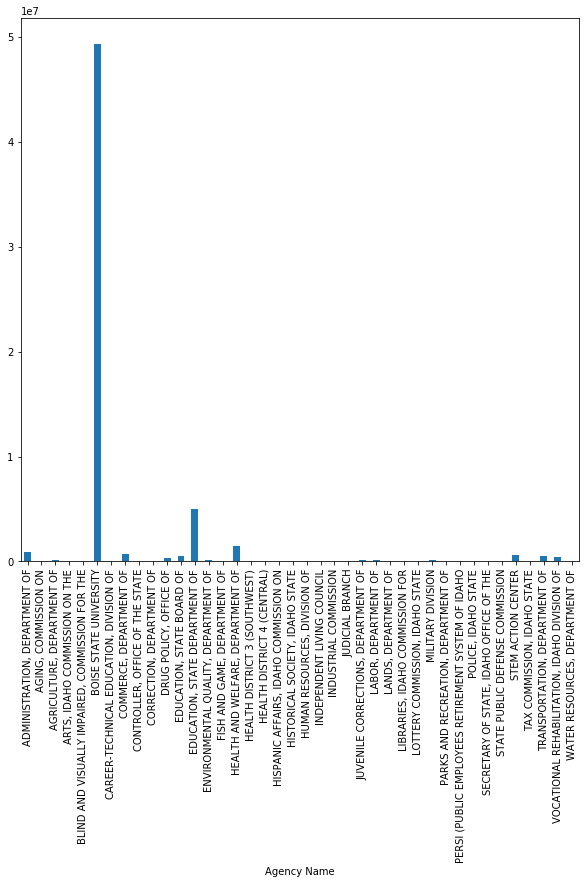

In [1018]:
grouped_boise_st_agency_2018 = fy2018[fy2018['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Agency Name')
grouped_boise_st_agency_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_boise_st_agency_2018['Amount'].agg(np.sum)

Agency Name
ADMINISTRATION, DEPARTMENT OF                        414842.40
AGING, COMMISSION ON                                  88114.36
AGRICULTURE, DEPARTMENT OF                            67806.53
ARTS, IDAHO COMMISSION ON THE                          5047.48
ATTORNEY GENERAL, OFFICE OF THE                         100.00
BLIND AND VISUALLY IMPAIRED, COMMISSION FOR THE       25872.50
BOISE STATE UNIVERSITY                             54471852.35
CAREER-TECHNICAL EDUCATION, DIVISION OF                 556.17
COMMERCE, DEPARTMENT OF                              553115.29
CONTROLLER, OFFICE OF THE STATE                         140.00
CORRECTION, DEPARTMENT OF                             36375.00
DRUG POLICY, OFFICE OF                               150543.38
EDUCATION, STATE BOARD OF                            577040.65
EDUCATION, STATE DEPARTMENT OF                      4964753.57
ENVIRONMENTAL QUALITY, DEPARTMENT OF                 103373.72
FISH AND GAME, DEPARTMENT OF               

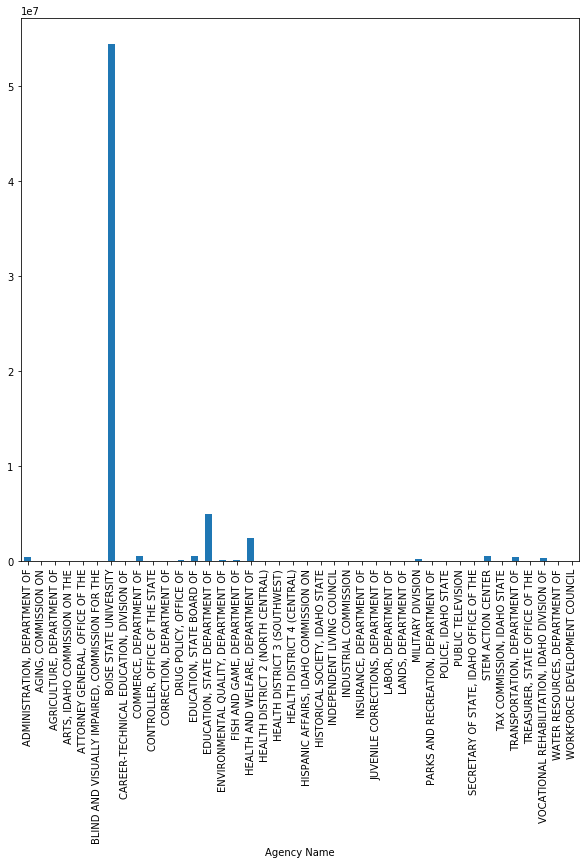

In [1019]:
grouped_boise_st_agency_2019 = fy2019[fy2019['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Agency Name')
grouped_boise_st_agency_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_boise_st_agency_2019['Amount'].agg(np.sum)

In [1020]:
grouped_boise_st_agency_sum_2018 = grouped_boise_st_agency_2018['Amount'].agg(np.sum)
grouped_boise_st_agency_max_sum_2018 = grouped_boise_st_agency_sum_2018.max()
grouped_boise_st_agency_name_sum_2018 = grouped_boise_st_agency_sum_2018.idxmax()
grouped_boise_st_agency_name_sum_2018= grouped_boise_st_agency_name_sum_2018.strip()

grouped_boise_st_agency_sum_2019 = grouped_boise_st_agency_2019['Amount'].agg(np.sum)
grouped_boise_st_agency_max_sum_2019 = grouped_boise_st_agency_sum_2019.max()
grouped_boise_st_agency_name_sum_2019 = grouped_boise_st_agency_sum_2019.idxmax()
grouped_boise_st_agency_name_sum_2019 = grouped_boise_st_agency_name_sum_2019.strip()

print("For 2018, " + grouped_boise_st_agency_name_sum_2018 + " had the most expenditure for the total cost of Boise State University for Employees - Temporary at " + str(grouped_boise_st_agency_max_sum_2018) + ".")
print("For 2019, " + grouped_boise_st_agency_name_sum_2019 + " had the most expenditure for the total cost of Boise State University for Employees - Temporary at " + str(grouped_boise_st_agency_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_st_agency_max_sum_2019 - grouped_boise_st_agency_max_sum_2018) + " between 2018 and 2019.")

For 2018, BOISE STATE UNIVERSITY had the most expenditure for the total cost of Boise State University for Employees - Temporary at 49359357.50000012.
For 2019, BOISE STATE UNIVERSITY had the most expenditure for the total cost of Boise State University for Employees - Temporary at 54471852.35000007.
The average increase/decrease was 5112494.849999949 between 2018 and 2019.


In [1021]:
grouped_boise_st_agency_mean_2018 = grouped_boise_st_agency_2018['Amount'].agg(np.mean)
grouped_boise_st_agency_max_mean_2018 = grouped_boise_st_agency_mean_2018.max()
grouped_boise_st_agency_name_mean_2018 = grouped_boise_st_agency_mean_2018.idxmax()
grouped_boise_st_agency_name_mean_2018= grouped_boise_st_agency_name_mean_2018.strip()

grouped_boise_st_agency_mean_2019 = grouped_boise_st_agency_2019['Amount'].agg(np.mean)
grouped_boise_st_agency_max_mean_2019 = grouped_boise_st_agency_mean_2019.max()
grouped_boise_st_agency_name_mean_2019 = grouped_boise_st_agency_mean_2019.idxmax()
grouped_boise_st_agency_name_mean_2019 = grouped_boise_st_agency_name_mean_2019.strip()

print("For 2018, " + grouped_boise_st_agency_name_mean_2018 + " had the most expenditure for the average cost of Boise State University for Employees - Temporary at " + str(grouped_boise_st_agency_max_mean_2018) + ".")
print("For 2019, " + grouped_boise_st_agency_name_mean_2019 + " had the most expenditure for the average cost of Boise State University for Employees - Temporary at " + str(grouped_boise_st_agency_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_st_agency_max_mean_2019 - grouped_boise_st_agency_max_mean_2018) + " between 2018 and 2019.")

For 2018, EDUCATION, STATE DEPARTMENT OF had the most expenditure for the average cost of Boise State University for Employees - Temporary at 39717.193999999996.
For 2019, EDUCATION, STATE DEPARTMENT OF had the most expenditure for the average cost of Boise State University for Employees - Temporary at 42799.599741379316.
The average increase/decrease was 3082.40574137932 between 2018 and 2019.


Summary Object Name
ADMINISTRATIVE SERVICES            638037.40
ADMINISTRATIVE SUPPLIES            652033.58
AWARDS CONTR & CLAIMS              627844.79
BLDG & IMPROVEMENTS                466354.60
COMMUNICATION COSTS               1296481.59
COMPUTER EQUIPMENT                 407027.15
COMPUTER SERVICES                  543936.37
COMPUTER SUPPLIES                 2401735.14
EDUC & TRAIN ASSISTANCE            459049.93
EDUC MATERIAL & EQUIP             3688757.08
EMPLOYEE BENEFITS                 1495706.46
EMPLOYEE DEVELOPMENT COSTS         901532.28
EMPLOYEE TRAVEL COSTS             1608811.46
FED PMTS TO SUBGRANTEES           4041090.75
FUEL & LUBRICANTS COSTS             52479.37
GENERAL SERVICES                  1554239.97
GROSS SALARY & WAGE              12442150.17
INST & RESIDENT SUPPLIES           381988.93
INSURANCE                         1500410.10
MFG & MERCH COSTS                     110.37
MISC EXPENDITURES                 3807344.85
MISC PMTS AS AGENT                1

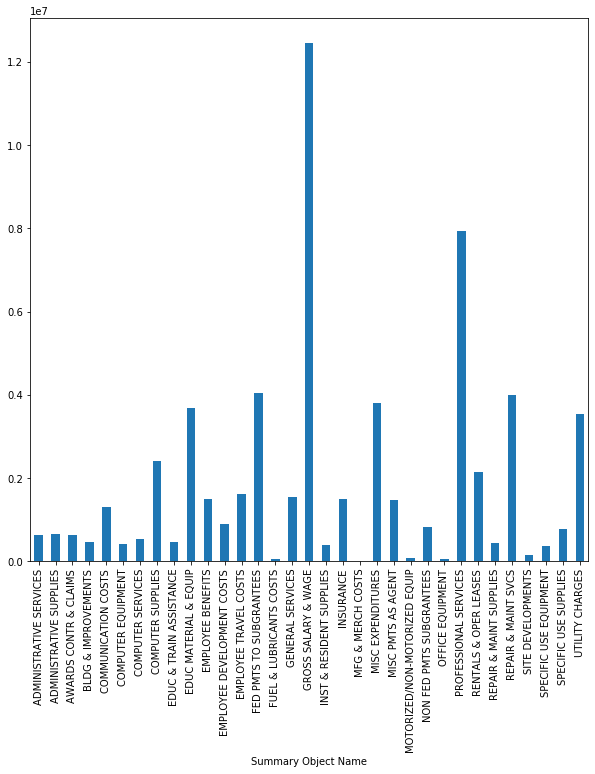

In [1022]:
grouped_boise_st_summary_2018 = fy2018[fy2018['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Summary Object Name')
grouped_boise_st_summary_2018['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_boise_st_summary_2018['Amount'].agg(np.sum)

Summary Object Name
ADMINISTRATIVE SERVICES            690844.37
ADMINISTRATIVE SUPPLIES            656791.81
AWARDS CONTR & CLAIMS              190503.80
BLDG & IMPROVEMENTS                401683.06
COMMUNICATION COSTS               1175469.28
COMPUTER EQUIPMENT                 291435.73
COMPUTER SERVICES                 1097248.66
COMPUTER SUPPLIES                 5211084.91
EDUC & TRAIN ASSISTANCE            341595.86
EDUC MATERIAL & EQUIP             3484319.90
EMPLOYEE BENEFITS                 1725674.11
EMPLOYEE DEVELOPMENT COSTS         982102.60
EMPLOYEE TRAVEL COSTS             1529844.10
FED PMTS TO SUBGRANTEES           3828311.25
FUEL & LUBRICANTS COSTS             55161.95
GENERAL SERVICES                  1665586.90
GROSS SALARY & WAGE              13698103.96
INST & RESIDENT SUPPLIES           461966.84
INSURANCE                         1506015.06
MFG & MERCH COSTS                     867.07
MISC EXPENDITURES                 5848192.01
MISC PMTS AS AGENT                1

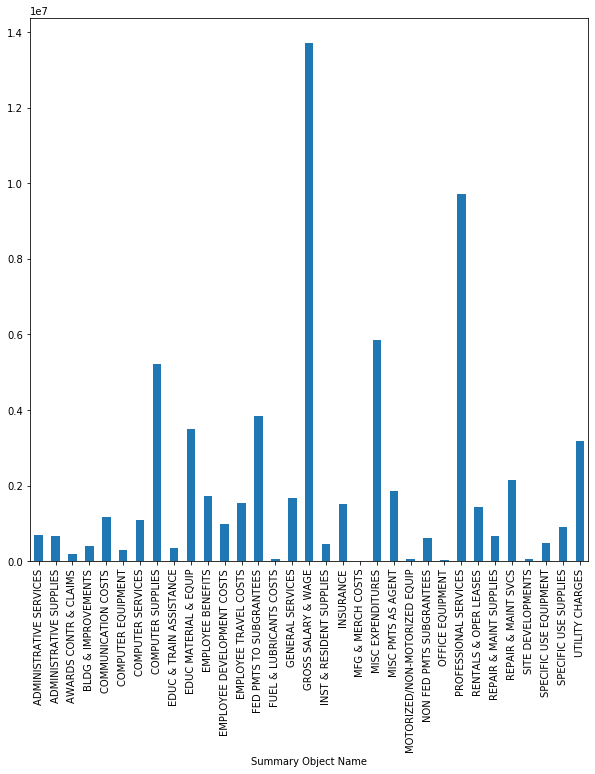

In [1023]:
grouped_boise_st_summary_2019 = fy2019[fy2019['Vendor Name'] == 'BOISE STATE UNIVERSITY'].groupby('Summary Object Name')
grouped_boise_st_summary_2019['Amount'].agg(np.sum).plot.bar(figsize=(10,10))
grouped_boise_st_summary_2019['Amount'].agg(np.sum)

In [1024]:
grouped_boise_st_summary_sum_2018 = grouped_boise_st_summary_2018['Amount'].agg(np.sum)
grouped_boise_st_summary_max_sum_2018 = grouped_boise_st_summary_sum_2018.max()
grouped_boise_st_summary_name_sum_2018 = grouped_boise_st_summary_sum_2018.idxmax()
grouped_boise_st_summary_name_sum_2018= grouped_boise_st_summary_name_sum_2018.strip()

grouped_boise_st_summary_sum_2019 = grouped_boise_st_summary_2019['Amount'].agg(np.sum)
grouped_boise_st_summary_max_sum_2019 = grouped_boise_st_summary_sum_2019.max()
grouped_boise_st_summary_name_sum_2019 = grouped_boise_st_summary_sum_2019.idxmax()
grouped_boise_st_summary_name_sum_2019 = grouped_boise_st_summary_name_sum_2019.strip()

print("For 2018, " + grouped_boise_st_summary_name_sum_2018 + " had the most expenditure for the total cost of Boise State University for Employees - Temporary at " + str(grouped_boise_st_summary_max_sum_2018) + ".")
print("For 2019, " + grouped_boise_st_summary_name_sum_2019 + " had the most expenditure for the total cost of Boise State University for Employees - Temporary at " + str(grouped_boise_st_summary_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_st_summary_max_sum_2019 - grouped_boise_st_summary_max_sum_2018) + " between 2018 and 2019.")

For 2018, GROSS SALARY & WAGE had the most expenditure for the total cost of Boise State University for Employees - Temporary at 12442150.169999998.
For 2019, GROSS SALARY & WAGE had the most expenditure for the total cost of Boise State University for Employees - Temporary at 13698103.960000003.
The average increase/decrease was 1255953.7900000047 between 2018 and 2019.


In [1025]:
grouped_boise_st_summary_mean_2018 = grouped_boise_st_summary_2018['Amount'].agg(np.mean)
grouped_boise_st_summary_max_mean_2018 = grouped_boise_st_summary_mean_2018.max()
grouped_boise_st_summary_name_mean_2018 = grouped_boise_st_summary_mean_2018.idxmax()
grouped_boise_st_summary_name_mean_2018= grouped_boise_st_summary_name_mean_2018.strip()

grouped_boise_st_summary_mean_2019 = grouped_boise_st_summary_2019['Amount'].agg(np.mean)
grouped_boise_st_summary_max_mean_2019 = grouped_boise_st_summary_mean_2019.max()
grouped_boise_st_summary_name_mean_2019 = grouped_boise_st_summary_mean_2019.idxmax()
grouped_boise_st_summary_name_mean_2019 = grouped_boise_st_summary_name_mean_2019.strip()

print("For 2018, " + grouped_boise_st_summary_name_mean_2018 + " had the most expenditure for the average cost of Boise State University for Employees - Temporary at " + str(grouped_boise_st_summary_max_mean_2018) + ".")
print("For 2019, " + grouped_boise_st_summary_name_mean_2019 + " had the most expenditure for the average cost of Boise State University for Employees - Temporary at " + str(grouped_boise_st_summary_max_mean_2019) + ".")
print("The average increase/decrease was " + str(grouped_boise_st_summary_max_mean_2019 - grouped_boise_st_summary_max_mean_2018) + " between 2018 and 2019.")

For 2018, MISC PMTS AS AGENT had the most expenditure for the average cost of Boise State University for Employees - Temporary at 184942.0.
For 2019, MISC PMTS AS AGENT had the most expenditure for the average cost of Boise State University for Employees - Temporary at 308310.0.
The average increase/decrease was 123368.0 between 2018 and 2019.


In [1026]:
grouped_shift_diff_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'SHIFT DIFFERENTIAL'].groupby('Vendor Name')

In [1027]:
grouped_shift_diff_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'SHIFT DIFFERENTIAL'].groupby('Vendor Name')

In [1028]:
grouped_shift_diff_vendor_sum_2018 = grouped_shift_diff_vendor_2018['Amount'].agg(np.sum)
grouped_shift_diff_vendor_max_sum_2018 = grouped_shift_diff_vendor_sum_2018.max()
grouped_shift_diff_vendor_name_sum_2018 = grouped_shift_diff_vendor_sum_2018.idxmax()
grouped_shift_diff_vendor_name_sum_2018= grouped_shift_diff_vendor_name_sum_2018.strip()

grouped_shift_diff_vendor_sum_2019 = grouped_shift_diff_vendor_2019['Amount'].agg(np.sum)
grouped_shift_diff_vendor_max_sum_2019 = grouped_shift_diff_vendor_sum_2019.max()
grouped_shift_diff_vendor_name_sum_2019 = grouped_shift_diff_vendor_sum_2019.idxmax()
grouped_shift_diff_vendor_name_sum_2019 = grouped_shift_diff_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_shift_diff_vendor_name_sum_2018 + " had the most expenditure for the total cost of Shift Differential at " + str(grouped_shift_diff_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_shift_diff_vendor_name_sum_2019 + " had the most expenditure for the total cost of Shift Differential at " + str(grouped_shift_diff_vendor_max_sum_2019) + ".")
#print("The average increase/decrease was " + str(grouped_shift_diff_vendor_max_sum_2019 - grouped_shift_diff_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, JOLENE D REED had the most expenditure for the total cost of Shift Differential at 5909.96.
For 2019, GARY L CUNNINGHAM had the most expenditure for the total cost of Shift Differential at 5573.77.


In [1029]:
grouped_overtime_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'OVERTIME COVERED BY FLSA'].groupby('Vendor Name')

In [1030]:
grouped_overtime_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'OVERTIME COVERED BY FLSA'].groupby('Vendor Name')

In [1031]:
grouped_overtime_vendor_sum_2018 = grouped_overtime_vendor_2018['Amount'].agg(np.sum)
grouped_overtime_vendor_max_sum_2018 = grouped_overtime_vendor_sum_2018.max()
grouped_overtime_vendor_name_sum_2018 = grouped_overtime_vendor_sum_2018.idxmax()
grouped_overtime_vendor_name_sum_2018= grouped_overtime_vendor_name_sum_2018.strip()

grouped_overtime_vendor_sum_2019 = grouped_overtime_vendor_2019['Amount'].agg(np.sum)
grouped_overtime_vendor_max_sum_2019 = grouped_overtime_vendor_sum_2019.max()
grouped_overtime_vendor_name_sum_2019 = grouped_overtime_vendor_sum_2019.idxmax()
grouped_overtime_vendor_name_sum_2019 = grouped_overtime_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_overtime_vendor_name_sum_2018 + " had the most expenditure for the total cost of Overtime Covered by FLSA at " + str(grouped_overtime_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_overtime_vendor_name_sum_2019 + " had the most expenditure for the total cost of Overtime Covered by FLSA at " + str(grouped_overtime_vendor_max_sum_2019) + ".")
#print("The average increase/decrease was " + str(grouped_overtime_vendor_max_sum_2019 - grouped_overtime_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, GERALD E HACKWORTH had the most expenditure for the total cost of Overtime Covered by FLSA at 36807.84.
For 2019, GARY L CUNNINGHAM had the most expenditure for the total cost of Overtime Covered by FLSA at 38615.28999999999.


In [1032]:
grouped_student_vendor_2018 = fy2018[fy2018['Sub Object Name'] == 'STUDENT'].groupby('Vendor Name')

In [1033]:
grouped_student_vendor_2019 = fy2019[fy2019['Sub Object Name'] == 'STUDENT'].groupby('Vendor Name')

In [1034]:
grouped_student_vendor_sum_2018 = grouped_student_vendor_2018['Amount'].agg(np.sum)
grouped_student_vendor_max_sum_2018 = grouped_student_vendor_sum_2018.max()
grouped_student_vendor_name_sum_2018 = grouped_student_vendor_sum_2018.idxmax()
grouped_student_vendor_name_sum_2018= grouped_student_vendor_name_sum_2018.strip()

grouped_student_vendor_sum_2019 = grouped_student_vendor_2019['Amount'].agg(np.sum)
grouped_student_vendor_max_sum_2019 = grouped_student_vendor_sum_2019.max()
grouped_student_vendor_name_sum_2019 = grouped_student_vendor_sum_2019.idxmax()
grouped_student_vendor_name_sum_2019 = grouped_student_vendor_name_sum_2019.strip()

print("For 2018, " + grouped_student_vendor_name_sum_2018 + " had the most expenditure for the total cost of Student at " + str(grouped_student_vendor_max_sum_2018) + ".")
print("For 2019, " + grouped_student_vendor_name_sum_2019 + " had the most expenditure for the total cost of Student at " + str(grouped_student_vendor_max_sum_2019) + ".")
print("The average increase/decrease was " + str(grouped_student_vendor_max_sum_2019 - grouped_student_vendor_max_sum_2018) + " between 2018 and 2019.")

For 2018, ISU PR-REV 25 had the most expenditure for the total cost of Student at 3440727.13.
For 2019, ISU PR-REV 25 had the most expenditure for the total cost of Student at 3572134.8700000006.
The average increase/decrease was 131407.7400000007 between 2018 and 2019.


In [1035]:
print("See Employees for further analysis of ISU PR-REV 25.")

See Employees for further analysis of ISU PR-REV 25.


In [1036]:
print("Listed below are areas of potential cost savings for Gross Salary & Wage Costs.")

print("\r\n" + grouped_ISU_PR_REV_25_agency_name_sum_2018 + " had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students with an average increase of " + str(grouped_ISU_PR_REV_25_agency_max_sum_2019 - grouped_ISU_PR_REV_25_agency_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_ISU_PR_REV_25_summary_name_sum_2018 + " had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students with an average increase of " + str(grouped_ISU_PR_REV_25_summary_max_sum_2019 - grouped_ISU_PR_REV_25_summary_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_uni_idaho_summary_name_sum_2018 + " had the most expenditure for the total cost of University of Idaho for Employees with an average increase of " + str(grouped_uni_idaho_summary_max_sum_2019 - grouped_uni_idaho_summary_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_uni_idaho_summary_name_mean_2018 + " had the most expenditure for the average cost of University of Idaho for Employees with an average increase of " + str(grouped_uni_idaho_summary_max_mean_2019 - grouped_uni_idaho_summary_max_mean_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_employees_temp_vendor_name_sum_2018 + " had the most expenditure for the total cost of Employees - Temporary with an average increase of " + str(grouped_employees_temp_vendor_max_sum_2019 - grouped_employees_temp_vendor_max_sum_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_boise_st_summary_name_mean_2018 + " had the most expenditure for the average cost of Boise State University for Employees - Temporary with an average increase of " + str(grouped_boise_st_summary_max_mean_2019 - grouped_boise_st_summary_max_mean_2018) + " between 2018 and 2019.")

print("\r\n" + grouped_student_vendor_name_sum_2018 + " had the most expenditure for the total cost of Student with an average increase of " + str(grouped_student_vendor_max_sum_2019 - grouped_student_vendor_max_sum_2018) + " between 2018 and 2019.")


Listed below are areas of potential cost savings for Gross Salary & Wage Costs.

IDAHO STATE UNIVERSITY had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students with an average increase of 645399.5399999972 between 2018 and 2019.

GROSS SALARY & WAGE had the most expenditure for the total cost of ISU PR-REV 25 for Employees and Students with an average increase of 592165.2600000054 between 2018 and 2019.

FED PMTS TO SUBGRANTEES had the most expenditure for the total cost of University of Idaho for Employees with an average increase of 554542.8499999978 between 2018 and 2019.

EDUC MATERIAL & EQUIP had the most expenditure for the average cost of University of Idaho for Employees with an average increase of 9787.22642857139 between 2018 and 2019.

BOISE STATE UNIVERSITY had the most expenditure for the total cost of Employees - Temporary with an average increase of 1102831.419999998 between 2018 and 2019.

MISC PMTS AS AGENT had the most expenditure for t

**GRADUATE STUDENTS ONLY: Question 6** (20 points)<br/>
Find standard inflation indices for the various year-over-year expense increases from Question 4 (ie for typical university cost increases, travel increases, health care increases, corrections increases, etc) and re-analyze year-over-year expenses to identify outliers considering these standard inflation increases. Use visualizations as appropriate.

**GRADUATE STUDENTS ONLY: Question 7** (20 points) <br/>
Benchmark what Idaho spends in various categories compared to other states, adjusted by population (ie health care, corrections, travel, education, etc). Use visualizations as appropriate.